In [1]:
import pandas as pd
data= pd.read_csv(r"C:\Users\Navya Pillarisetty\Energy data 1990 - 2020.csv")
#print(data)
print(data.head())

   country  Year       Region  CO2 emissions from fuel combustion (MtCO2)  \
0  Algeria  1990  Arab States                                   52.981921   
1  Algeria  1991  Arab States                                   57.149971   
2  Algeria  1992  Arab States                                   57.262430   
3  Algeria  1993  Arab States                                   59.198702   
4  Algeria  1994  Arab States                                   56.347927   

   Average CO2 emission factor (tCO2/toe)  \
0                                2.387855   
1                                2.435026   
2                                2.383517   
3                                2.455335   
4                                2.424649   

   CO2 intensity at constant purchasing power parities (kCO2/$15p)  \
0                                           0.228889                 
1                                           0.249895                 
2                                           0.245959    

In [2]:
print(data["Region"].unique())
print(len(data["Region"].unique()))

['Arab States' 'South/Latin America' 'Asia & Pacific' 'Europe'
 'North America' 'Middle east' 'Africa']
7


In [3]:
print(data["country"].unique())
print(len(data["country"].unique()))

['Algeria' 'Argentina' 'Australia' 'Belgium' 'Brazil' 'Canada' 'Chile'
 'China' 'Colombia' 'Czechia' 'Egypt' 'France' 'Germany' 'India'
 'Indonesia' 'Iran' 'Italy' 'Japan' 'Kazakhstan' 'Kuwait' 'Malaysia'
 'Mexico' 'Netherlands' 'New Zealand' 'Nigeria' 'Norway' 'Poland'
 'Portugal' 'Romania' 'Russia' 'Saudi Arabia' 'South Africa' 'South Korea'
 'Spain' 'Sweden' 'Taiwan' 'Thailand' 'Turkey' 'Ukraine'
 'United Arab Emirates' 'United Kingdom' 'United States' 'Uzbekistan'
 'Venezuela']
44


In [4]:
print(data.describe())

              Year  CO2 emissions from fuel combustion (MtCO2)  \
count  1364.000000                                 1364.000000   
mean   2005.000000                                  550.375178   
std       8.947552                                 1213.057599   
min    1990.000000                                    7.597759   
25%    1997.000000                                   99.947198   
50%    2005.000000                                  221.036281   
75%    2013.000000                                  423.833152   
max    2020.000000                                 9716.772478   

       Average CO2 emission factor (tCO2/toe)  \
count                             1364.000000   
mean                                 2.238542   
std                                  0.560594   
min                                  0.412331   
25%                                  2.021666   
50%                                  2.339406   
75%                                  2.521811   
max          

In [5]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1364 entries, 0 to 1363
Data columns (total 21 columns):
 #   Column                                                                    Non-Null Count  Dtype  
---  ------                                                                    --------------  -----  
 0   country                                                                   1364 non-null   object 
 1   Year                                                                      1364 non-null   int64  
 2   Region                                                                    1364 non-null   object 
 3   CO2 emissions from fuel combustion (MtCO2)                                1364 non-null   float64
 4   Average CO2 emission factor (tCO2/toe)                                    1364 non-null   float64
 5   CO2 intensity at constant purchasing power parities (kCO2/$15p)           1364 non-null   float64
 6   Total energy production (Mtoe)                                  

In [6]:
data= data.drop("Region", axis= 1)
correlation= data.corr()
print(correlation)

                                                        Year  \
Year                                                1.000000   
CO2 emissions from fuel combustion (MtCO2)          0.076034   
Average CO2 emission factor (tCO2/toe)             -0.049803   
CO2 intensity at constant purchasing power pari... -0.229235   
Total energy production (Mtoe)                      0.090650   
Total energy consumption (Mtoe)                     0.082564   
Share of renewables in electricity production (%)   0.038103   
Share of electricity in total final energy cons...  0.253455   
Oil products domestic consumption (Mt)              0.042235   
Refined oil products production (Mt)                0.055176   
Natural gas domestic consumption (bcm)              0.100317   
Energy intensity of GDP at constant purchasing ... -0.248191   
Electricity production (TWh)                        0.121872   
Electricity domestic consumption (TWh)              0.121324   
Crude oil production (Mt)               

In [7]:
countries= data["country"].unique()
years= data["Year"].unique()
print(countries)
print(years)

['Algeria' 'Argentina' 'Australia' 'Belgium' 'Brazil' 'Canada' 'Chile'
 'China' 'Colombia' 'Czechia' 'Egypt' 'France' 'Germany' 'India'
 'Indonesia' 'Iran' 'Italy' 'Japan' 'Kazakhstan' 'Kuwait' 'Malaysia'
 'Mexico' 'Netherlands' 'New Zealand' 'Nigeria' 'Norway' 'Poland'
 'Portugal' 'Romania' 'Russia' 'Saudi Arabia' 'South Africa' 'South Korea'
 'Spain' 'Sweden' 'Taiwan' 'Thailand' 'Turkey' 'Ukraine'
 'United Arab Emirates' 'United Kingdom' 'United States' 'Uzbekistan'
 'Venezuela']
[1990 1991 1992 1993 1994 1995 1996 1997 1998 1999 2000 2001 2002 2003
 2004 2005 2006 2007 2008 2009 2010 2011 2012 2013 2014 2015 2016 2017
 2018 2019 2020]


In [8]:
groups= data.groupby("country")
#print(len(groups))
country= data["country"].unique()
#print(country)
group=[]
for i in range (len(groups)):
    country[i]= pd.DataFrame(groups.get_group(country[i]))
    group.append(country[i])
#print(group[0])
new=[]
for i in group:
    i= i.drop("country", axis=1)
    i["Natural gas production (bcm)"]= i["Natural gas production (bcm)"].astype(str)
    #i["Natural gas production (bcm)"] = i["Natural gas production (bcm)"].replace ("n.a.", float("nan"))
    i["Natural gas production (bcm)"] = i["Natural gas production (bcm)"].replace ("n.a.", float(0.0))
    i["Natural gas production (bcm)"]= i["Natural gas production (bcm)"].astype(float)
    i["Coal and lignite domestic consumption (Mt)"]= i["Coal and lignite domestic consumption (Mt)"].astype(str)
    #i["Coal and lignite domestic consumption (Mt)"] = i["Coal and lignite domestic consumption (Mt)"].replace ("n.a.", float("nan"))
    i["Coal and lignite domestic consumption (Mt)"] = i["Coal and lignite domestic consumption (Mt)"].replace ("n.a.", float(0.0))
    i["Coal and lignite domestic consumption (Mt)"]= i["Coal and lignite domestic consumption (Mt)"].astype(float)
    i["Share of wind and solar in electricity production (%)"]= i["Share of wind and solar in electricity production (%)"].astype(str)
    #i["Share of wind and solar in electricity production (%)"] = i["Share of wind and solar in electricity production (%)"].replace ("n.a.", float("nan"))
    i["Share of wind and solar in electricity production (%)"] = i["Share of wind and solar in electricity production (%)"].replace ("n.a.", float(0.0))
    i["Share of wind and solar in electricity production (%)"]= i["Share of wind and solar in electricity production (%)"].astype(float)
    i["Coal and lignite production (Mt)"]= i["Coal and lignite production (Mt)"].astype(str)
    #i["Coal and lignite production (Mt)"] = i["Coal and lignite production (Mt)"].replace ("n.a.", float("nan"))
    i["Coal and lignite production (Mt)"] = i["Coal and lignite production (Mt)"].replace ("n.a.", float(0.0))
    i["Coal and lignite production (Mt)"]= i["Coal and lignite production (Mt)"].astype(float)
    new.append(i)
print(new[0])

    Year  CO2 emissions from fuel combustion (MtCO2)  \
0   1990                                   52.981921   
1   1991                                   57.149971   
2   1992                                   57.262430   
3   1993                                   59.198702   
4   1994                                   56.347927   
5   1995                                   56.828812   
6   1996                                   56.165721   
7   1997                                   58.074674   
8   1998                                   59.494429   
9   1999                                   63.247065   
10  2000                                   64.229802   
11  2001                                   65.741657   
12  2002                                   71.676793   
13  2003                                   74.895378   
14  2004                                   75.982042   
15  2005                                   80.336165   
16  2006                                   83.44

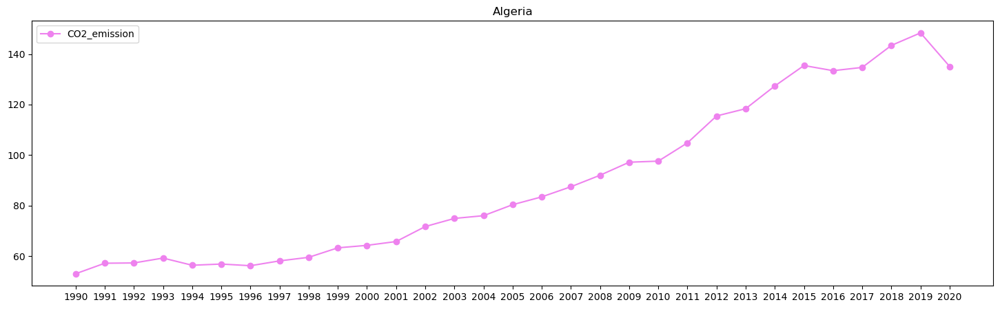

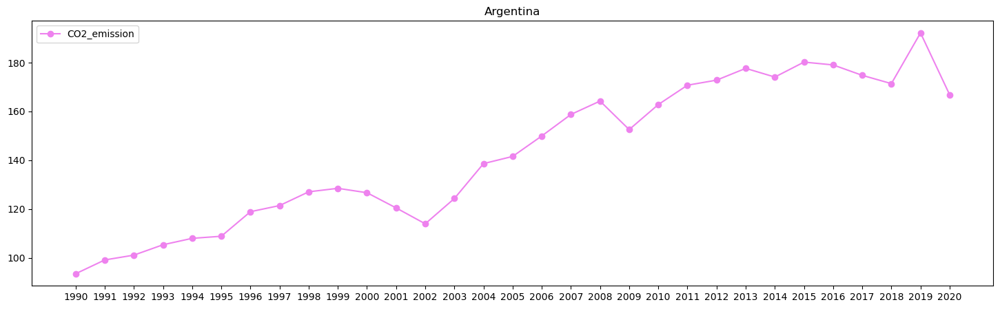

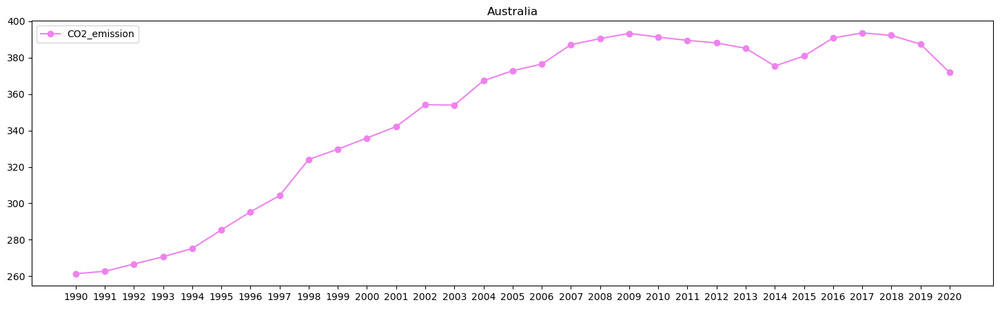

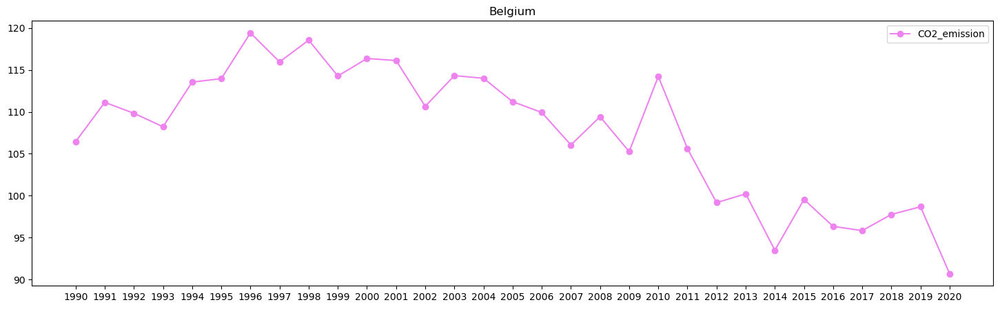

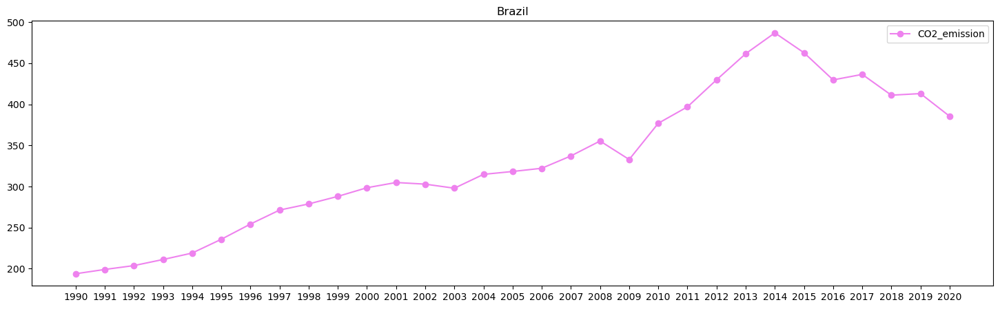

...

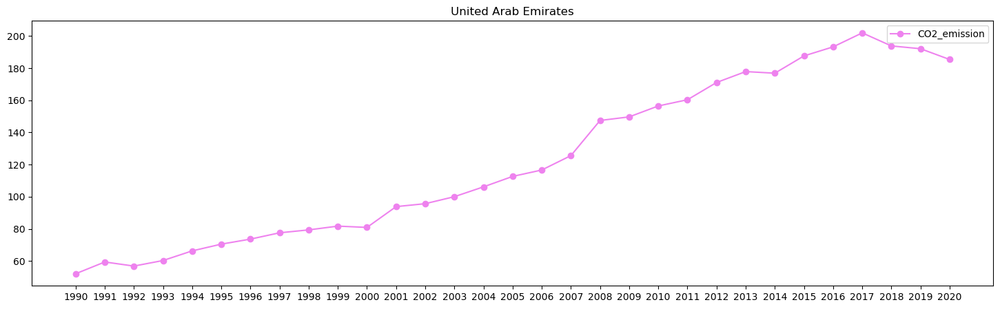

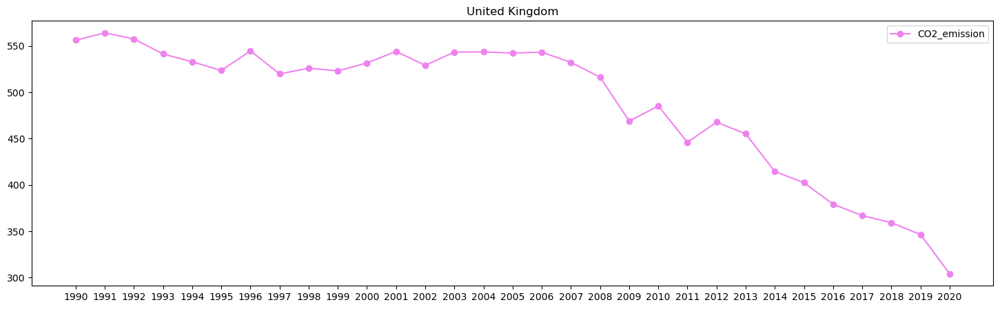

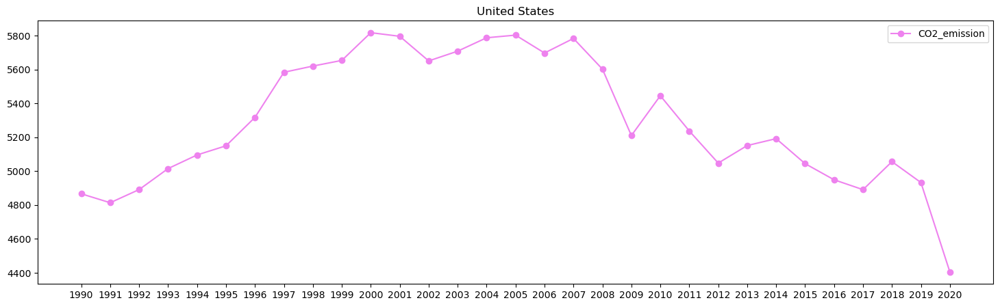

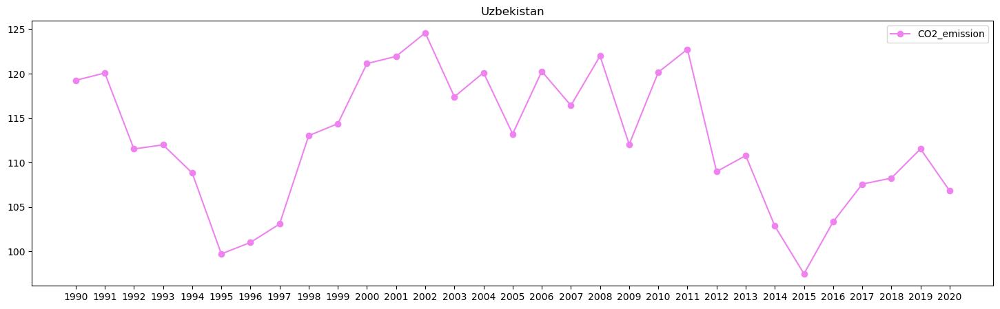

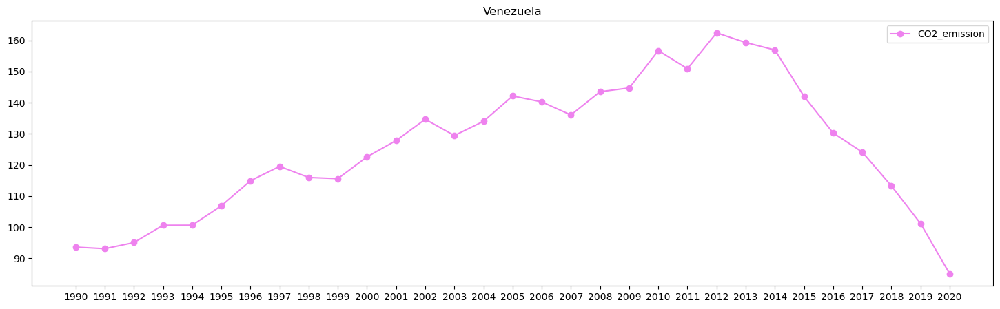

In [9]:
# descriptive analysis of CO2 emissions from fuel combustion
import matplotlib.pyplot as plt
for k in range(len(new)):
    plt.figure(figsize=(18,5))
    x_ticks= range(len(new[k]["Year"]))
    plt.plot(x_ticks,new[k]["CO2 emissions from fuel combustion (MtCO2)"], color= "violet",label="CO2_emission", marker="o")
    plt.title(countries[k])
    plt.xticks(x_ticks,new[k]["Year"])
    plt.legend()
    plt.show()
 

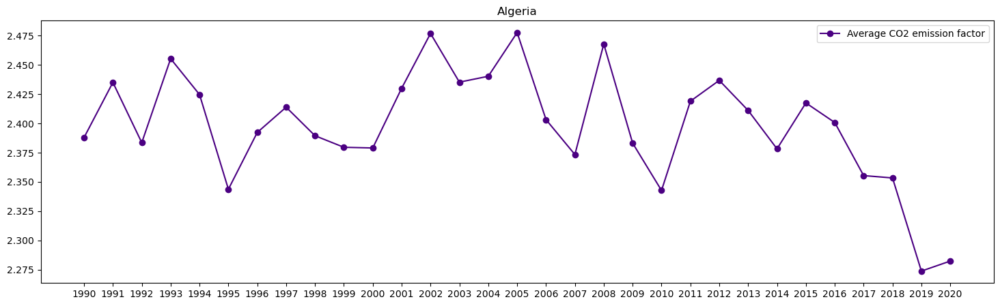

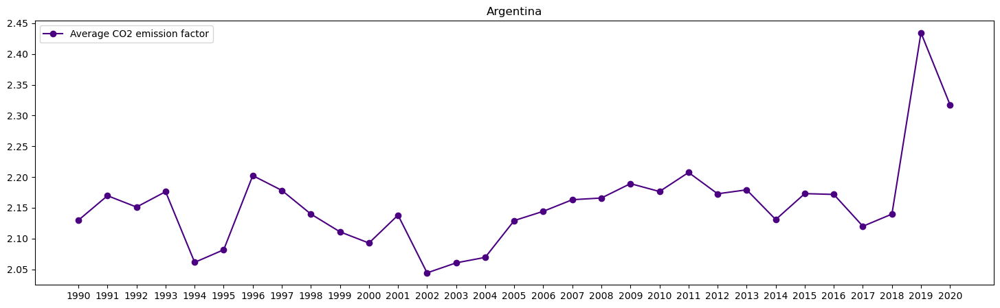

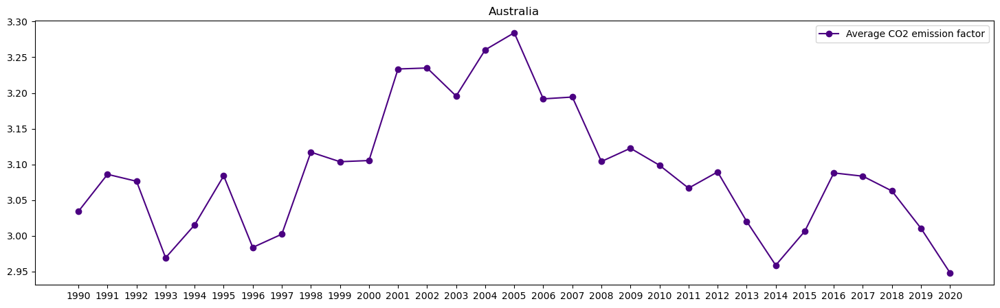

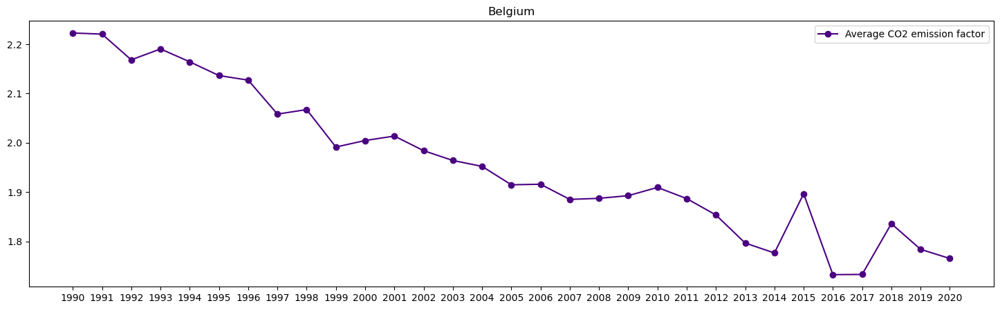

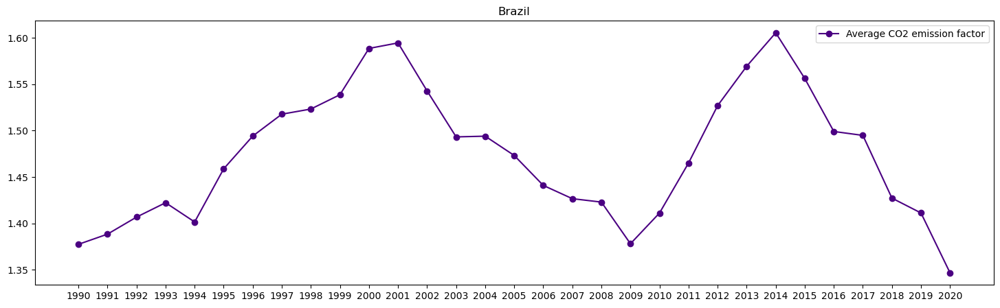

...

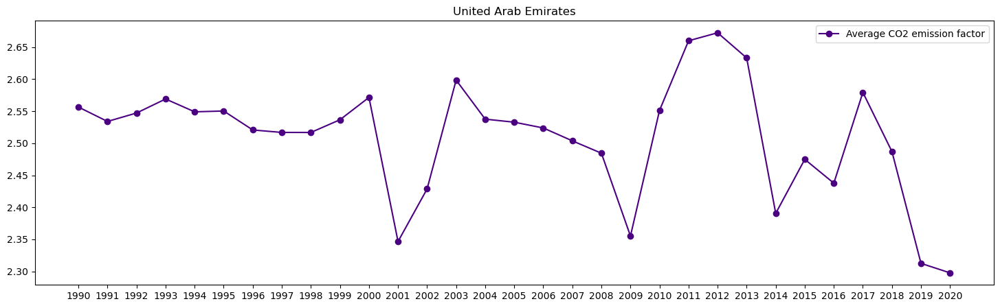

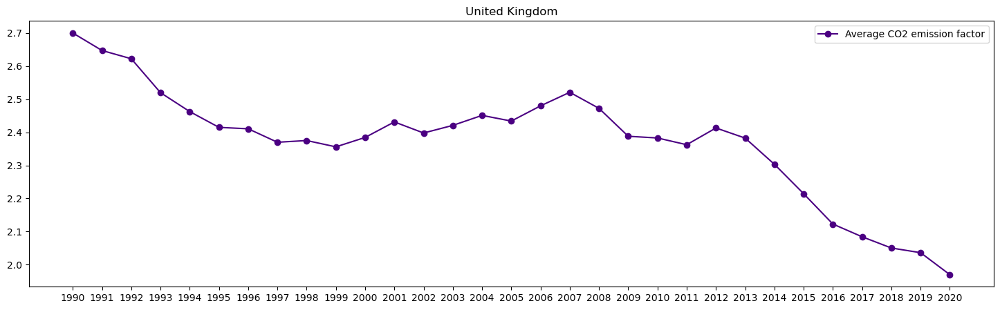

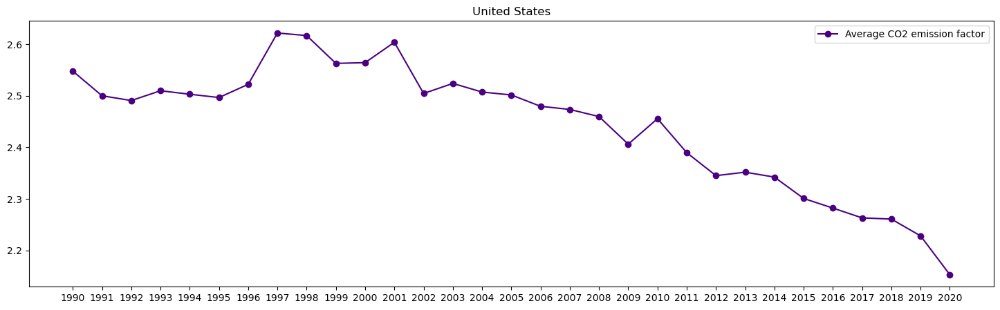

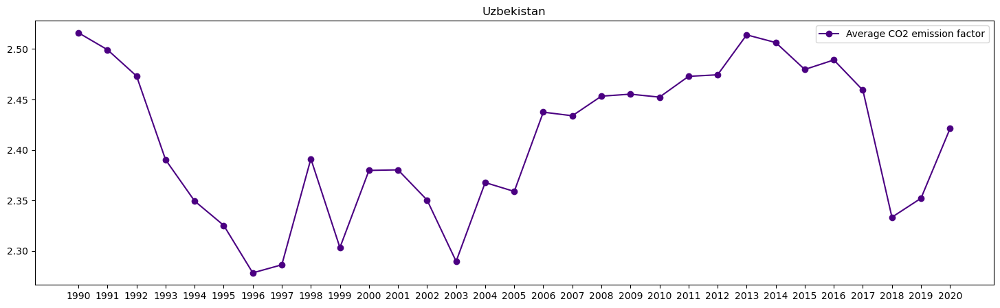

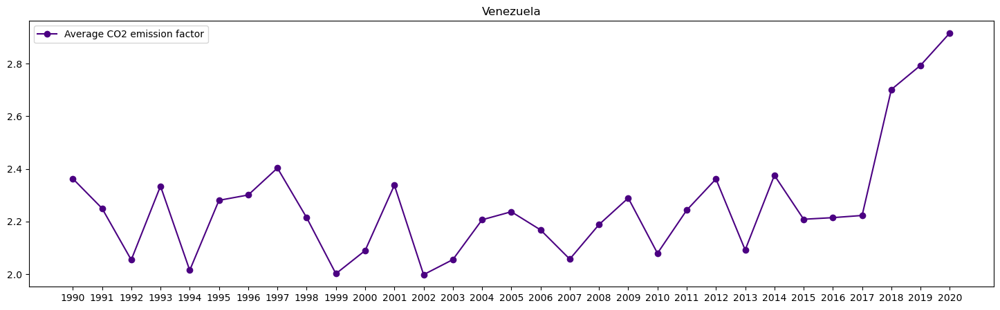

In [10]:
# descriptive analysis of Average CO2 emission factor (tCO2/toe)
for k in range(len(new)):
    plt.figure(figsize=(18,5))
    x_ticks= range(len(new[k]["Year"]))
    plt.plot(x_ticks,new[k]["Average CO2 emission factor (tCO2/toe)"], color= "indigo",label="Average CO2 emission factor", marker="o")
    plt.title(countries[k])
    plt.xticks(x_ticks,new[k]["Year"])
    plt.legend()
    plt.show()


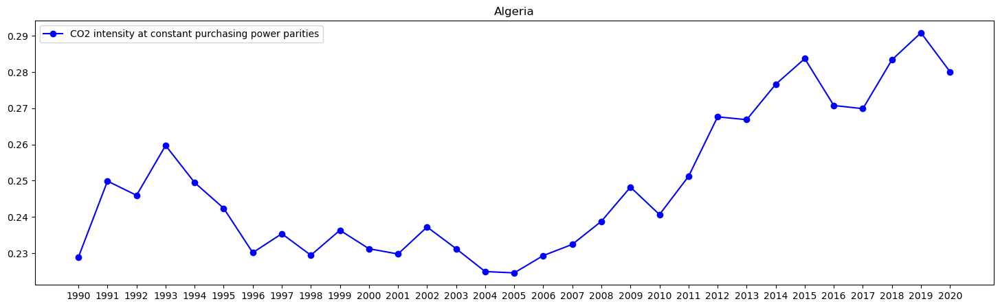

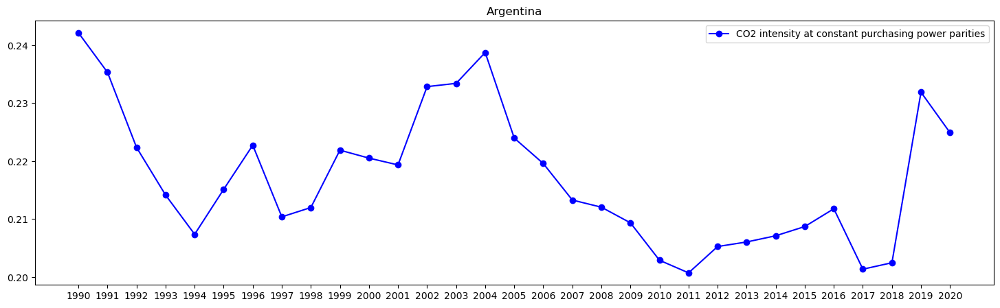

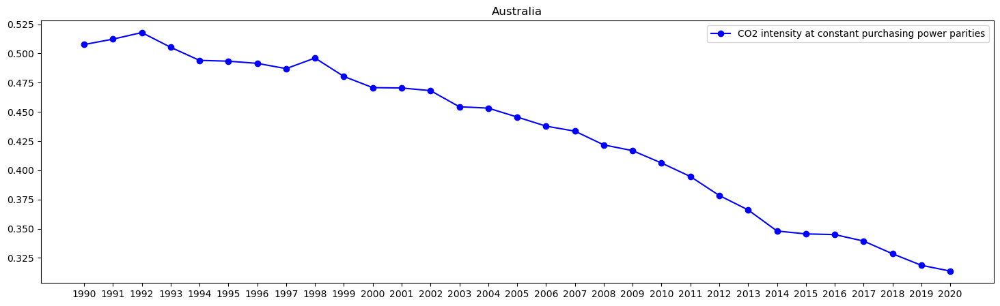

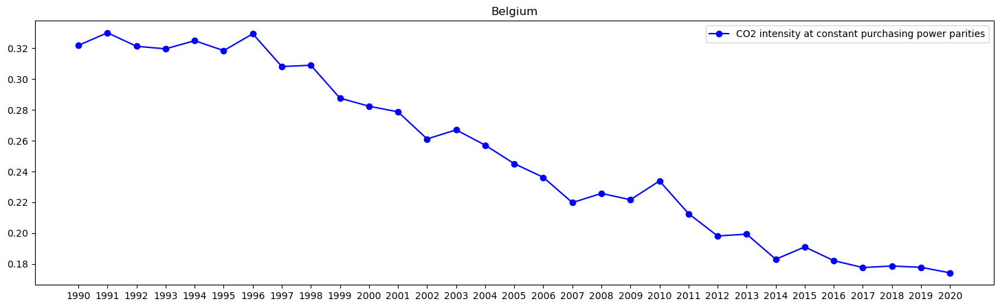

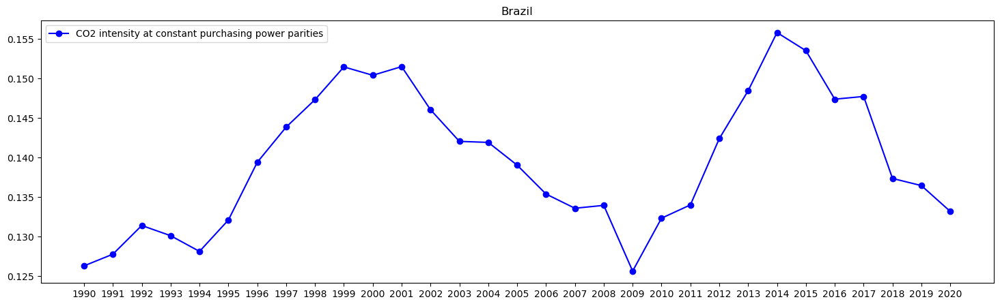

...

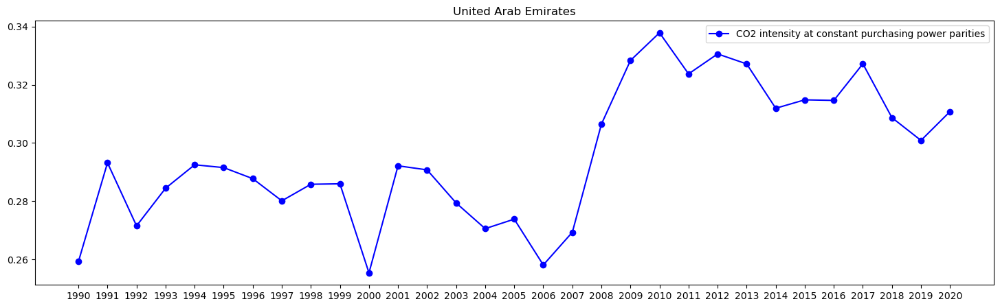

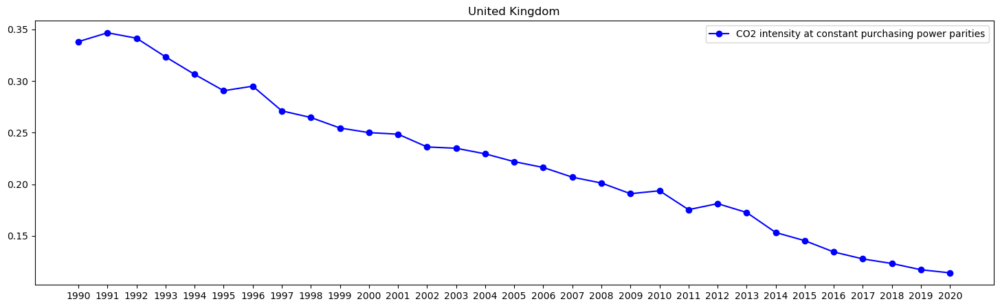

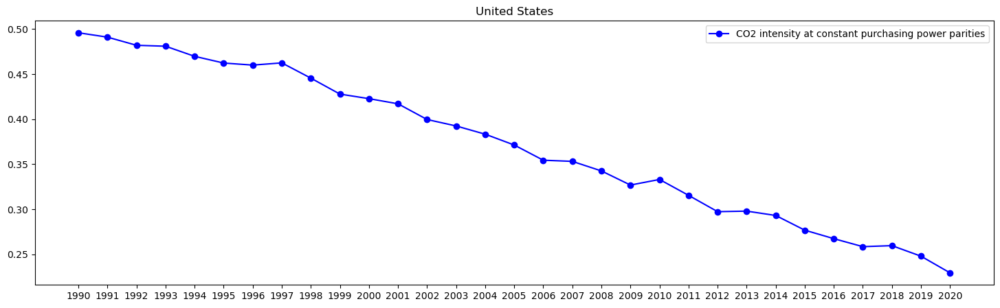

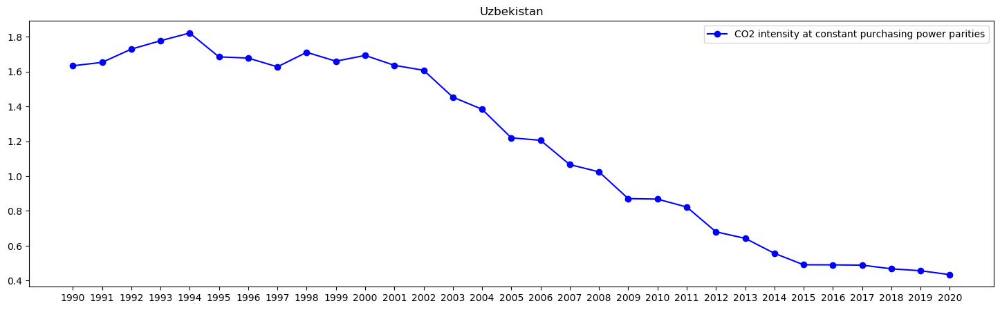

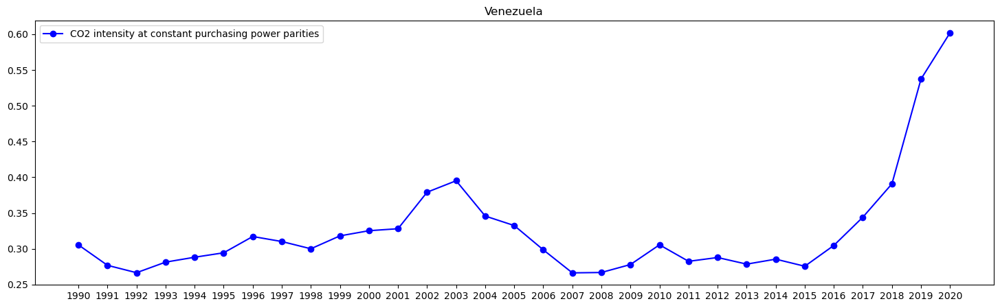

In [11]:
# descriptive analysis of CO2 intensity at constant purchasing power parities (kCO2/$15p)
for k in range(len(new)):
    plt.figure(figsize=(18,5))
    x_ticks= range(len(new[k]["Year"]))
    plt.plot(x_ticks,new[k]["CO2 intensity at constant purchasing power parities (kCO2/$15p)"], color= "blue",label="CO2 intensity at constant purchasing power parities", marker="o")
    plt.title(countries[k])
    plt.xticks(x_ticks,new[k]["Year"])
    plt.legend()
    plt.show()


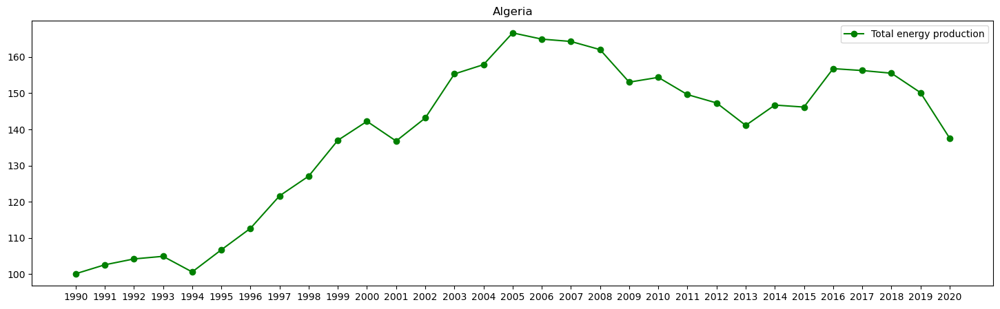

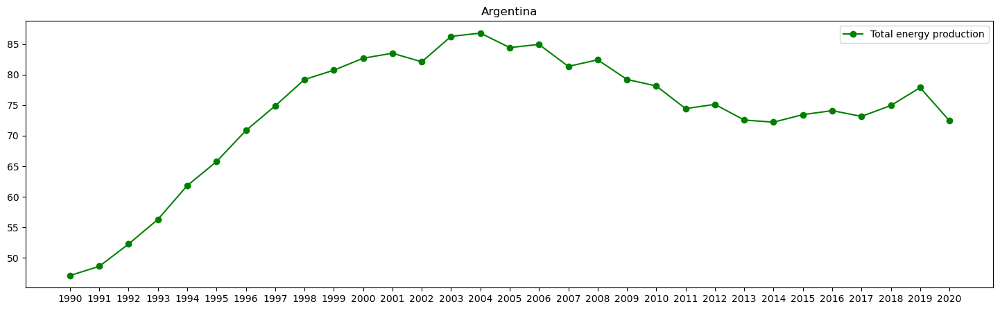

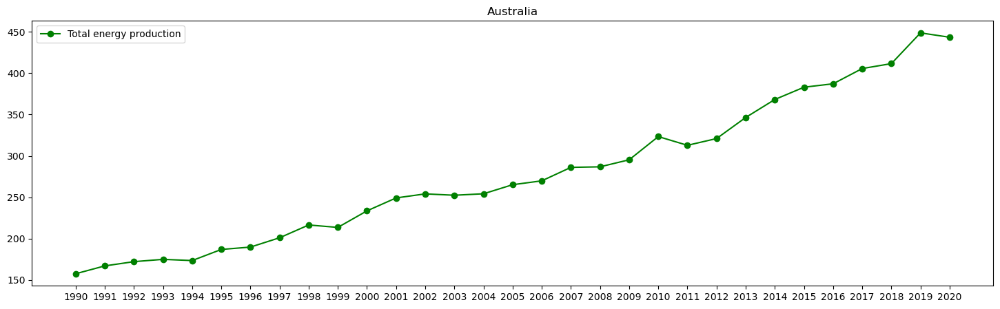

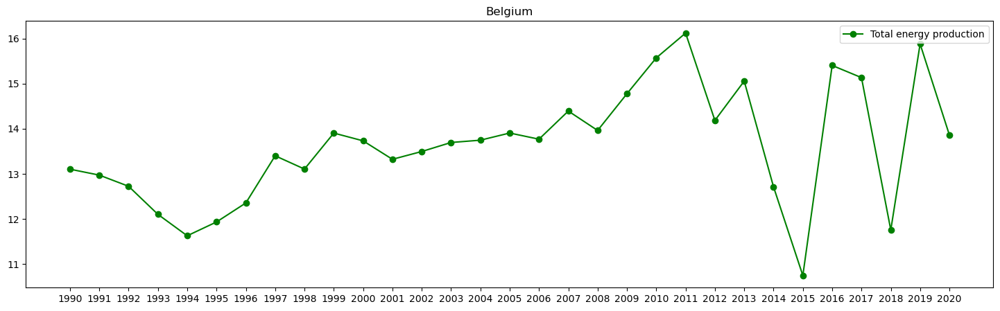

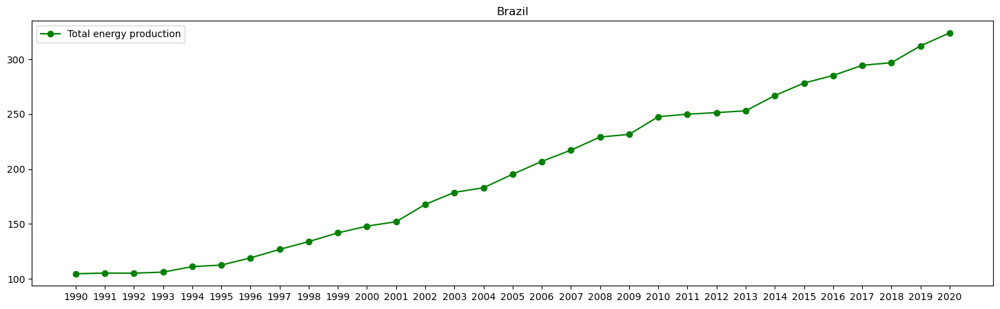

...

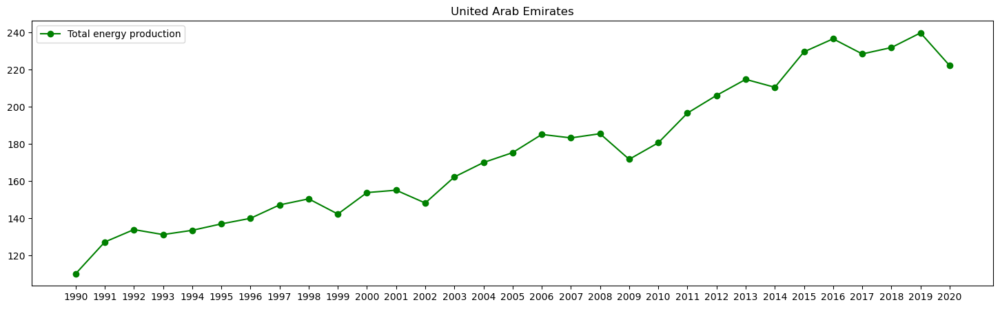

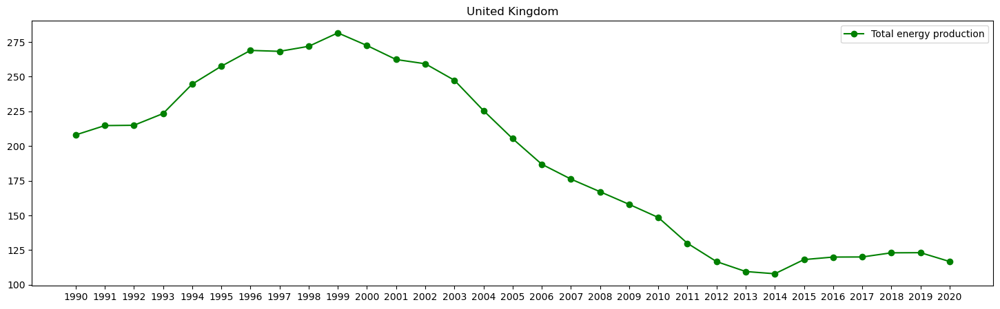

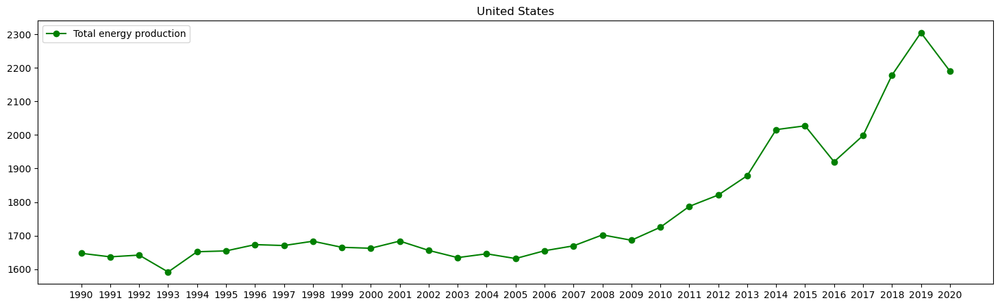

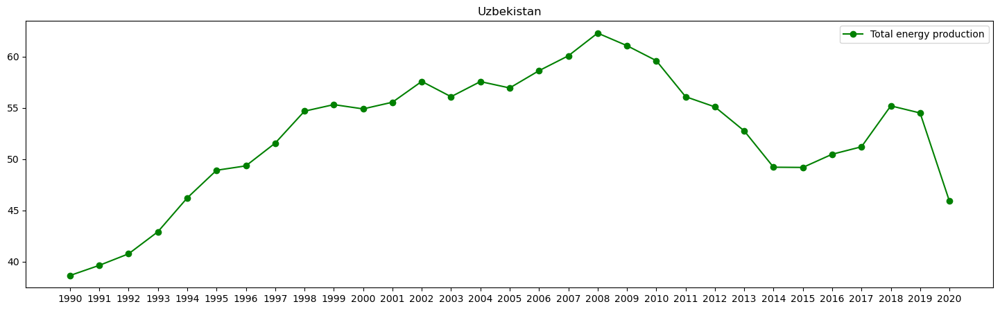

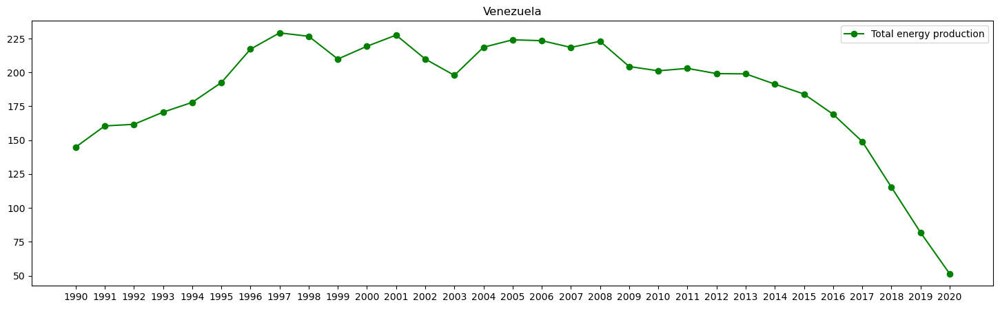

In [12]:
# descriptive analysis of Total energy production (Mtoe)
for k in range(len(new)):
    plt.figure(figsize=(18,5))
    x_ticks= range(len(new[k]["Year"]))
    plt.plot(x_ticks,new[k]["Total energy production (Mtoe)"], color= "green",label="Total energy production", marker="o")
    plt.title(countries[k])
    plt.xticks(x_ticks,new[k]["Year"])
    plt.legend()
    plt.show()

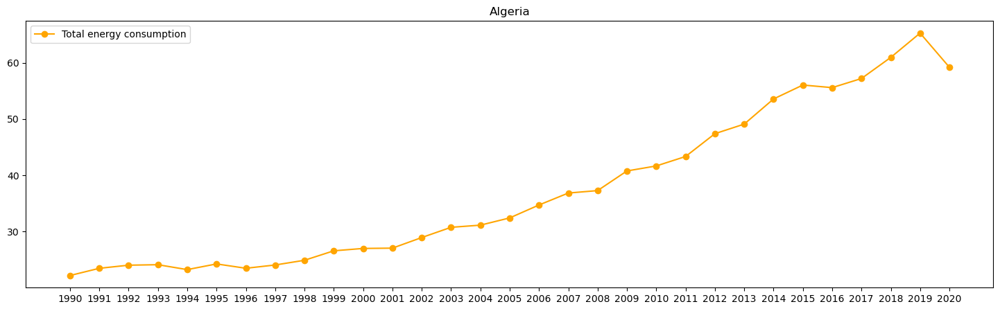

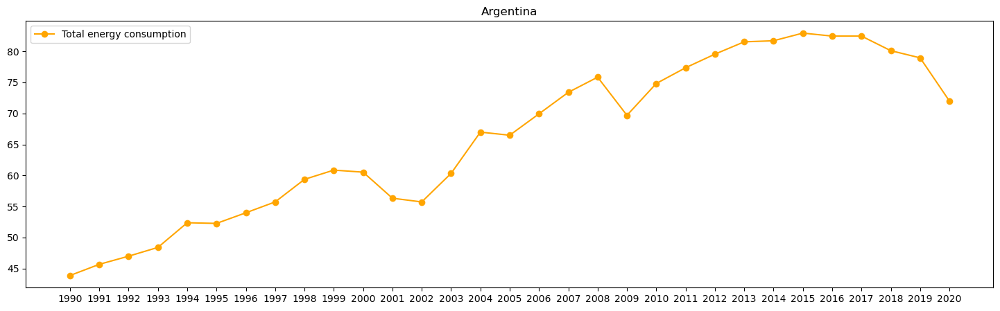

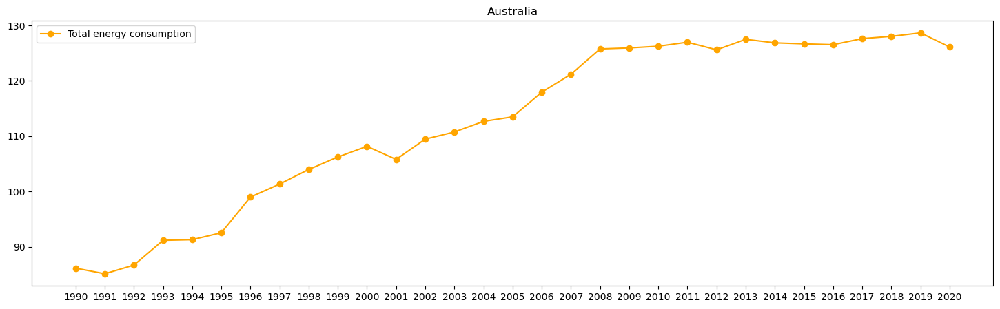

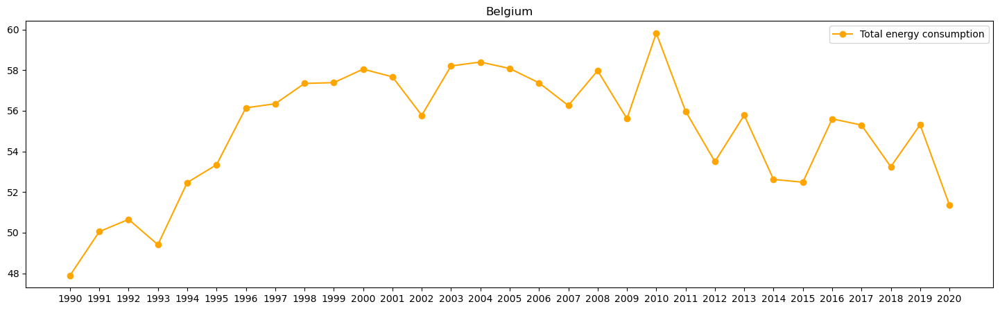

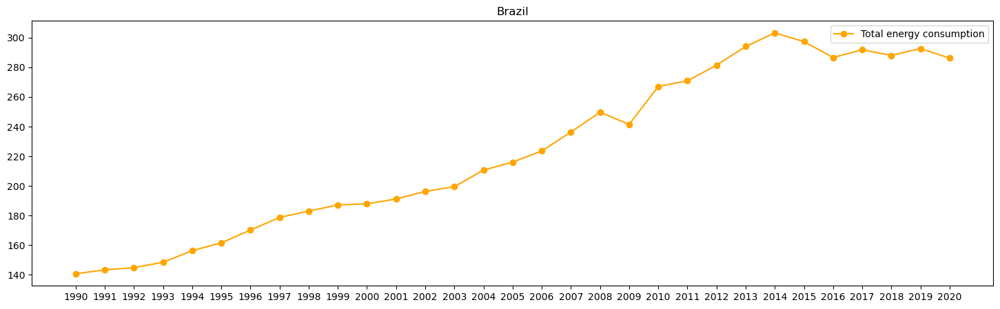

...

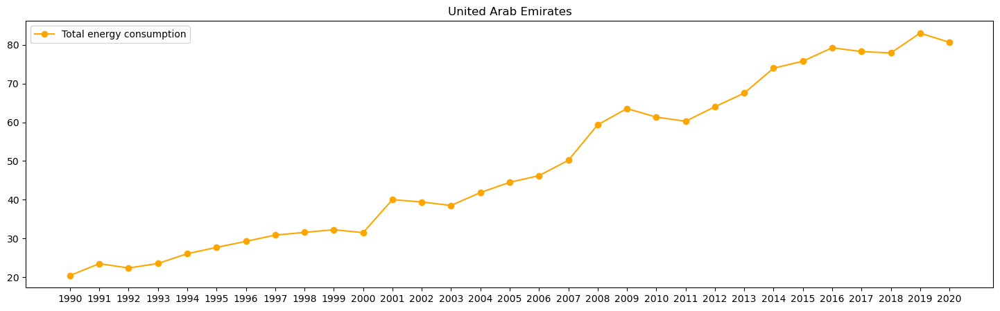

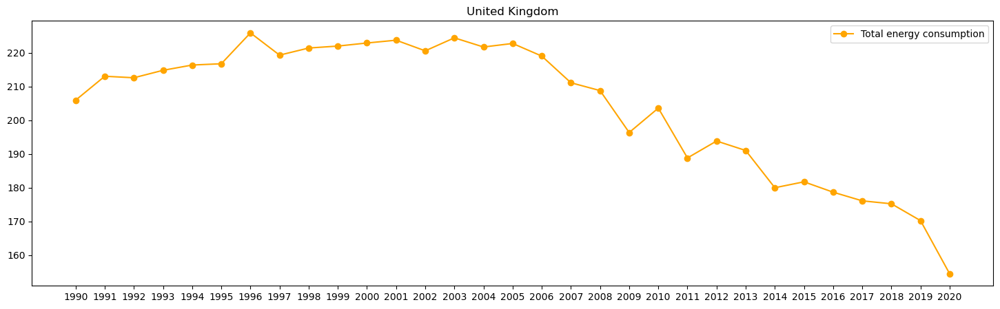

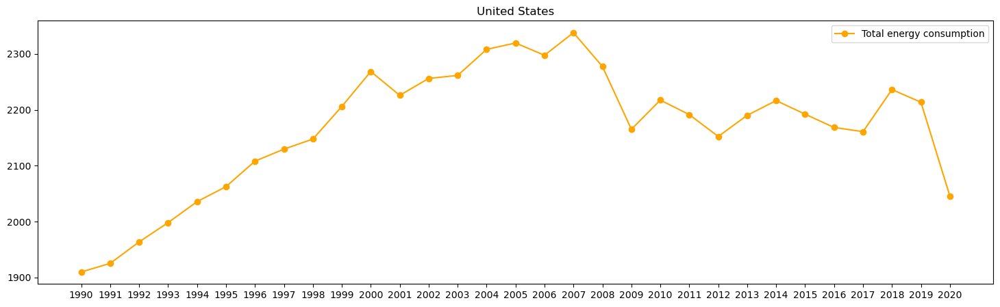

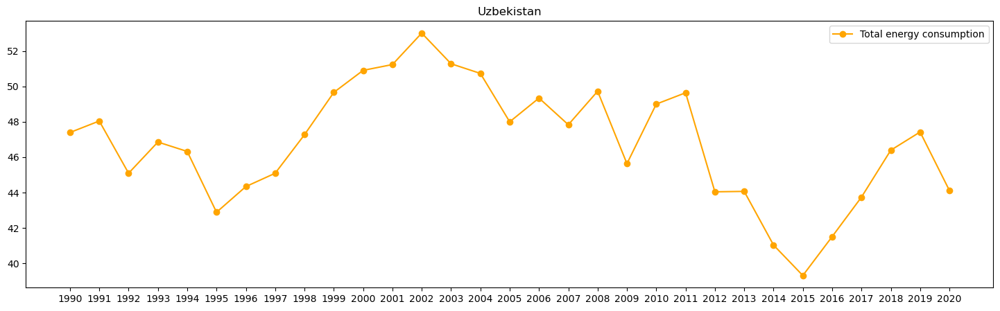

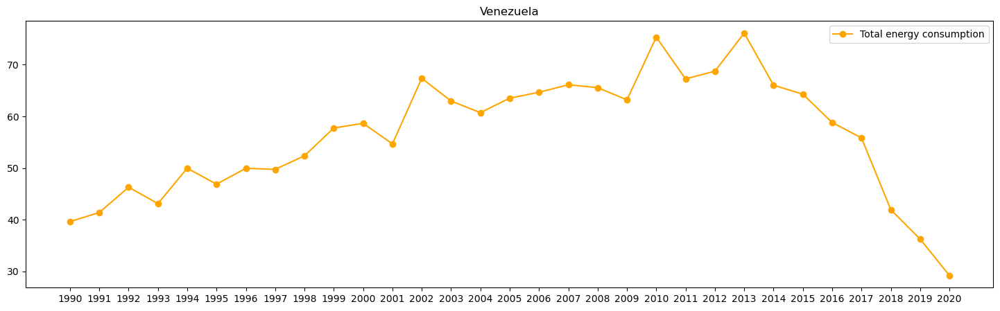

In [13]:
# descriptive analysis of Total energy consumption (Mtoe)
for k in range(len(new)):
    plt.figure(figsize=(18,5))
    x_ticks= range(len(new[k]["Year"]))
    plt.plot(x_ticks,new[k]["Total energy consumption (Mtoe)"], color= "orange",label="Total energy consumption", marker="o")
    plt.title(countries[k])
    plt.xticks(x_ticks,new[k]["Year"])
    plt.legend()
    plt.show()

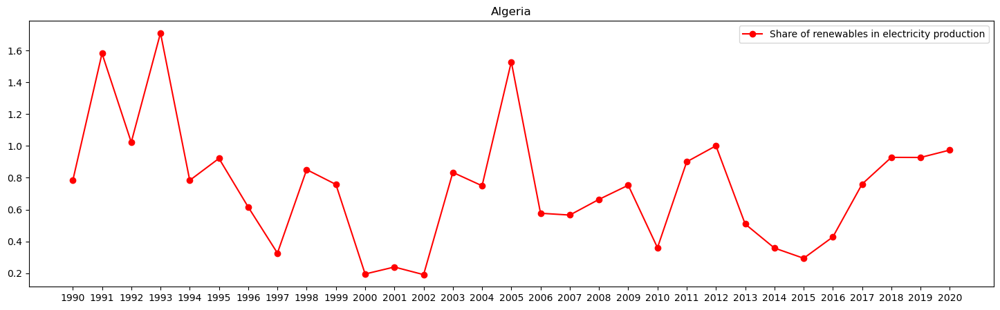

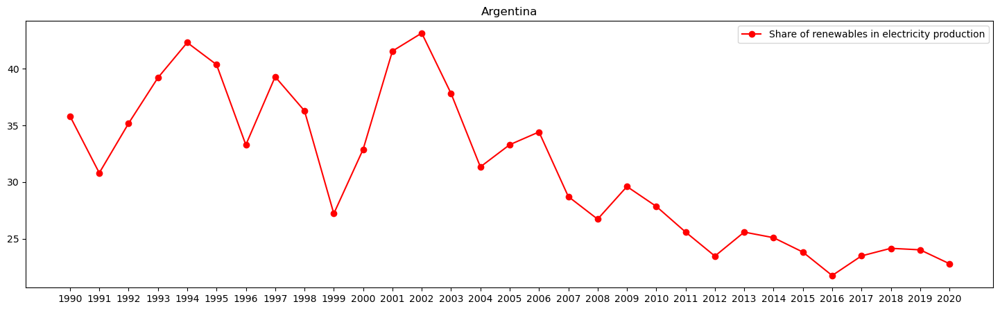

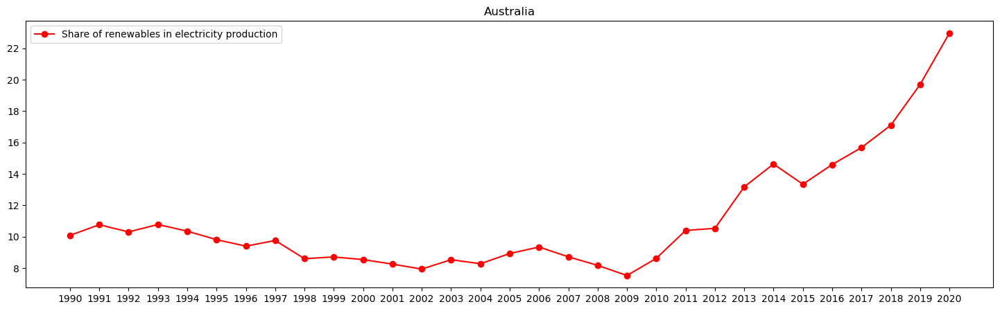

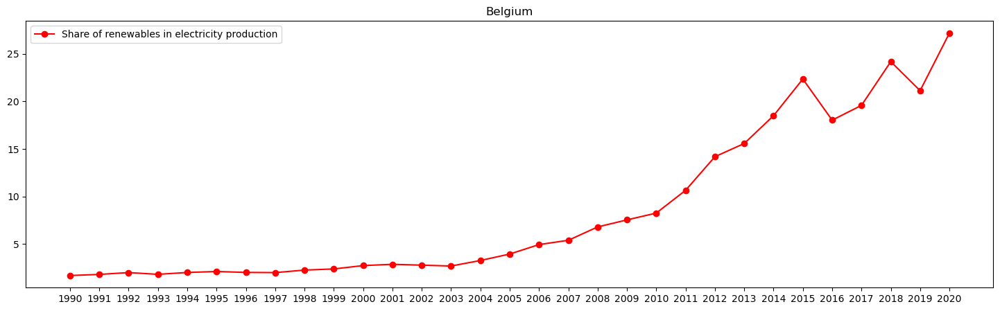

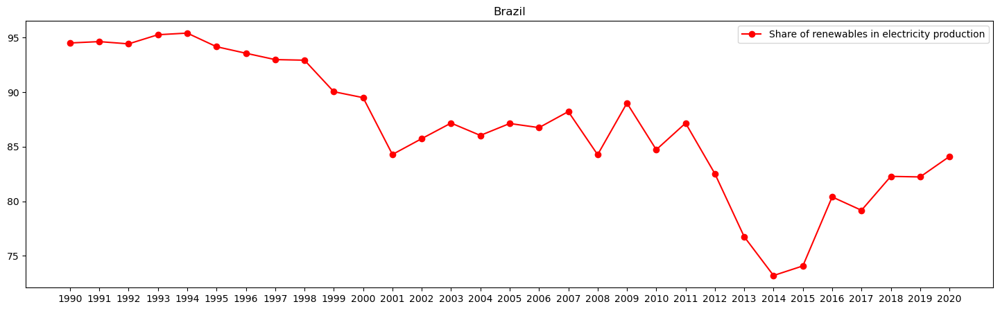

...

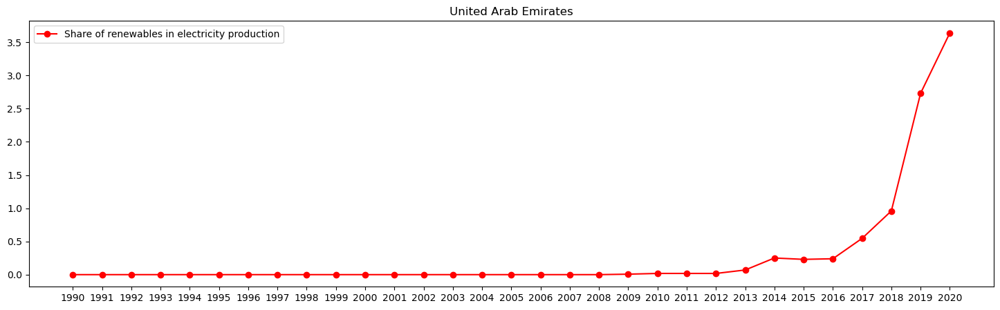

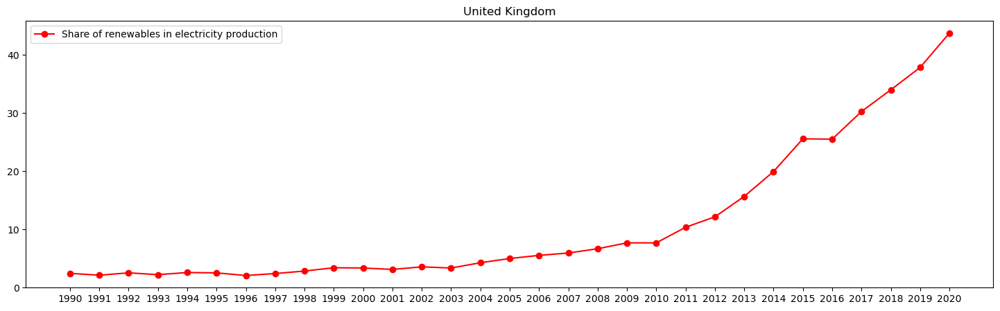

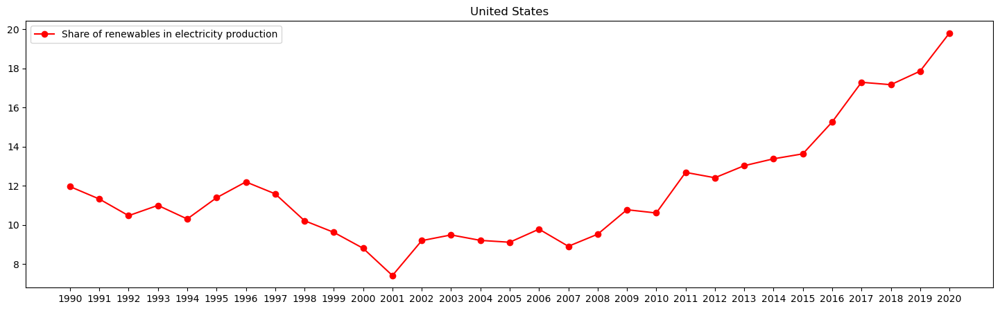

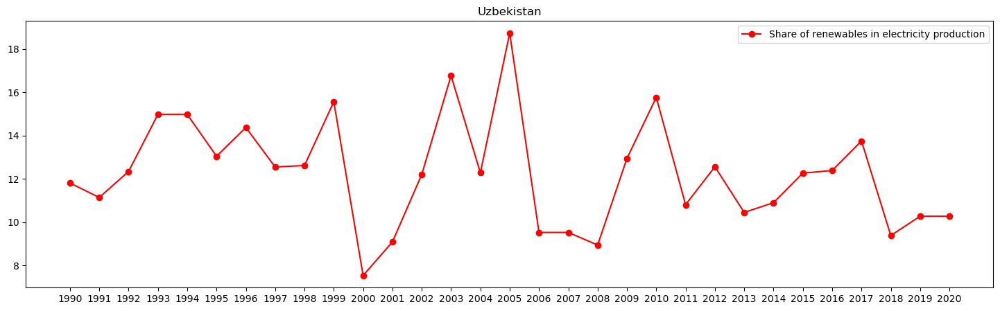

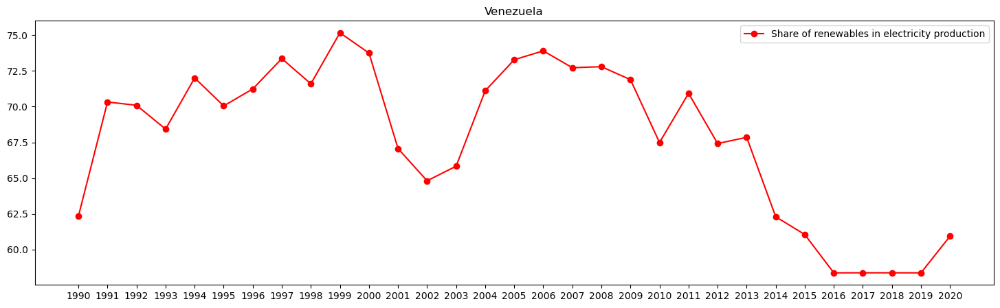

In [14]:
# descriptive analysis of Share of renewables in electricity production (%)
for k in range(len(new)):
    plt.figure(figsize=(18,5))
    x_ticks= range(len(new[k]["Year"]))
    plt.plot(x_ticks,new[k]["Share of renewables in electricity production (%)"], color= "red",label="Share of renewables in electricity production", marker="o")
    plt.title(countries[k])
    plt.xticks(x_ticks,new[k]["Year"])
    plt.legend()
    plt.show()

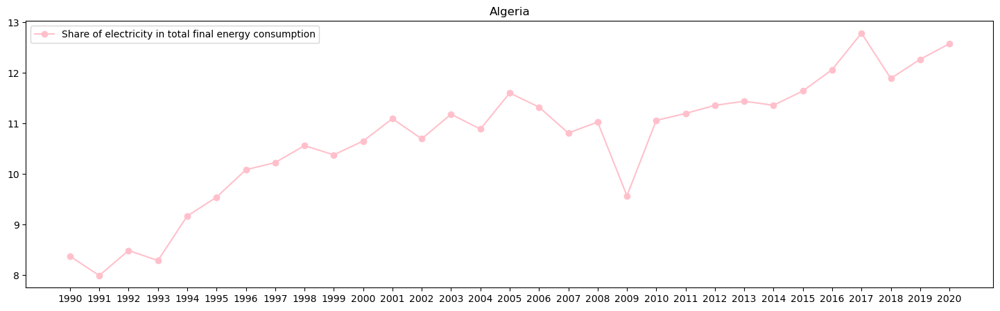

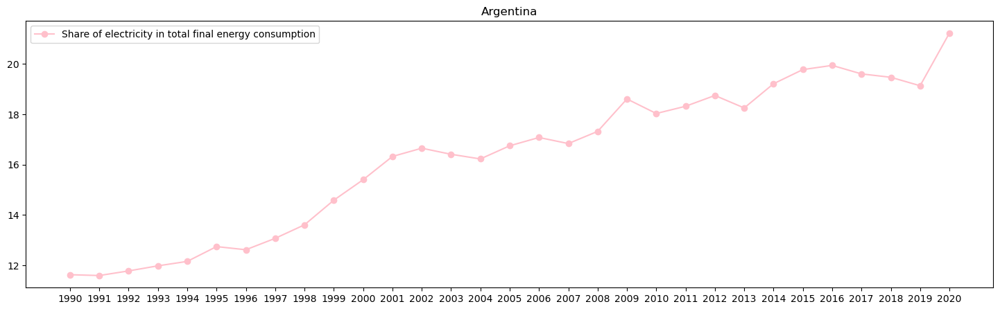

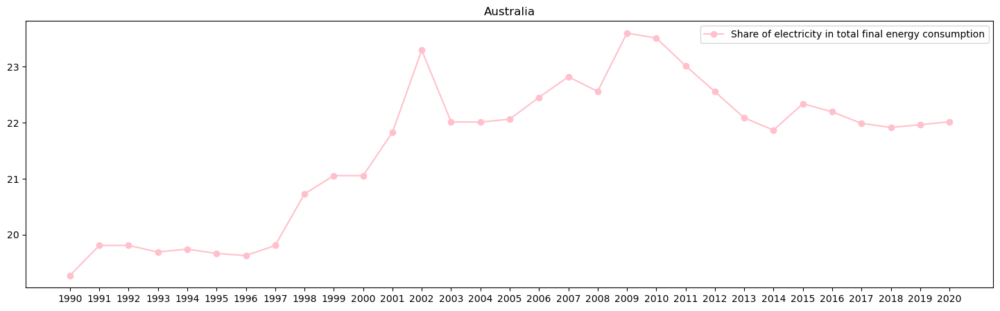

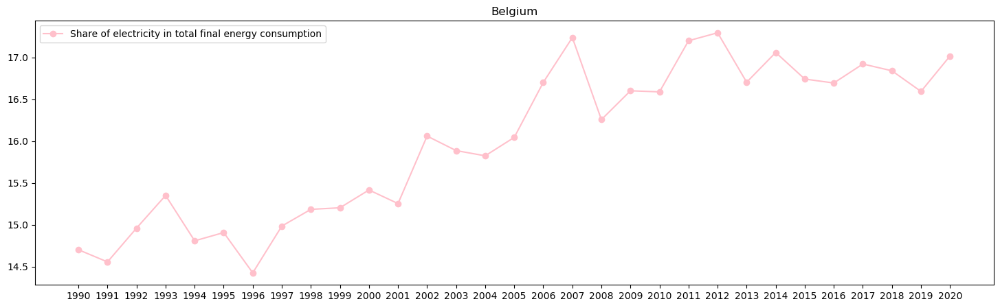

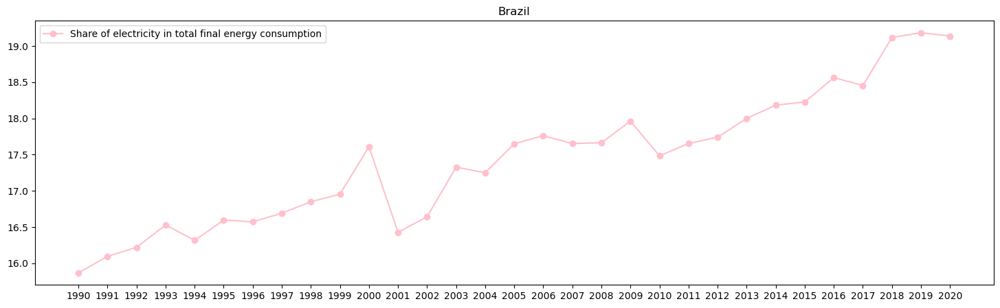

...

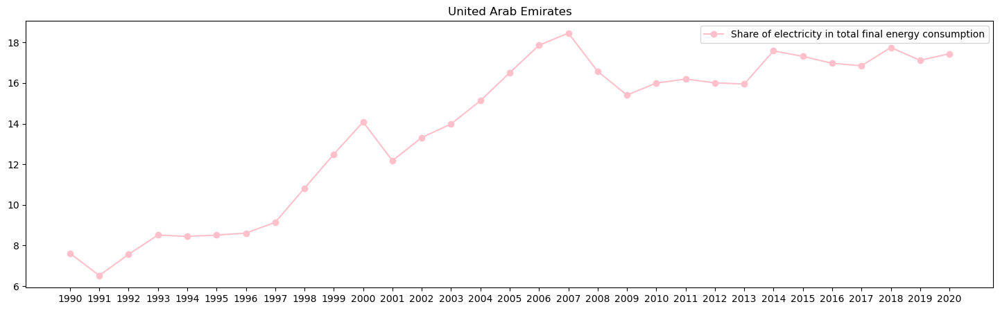

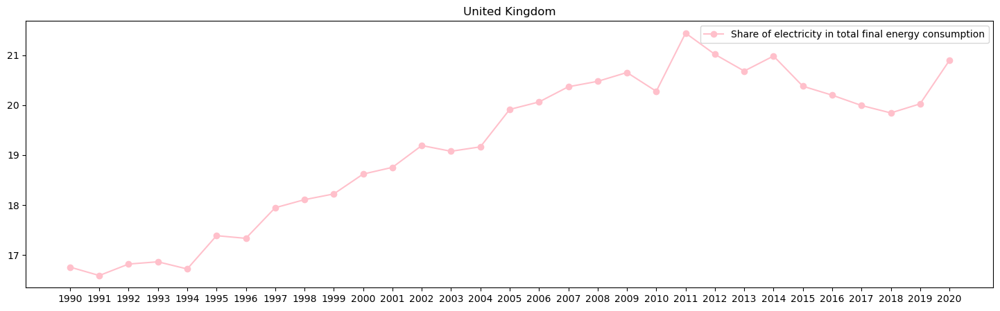

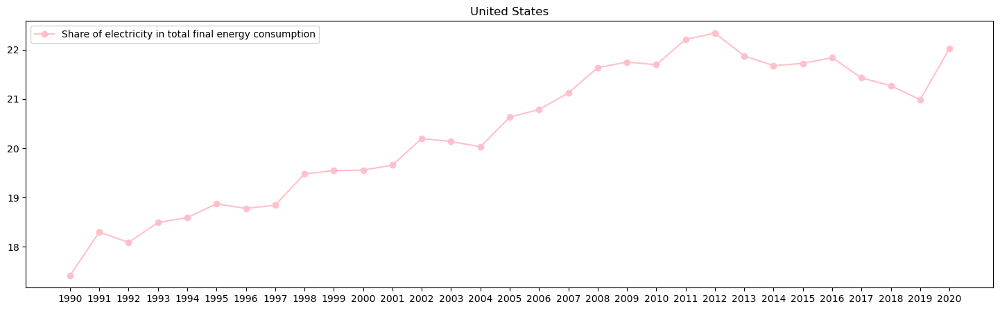

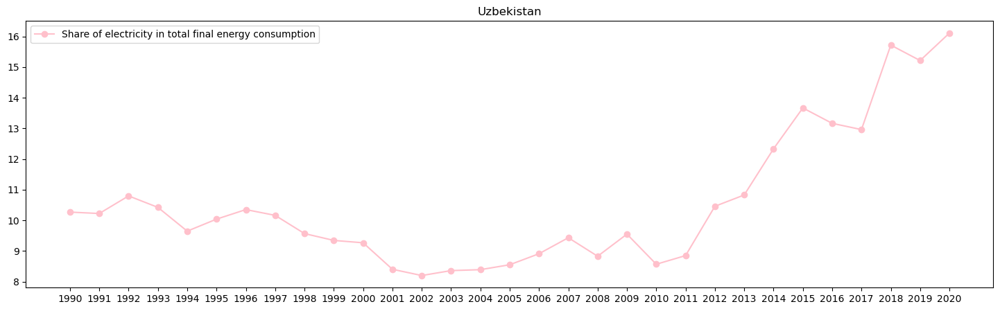

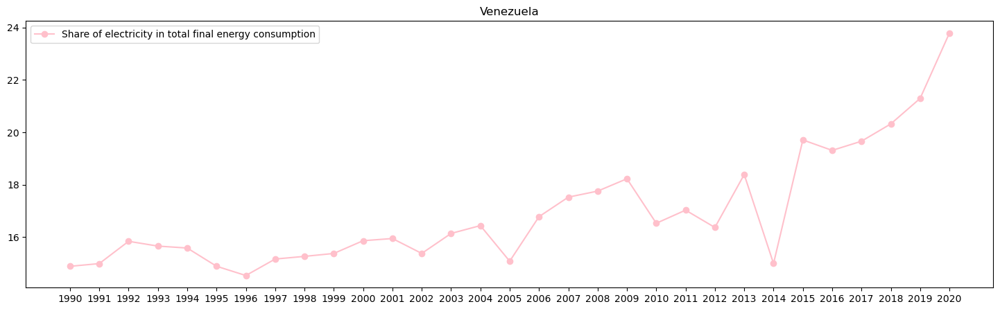

In [15]:
# descriptive analysis of Share of electricity in total final energy consumption (%)
for k in range(len(new)):
    plt.figure(figsize=(18,5))
    x_ticks= range(len(new[k]["Year"]))
    plt.plot(x_ticks,new[k]["Share of electricity in total final energy consumption (%)"], color= "pink",label="Share of electricity in total final energy consumption", marker="o")
    plt.title(countries[k])
    plt.xticks(x_ticks,new[k]["Year"])
    plt.legend()
    plt.show()

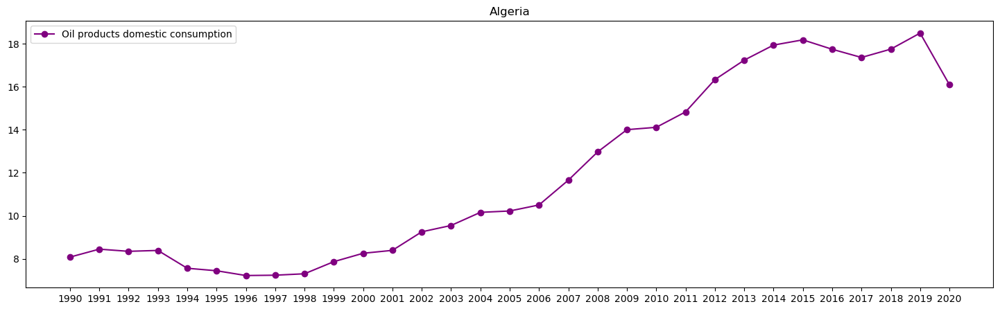

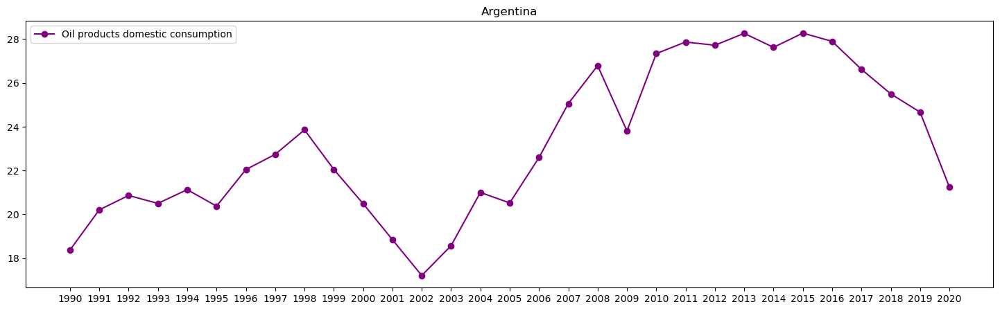

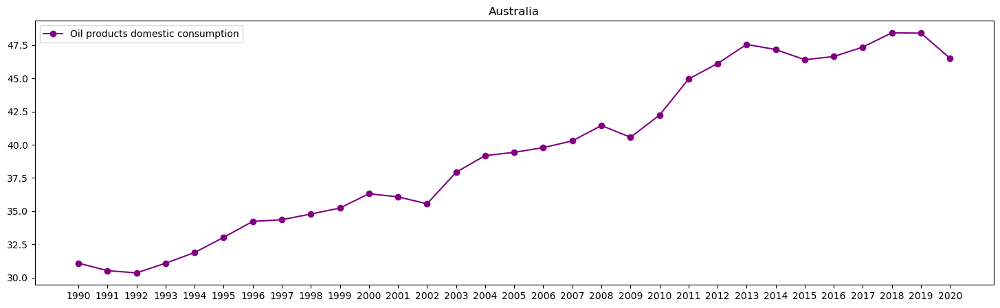

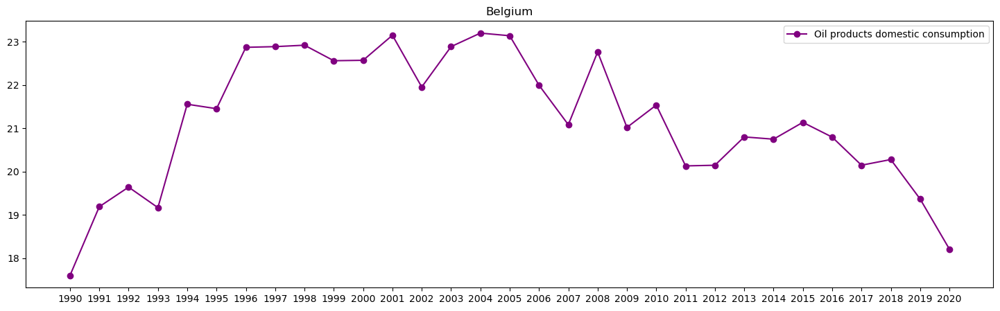

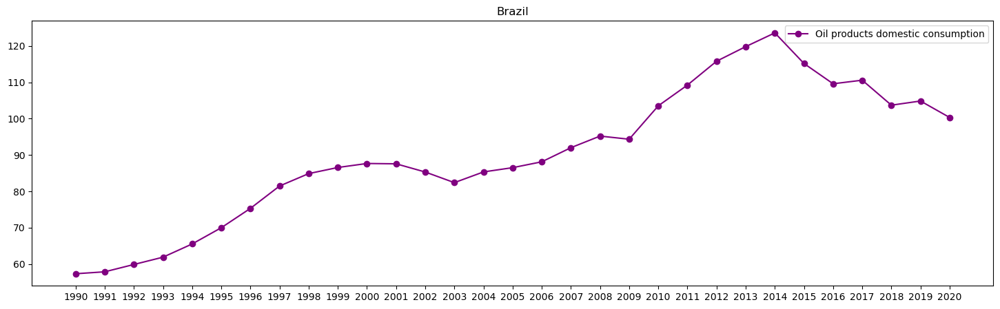

...

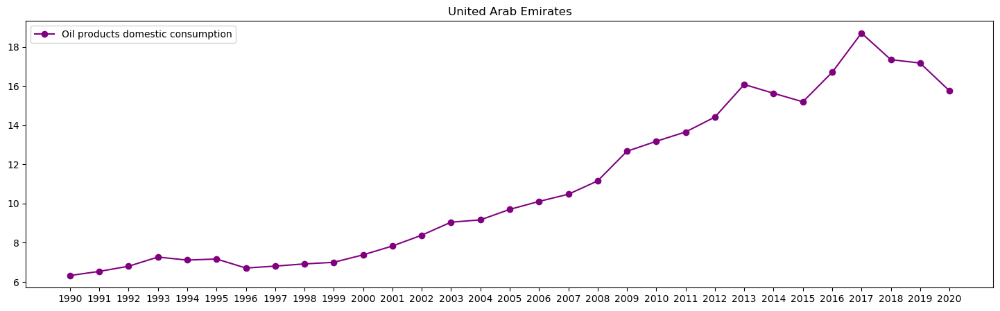

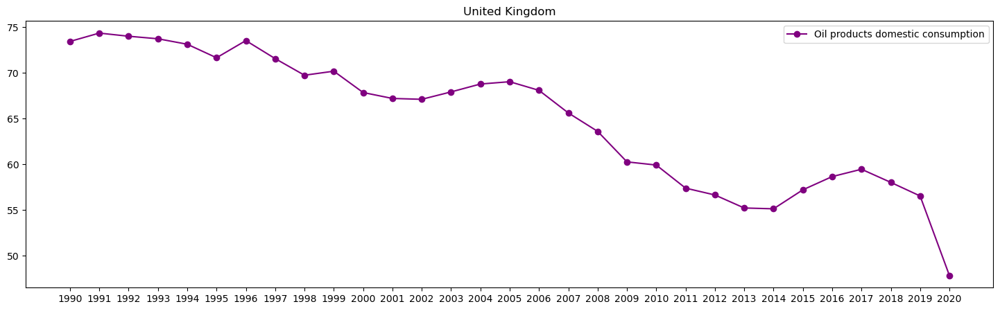

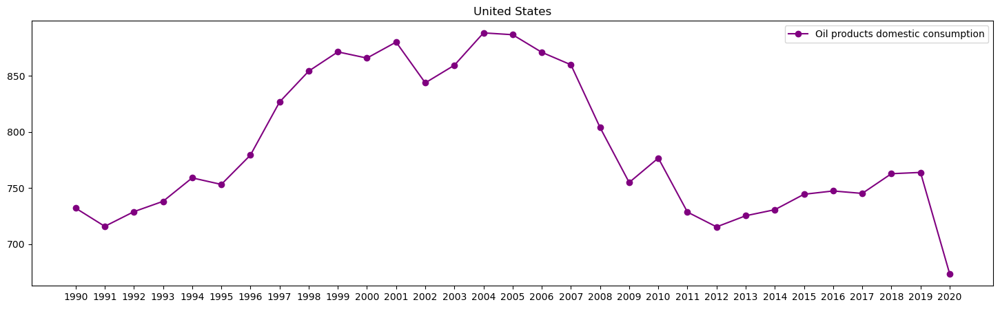

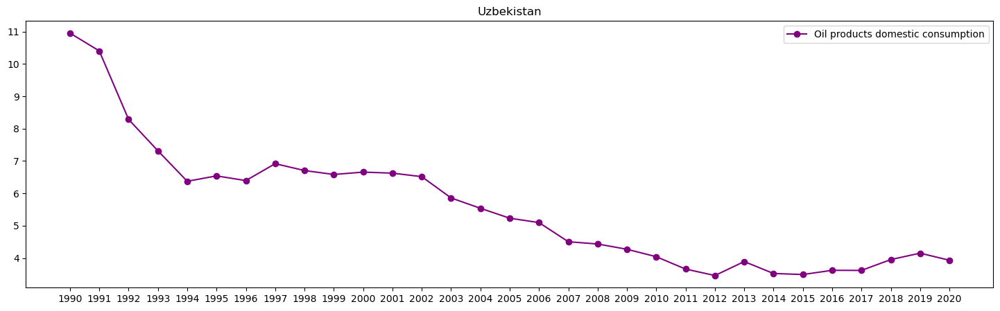

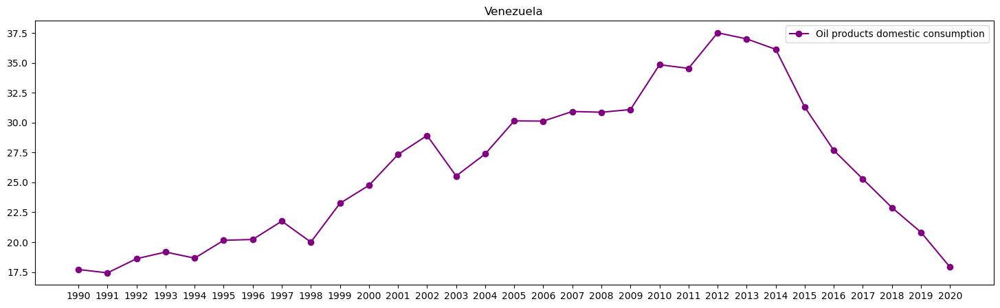

In [16]:
# descriptive analysis of Oil products domestic consumption (Mt)
for k in range(len(new)):
    plt.figure(figsize=(18,5))
    x_ticks= range(len(new[k]["Year"]))
    plt.plot(x_ticks,new[k]["Oil products domestic consumption (Mt)"], color= "purple",label="Oil products domestic consumption", marker="o")
    plt.title(countries[k])
    plt.xticks(x_ticks,new[k]["Year"])
    plt.legend()
    plt.show()

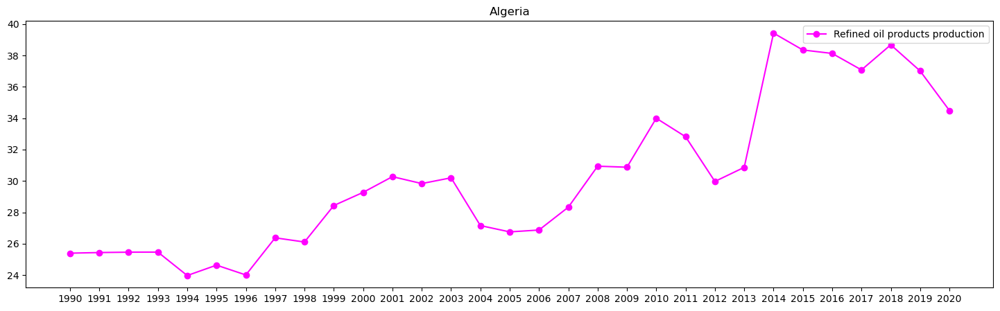

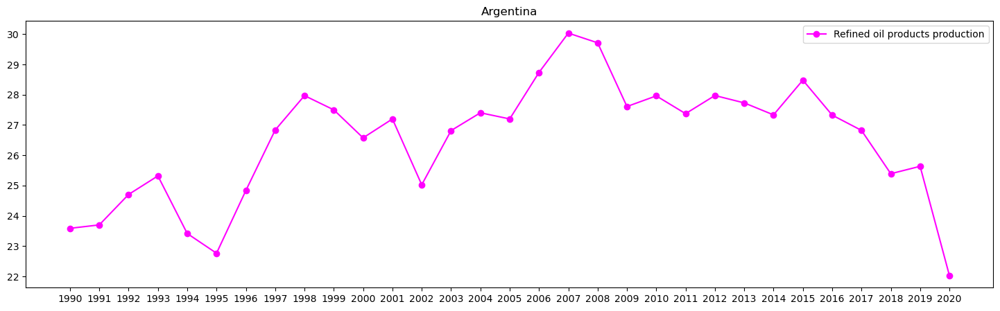

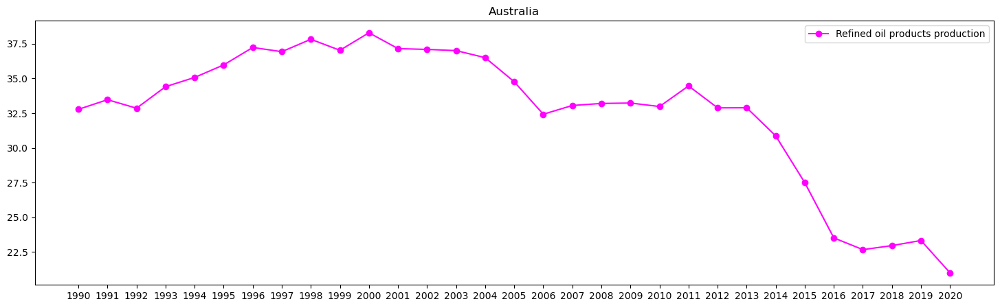

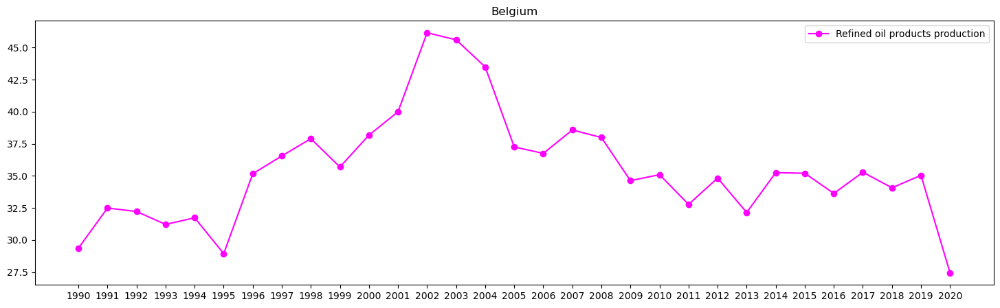

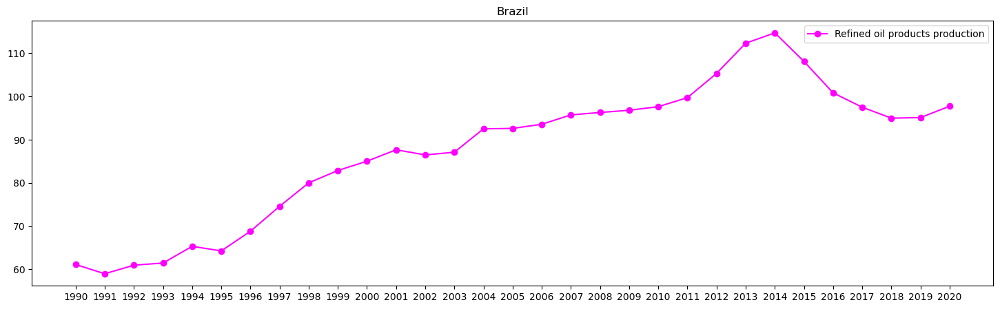

...

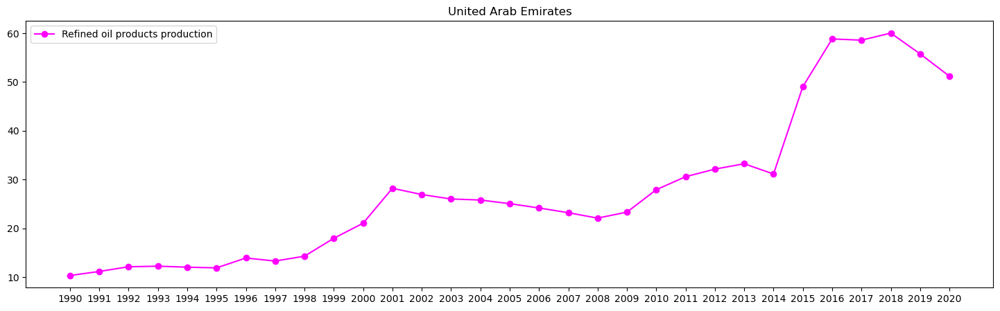

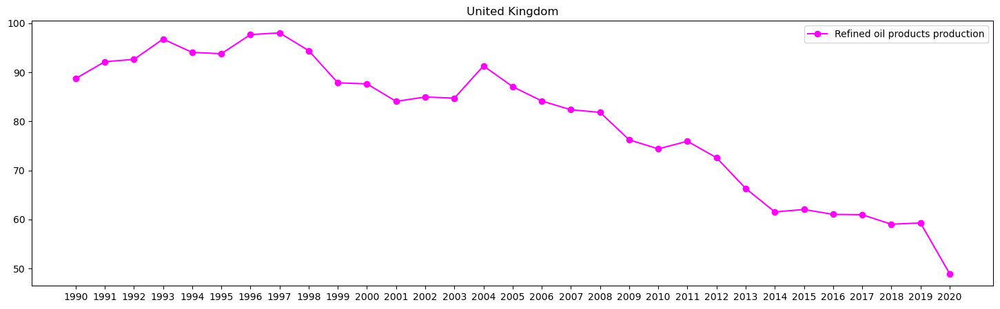

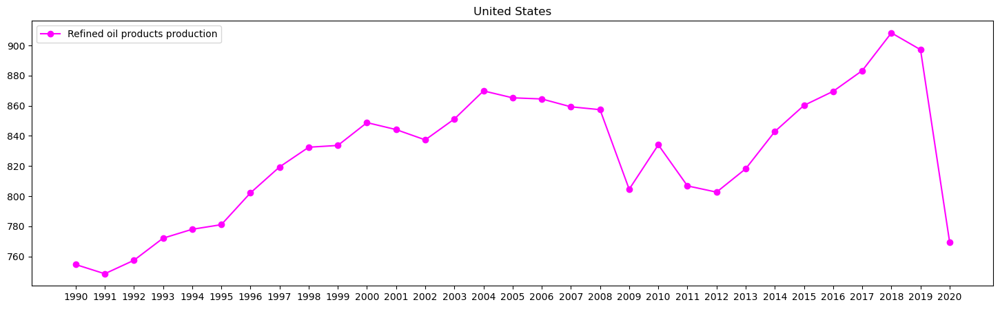

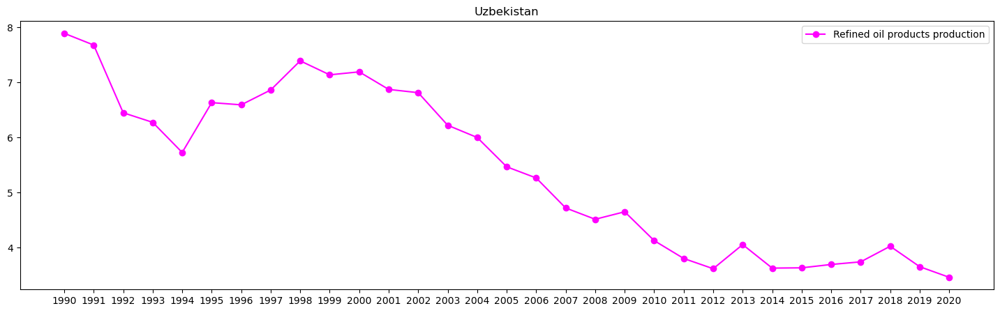

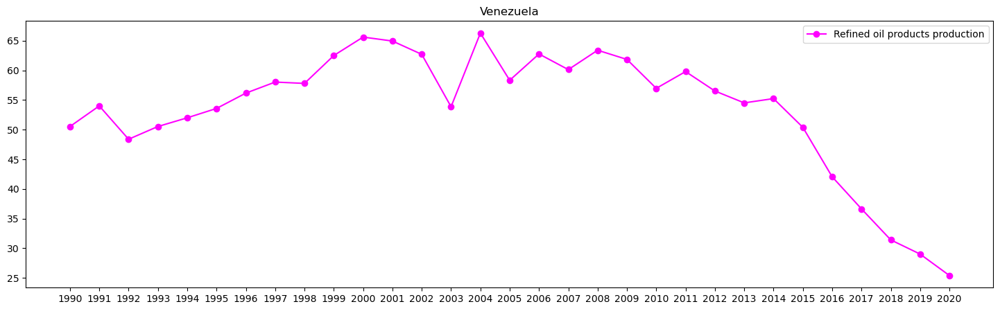

In [17]:
# descriptive analysis of Refined oil products production (Mt)
for k in range(len(new)):
    plt.figure(figsize=(18,5))
    x_ticks= range(len(new[k]["Year"]))
    plt.plot(x_ticks,new[k]["Refined oil products production (Mt)"], color= "magenta",label="Refined oil products production", marker="o")
    plt.title(countries[k])
    plt.xticks(x_ticks,new[k]["Year"])
    plt.legend()
    plt.show()

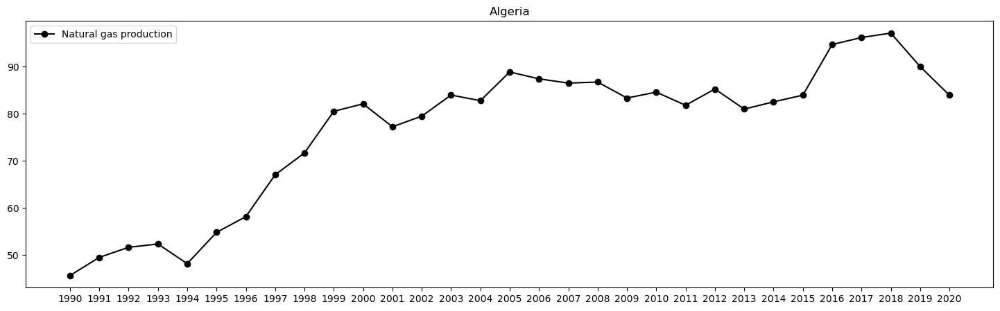

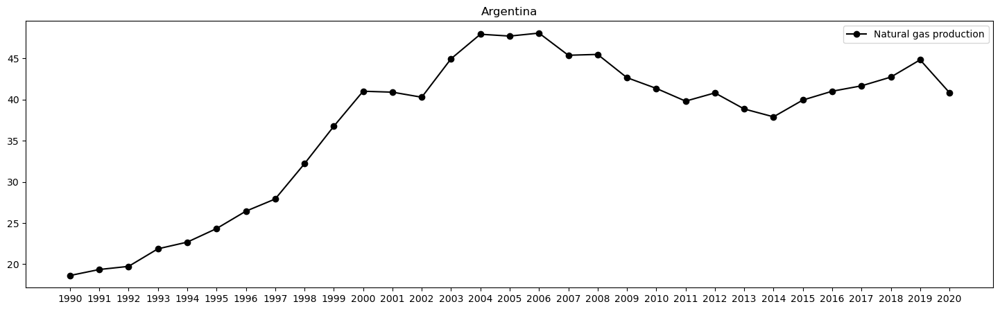

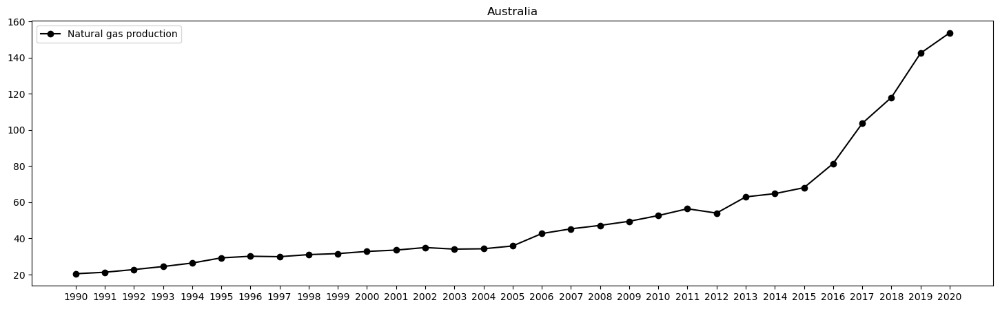

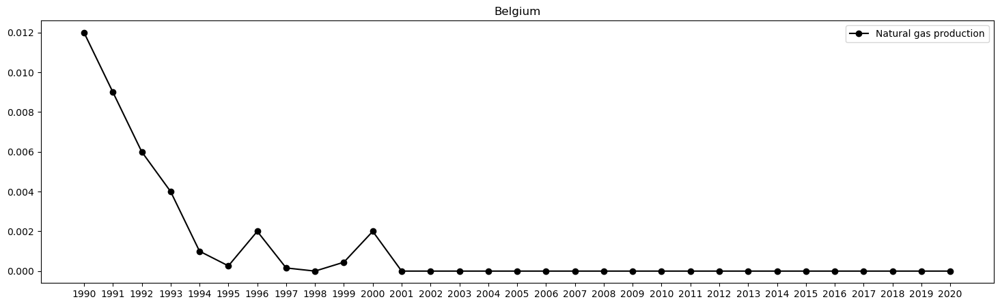

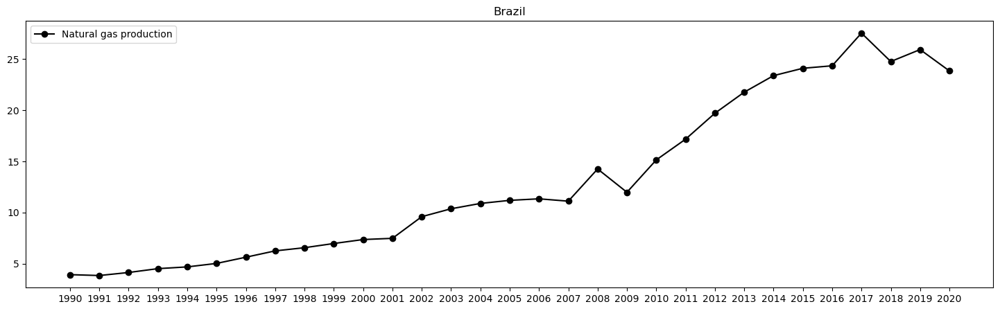

...

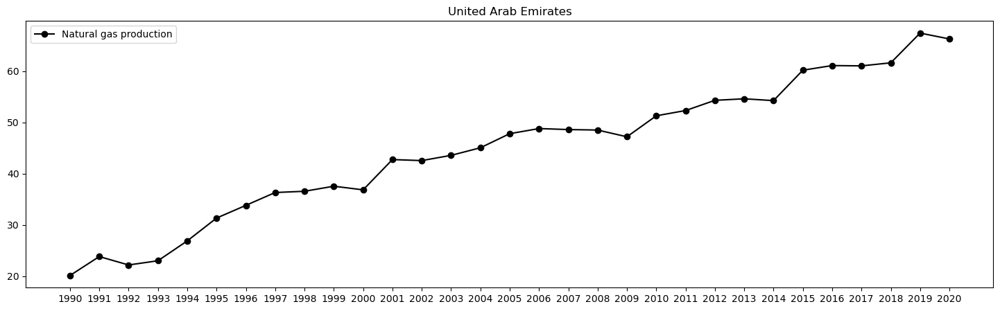

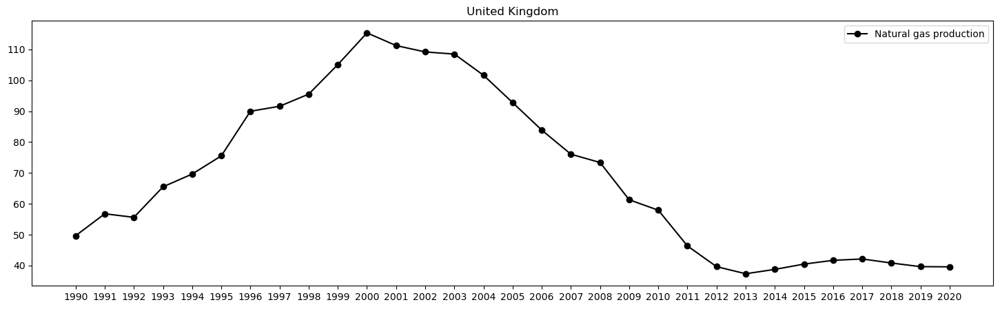

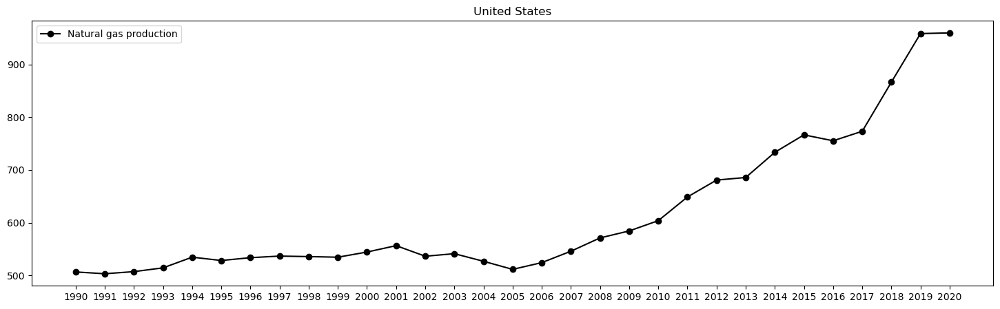

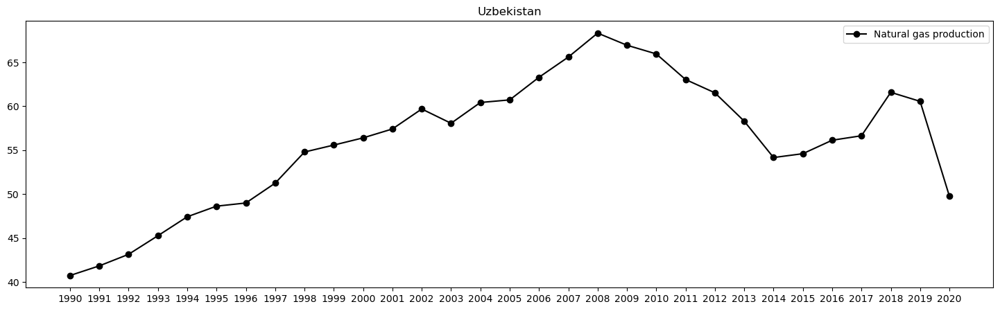

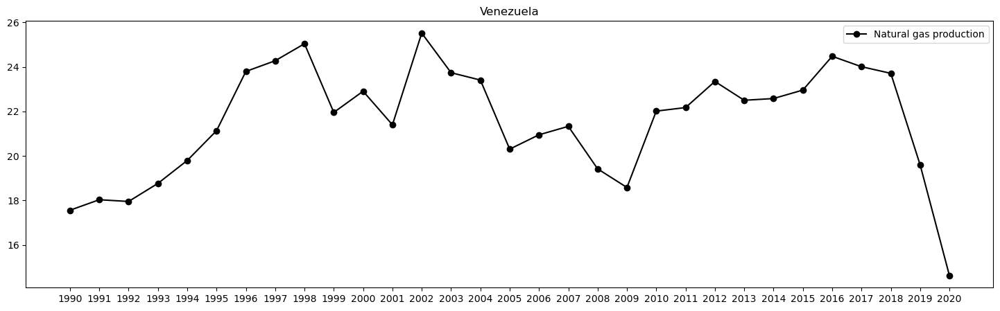

In [18]:
# descriptive analysis of Natural gas production (bcm)
for k in range(len(new)):
    plt.figure(figsize=(18,5))
    x_ticks= range(len(new[k]["Year"]))
    plt.plot(x_ticks,new[k]["Natural gas production (bcm)"], color= "black",label="Natural gas production", marker="o")
    plt.title(countries[k])
    plt.xticks(x_ticks,new[k]["Year"])
    plt.legend()
    plt.show()

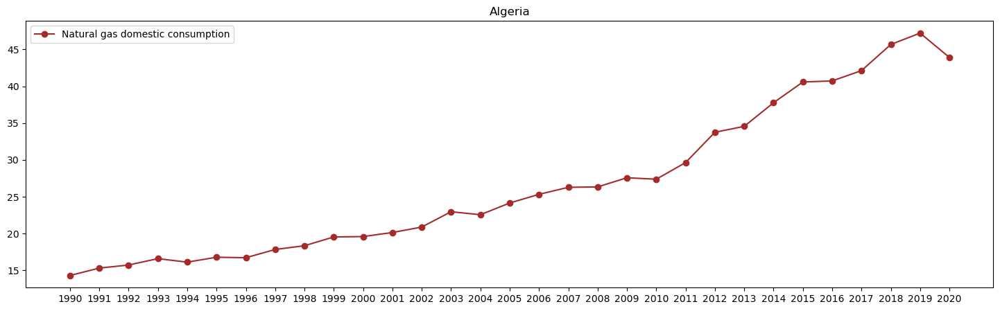

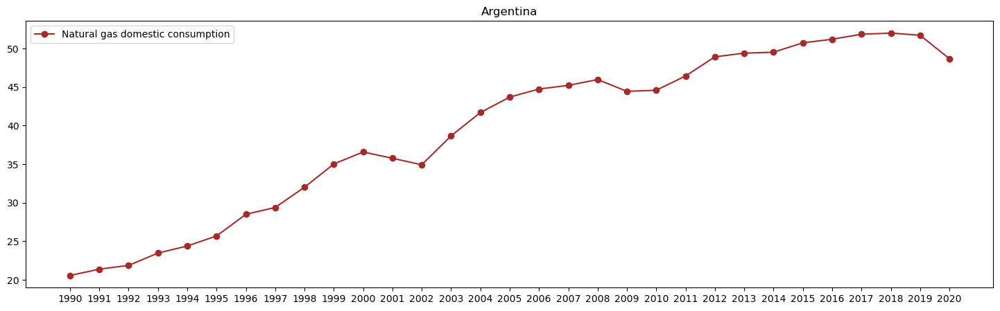

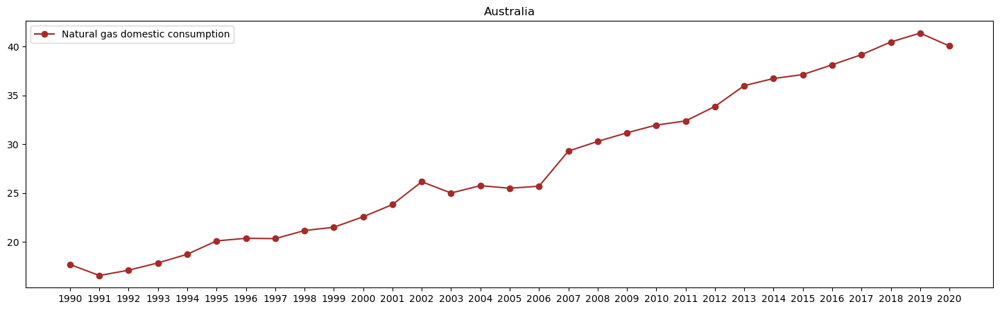

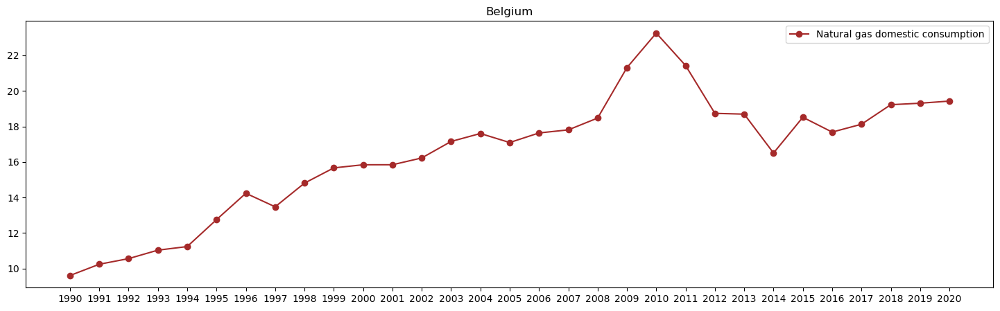

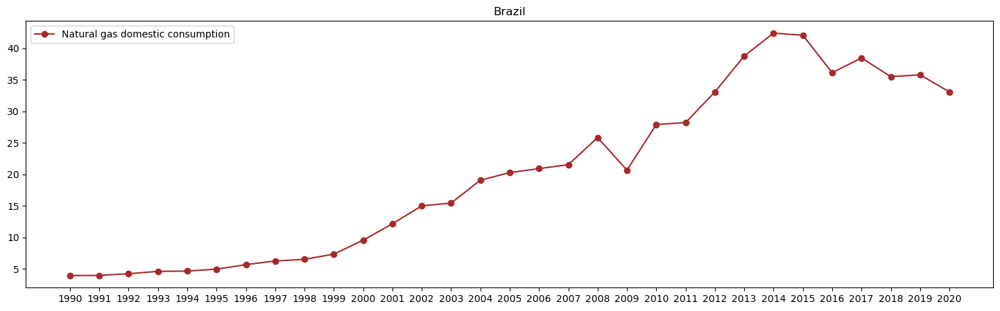

...

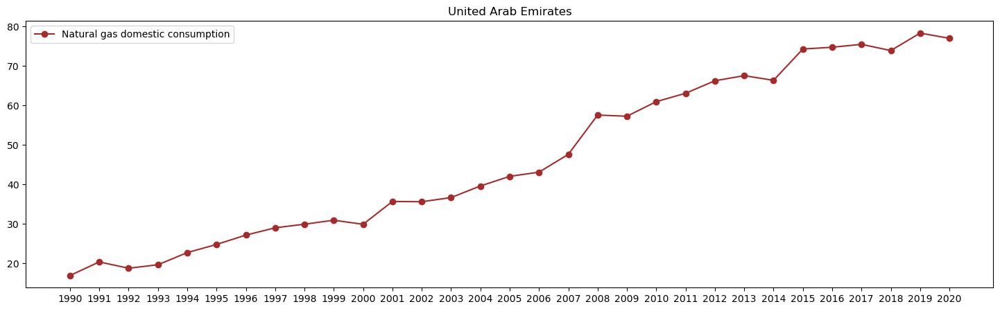

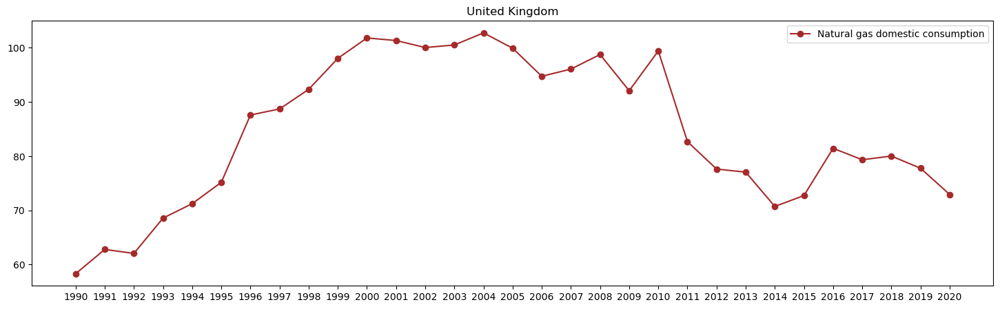

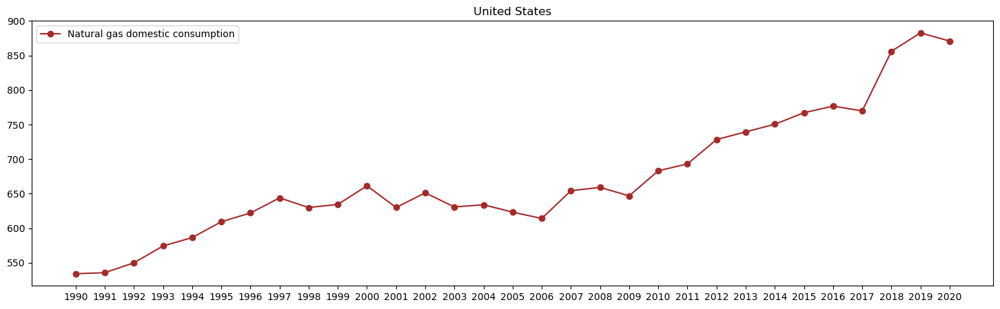

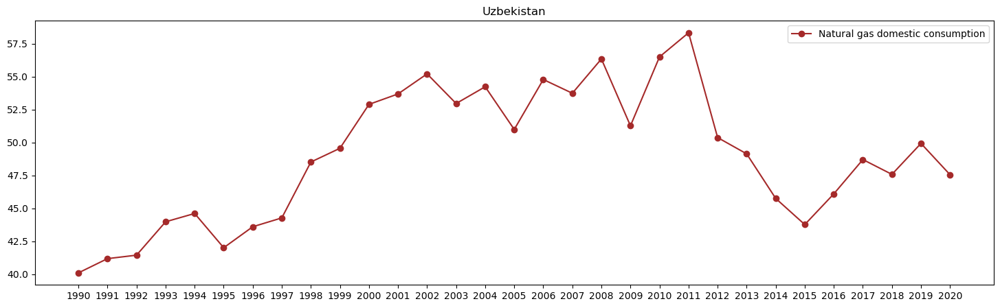

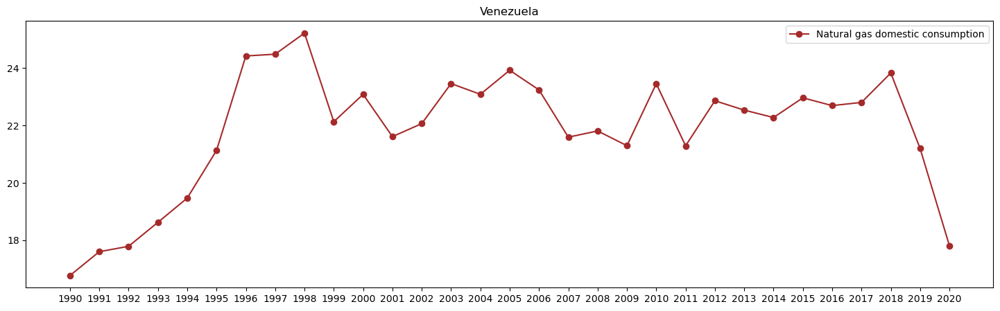

In [19]:
# descriptive analysis of Natural gas domestic consumption (bcm)
for k in range(len(new)):
    plt.figure(figsize=(18,5))
    x_ticks= range(len(new[k]["Year"]))
    plt.plot(x_ticks,new[k]["Natural gas domestic consumption (bcm)"], color= "brown",label="Natural gas domestic consumption", marker="o")
    plt.title(countries[k])
    plt.xticks(x_ticks,new[k]["Year"])
    plt.legend()
    plt.show()

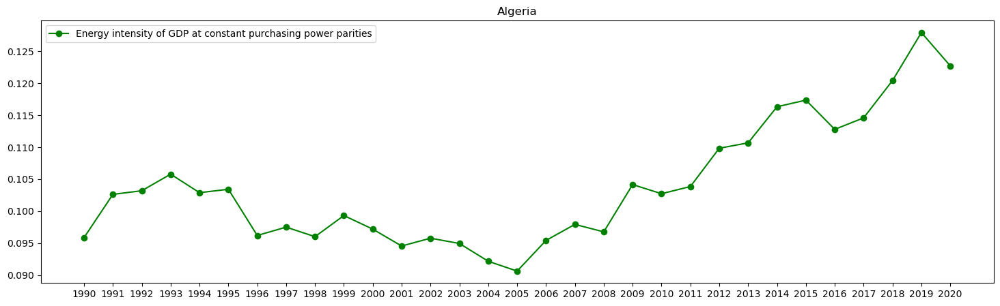

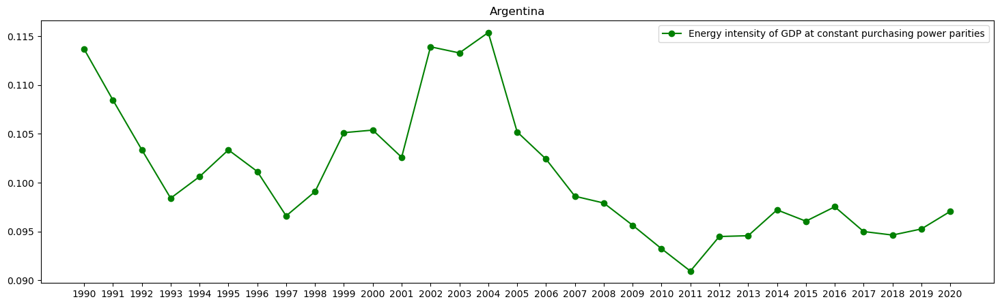

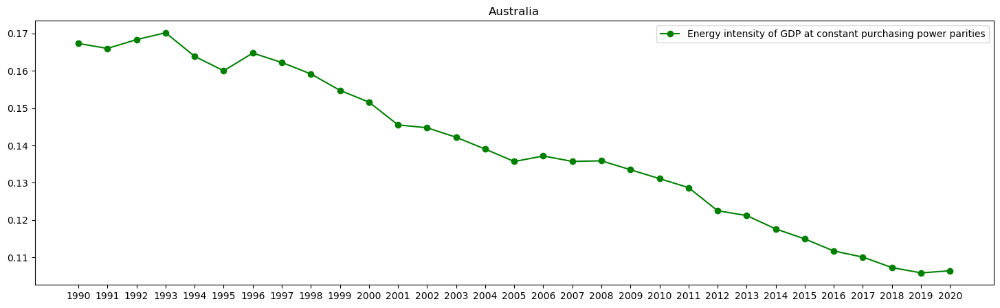

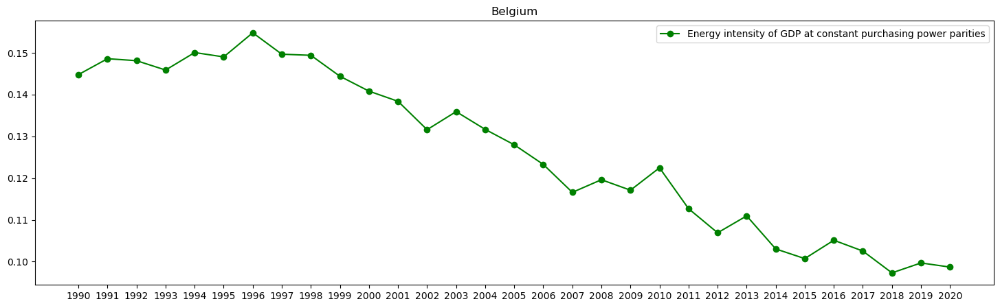

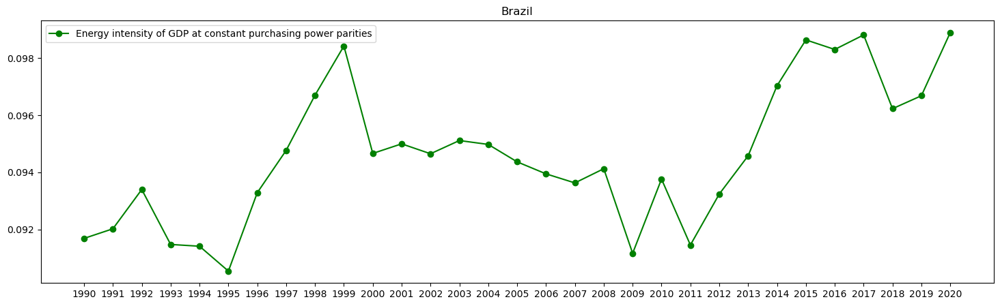

...

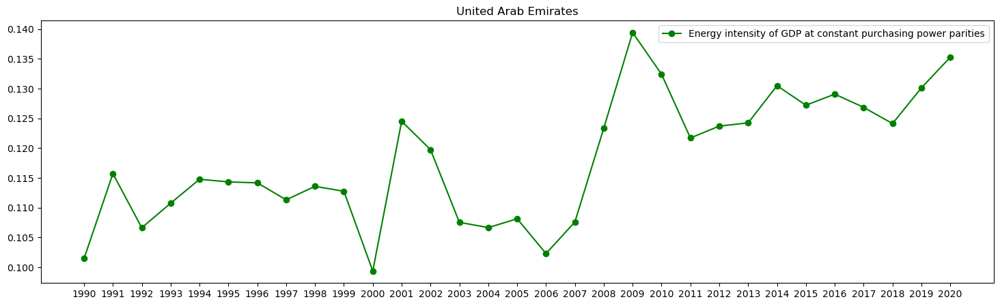

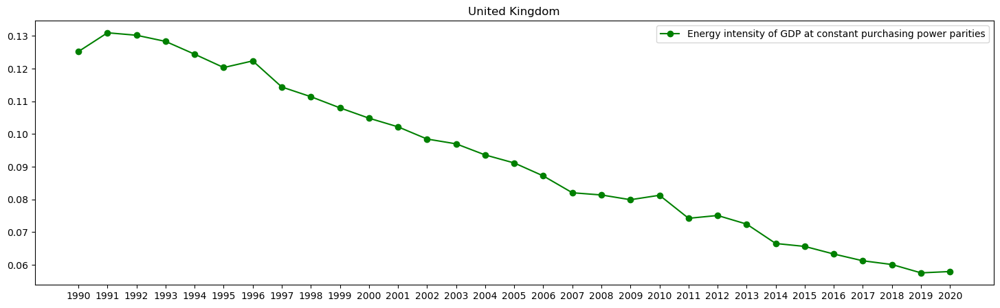

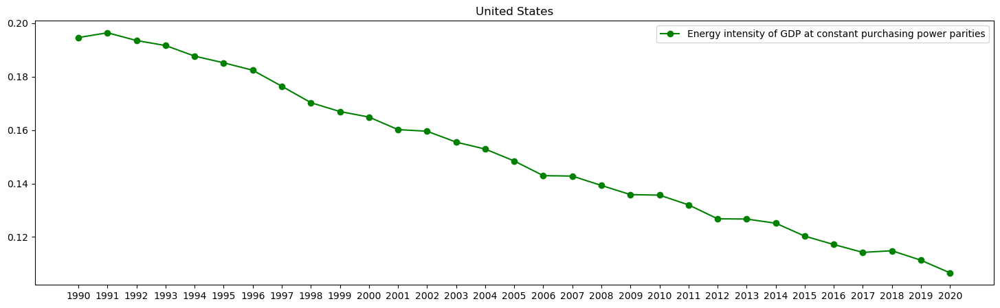

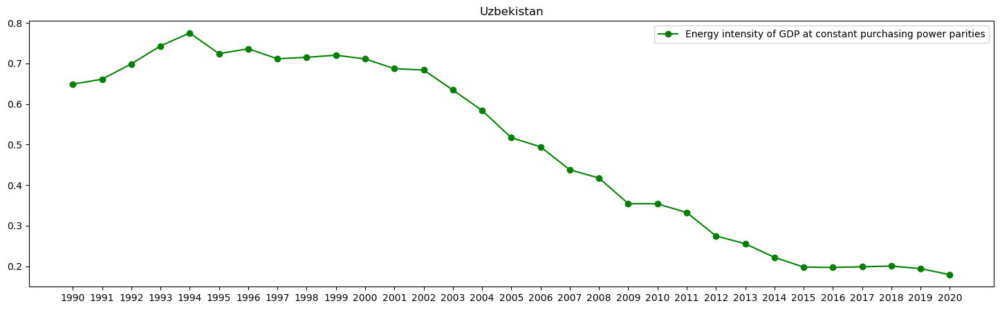

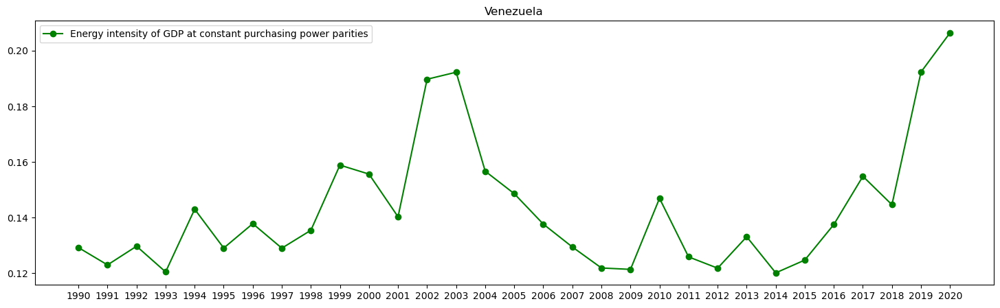

In [20]:
# descriptive analysis of Energy intensity of GDP at constant purchasing power parities (koe/$15p)
for k in range(len(new)):
    plt.figure(figsize=(18,5))
    x_ticks= range(len(new[k]["Year"]))
    plt.plot(x_ticks,new[k]["Energy intensity of GDP at constant purchasing power parities (koe/$15p)"], color= "green",label="Energy intensity of GDP at constant purchasing power parities", marker="o")
    plt.title(countries[k])
    plt.xticks(x_ticks,new[k]["Year"])
    plt.legend()
    plt.show()

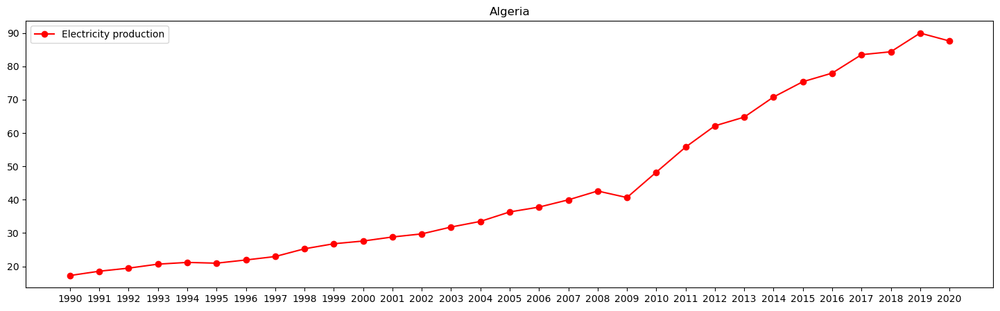

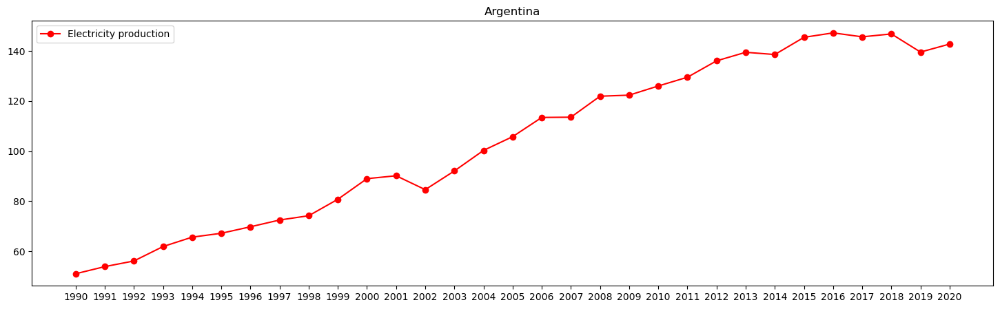

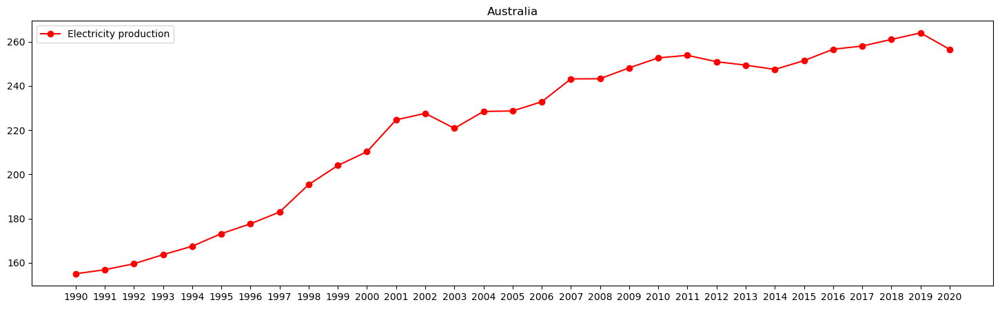

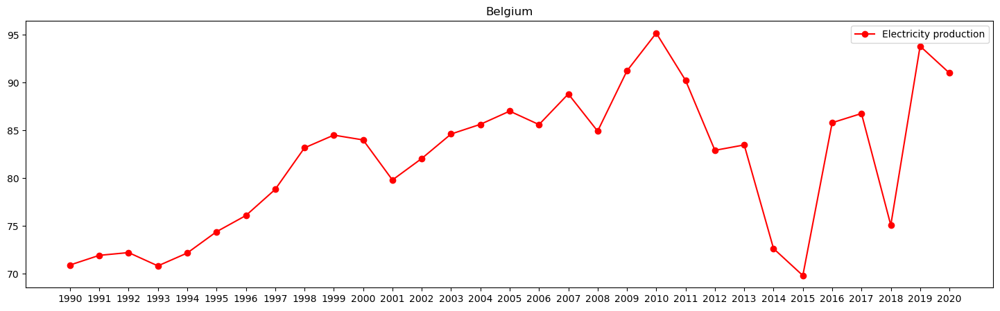

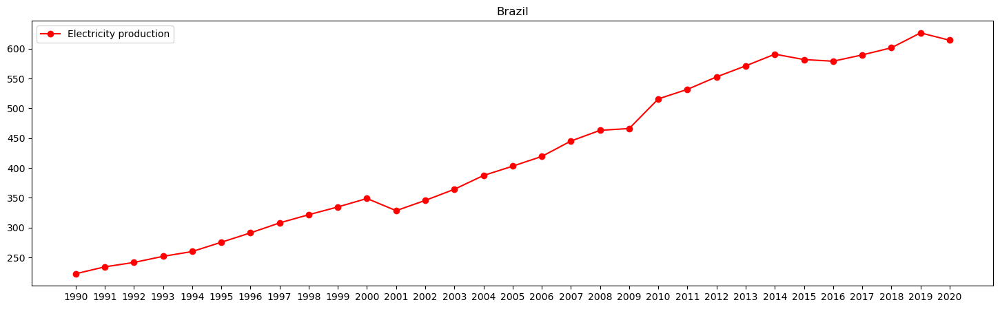

...

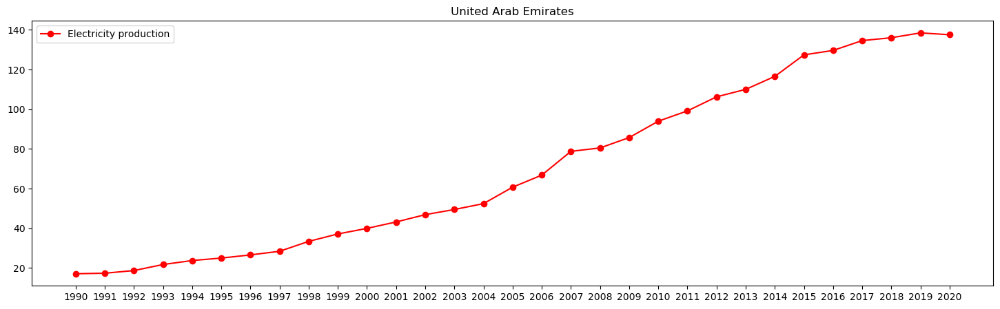

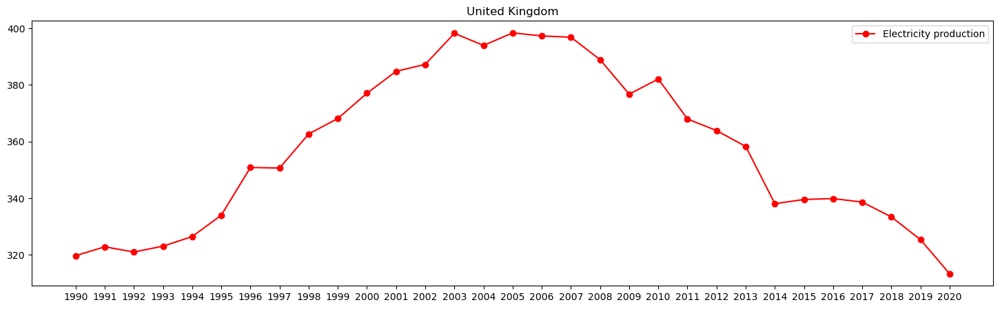

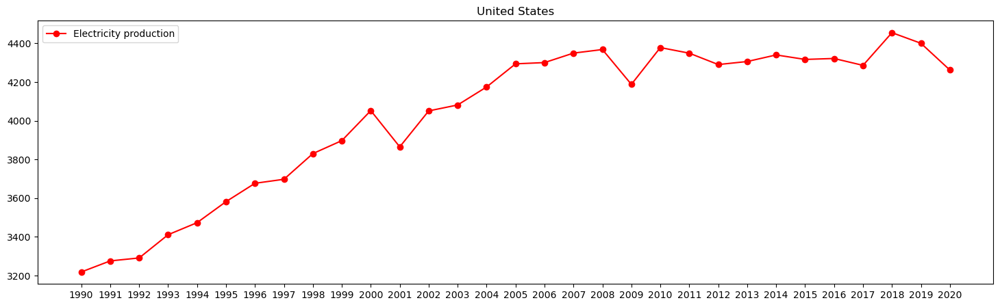

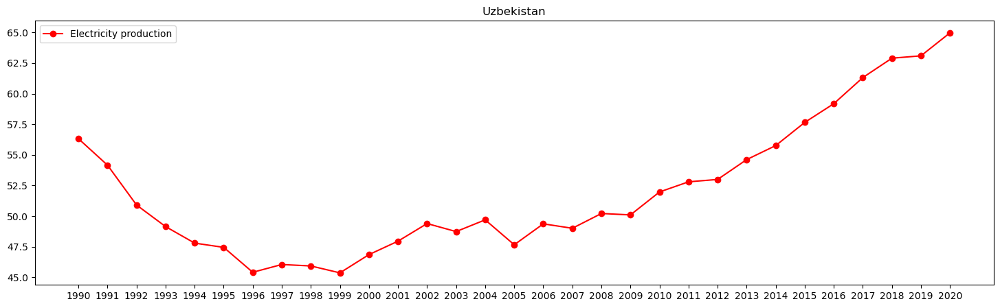

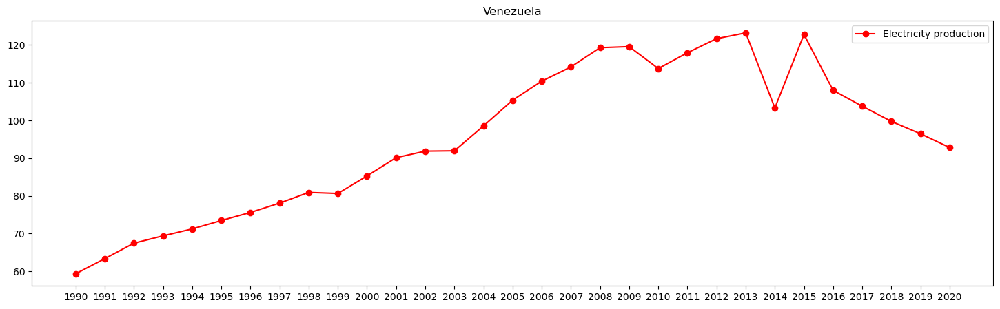

In [21]:
# descriptive analysis of Electricity production (TWh)
for k in range(len(new)):
    plt.figure(figsize=(18,5))
    x_ticks= range(len(new[k]["Year"]))
    plt.plot(x_ticks,new[k]["Electricity production (TWh)"], color= "red",label="Electricity production", marker="o")
    plt.title(countries[k])
    plt.xticks(x_ticks,new[k]["Year"])
    plt.legend()
    plt.show()

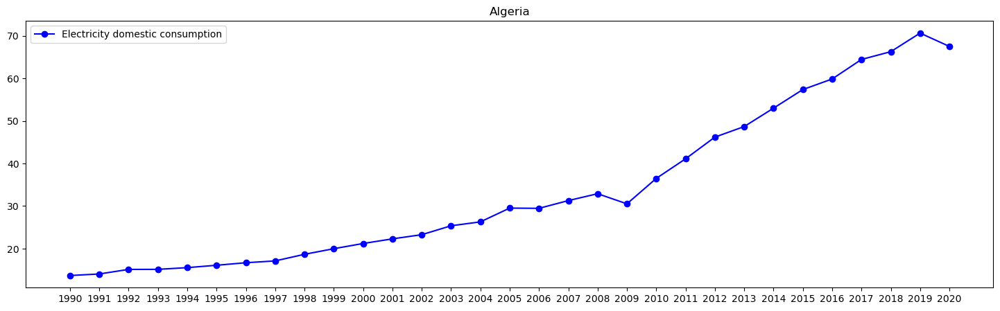

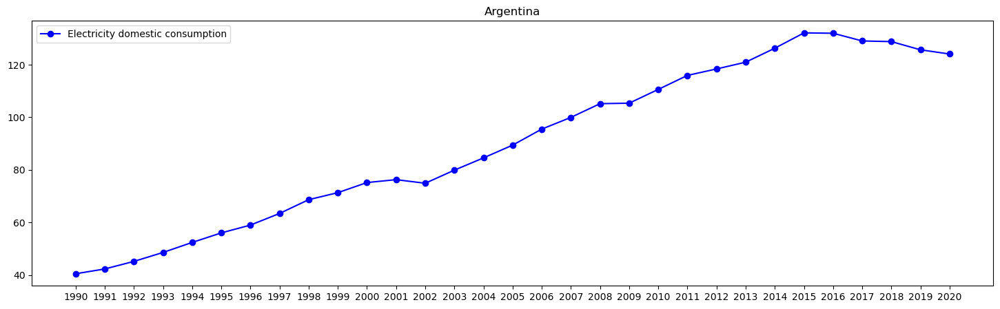

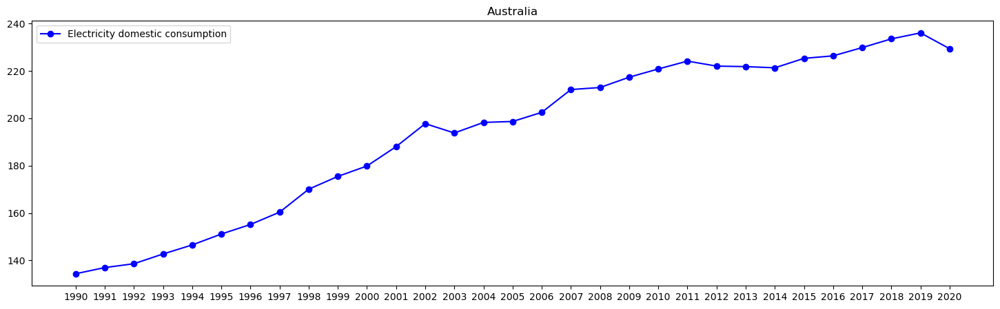

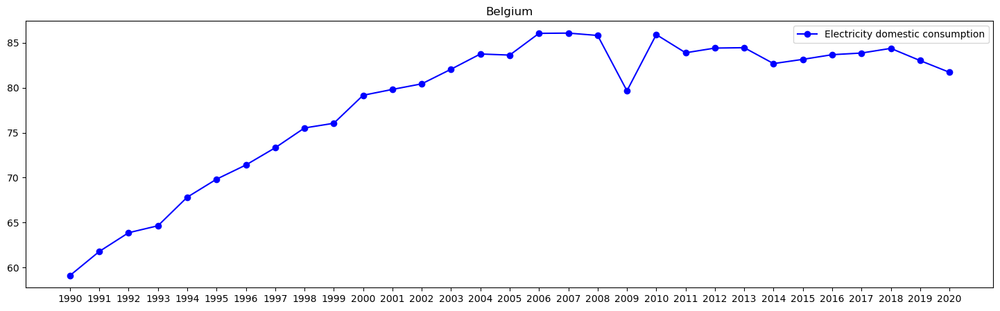

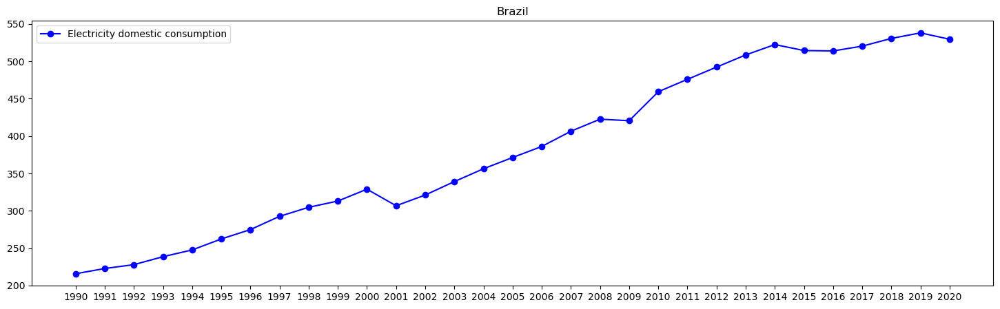

...

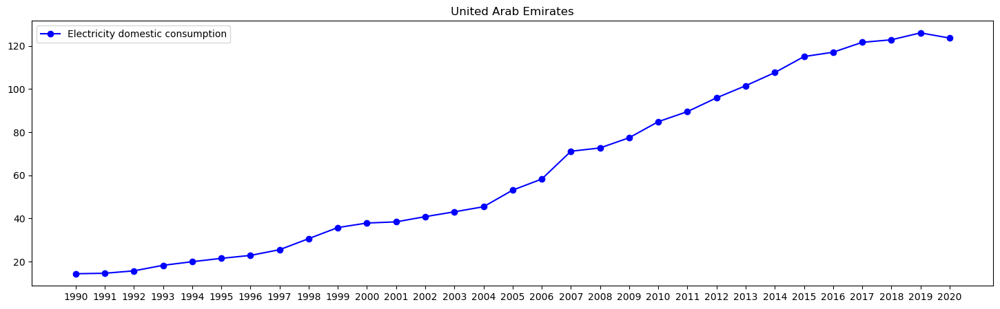

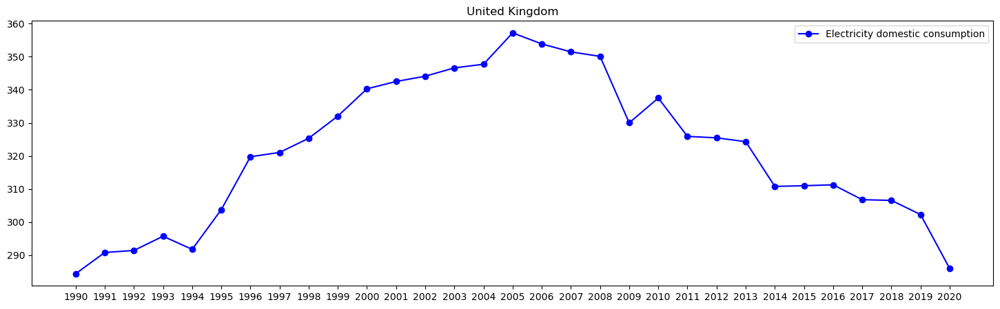

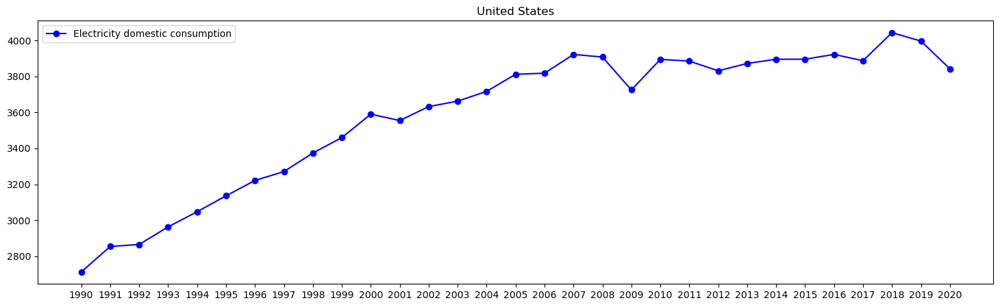

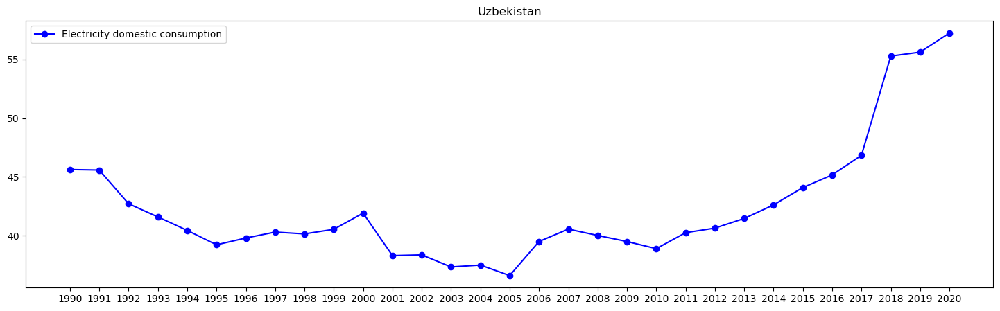

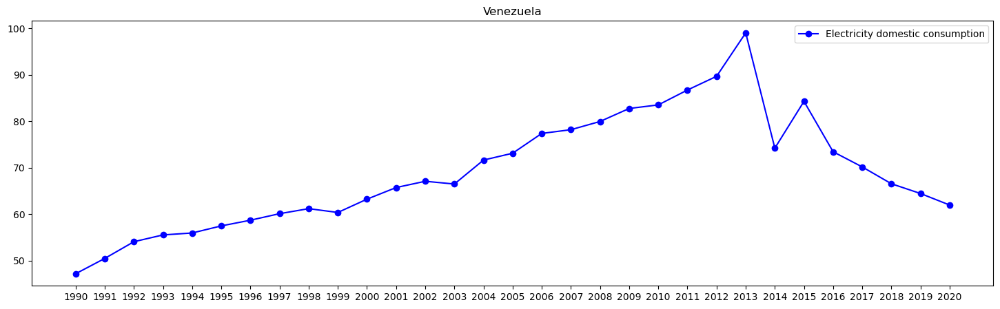

In [22]:
# descriptive analysis of Electricity domestic consumption (TWh)
for k in range(len(new)):
    plt.figure(figsize=(18,5))
    x_ticks= range(len(new[k]["Year"]))
    plt.plot(x_ticks,new[k]["Electricity domestic consumption (TWh)"], color= "blue",label="Electricity domestic consumption", marker="o")
    plt.title(countries[k])
    plt.xticks(x_ticks,new[k]["Year"])
    plt.legend()
    plt.show()

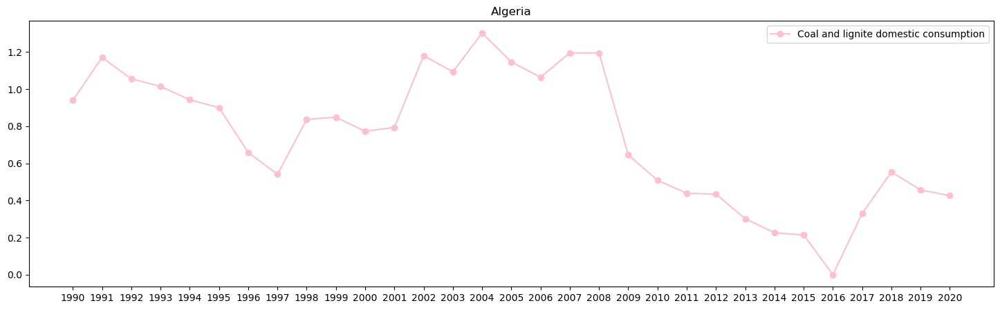

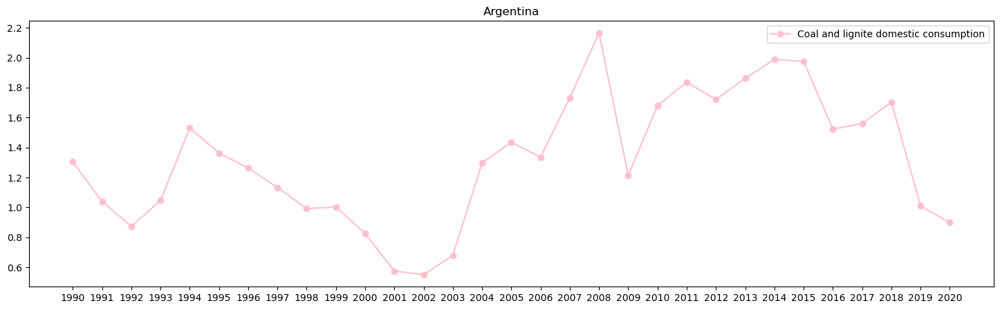

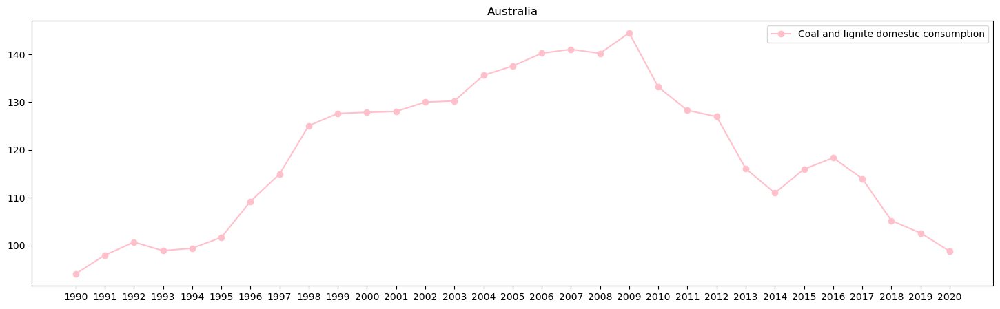

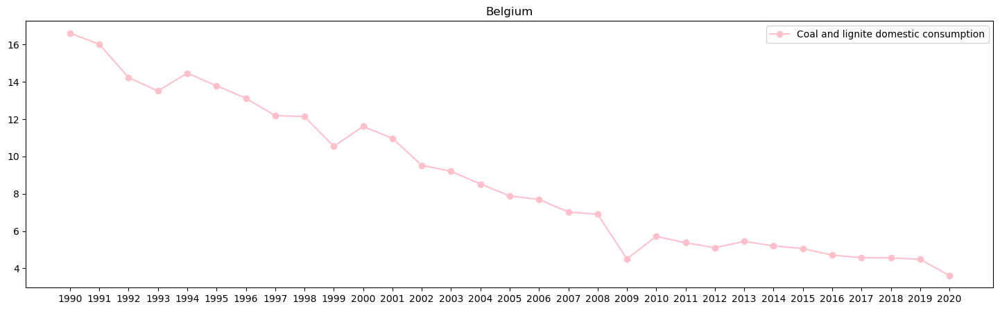

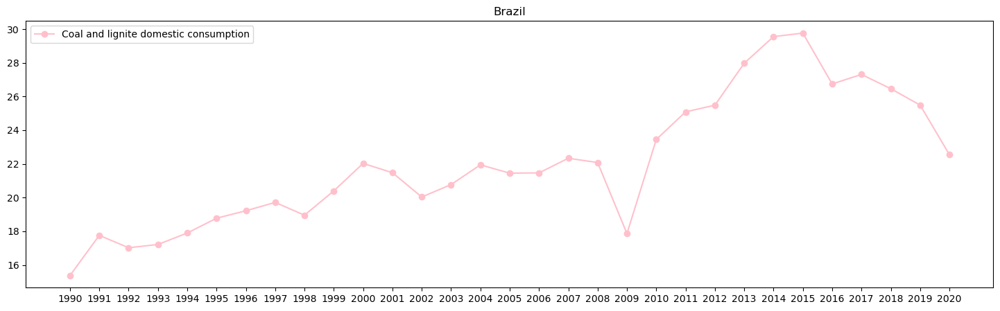

...

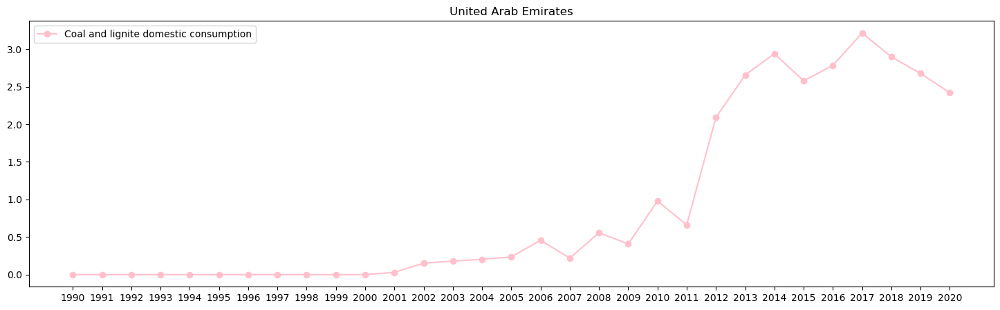

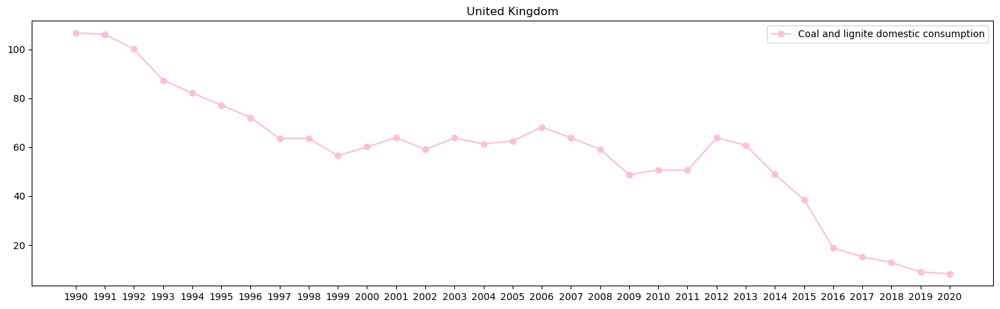

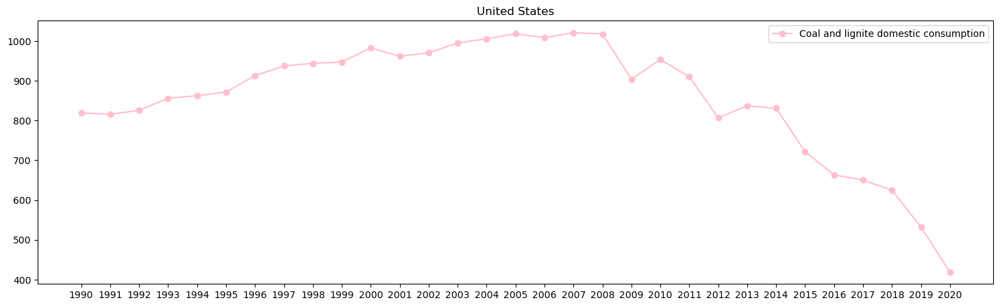

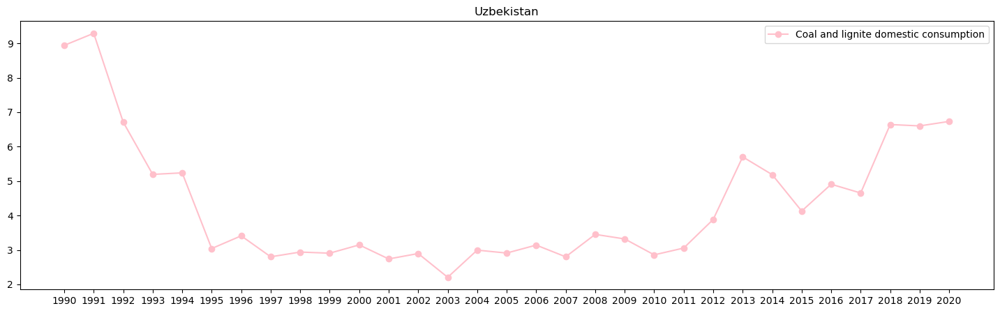

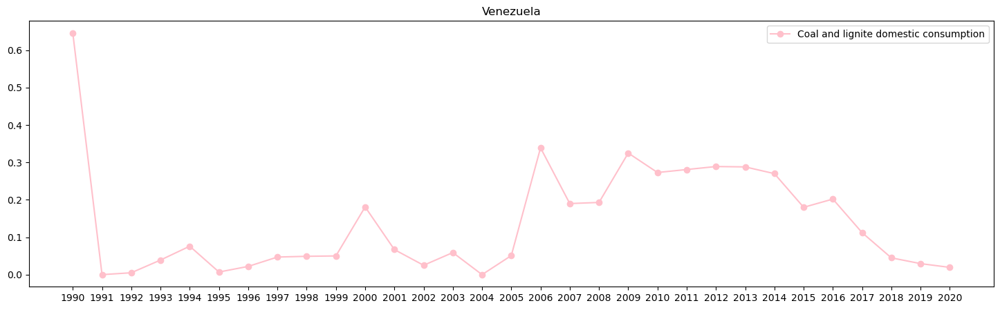

In [23]:
# descriptive analysis of Coal and lignite domestic consumption (Mt)
for k in range(len(new)):
    plt.figure(figsize=(18,5))
    x_ticks= range(len(new[k]["Year"]))
    plt.plot(x_ticks,new[k]["Coal and lignite domestic consumption (Mt)"], color= "pink",label="Coal and lignite domestic consumption", marker="o")
    plt.title(countries[k])
    plt.xticks(x_ticks,new[k]["Year"])
    plt.legend()
    plt.show()

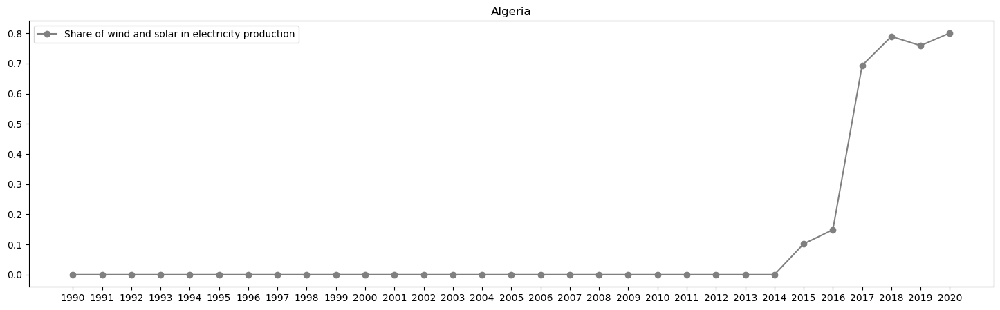

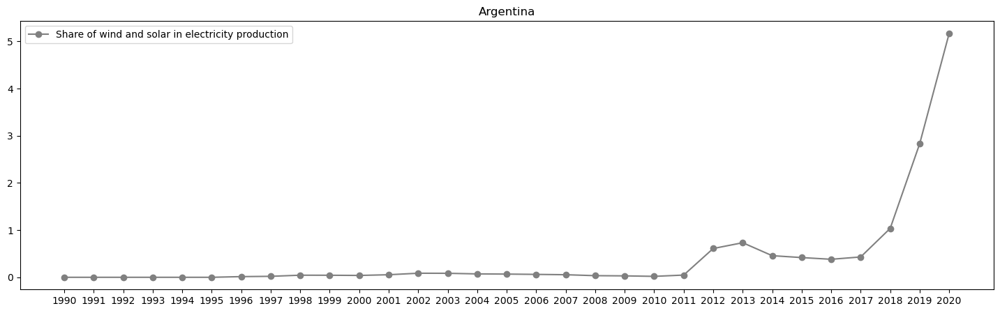

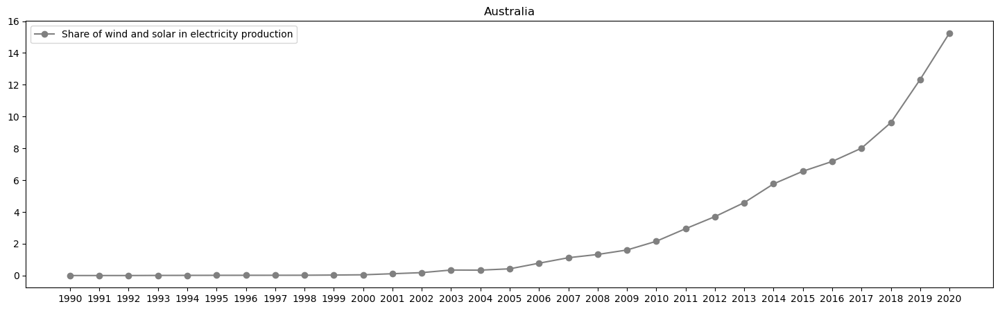

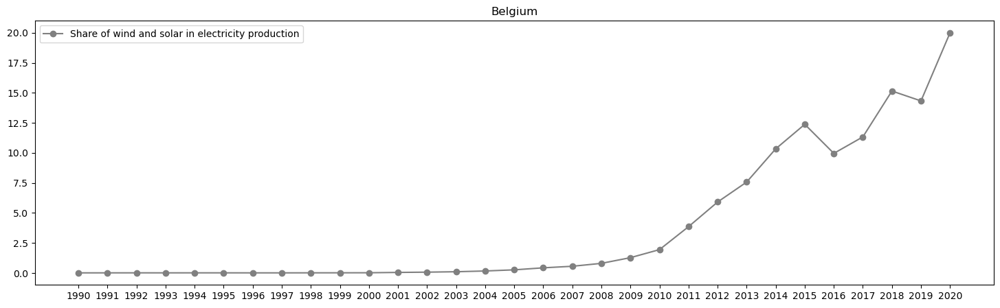

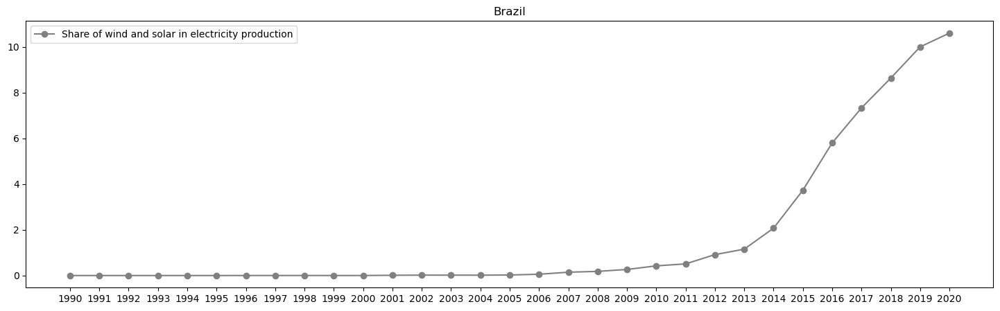

...

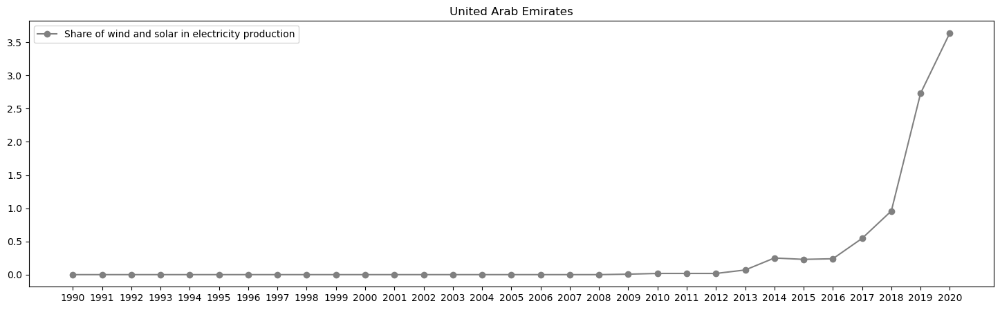

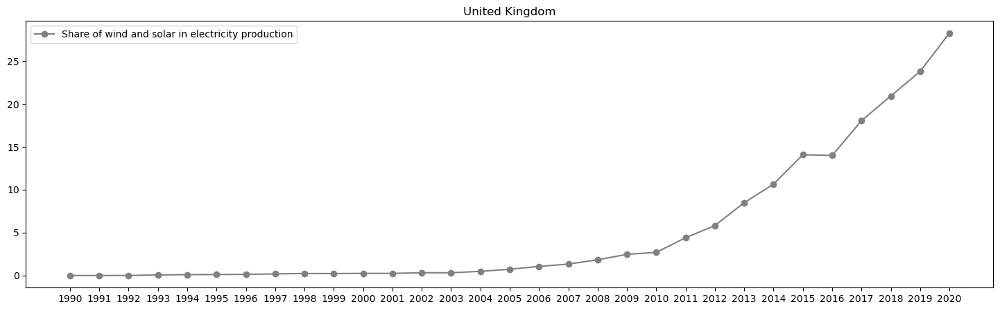

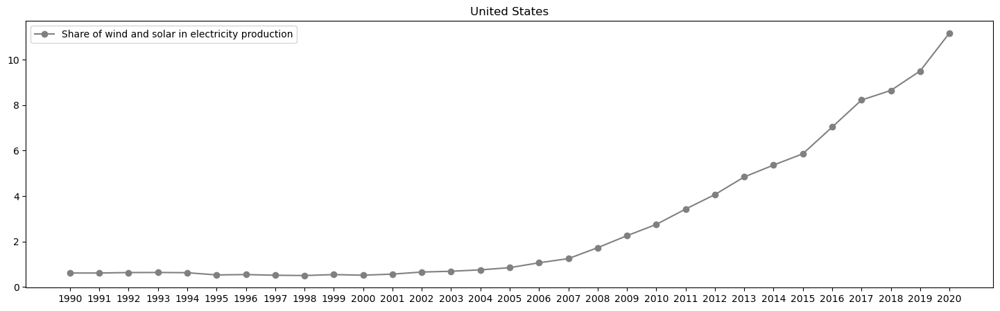

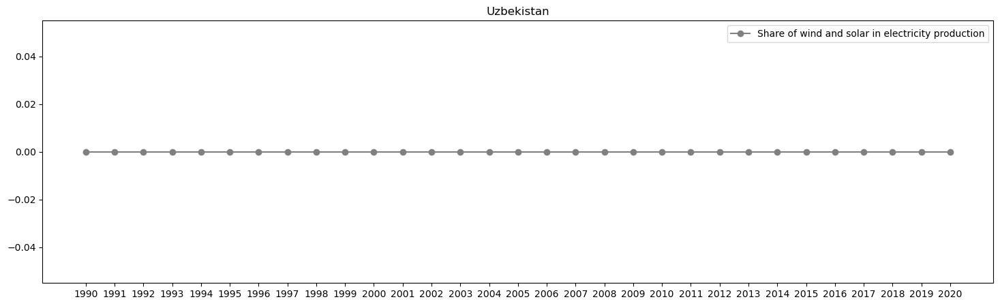

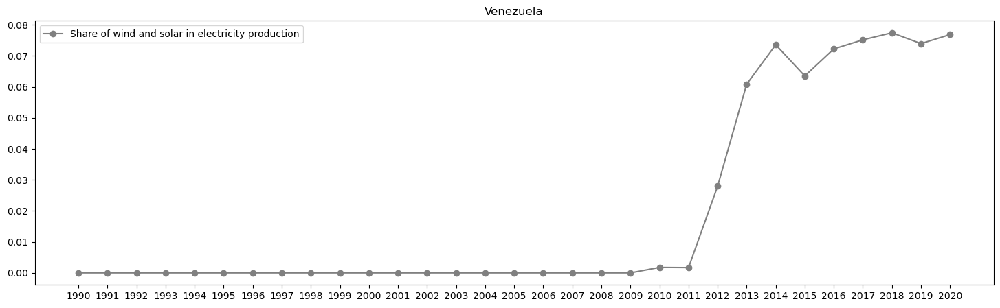

In [24]:
# descriptive analysis of Share of wind and solar in electricity production (%)
for k in range(len(new)):
    plt.figure(figsize=(18,5))
    x_ticks= range(len(new[k]["Year"]))
    plt.plot(x_ticks,new[k]["Share of wind and solar in electricity production (%)"], color= "grey",label="Share of wind and solar in electricity production", marker="o")
    plt.title(countries[k])
    plt.xticks(x_ticks,new[k]["Year"])
    plt.legend()
    plt.show()

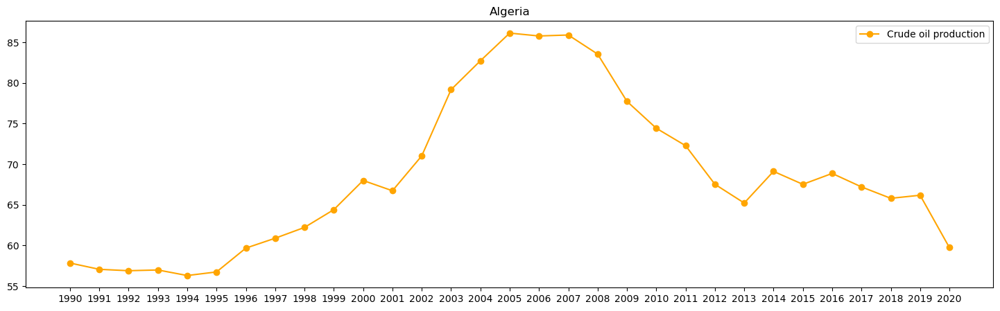

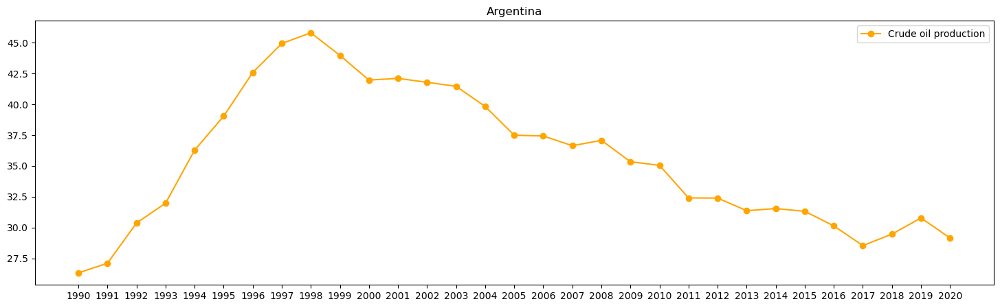

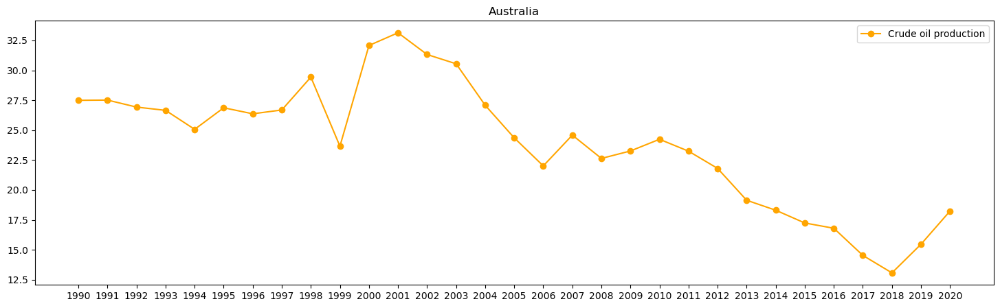

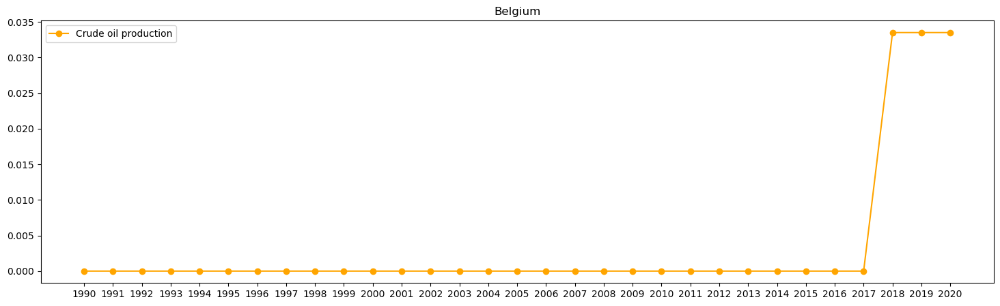

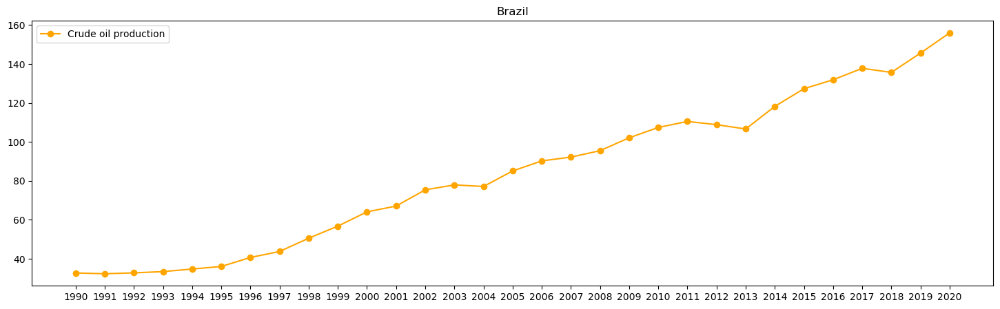

...

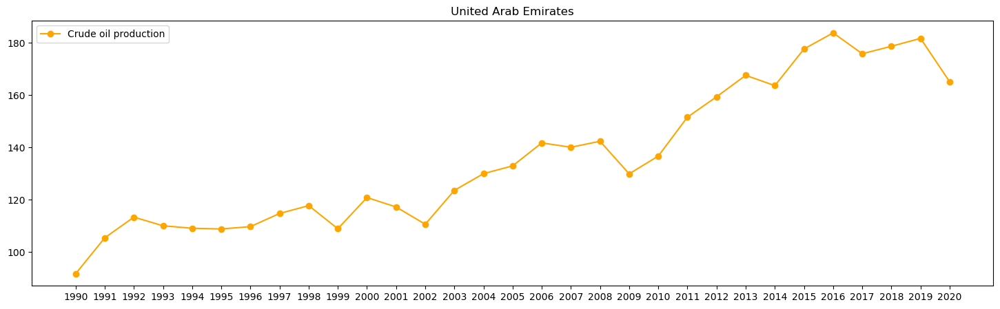

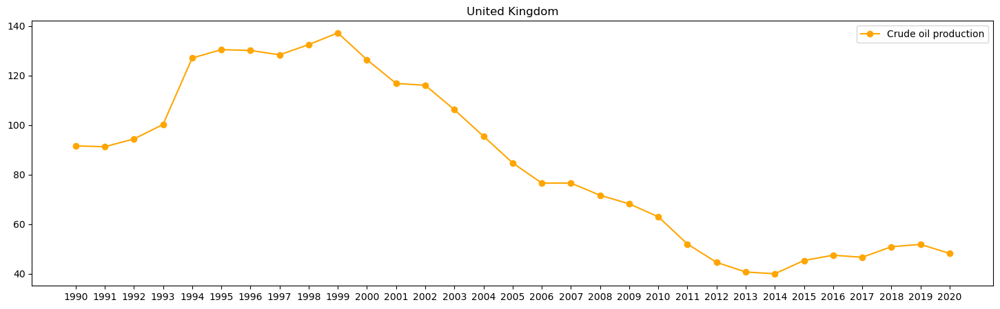

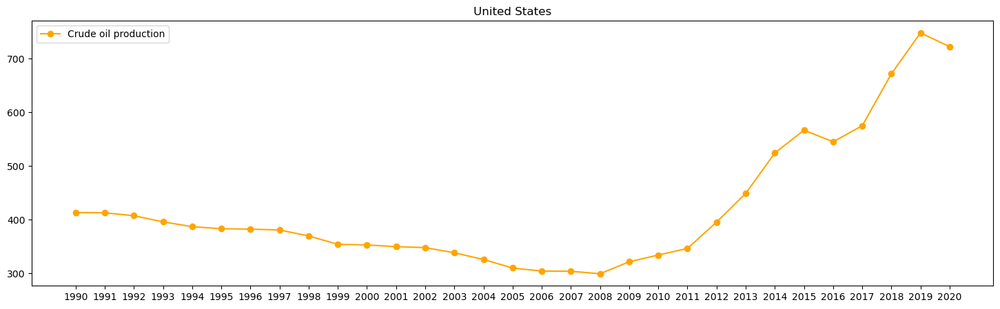

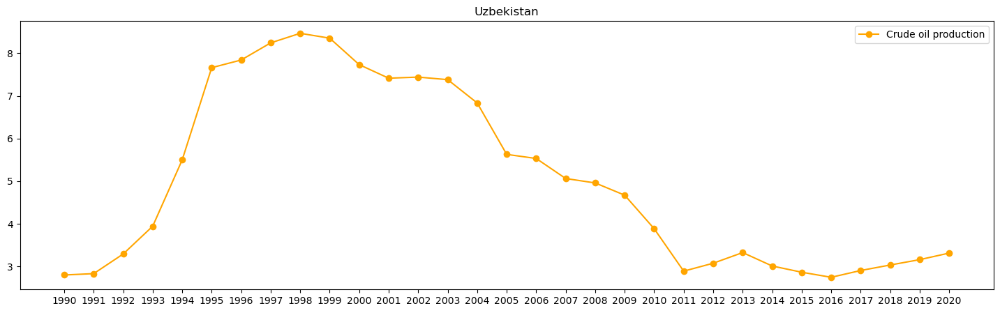

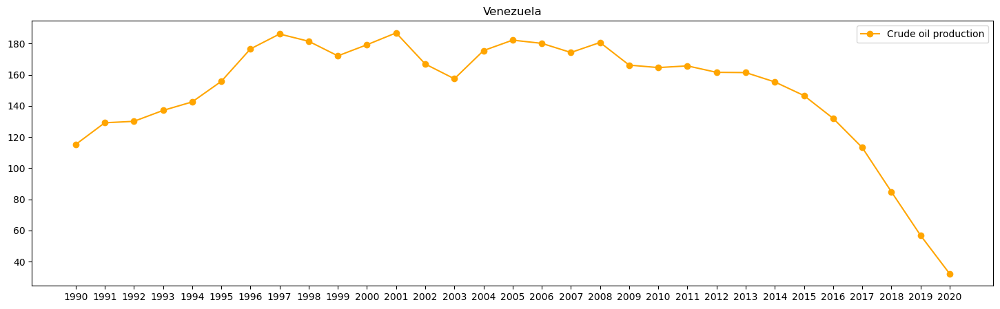

In [25]:
# descriptive analysis of Crude oil production (Mt)
for k in range(len(new)):
    plt.figure(figsize=(18,5))
    x_ticks= range(len(new[k]["Year"]))
    plt.plot(x_ticks,new[k]["Crude oil production (Mt)"], color= "orange",label="Crude oil production", marker="o")
    plt.title(countries[k])
    plt.xticks(x_ticks,new[k]["Year"])
    plt.legend()
    plt.show()

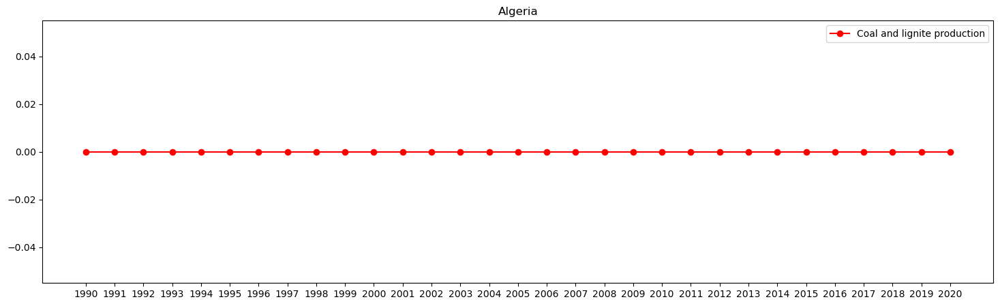

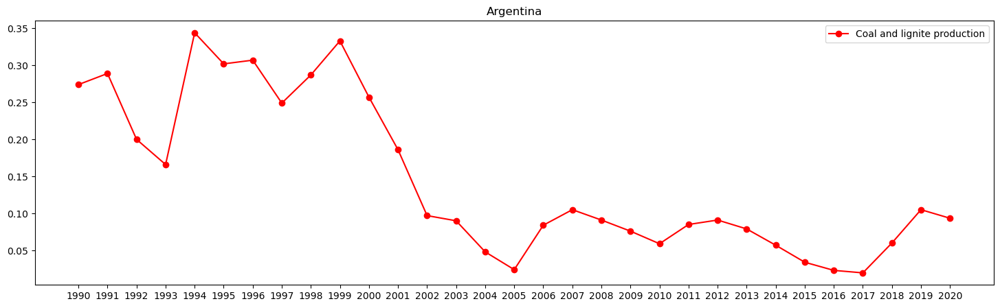

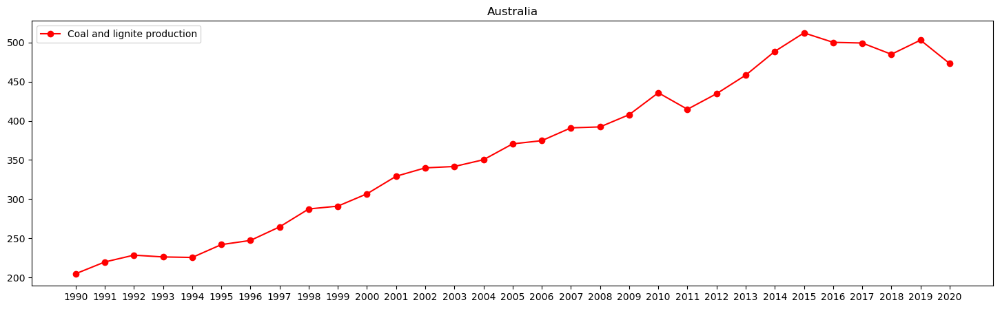

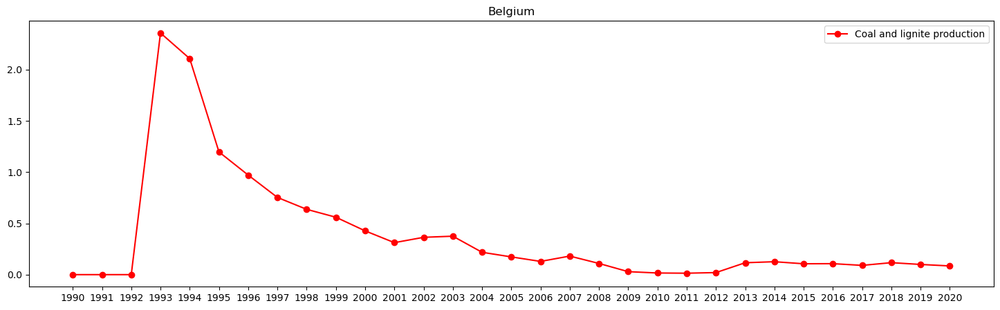

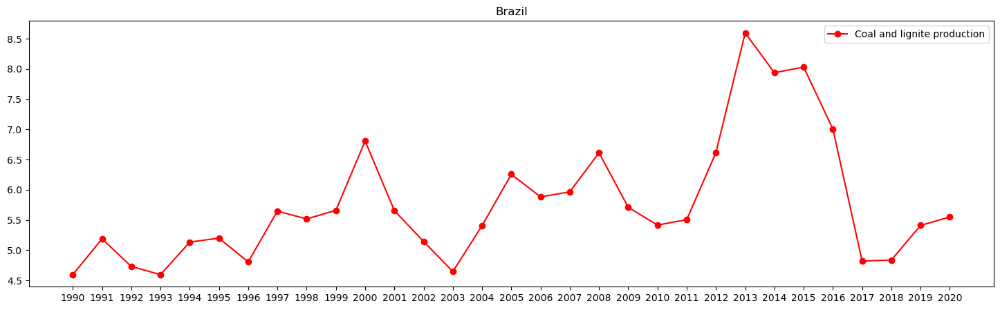

...

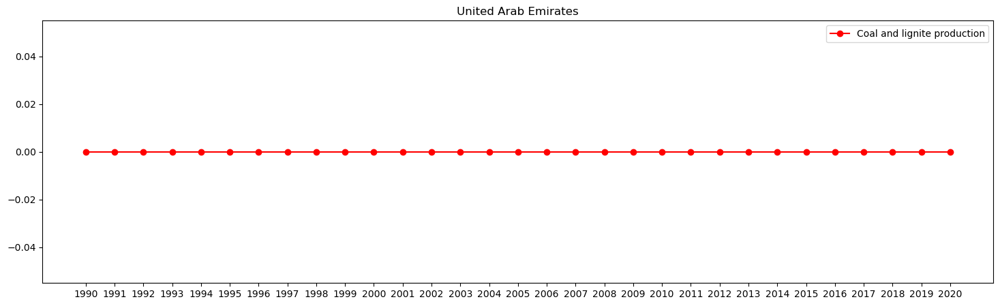

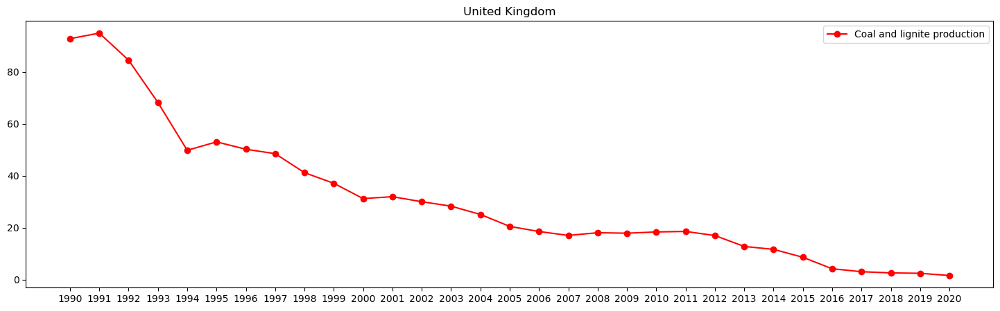

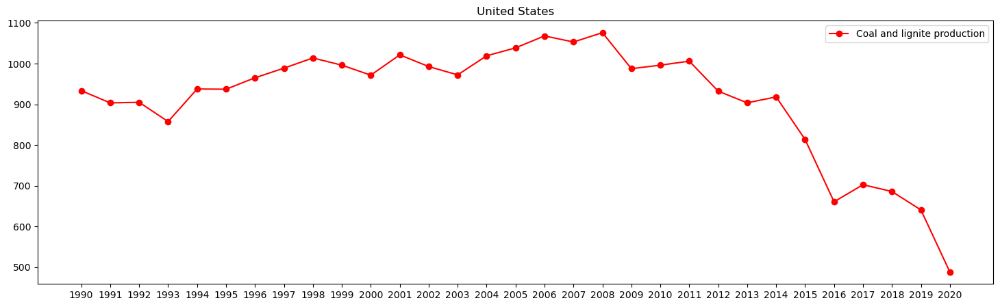

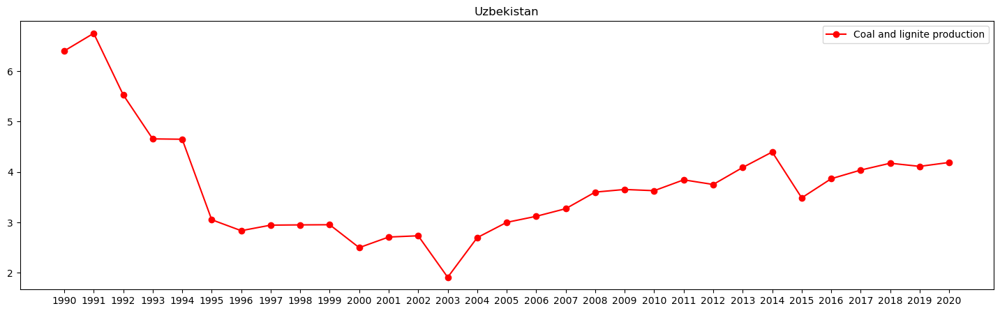

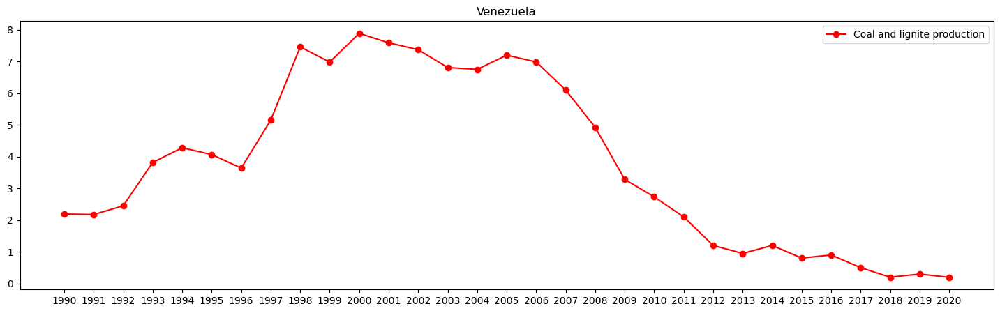

In [26]:
# descriptive analysis of Coal and lignite production (Mt)
for k in range(len(new)):
    plt.figure(figsize=(18,5))
    x_ticks= range(len(new[k]["Year"]))
    plt.plot(x_ticks,new[k]["Coal and lignite production (Mt)"], color= "red",label="Coal and lignite production", marker="o")
    plt.title(countries[k])
    plt.xticks(x_ticks,new[k]["Year"])
    plt.legend()
    plt.show()

In [27]:
print(new[0].info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 31 entries, 0 to 30
Data columns (total 19 columns):
 #   Column                                                                    Non-Null Count  Dtype  
---  ------                                                                    --------------  -----  
 0   Year                                                                      31 non-null     int64  
 1   CO2 emissions from fuel combustion (MtCO2)                                31 non-null     float64
 2   Average CO2 emission factor (tCO2/toe)                                    31 non-null     float64
 3   CO2 intensity at constant purchasing power parities (kCO2/$15p)           31 non-null     float64
 4   Total energy production (Mtoe)                                            31 non-null     float64
 5   Total energy consumption (Mtoe)                                           31 non-null     float64
 6   Share of renewables in electricity production (%)                   

In [28]:
print(new[0])

    Year  CO2 emissions from fuel combustion (MtCO2)  \
0   1990                                   52.981921   
1   1991                                   57.149971   
2   1992                                   57.262430   
3   1993                                   59.198702   
4   1994                                   56.347927   
5   1995                                   56.828812   
6   1996                                   56.165721   
7   1997                                   58.074674   
8   1998                                   59.494429   
9   1999                                   63.247065   
10  2000                                   64.229802   
11  2001                                   65.741657   
12  2002                                   71.676793   
13  2003                                   74.895378   
14  2004                                   75.982042   
15  2005                                   80.336165   
16  2006                                   83.44

In [29]:
for index,m in enumerate(new):
    if m.isnull().values.any()==False:
        print(index)
#print(new[19])


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43


In [30]:
new_data=[]
for j in new:
    j= j.drop("Year", axis=1)
    j["Surplus energy production"]= j["Total energy production (Mtoe)"]- j["Total energy consumption (Mtoe)"]
    j= j.drop(columns=["Total energy production (Mtoe)","Total energy consumption (Mtoe)"])
    j["Surplus oil production"]= j["Refined oil products production (Mt)"]- j["Oil products domestic consumption (Mt)"]
    j= j.drop(columns=["Refined oil products production (Mt)","Oil products domestic consumption (Mt)"])
    j["Surplus natural gas production"]= j["Natural gas production (bcm)"]-j["Natural gas domestic consumption (bcm)"]
    j= j.drop(columns=["Natural gas production (bcm)","Natural gas domestic consumption (bcm)"])
    j["Surplus electricity production"]= j["Electricity production (TWh)"]- j["Electricity domestic consumption (TWh)"]
    j= j.drop(columns=["Electricity production (TWh)","Electricity domestic consumption (TWh)"])
    j["Surplus coal and lignite production"]= j["Coal and lignite production (Mt)"]-j["Coal and lignite domestic consumption (Mt)"]
    j= j.drop(columns=["Coal and lignite production (Mt)","Coal and lignite domestic consumption (Mt)"])
    new_data.append(j)
print(new_data[0].info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 31 entries, 0 to 30
Data columns (total 13 columns):
 #   Column                                                                    Non-Null Count  Dtype  
---  ------                                                                    --------------  -----  
 0   CO2 emissions from fuel combustion (MtCO2)                                31 non-null     float64
 1   Average CO2 emission factor (tCO2/toe)                                    31 non-null     float64
 2   CO2 intensity at constant purchasing power parities (kCO2/$15p)           31 non-null     float64
 3   Share of renewables in electricity production (%)                         31 non-null     float64
 4   Share of electricity in total final energy consumption (%)                31 non-null     float64
 5   Energy intensity of GDP at constant purchasing power parities (koe/$15p)  31 non-null     float64
 6   Share of wind and solar in electricity production (%)               

In [31]:
print(new_data[0].corr())

                                                    CO2 emissions from fuel combustion (MtCO2)  \
CO2 emissions from fuel combustion (MtCO2)                                            1.000000   
Average CO2 emission factor (tCO2/toe)                                               -0.425332   
CO2 intensity at constant purchasing power pari...                                    0.830322   
Share of renewables in electricity production (%)                                    -0.137124   
Share of electricity in total final energy cons...                                    0.780079   
Energy intensity of GDP at constant purchasing ...                                    0.827813   
Share of wind and solar in electricity producti...                                    0.682218   
Crude oil production (Mt)                                                             0.200768   
Surplus energy production                                                            -0.044906   
Surplus oil producti

In [32]:
from sklearn.model_selection import train_test_split

#train_data=[]
#test_data=[]
#for u in new_data:
#    train, test= train_test_split(u, test_size=0.2, random_state= 32)
#    train_data.append(train)
#    test_data.append(test)
#print(len(train_data[0]))
#print(len(test_data[0]))
#print(len(train_data))
#print(len(test_data))

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


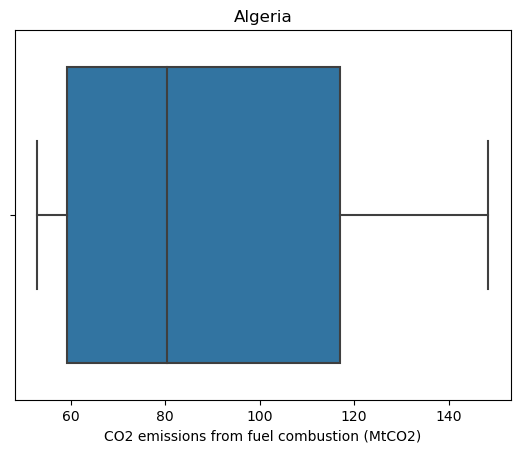

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


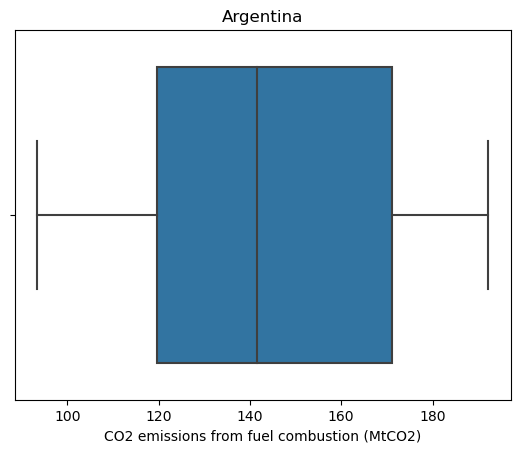

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


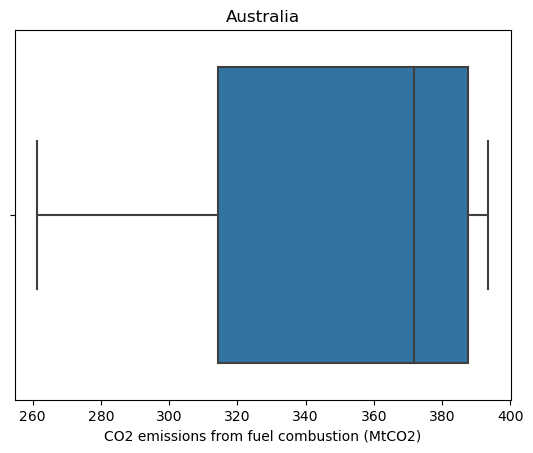

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


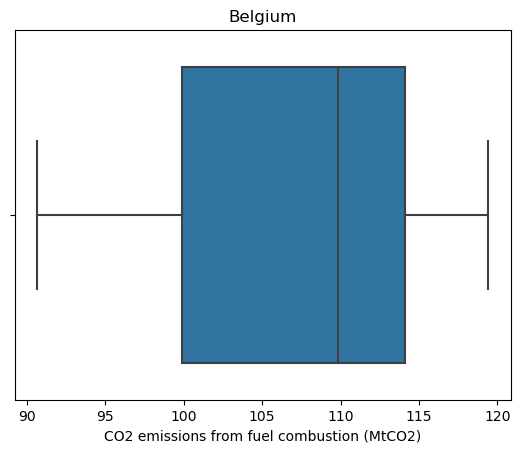

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


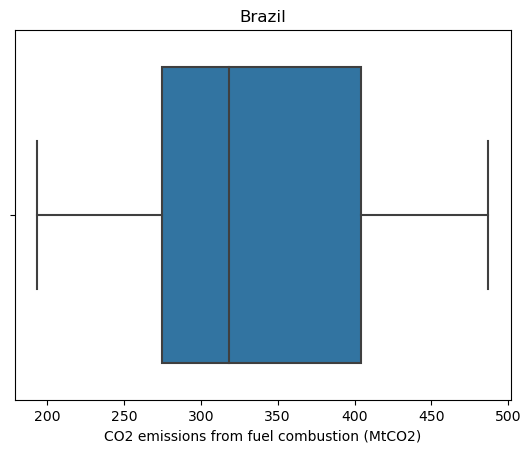

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


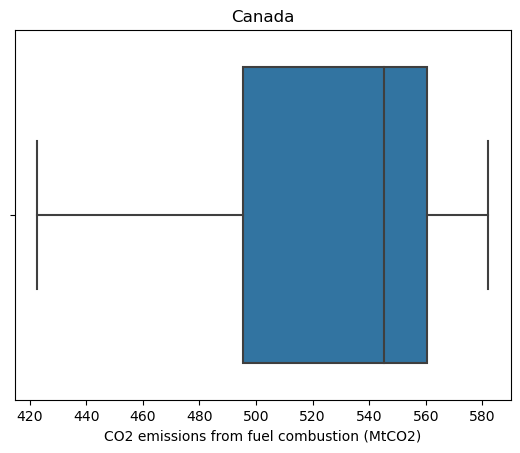

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


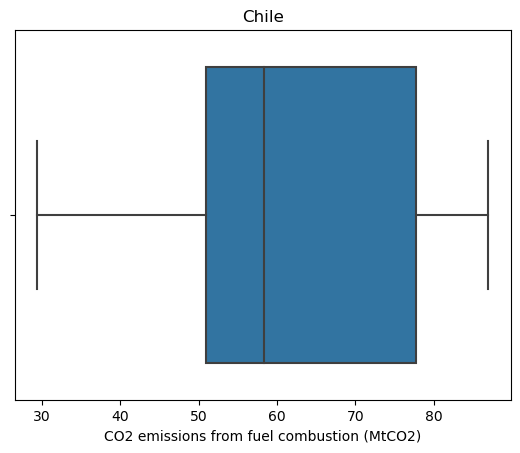

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


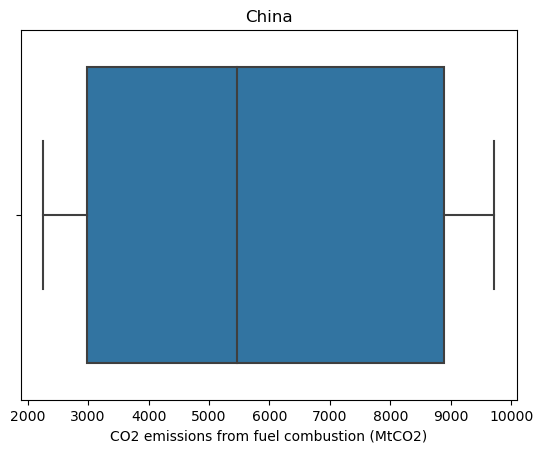

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


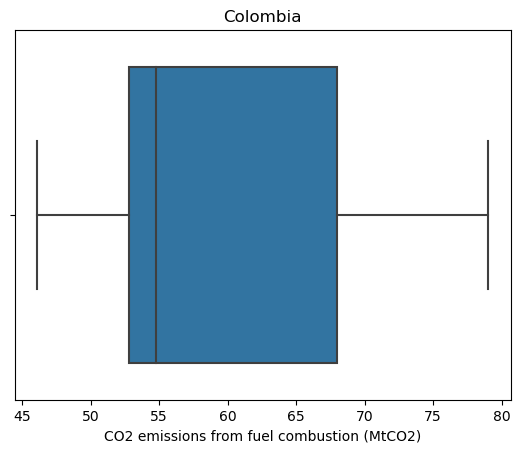

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


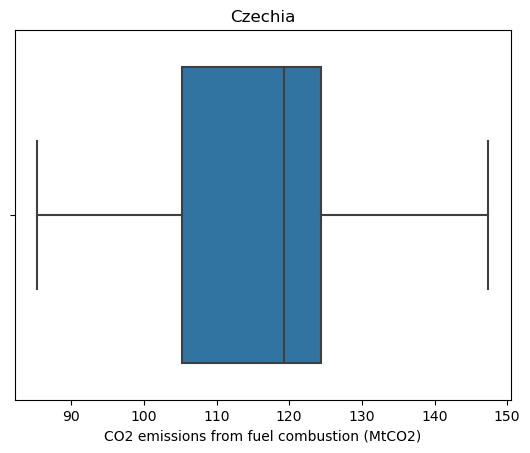

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


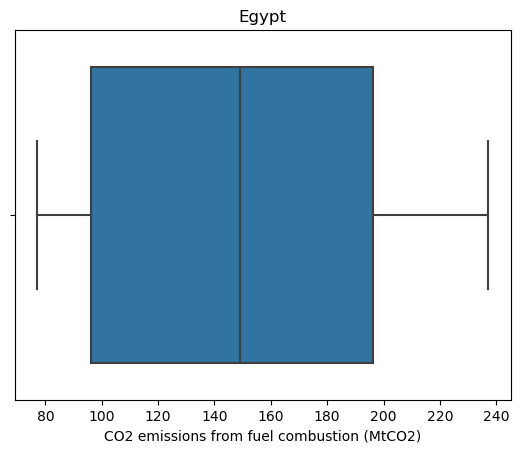

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


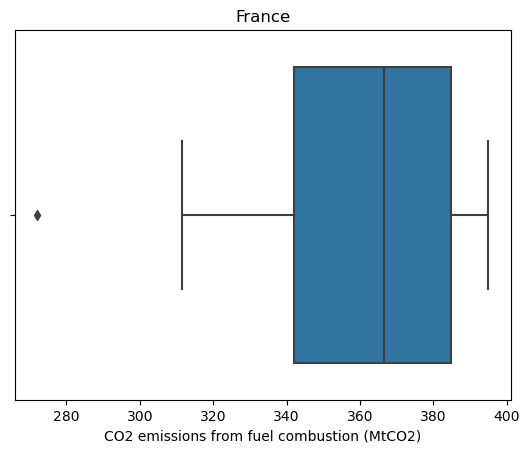

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


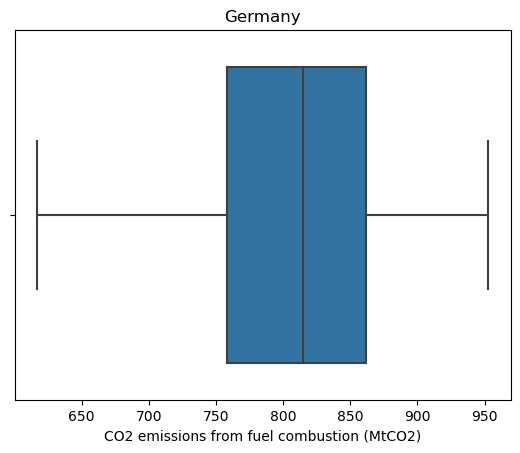

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


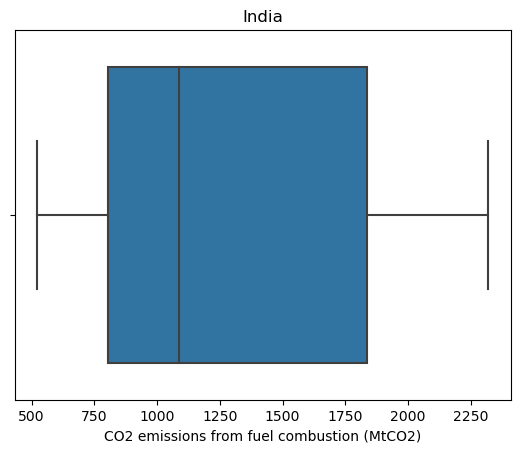

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


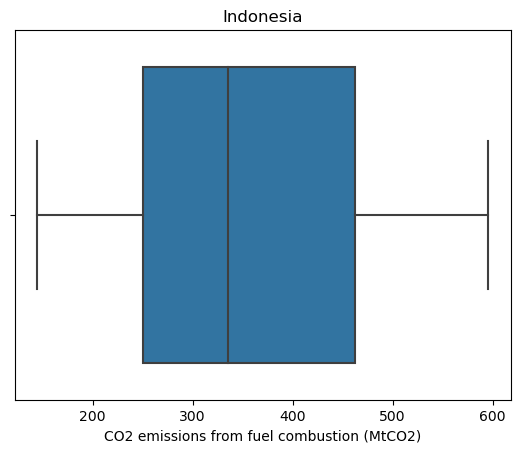

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


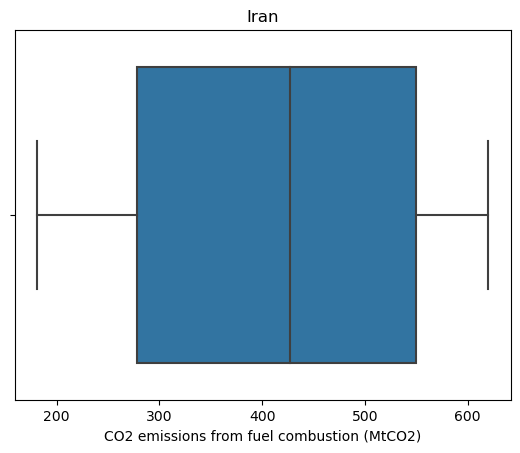

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


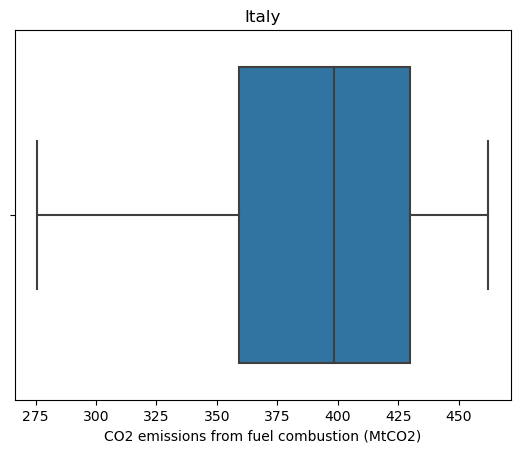

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


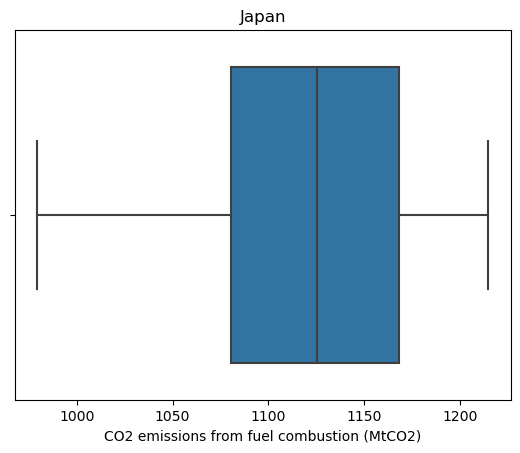

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


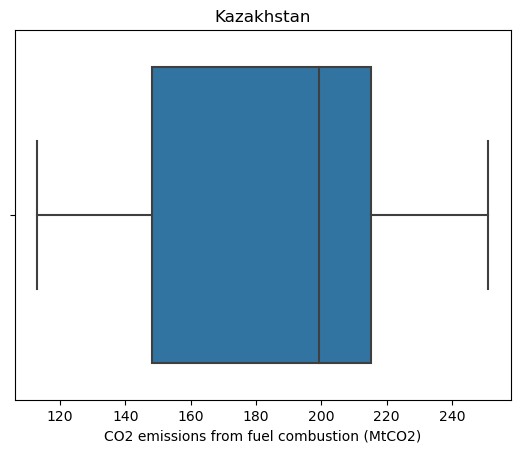

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


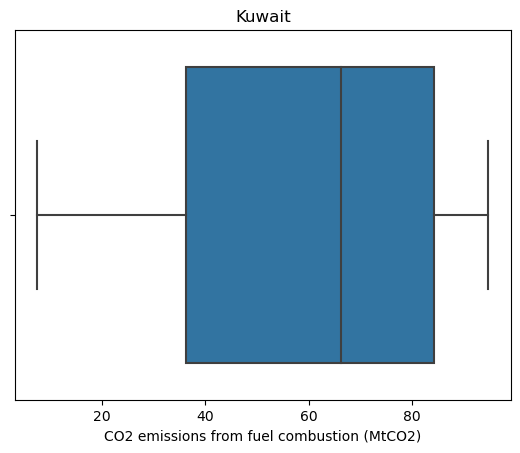

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


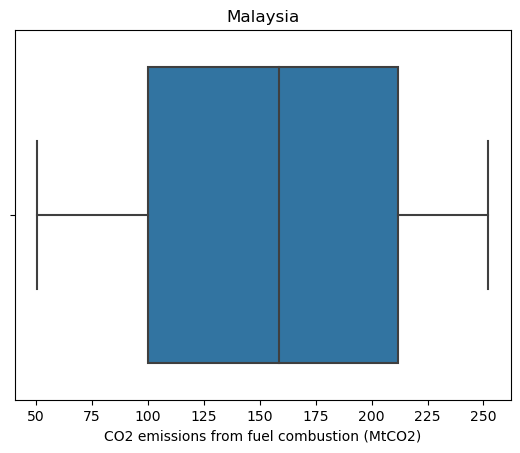

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


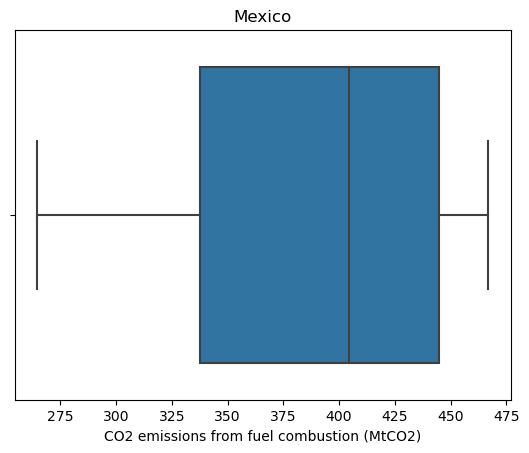

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


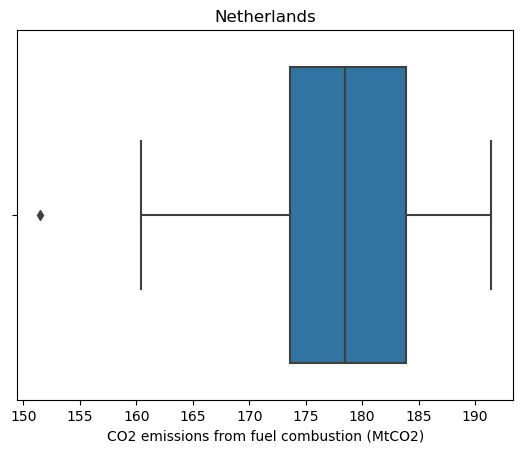

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


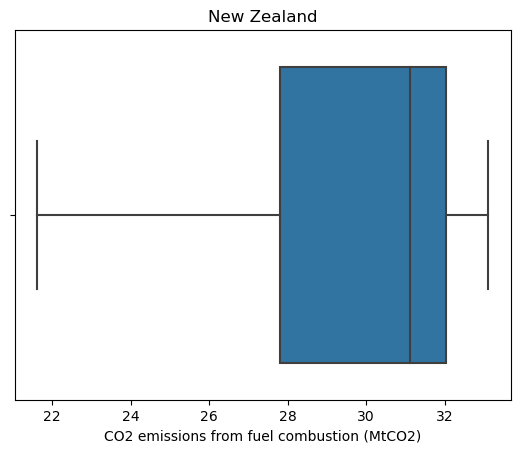

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


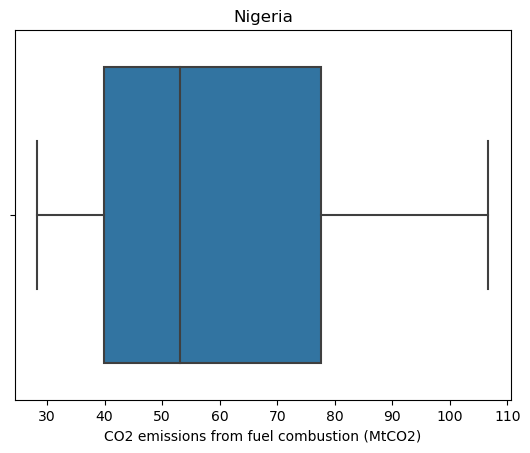

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


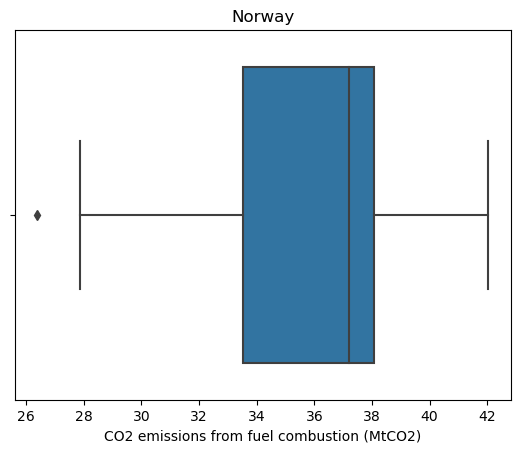

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


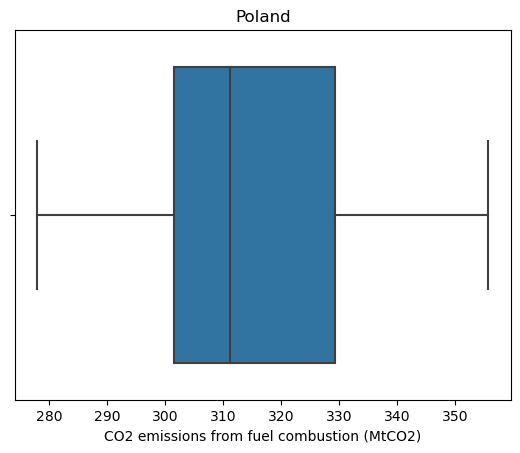

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


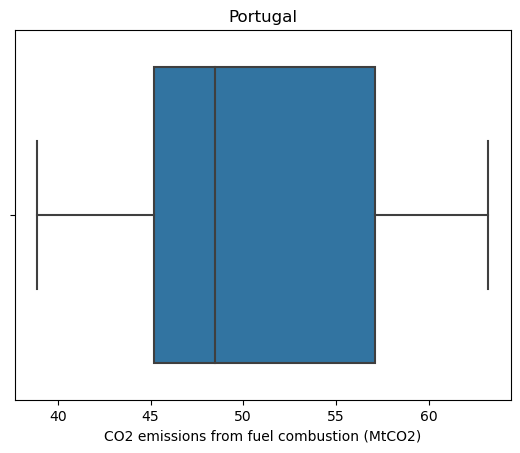

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


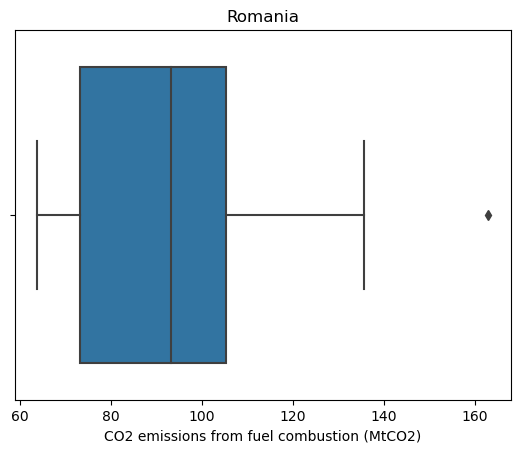

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


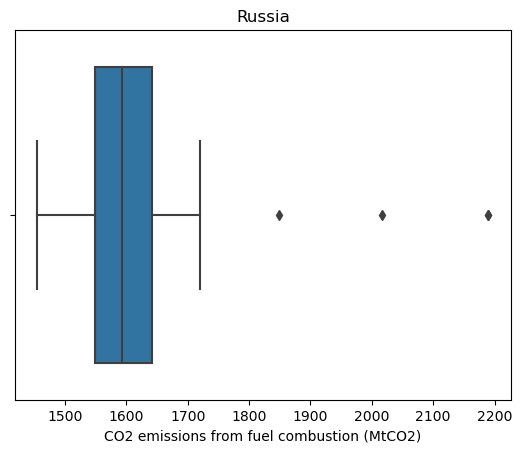

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


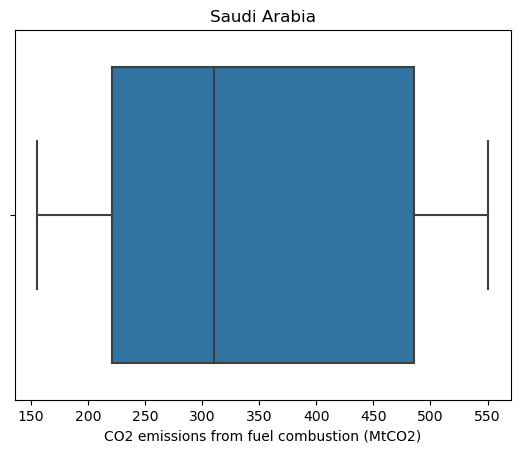

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


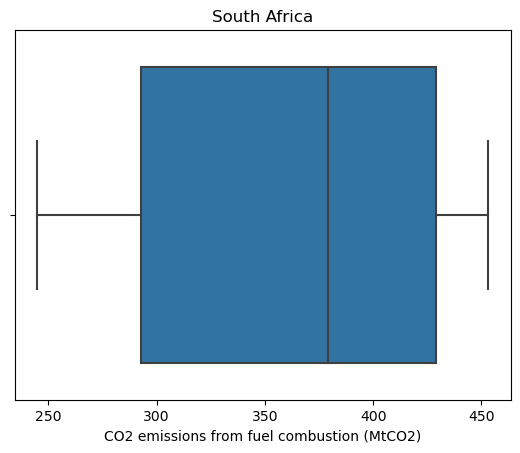

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


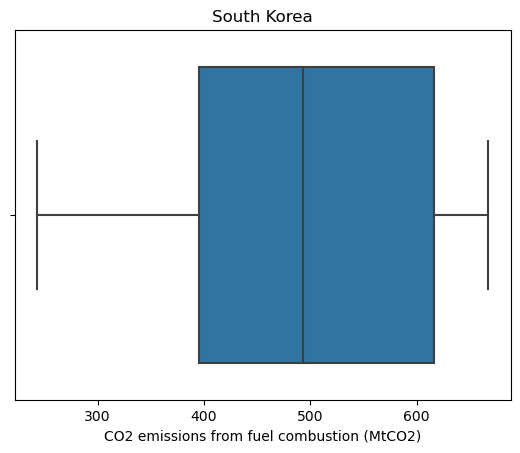

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


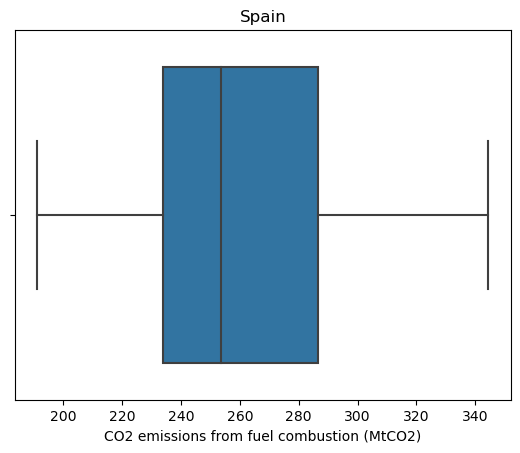

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


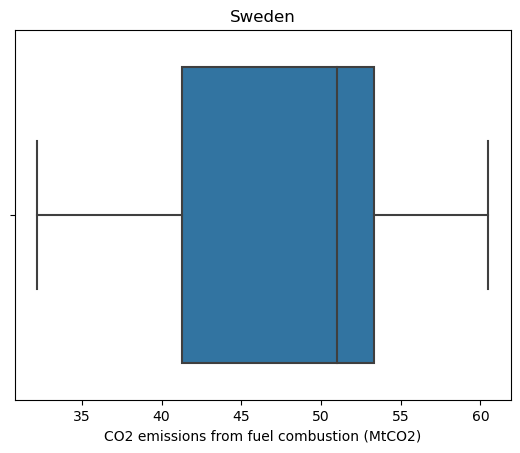

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


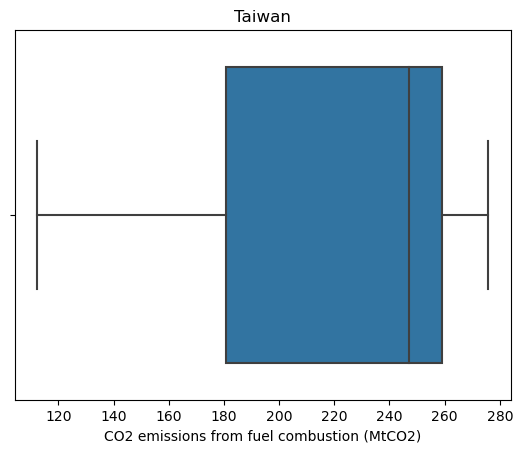

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


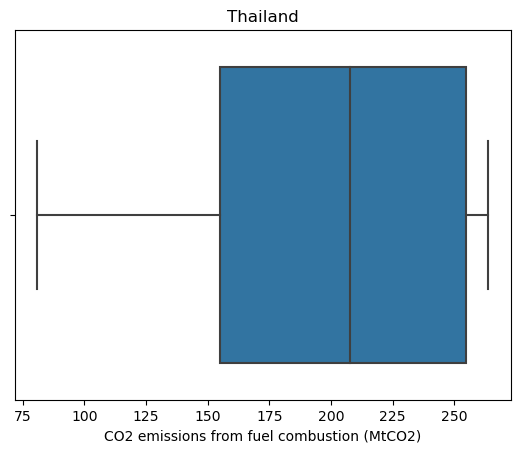

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


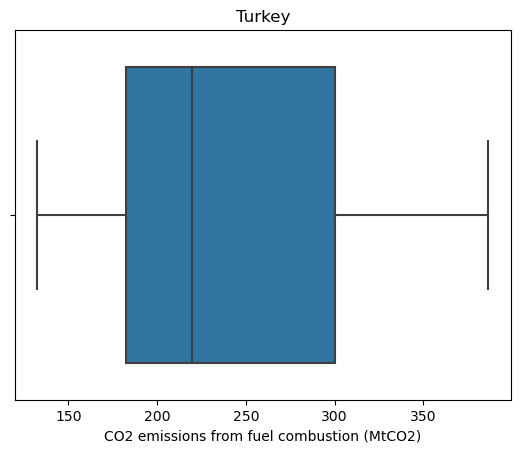

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


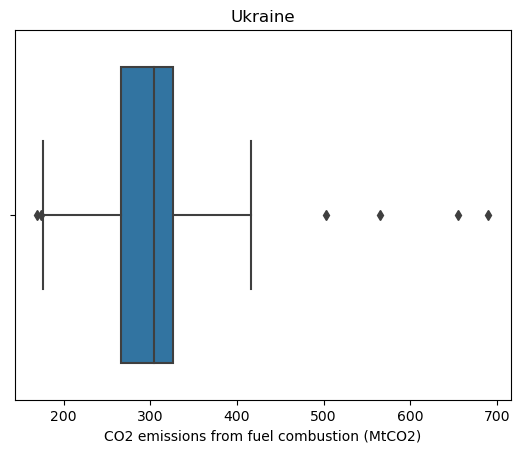

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


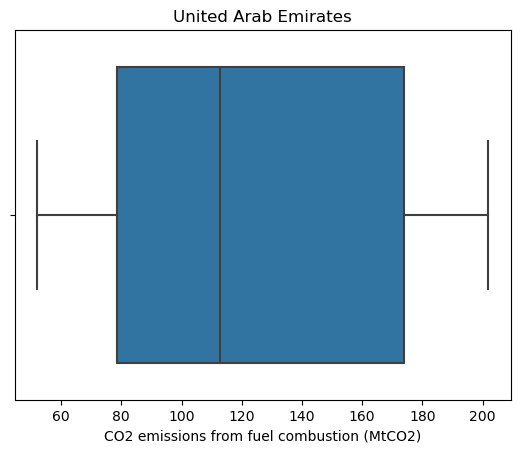

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


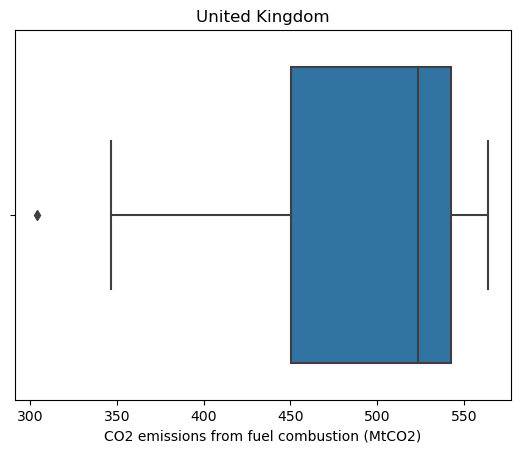

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


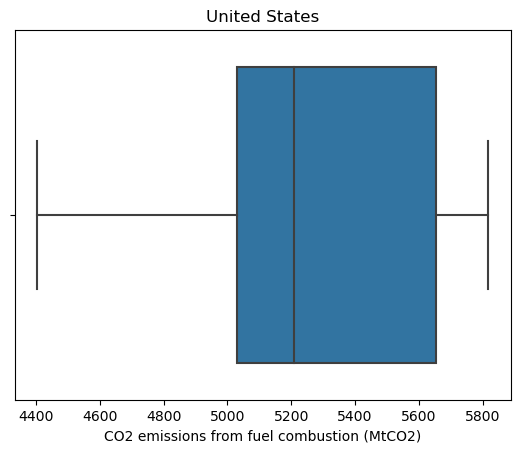

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


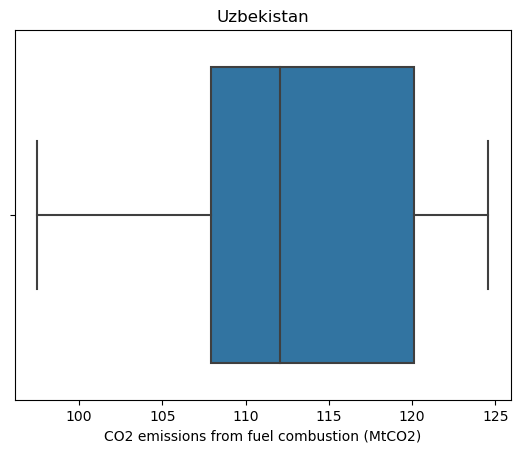

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


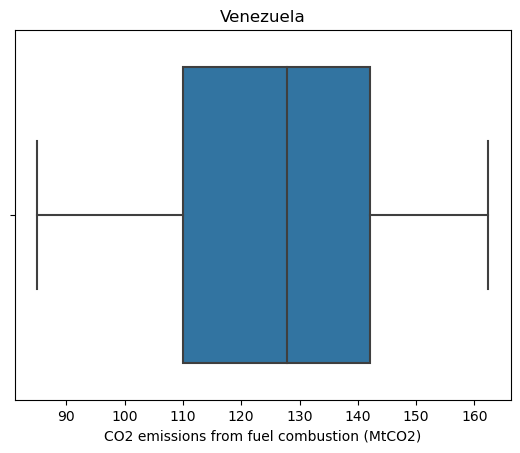

In [33]:
import seaborn as sns
for o in range(len(new_data)):
    sns.boxplot(new_data[o]["CO2 emissions from fuel combustion (MtCO2)"])
    plt.title(countries[o])
    plt.show()

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


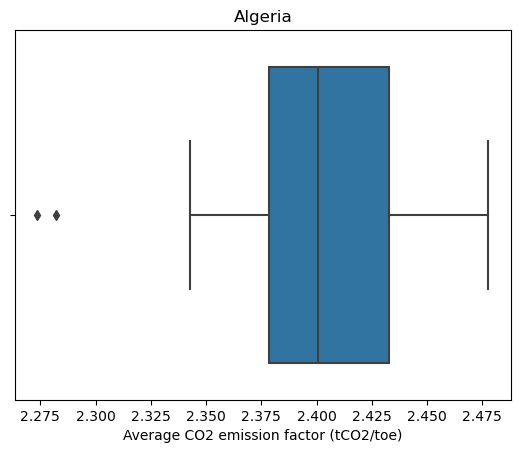

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


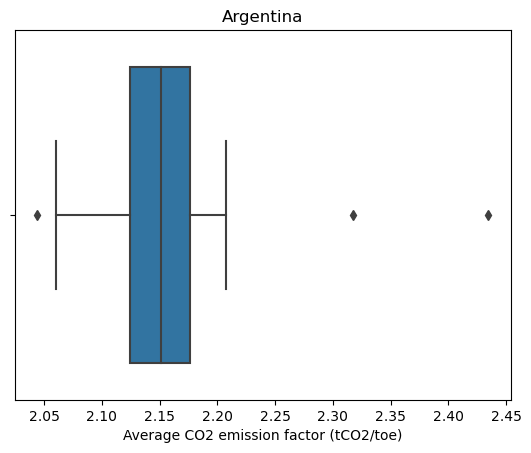

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


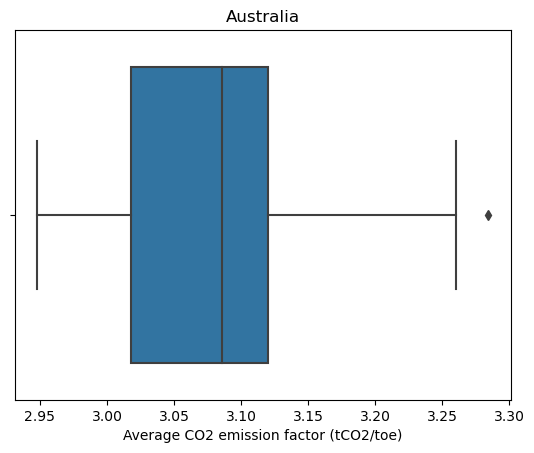

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


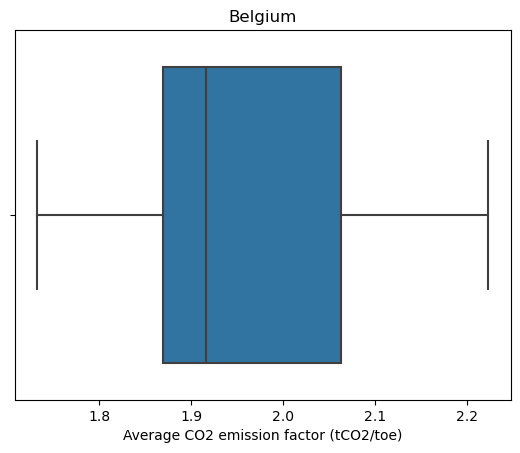

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


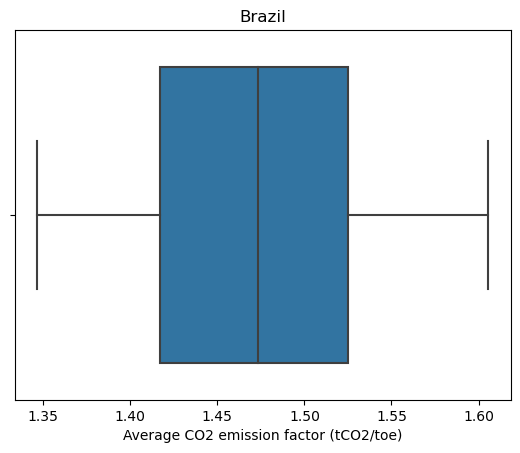

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


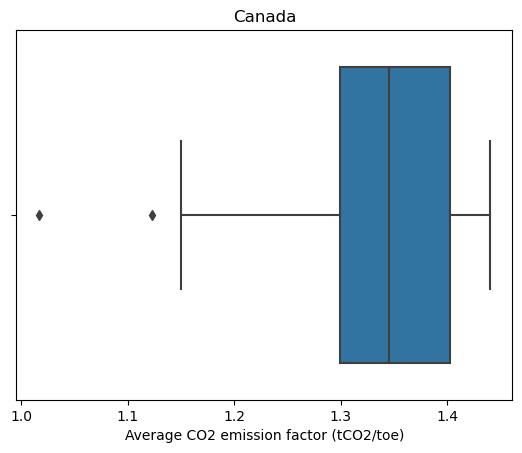

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


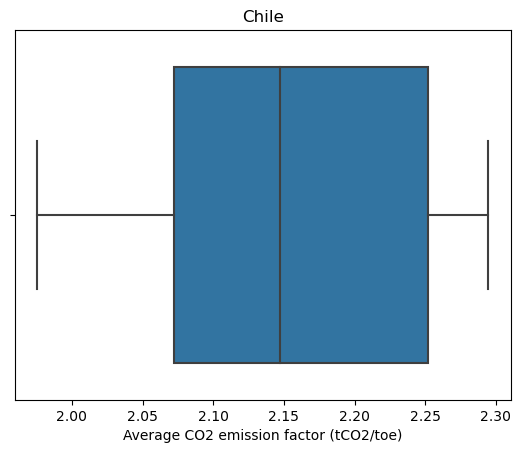

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


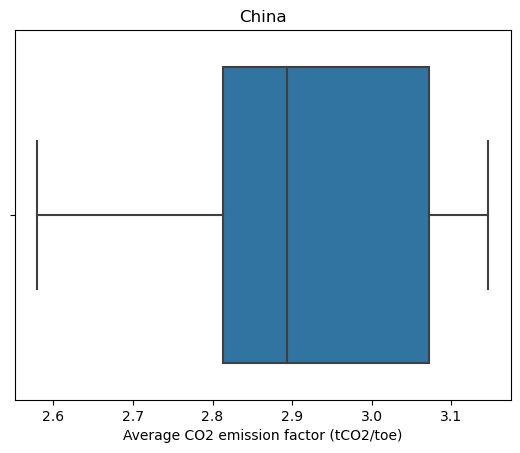

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


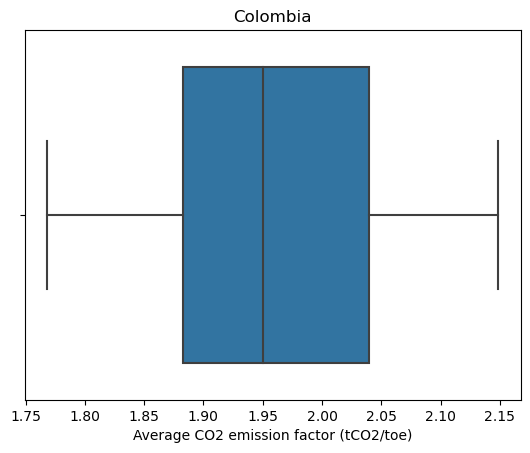

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


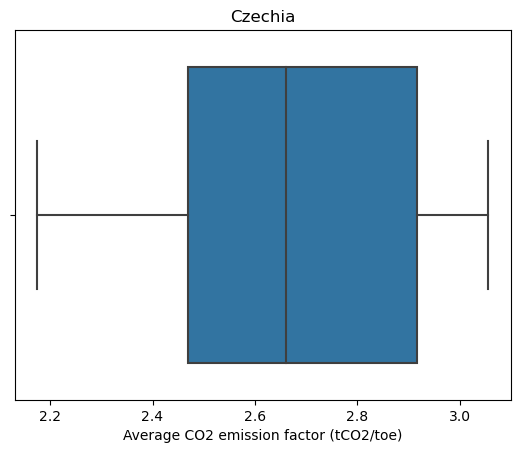

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


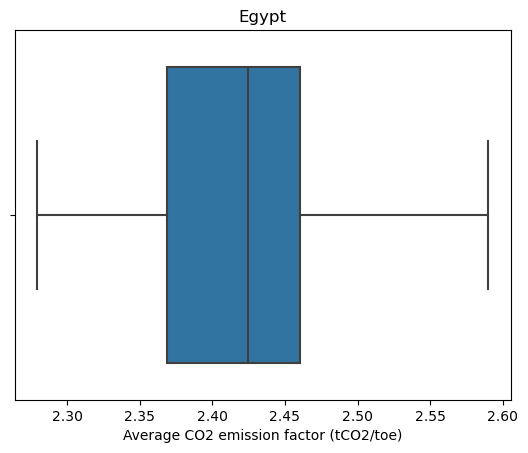

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


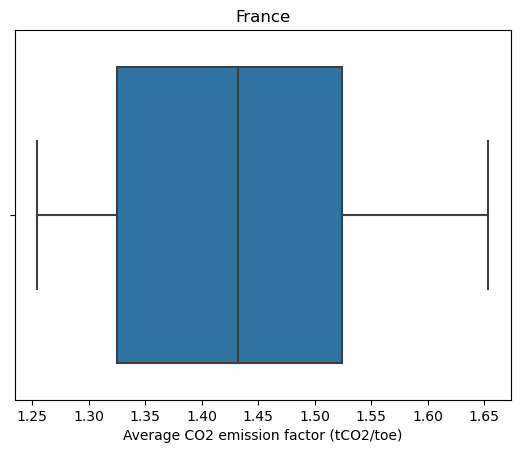

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


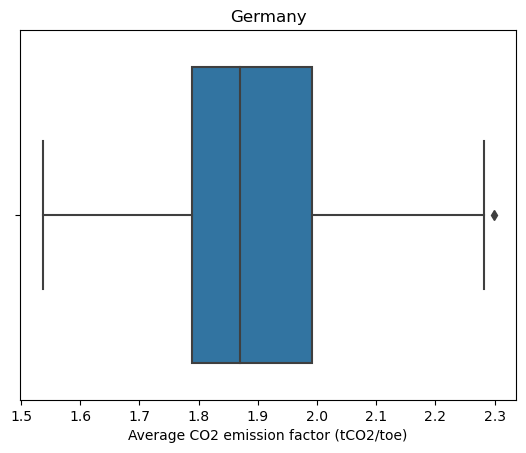

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


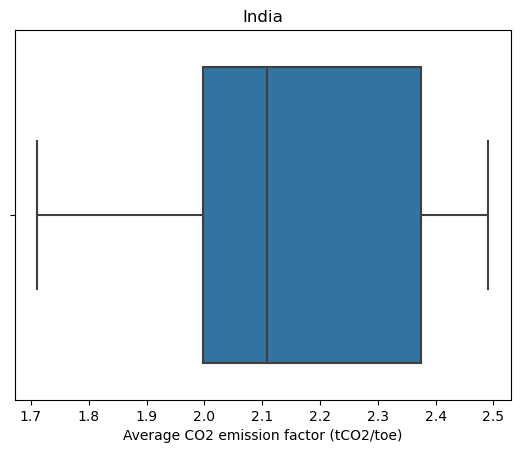

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


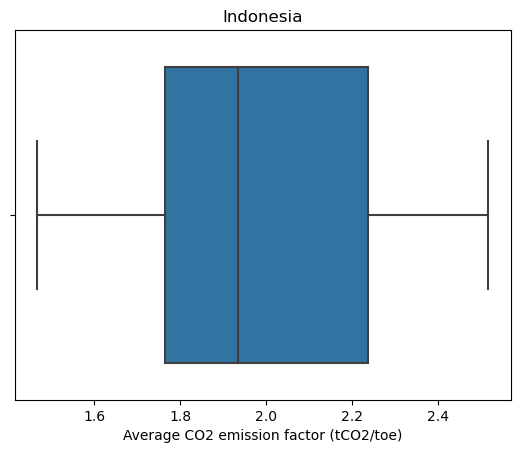

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


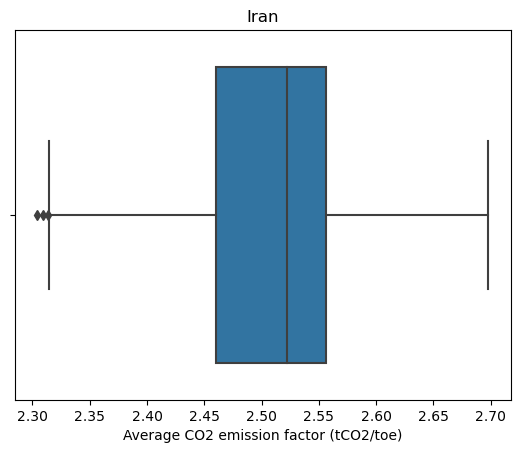

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


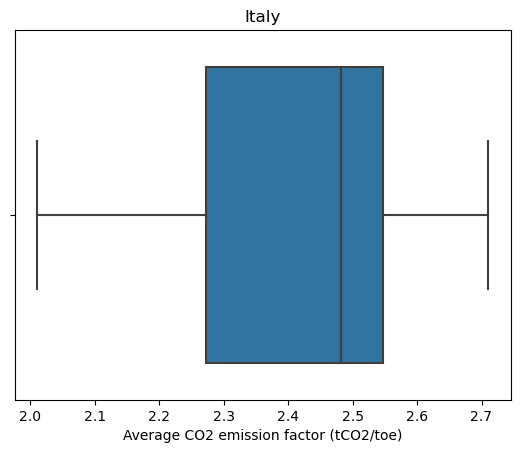

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


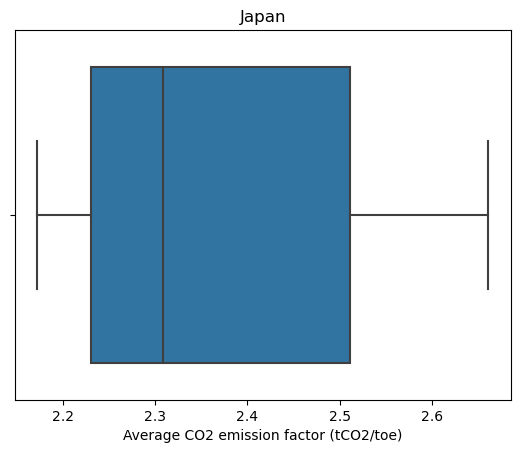

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


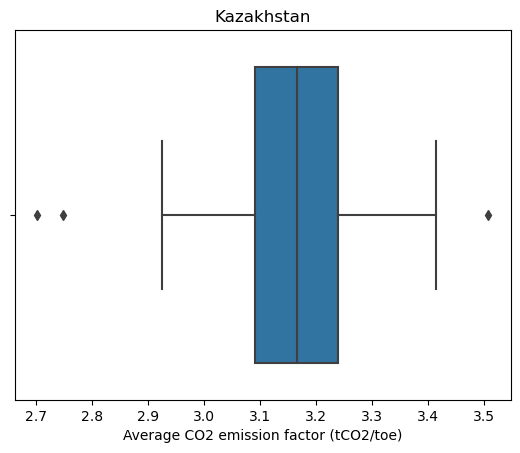

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


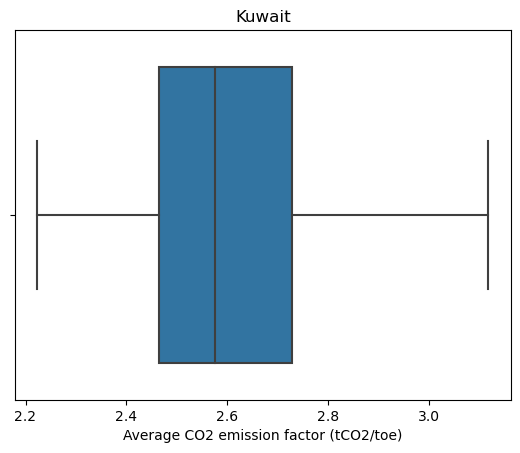

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


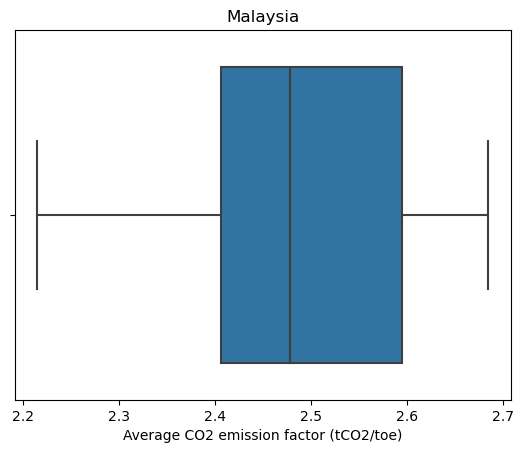

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


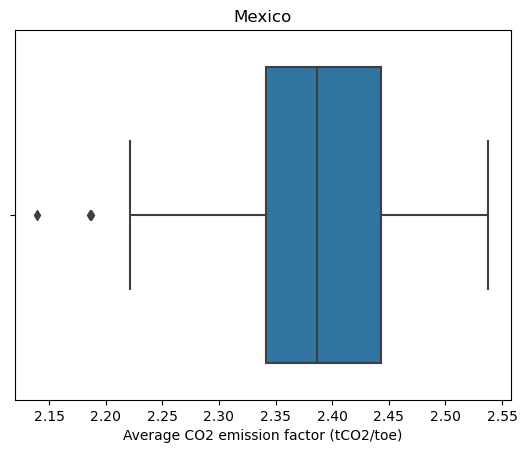

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


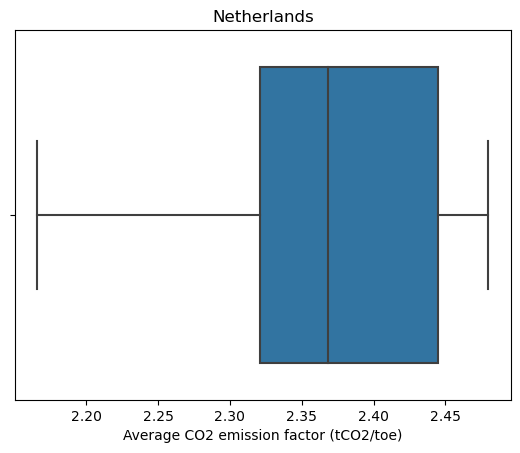

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


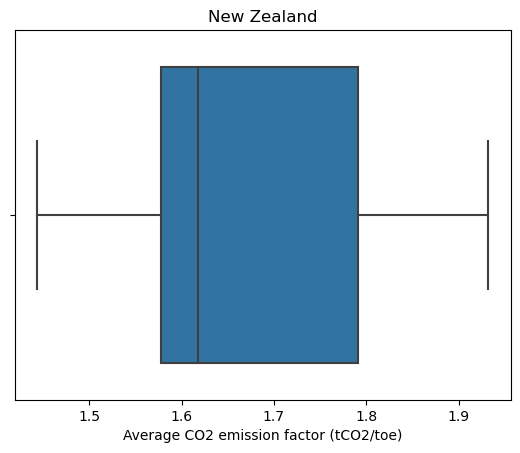

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


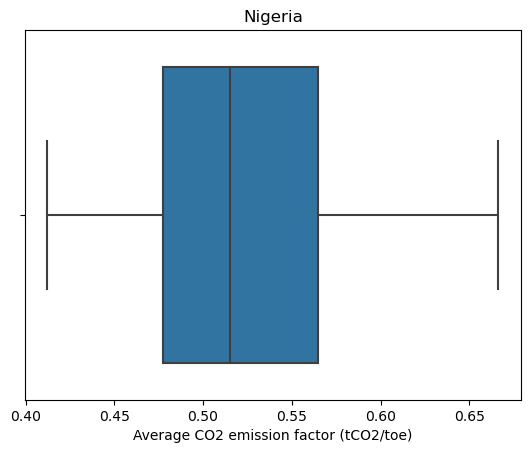

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


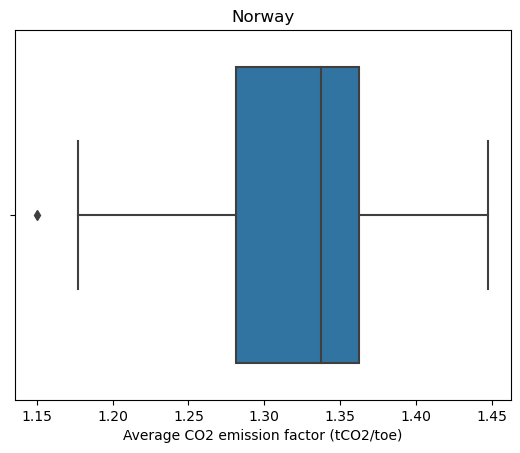

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


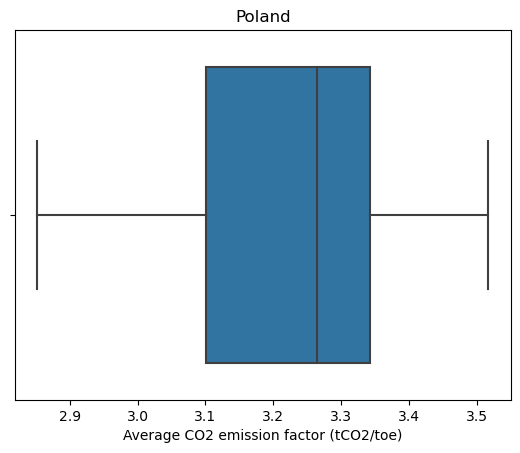

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


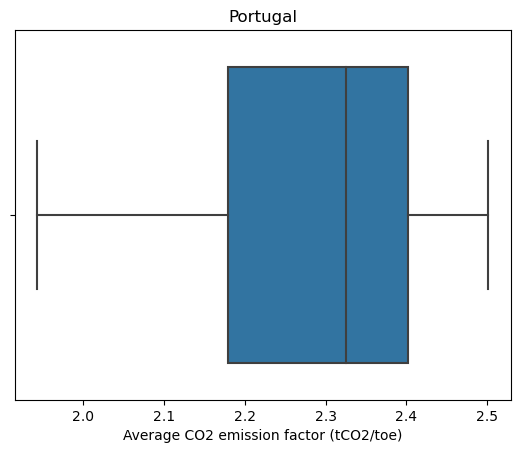

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


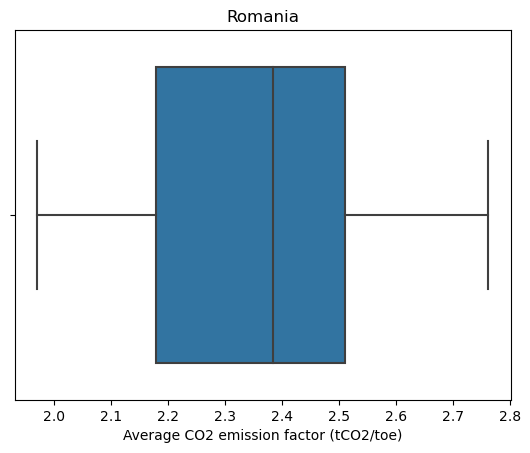

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


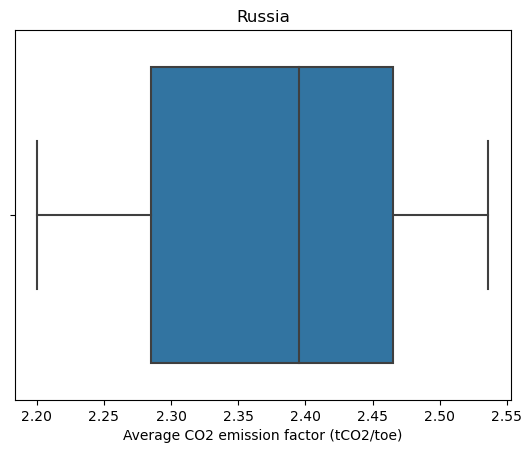

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


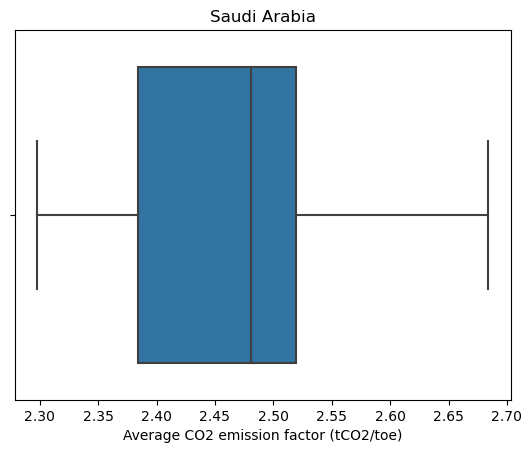

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


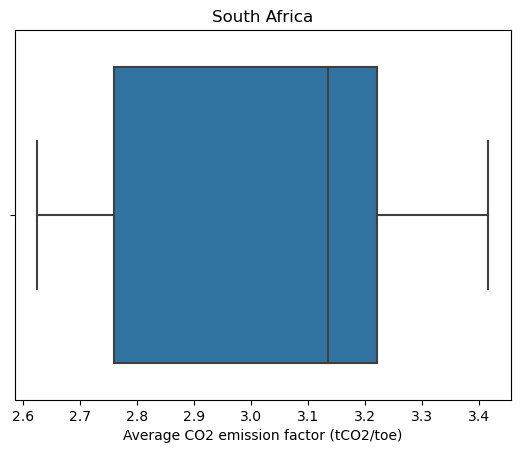

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


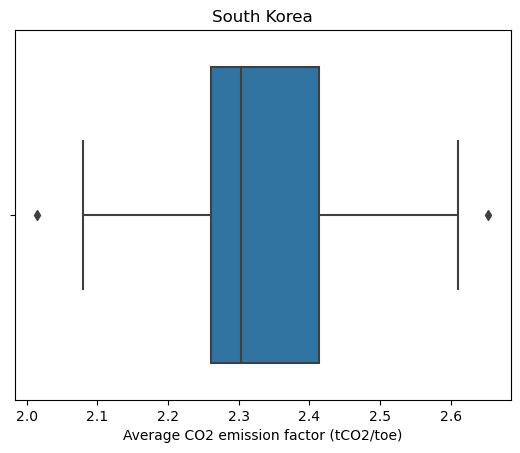

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


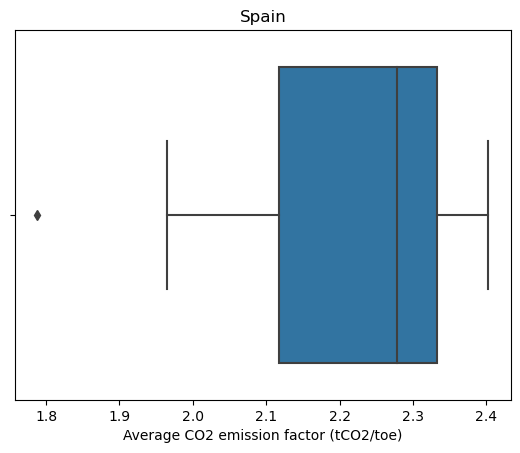

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


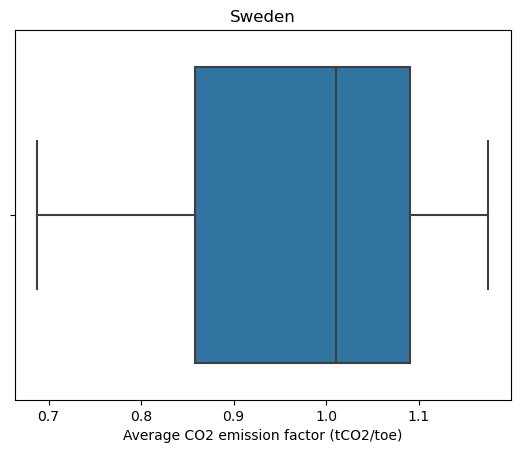

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


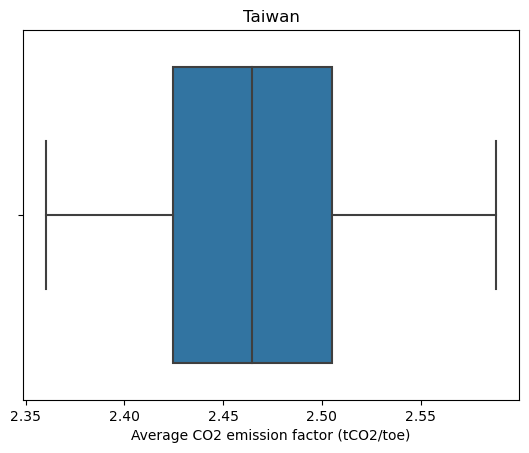

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


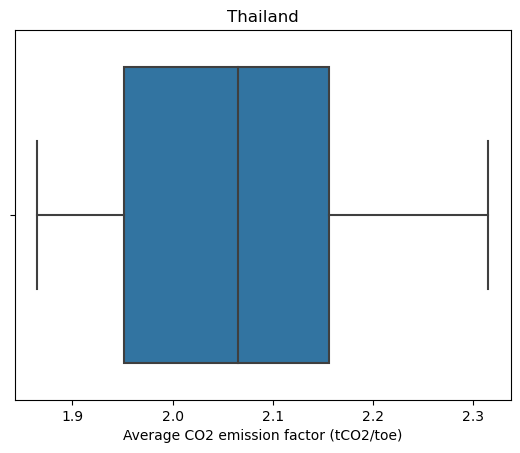

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


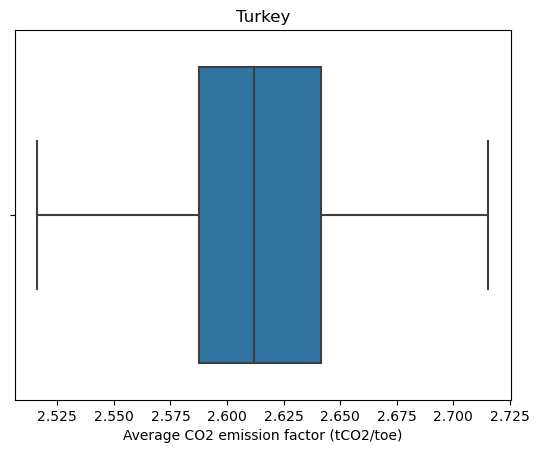

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


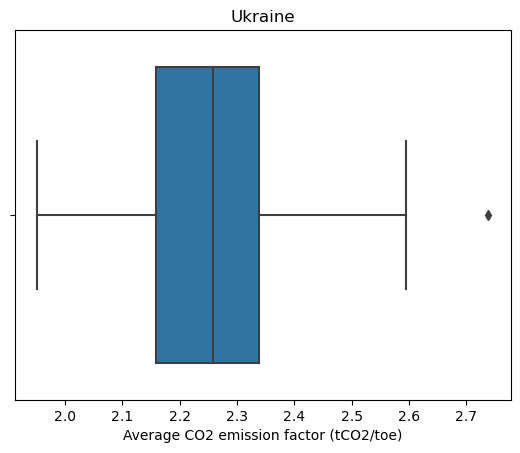

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


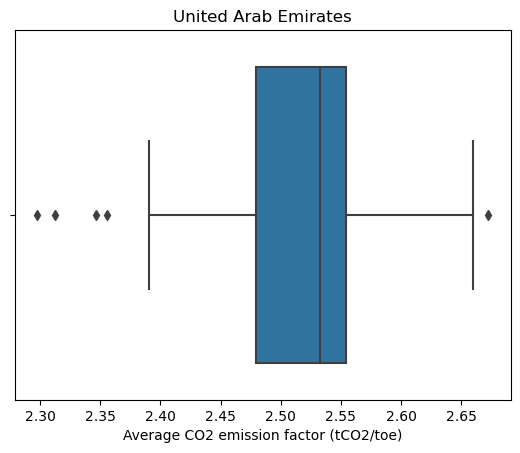

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


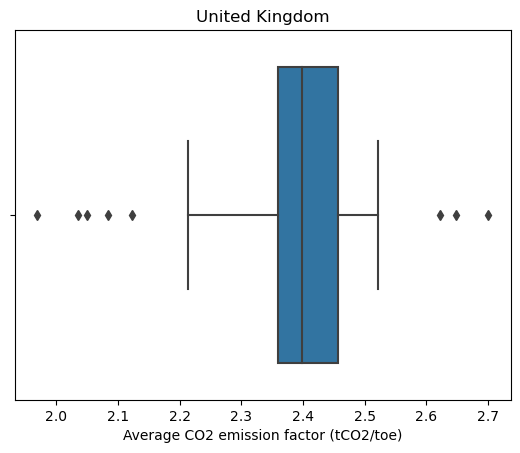

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


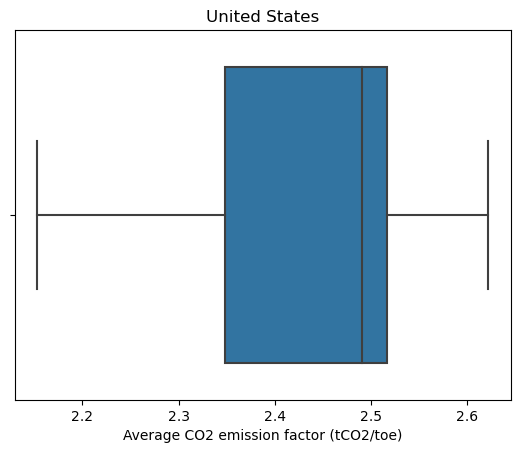

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


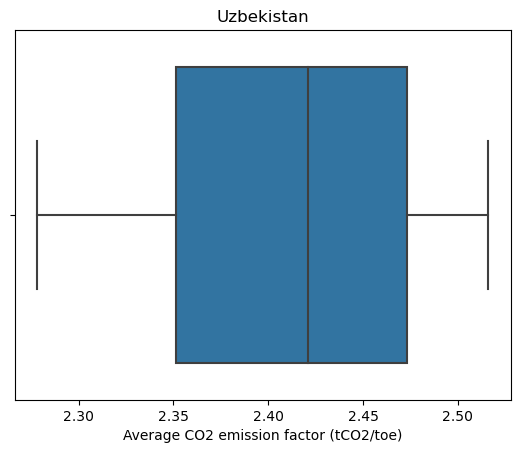

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


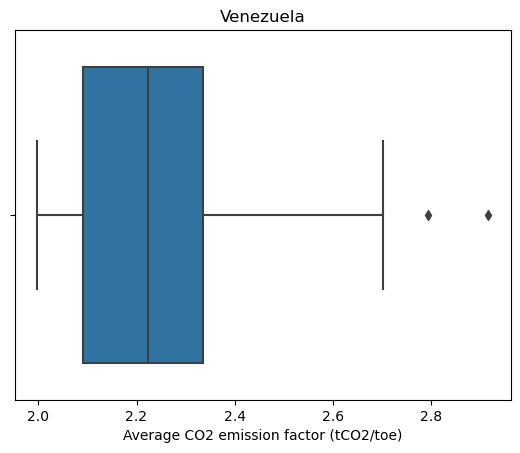

In [34]:
for o in range(len(new_data)):
    sns.boxplot(new_data[o]["Average CO2 emission factor (tCO2/toe)"])
    plt.title(countries[o])
    plt.show()

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


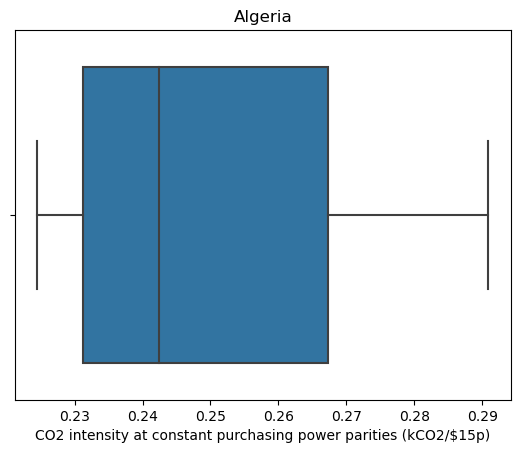

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


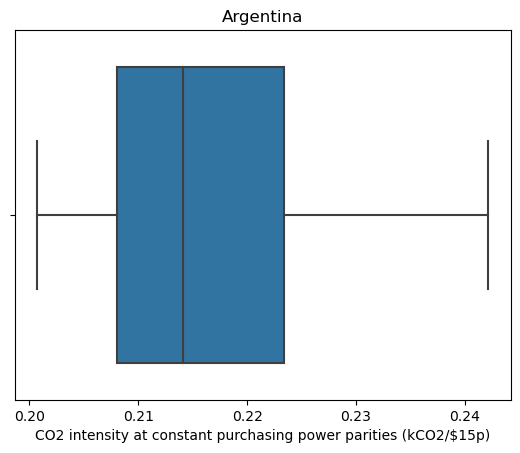

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


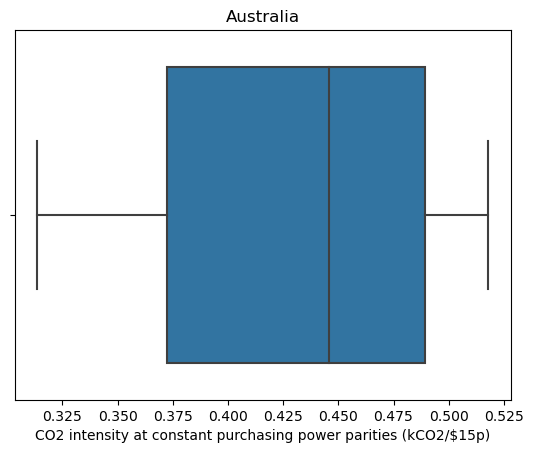

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


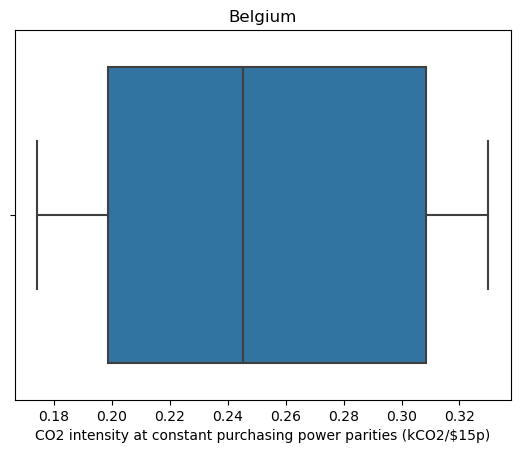

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


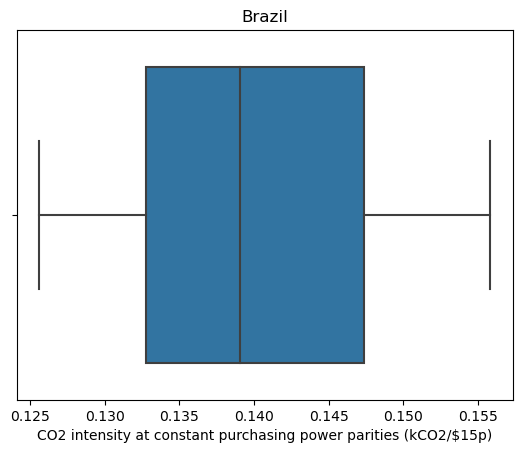

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


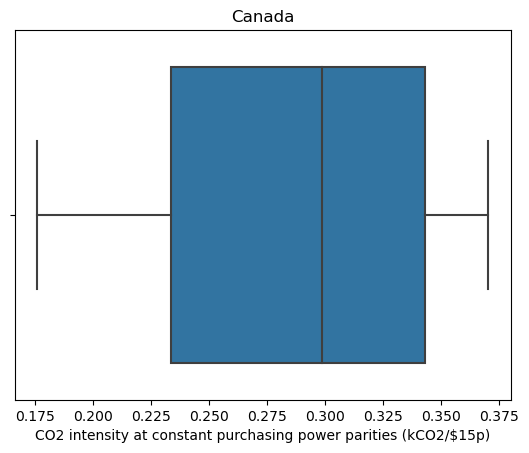

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


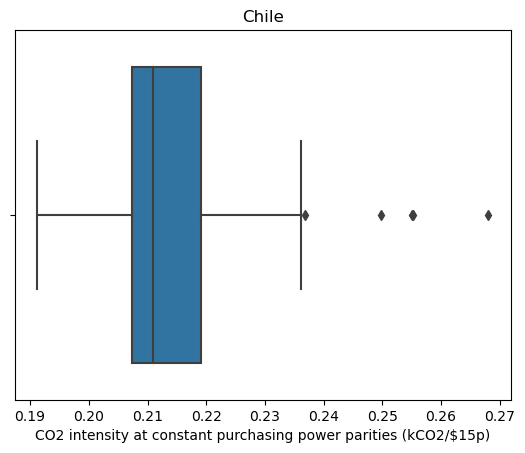

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


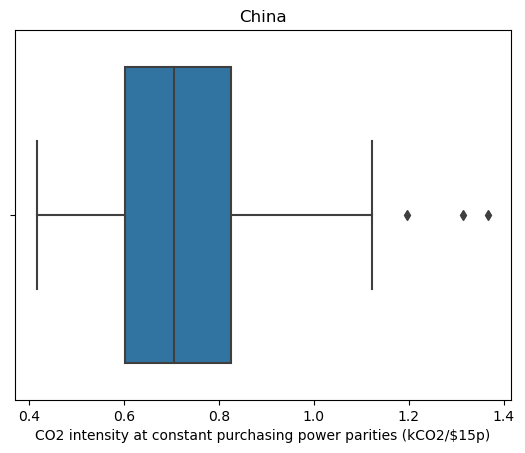

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


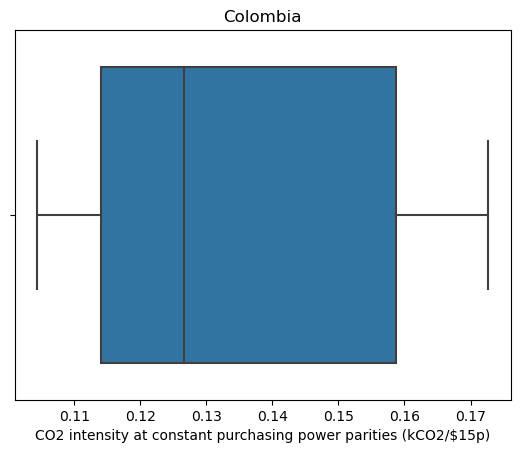

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


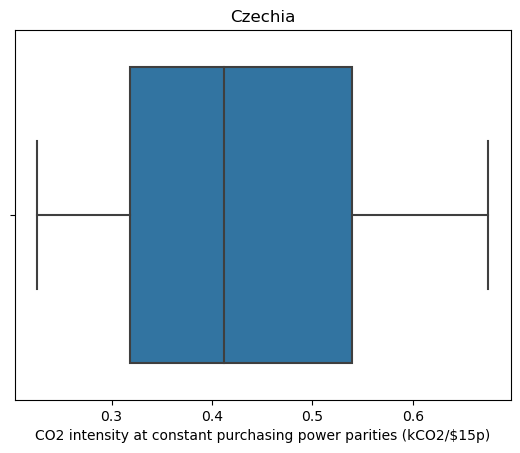

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


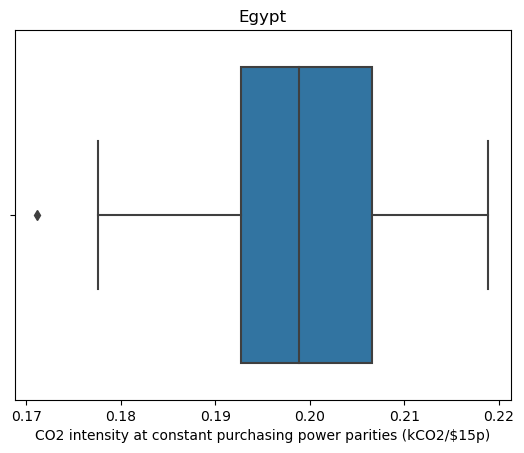

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


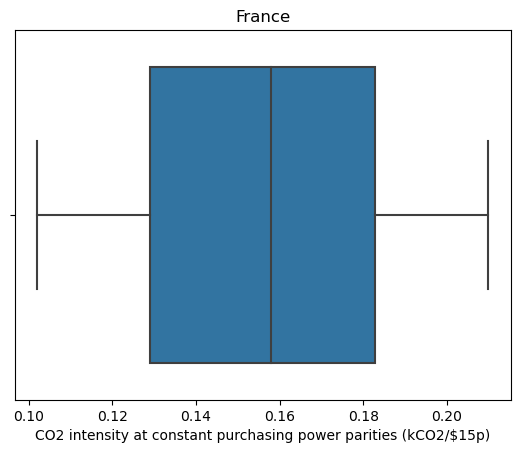

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


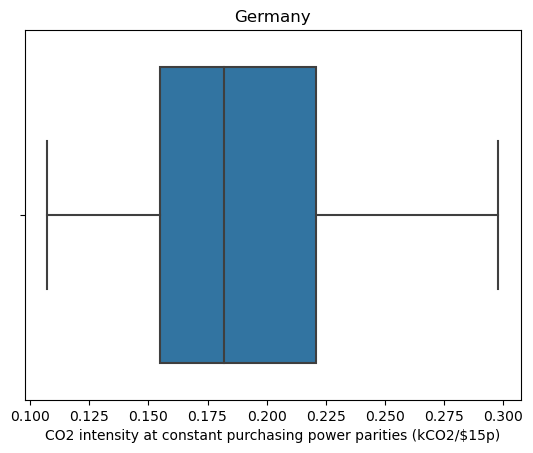

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


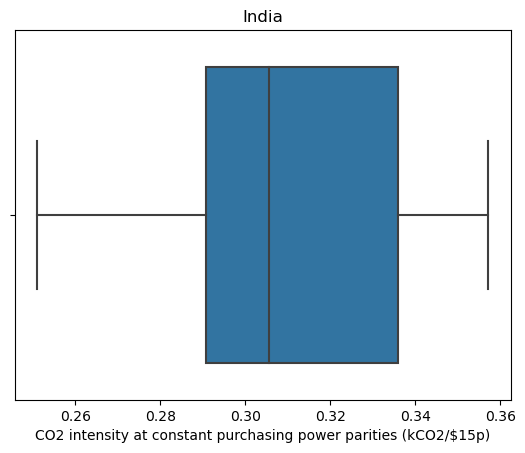

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


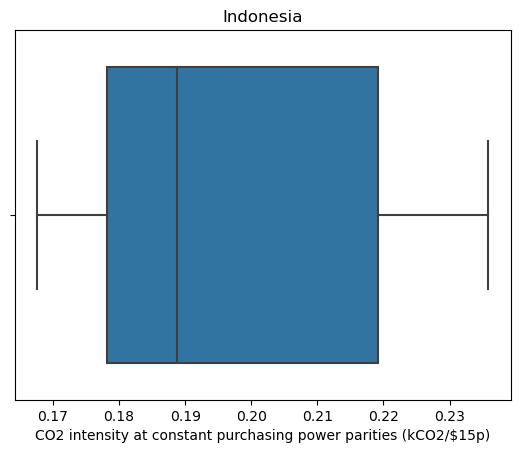

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


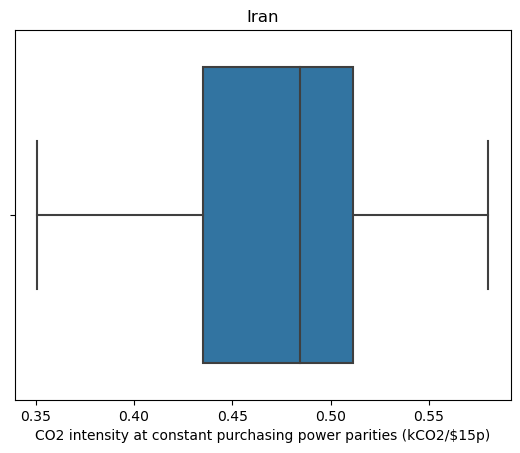

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


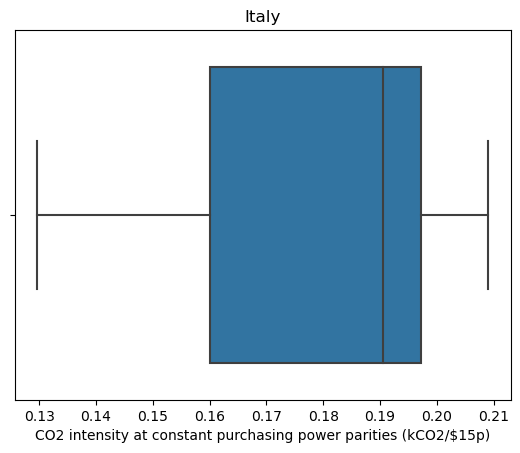

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


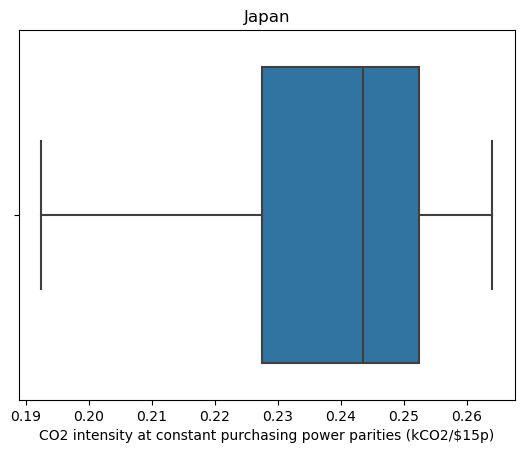

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


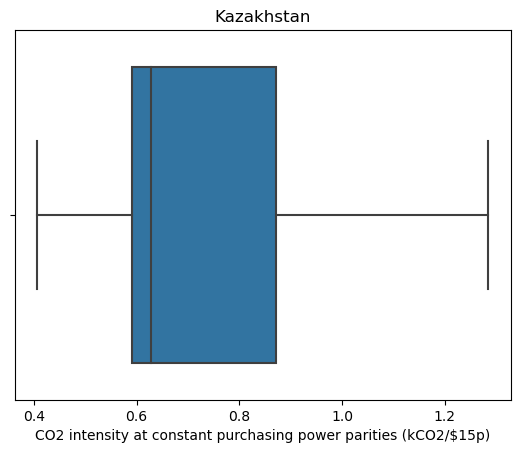

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


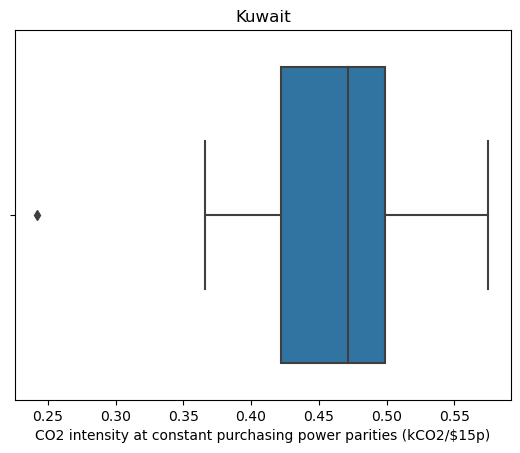

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


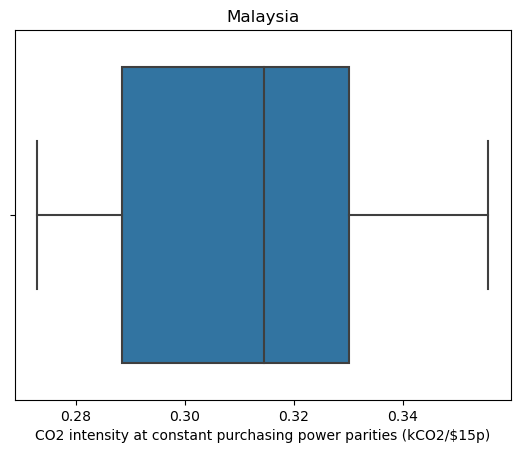

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


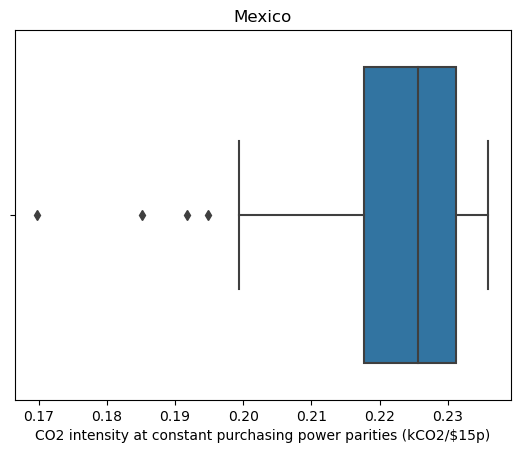

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


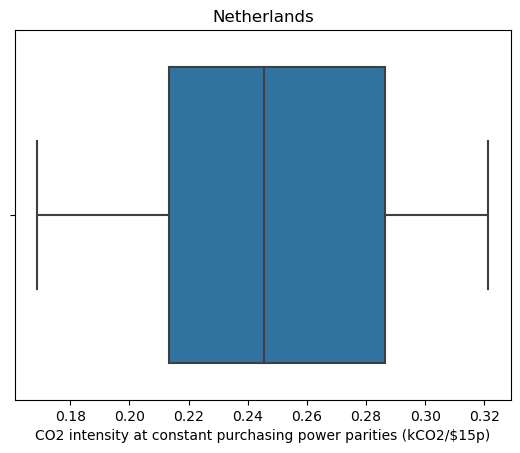

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


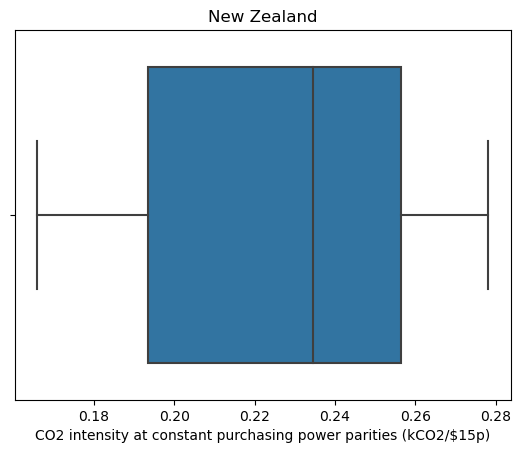

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


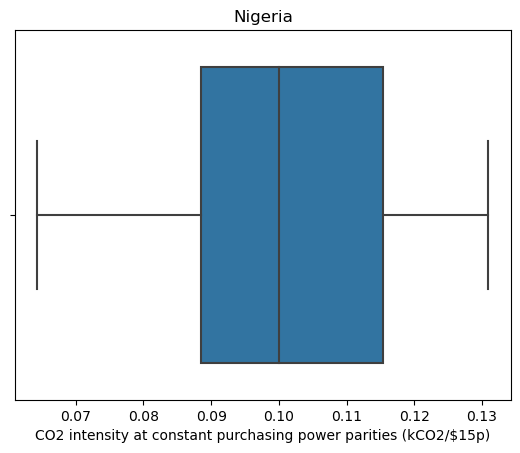

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


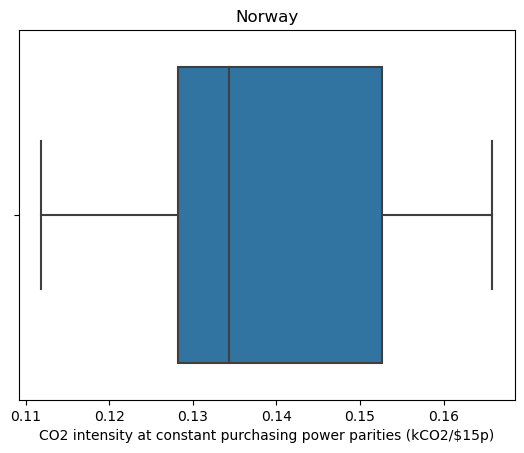

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


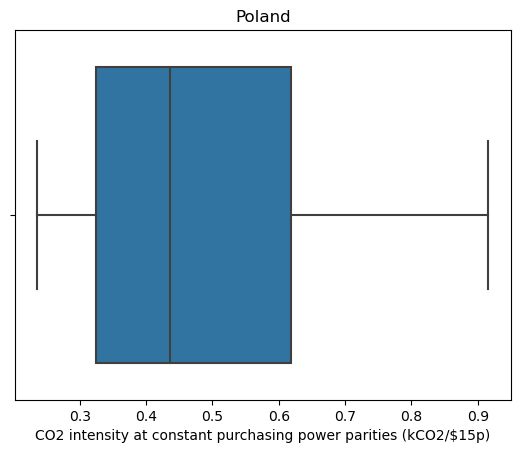

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


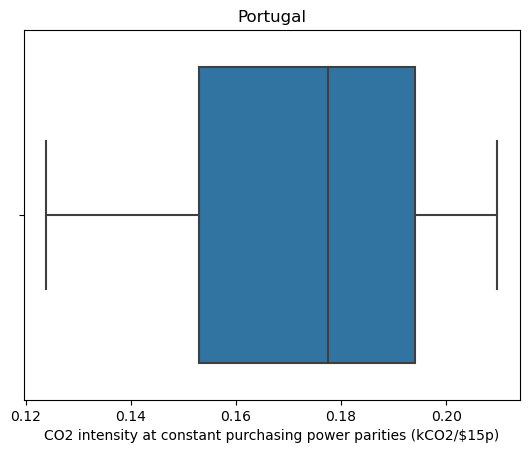

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


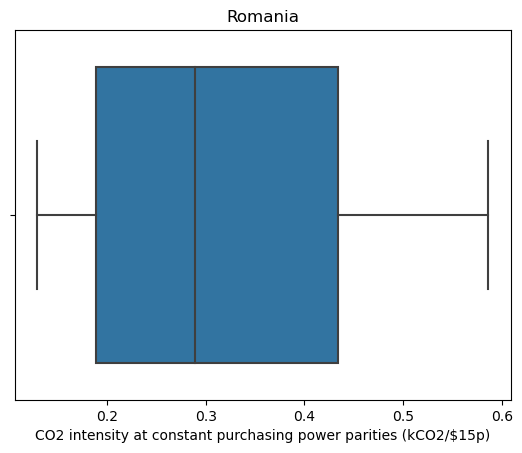

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


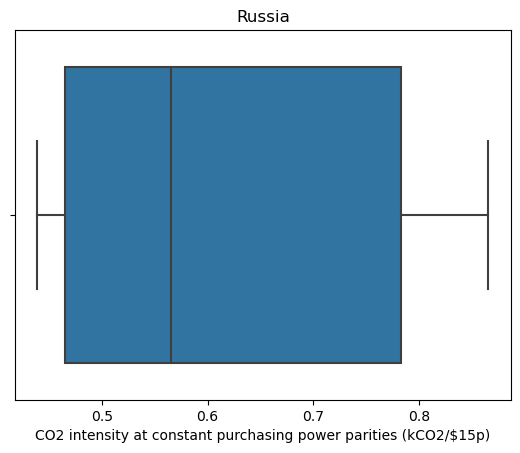

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


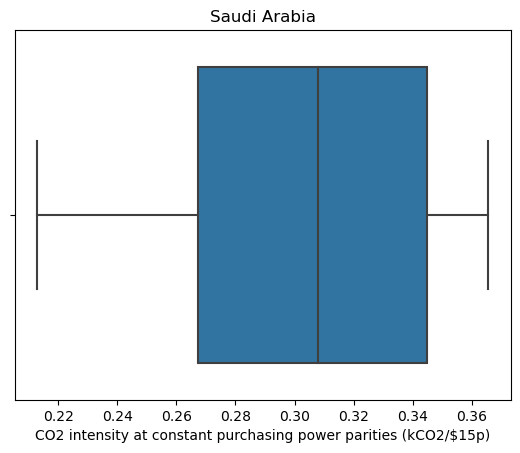

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


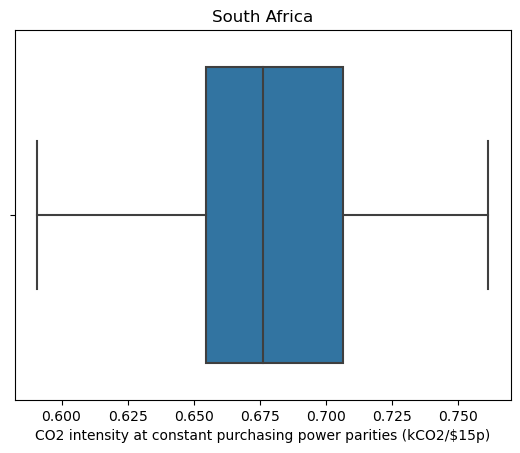

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


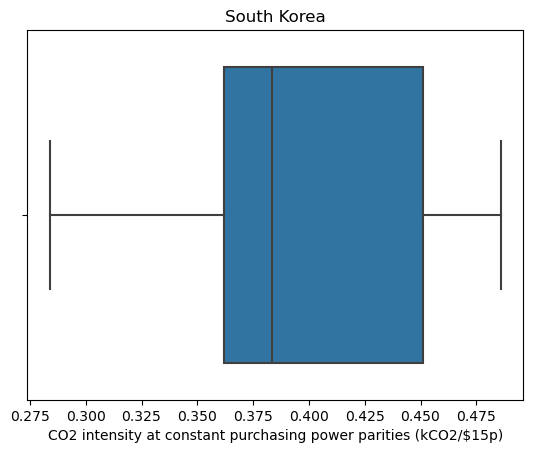

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


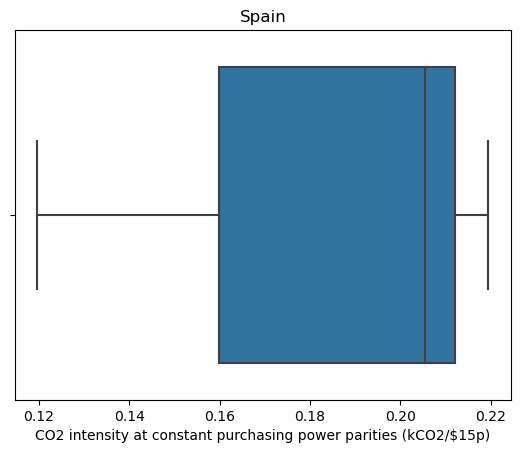

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


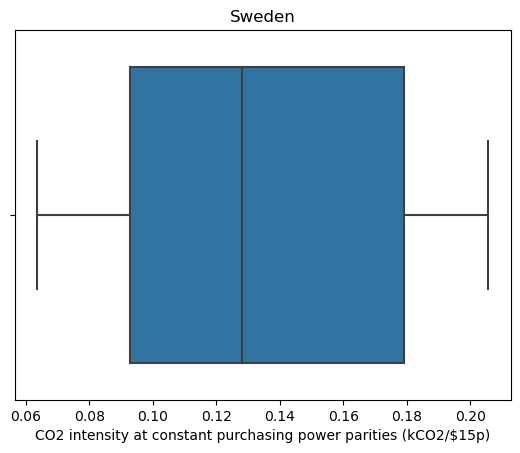

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


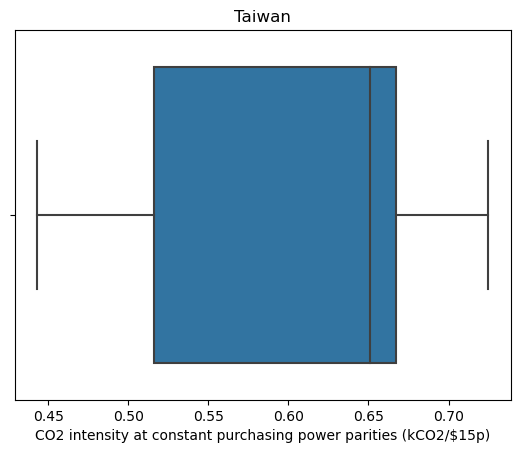

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


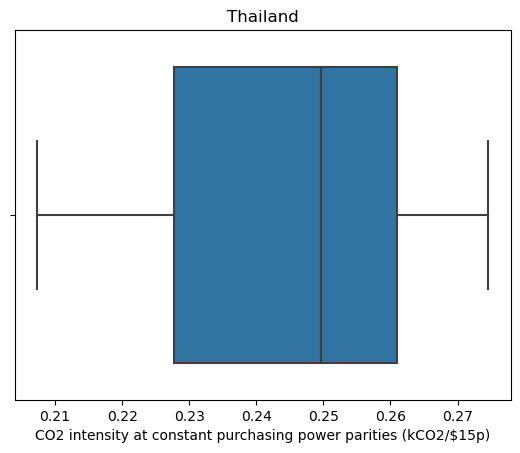

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


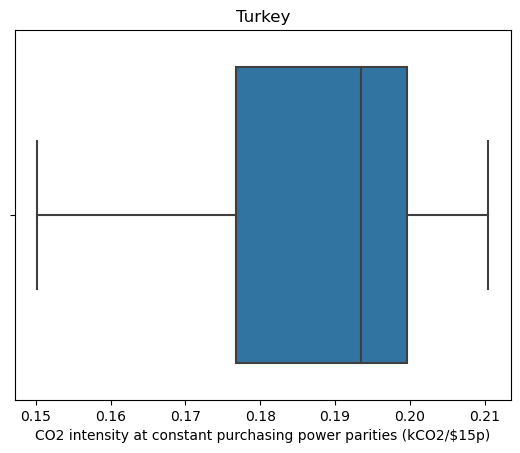

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


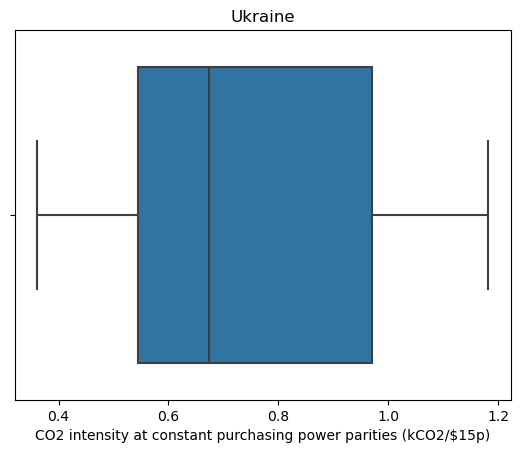

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


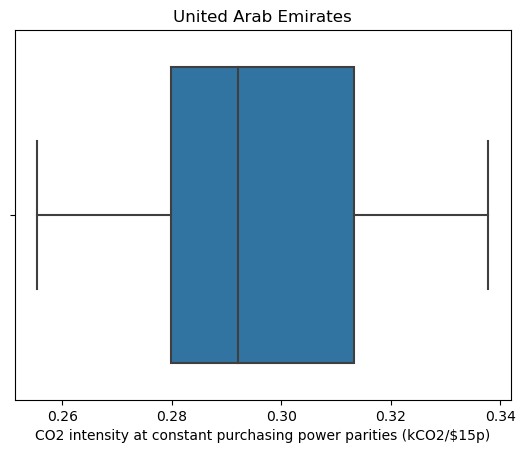

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


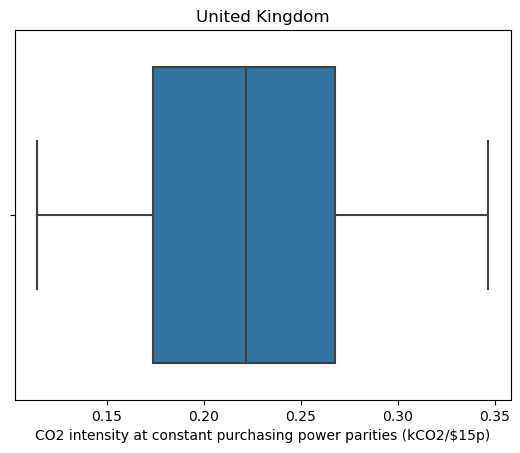

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


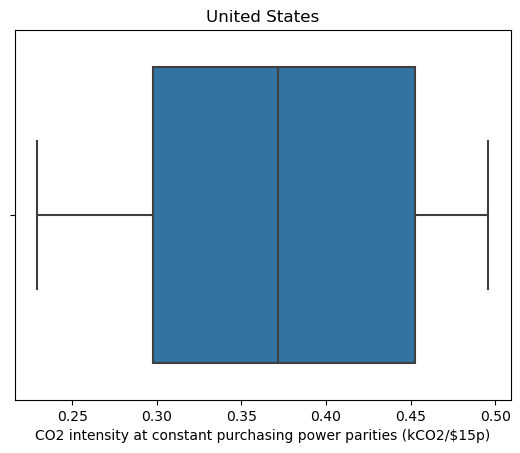

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


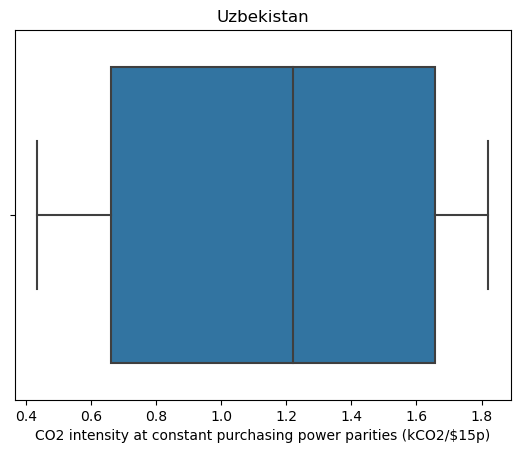

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


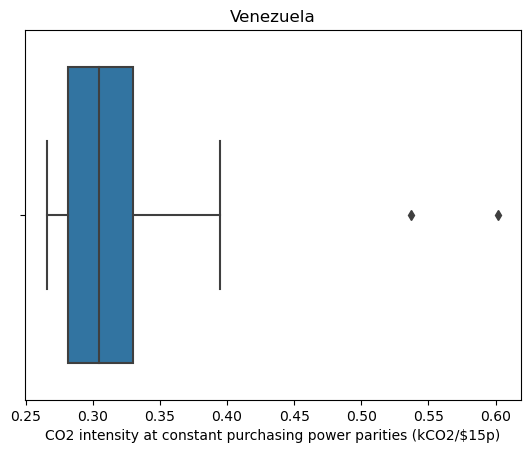

In [35]:
for o in range(len(new_data)):
    sns.boxplot(new_data[o]["CO2 intensity at constant purchasing power parities (kCO2/$15p)"])
    plt.title(countries[o])
    plt.show()

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


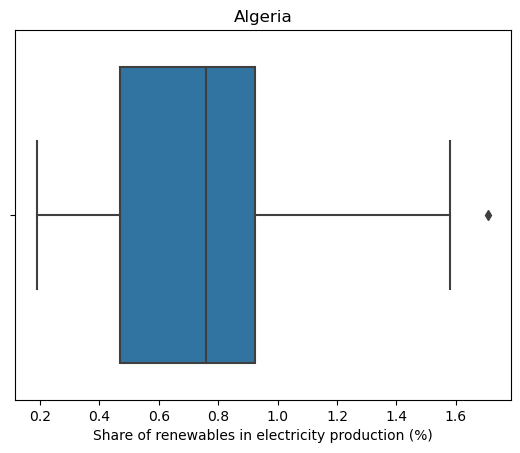

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


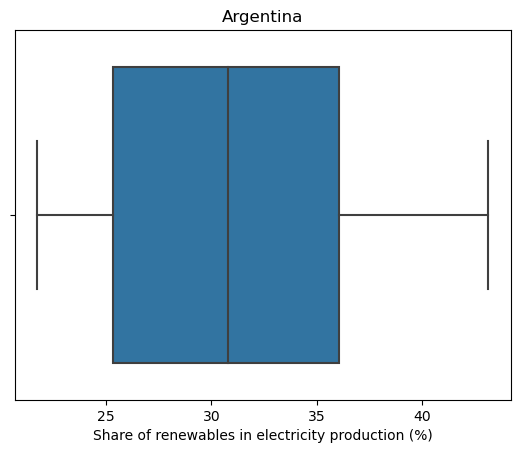

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


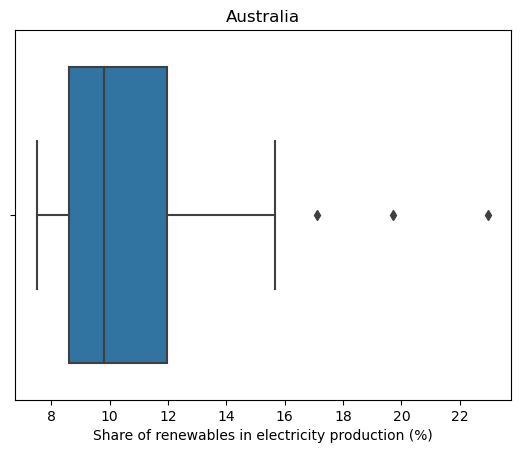

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


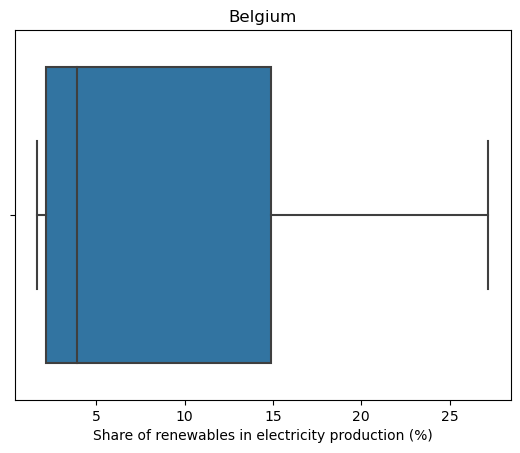

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


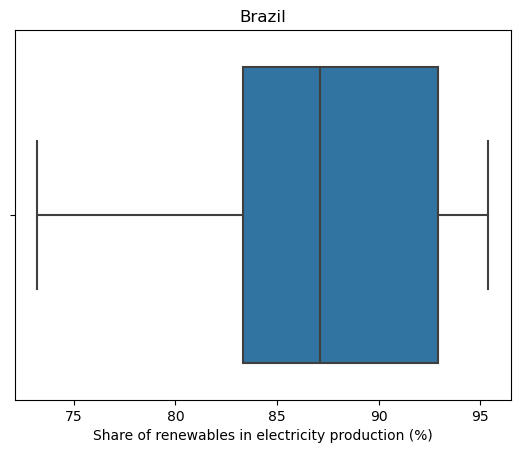

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


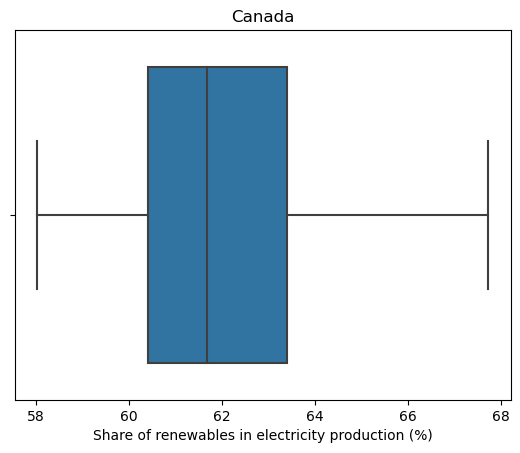

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


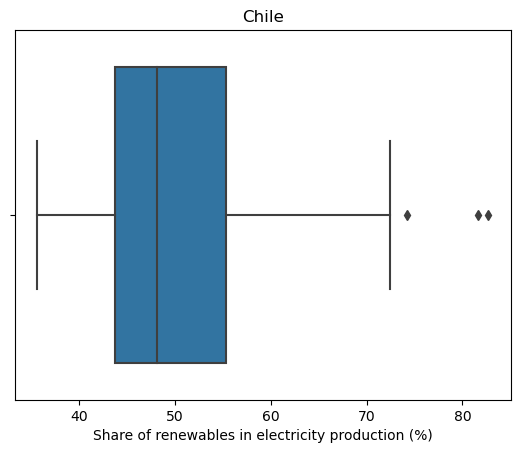

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


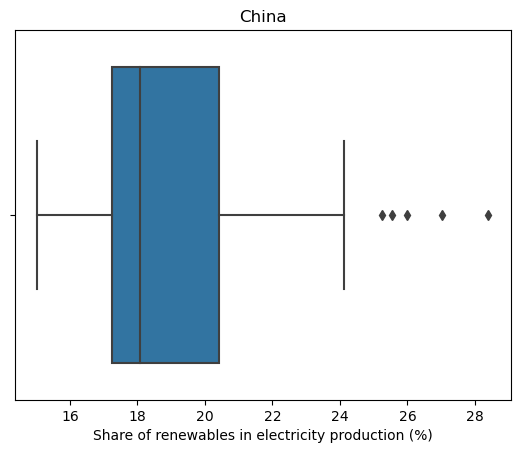

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


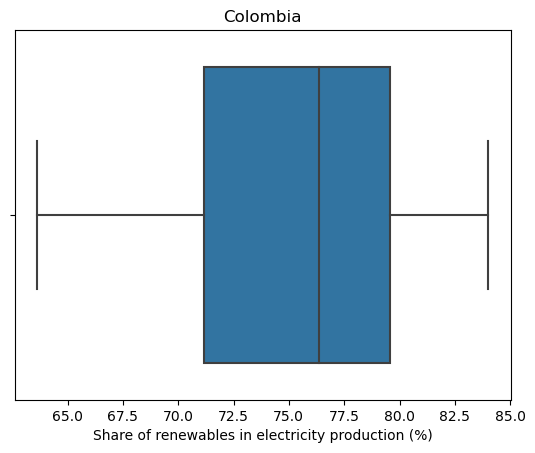

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


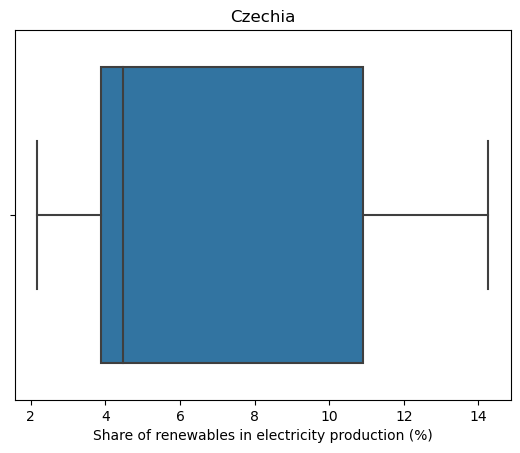

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


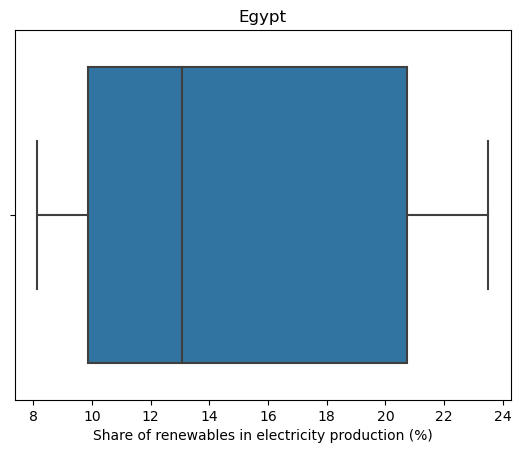

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


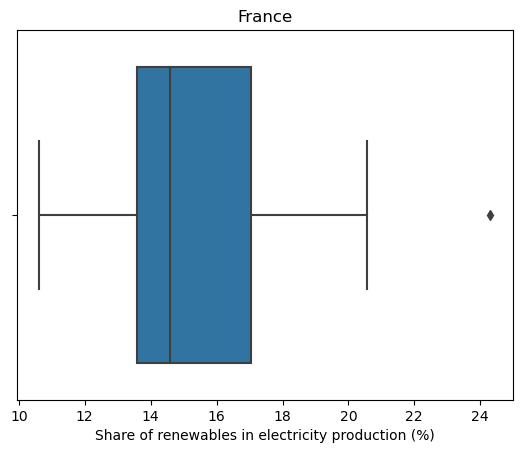

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


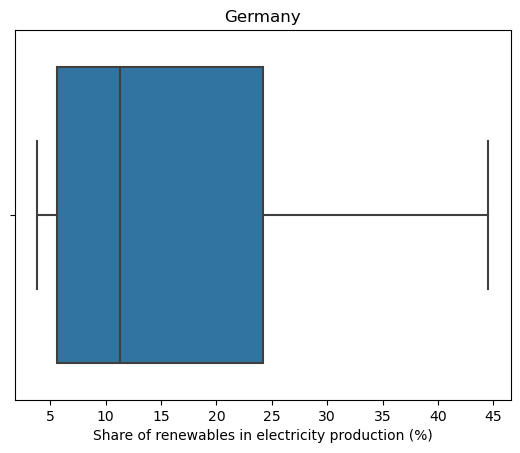

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


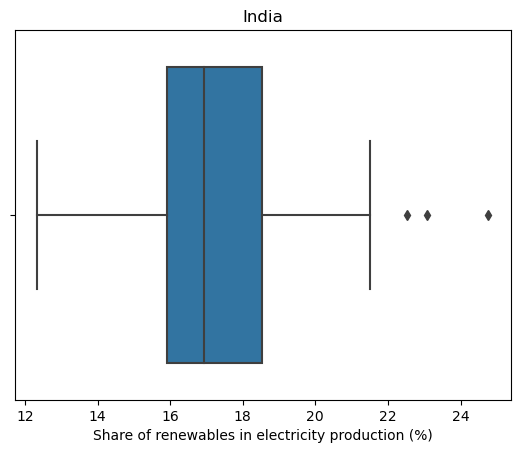

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


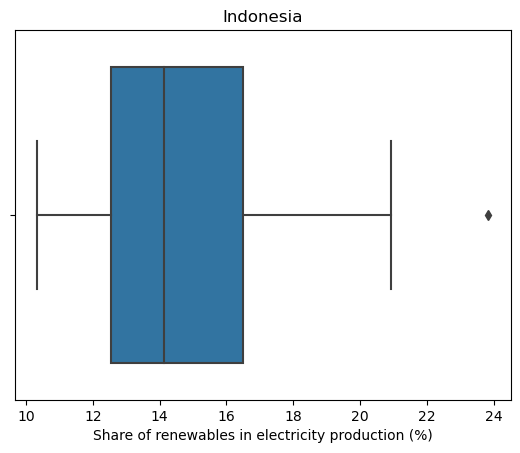

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


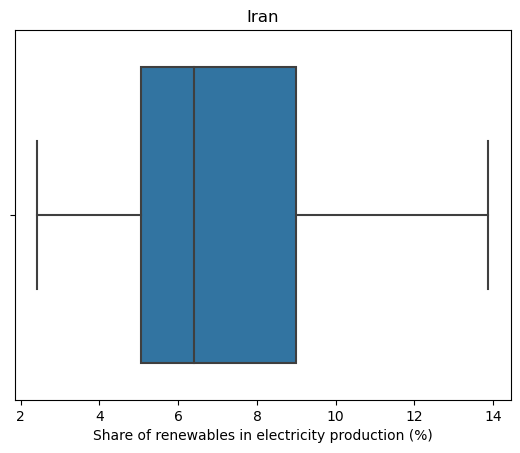

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


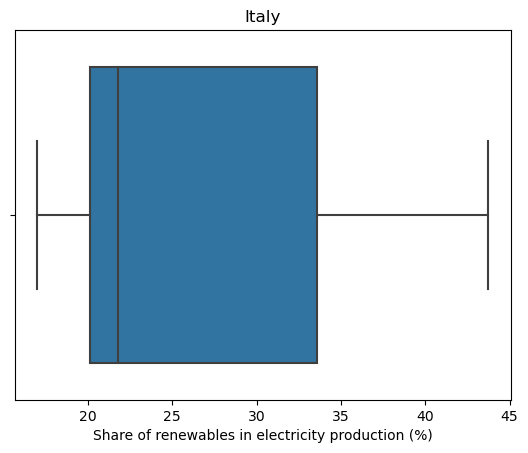

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


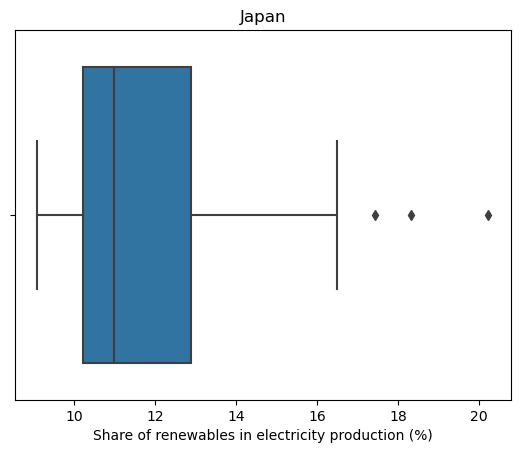

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


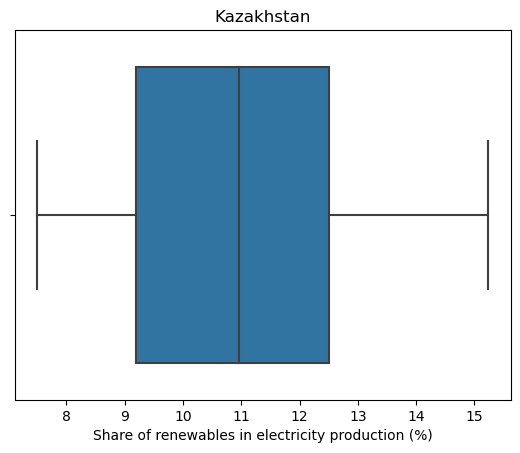

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


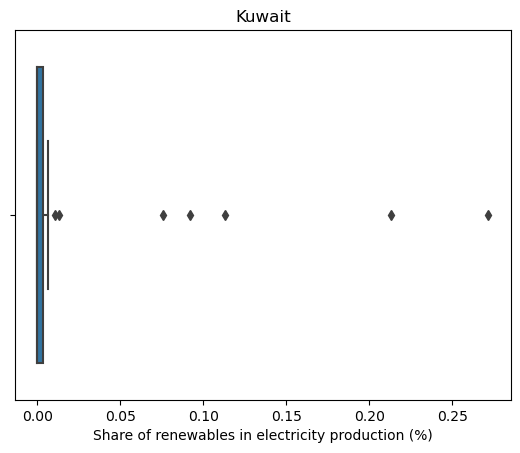

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


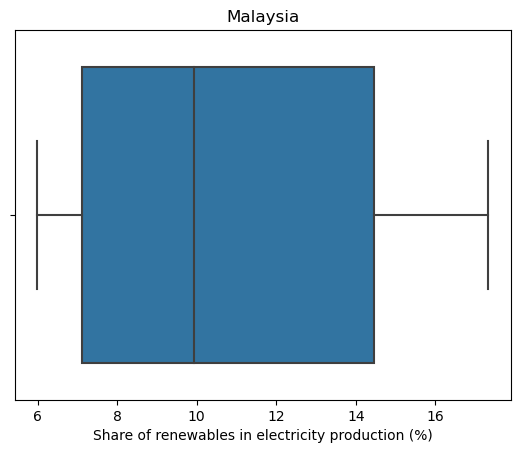

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


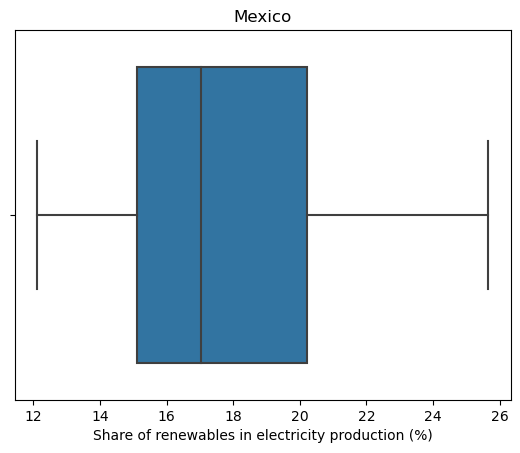

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


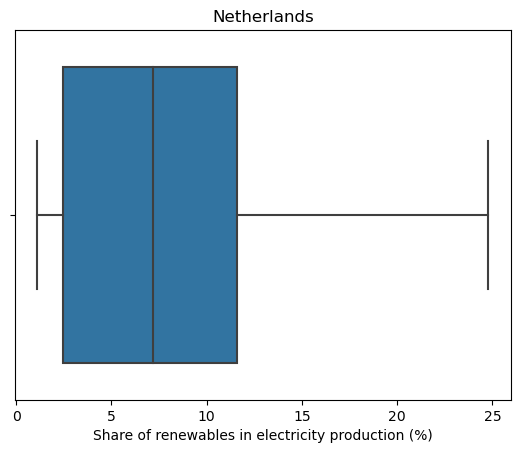

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


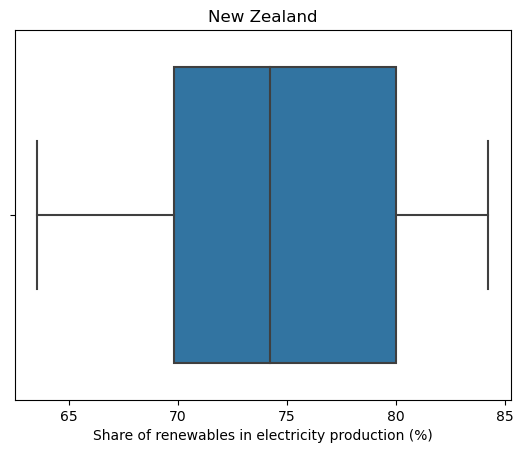

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


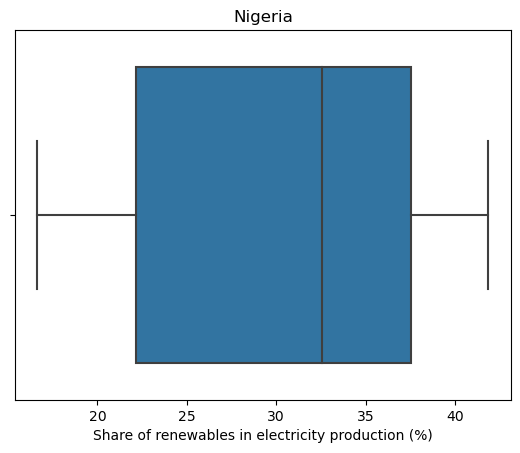

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


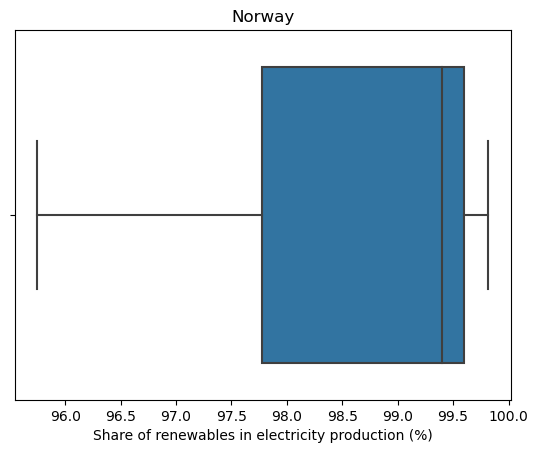

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


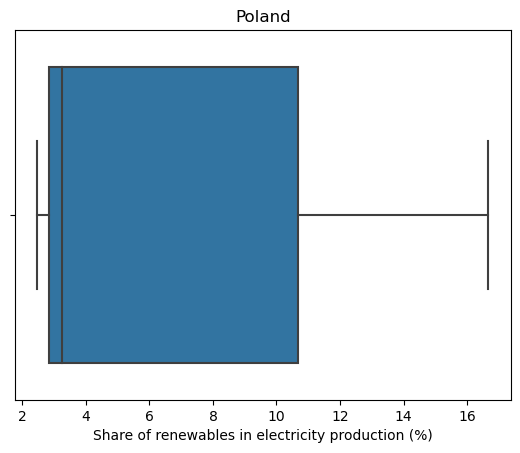

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


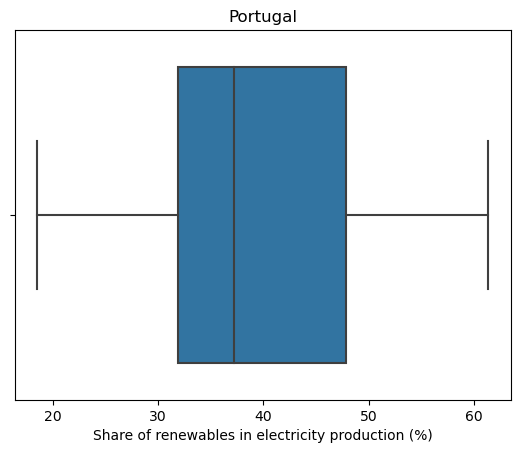

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


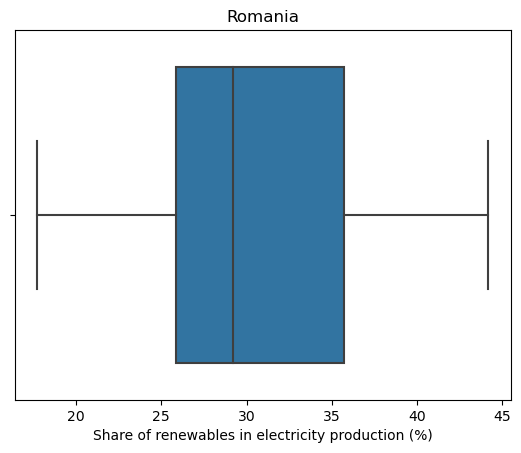

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


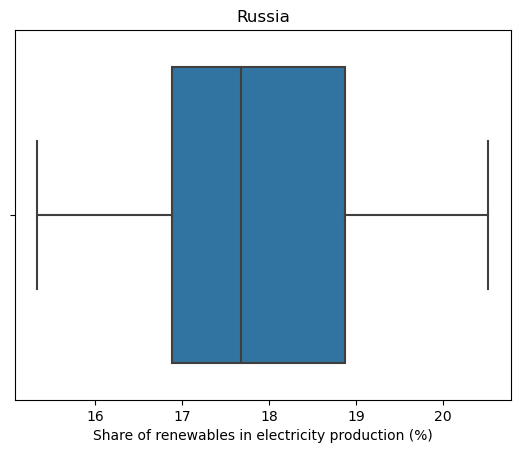

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


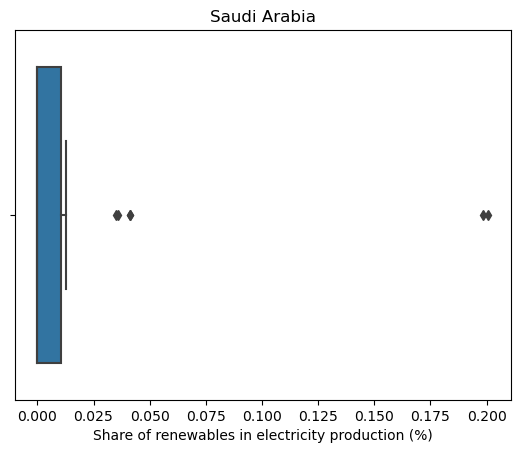

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


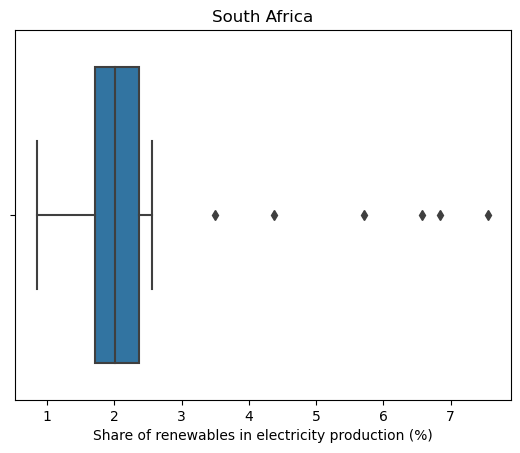

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


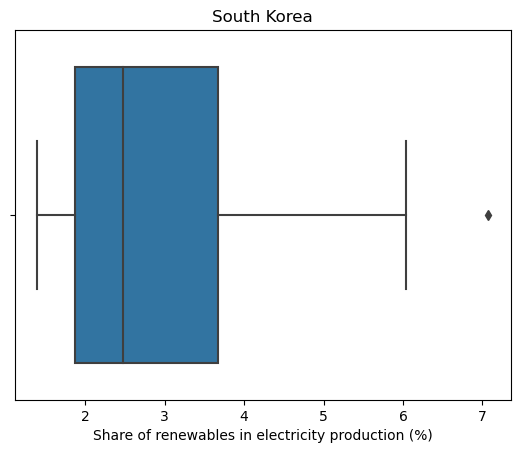

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


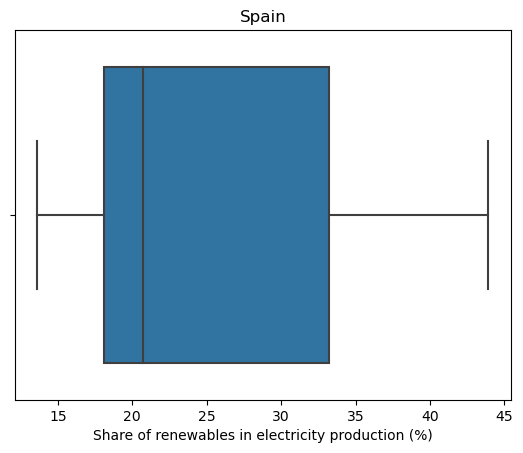

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


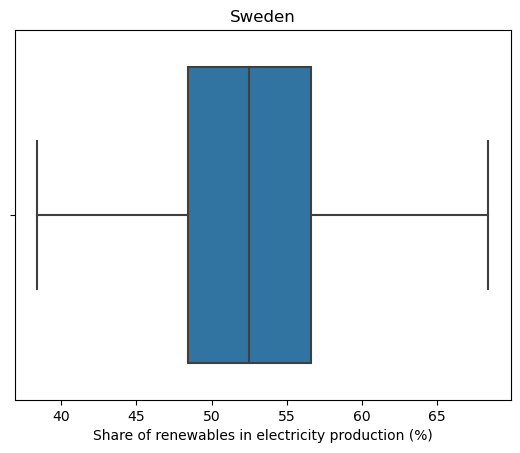

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


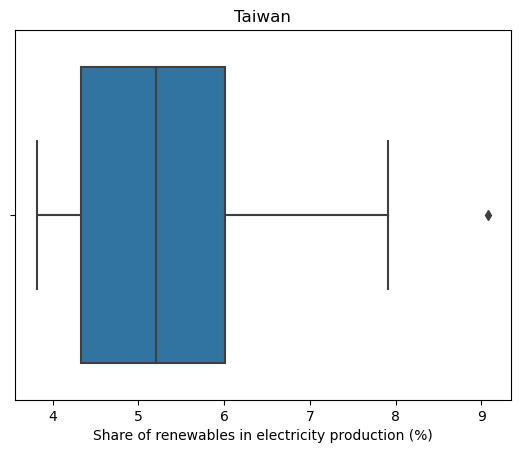

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


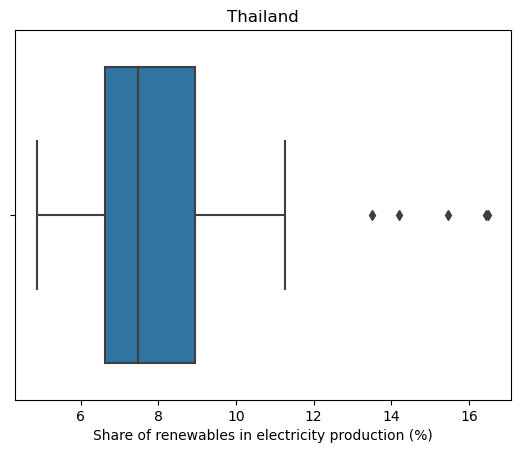

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


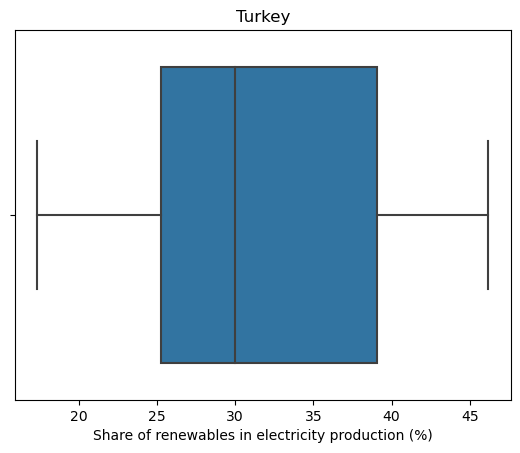

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


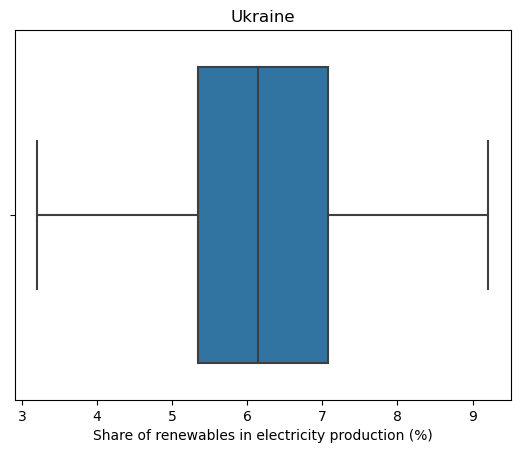

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


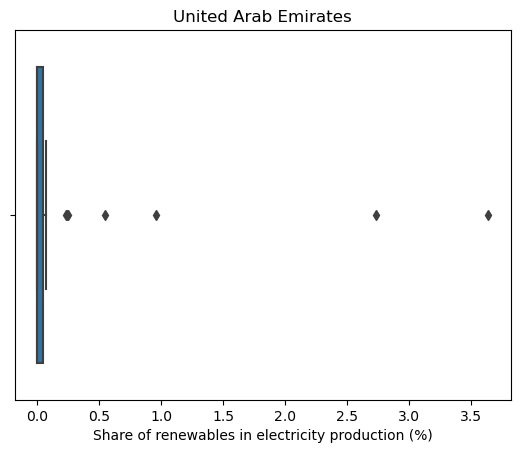

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


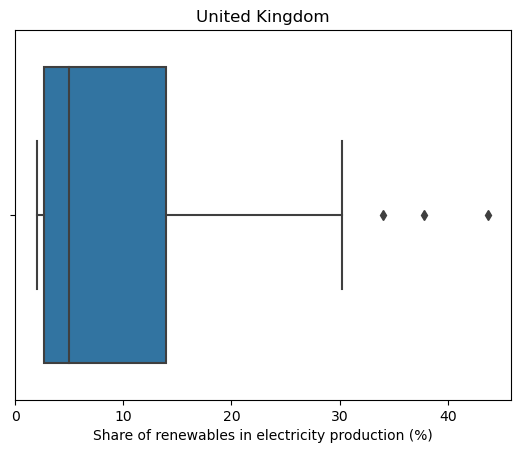

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


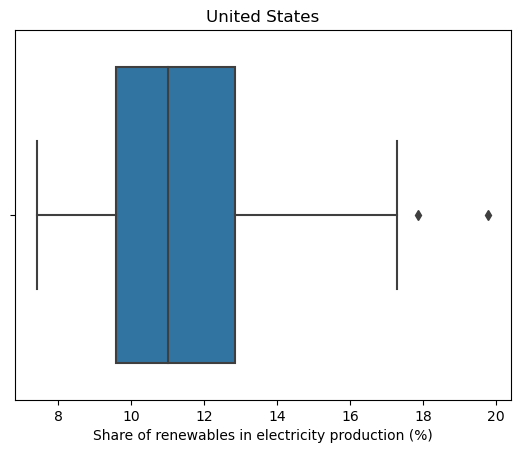

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


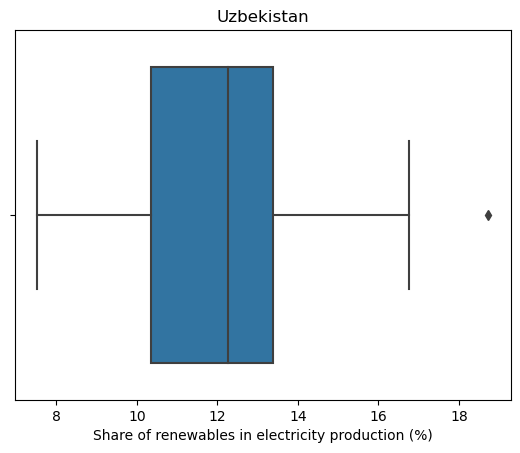

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


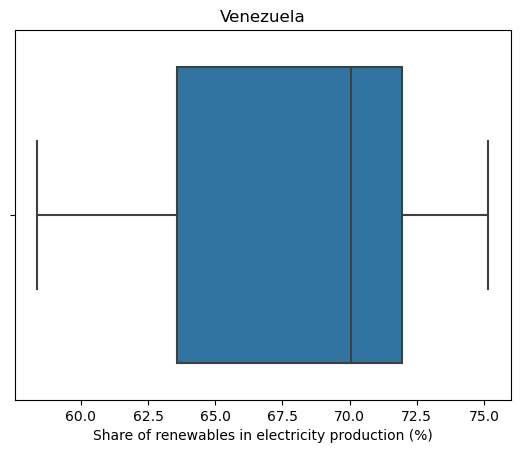

In [36]:
for o in range(len(new_data)):
    sns.boxplot(new_data[o]["Share of renewables in electricity production (%)"])
    plt.title(countries[o])
    plt.show()

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


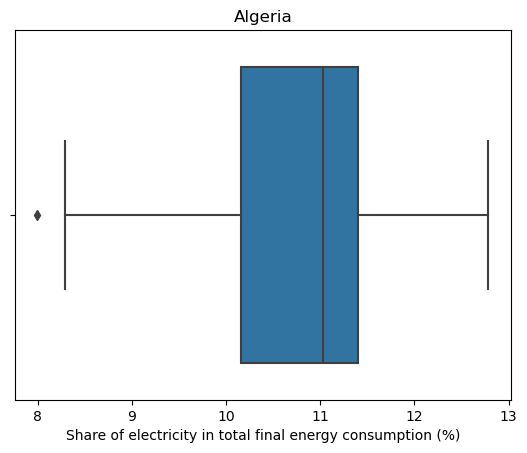

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


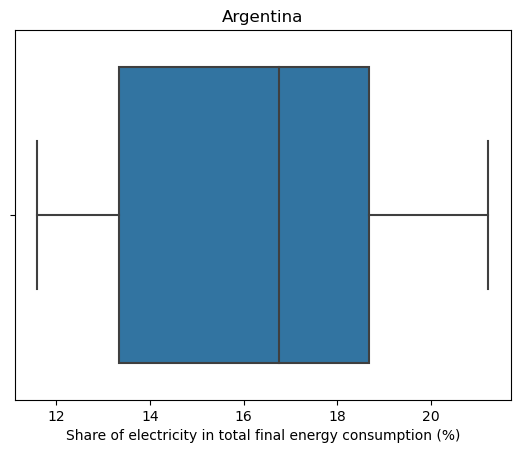

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


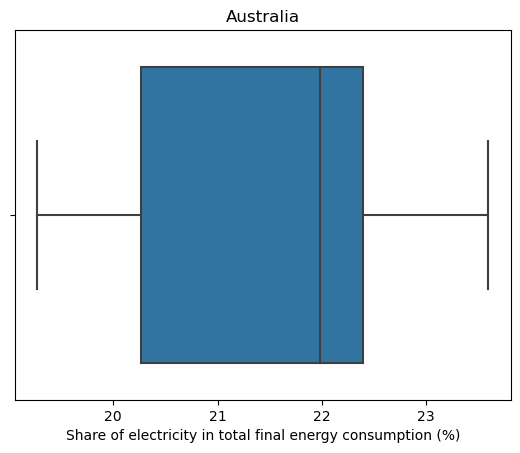

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


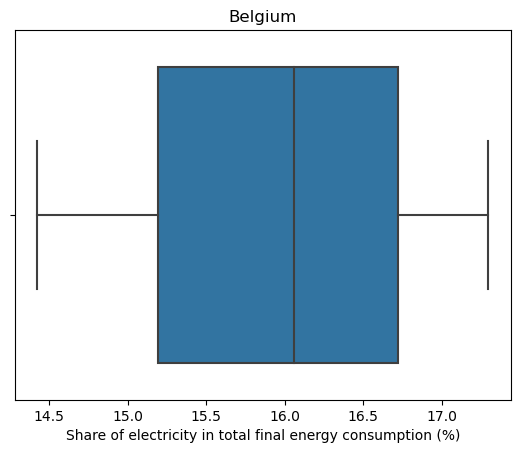

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


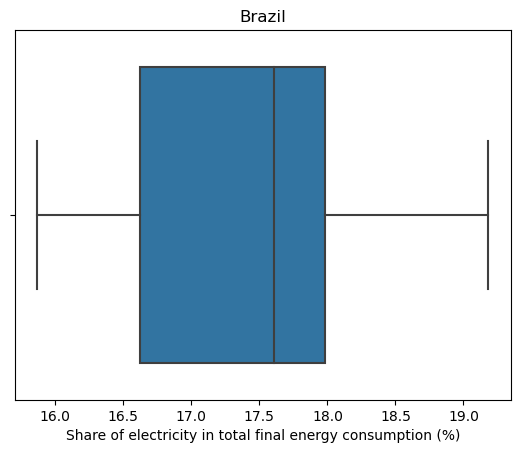

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


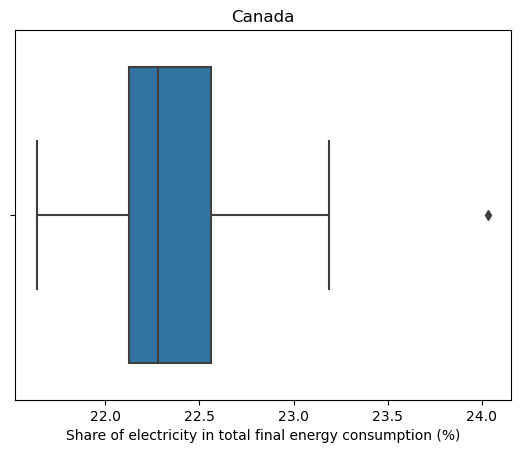

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


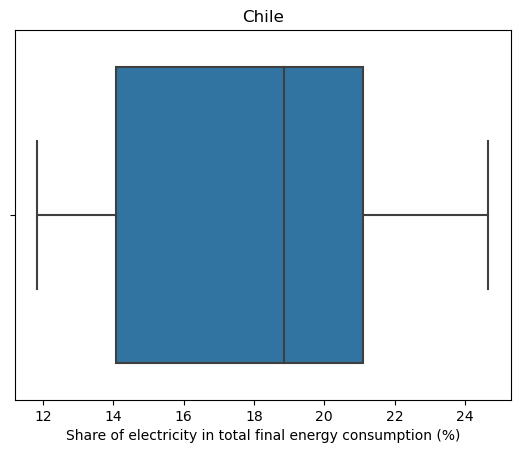

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


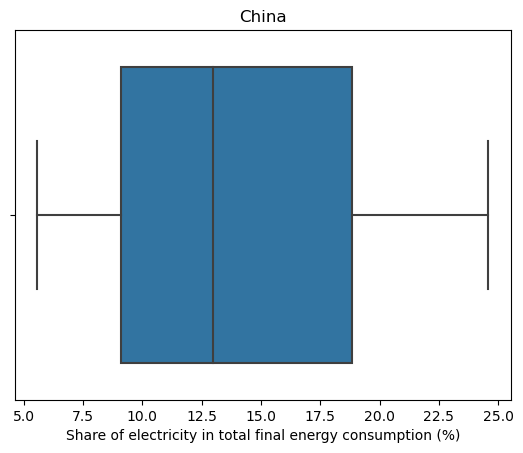

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


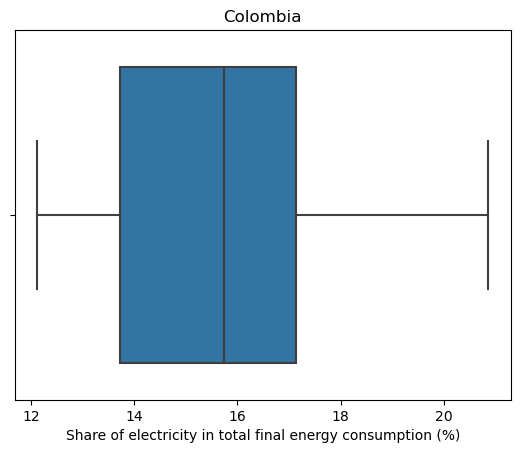

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


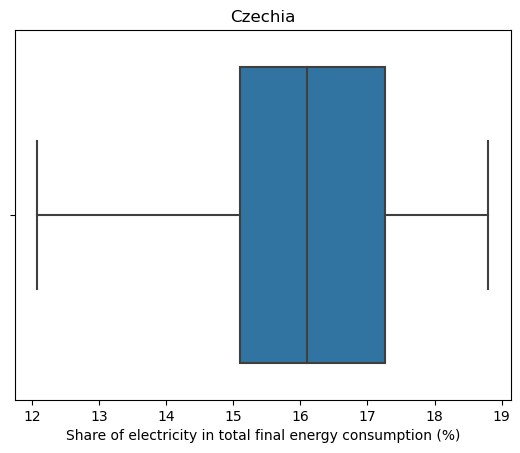

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


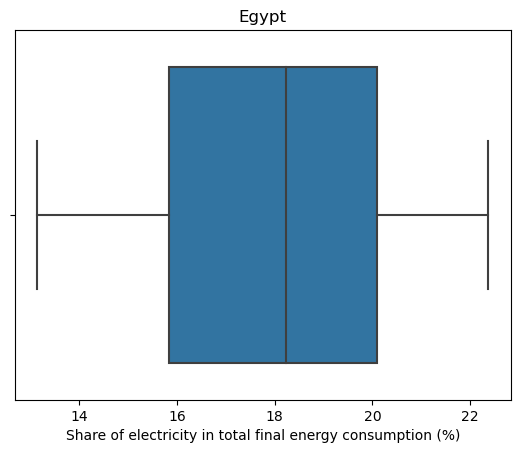

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


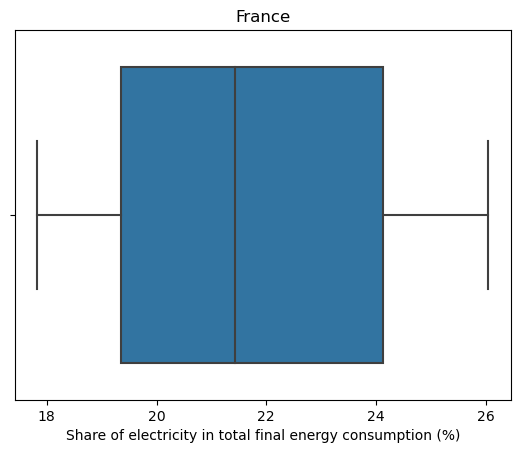

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


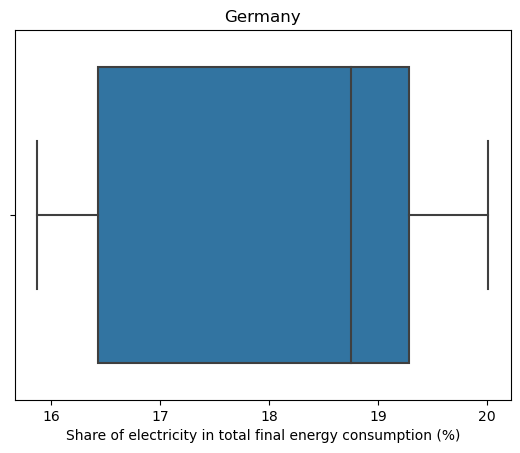

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


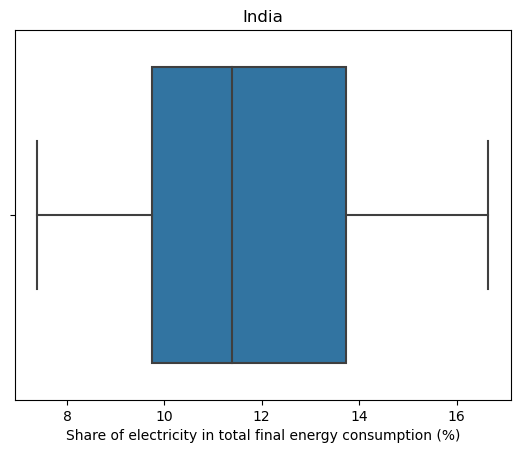

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


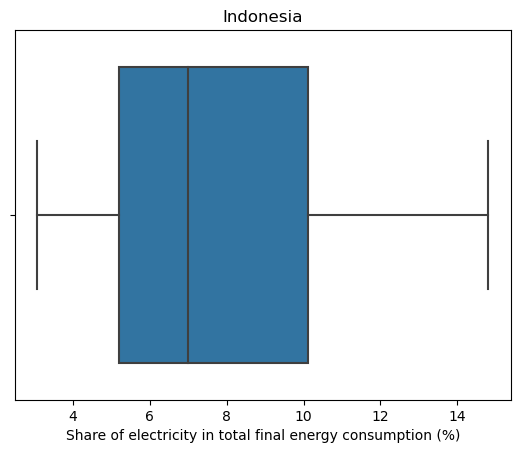

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


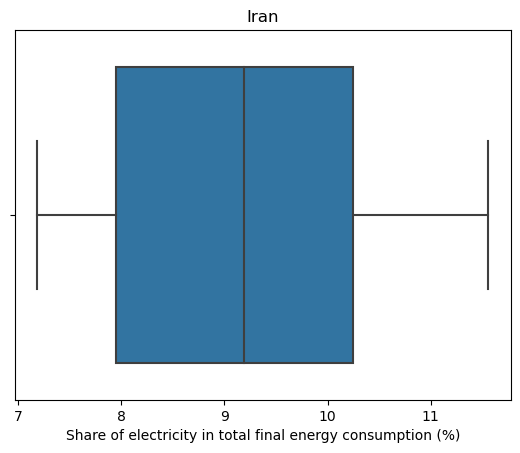

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


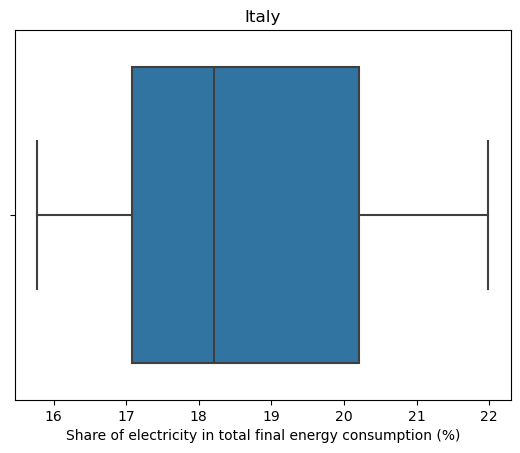

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


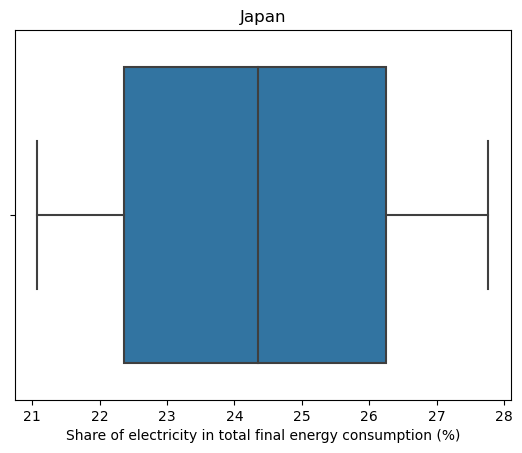

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


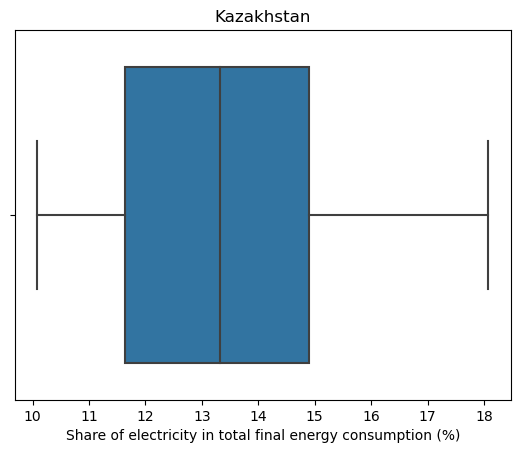

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


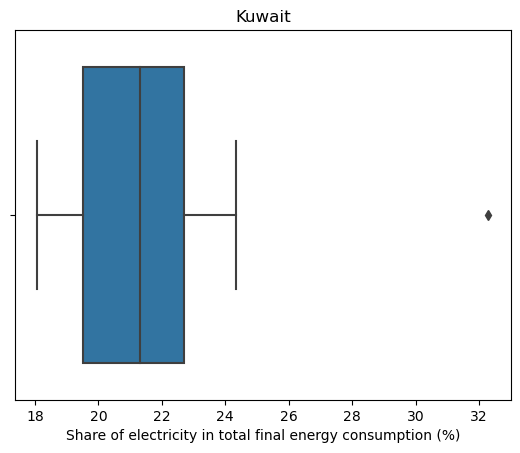

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


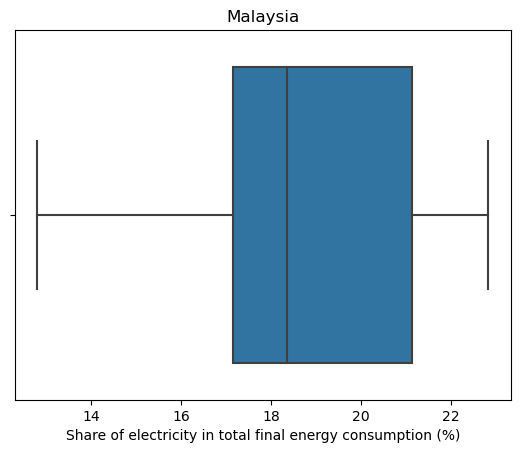

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


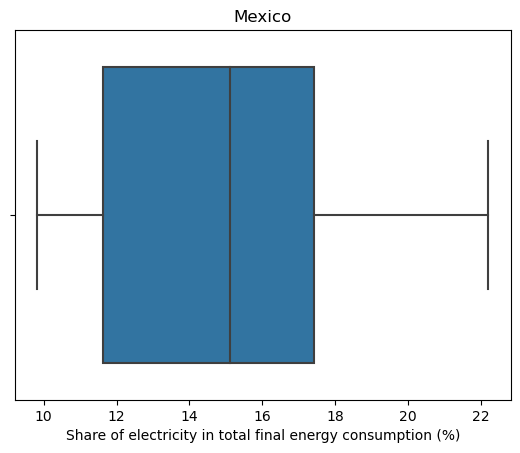

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


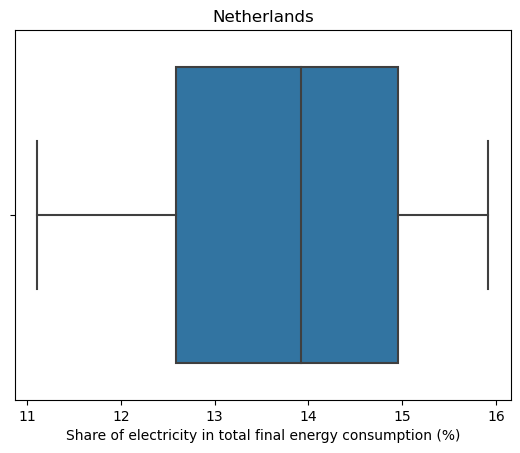

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


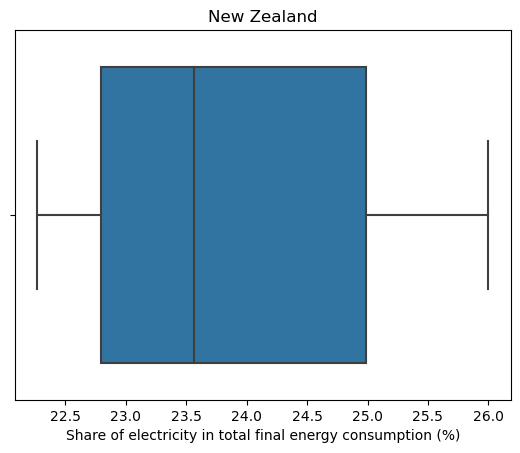

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


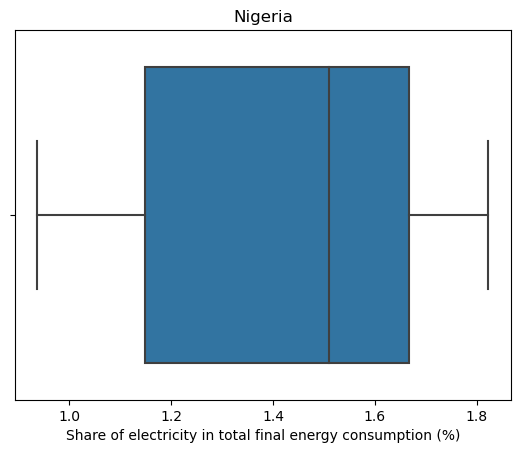

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


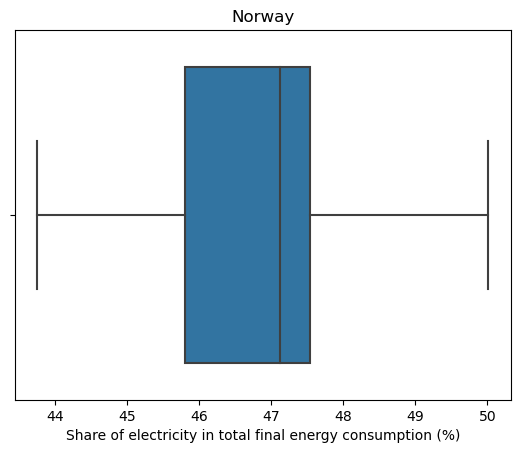

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


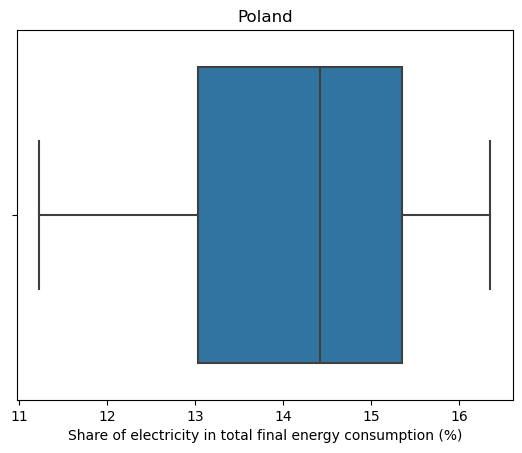

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


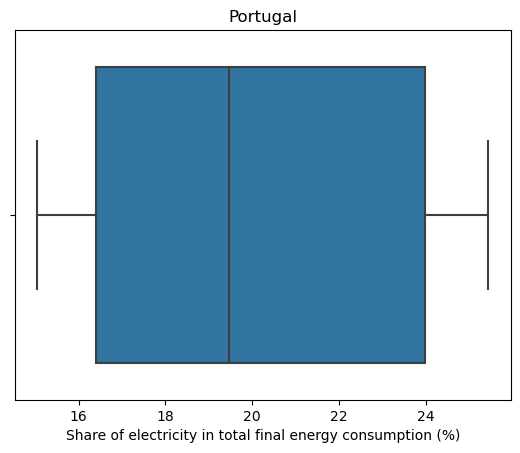

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


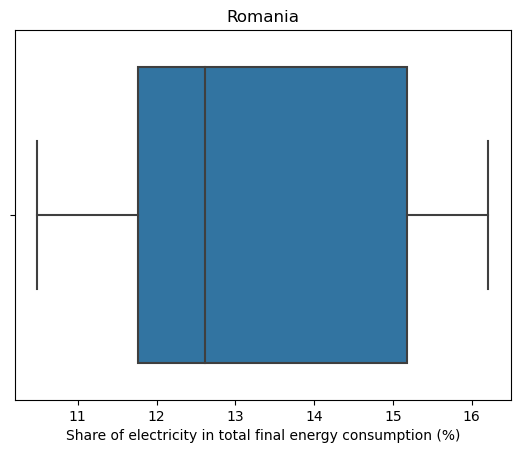

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


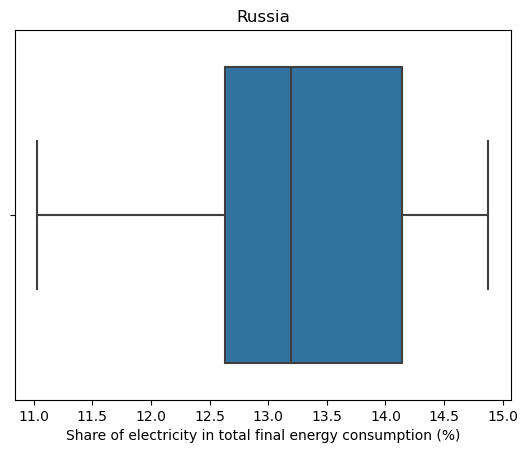

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


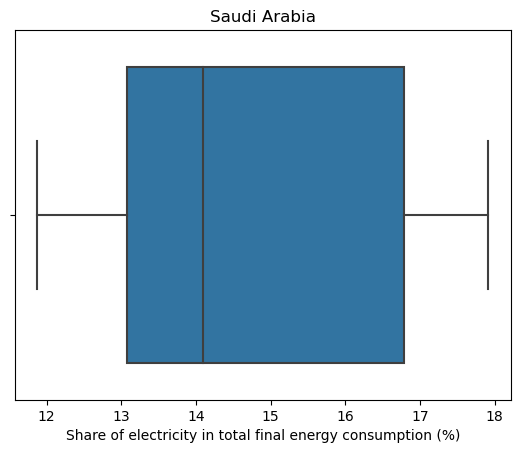

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


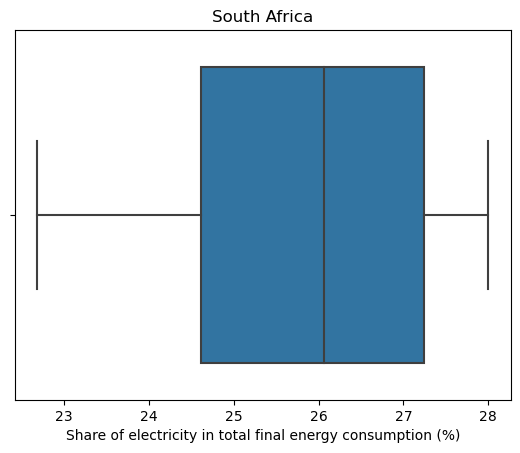

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


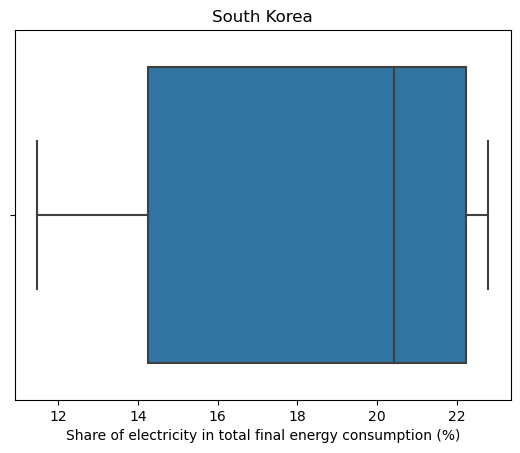

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


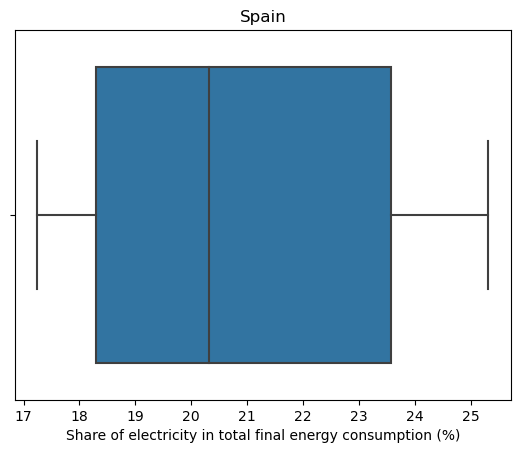

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


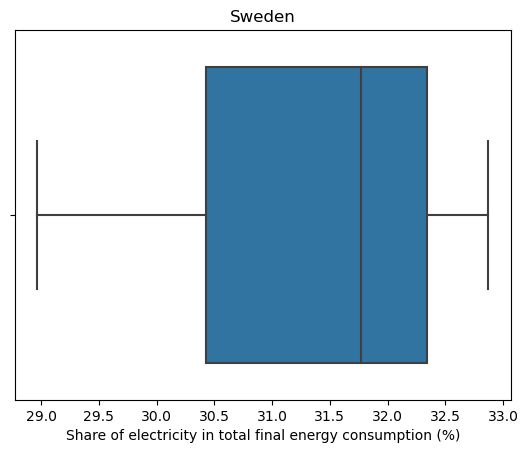

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


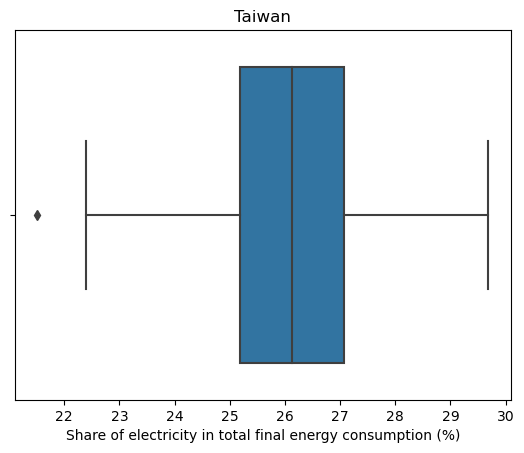

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


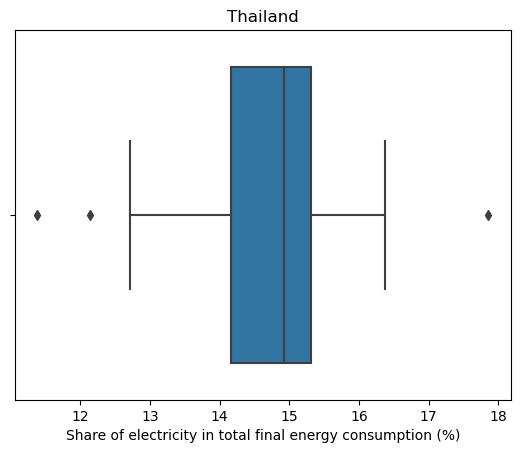

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


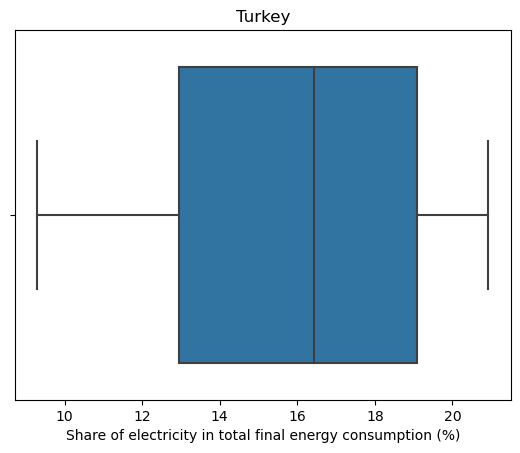

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


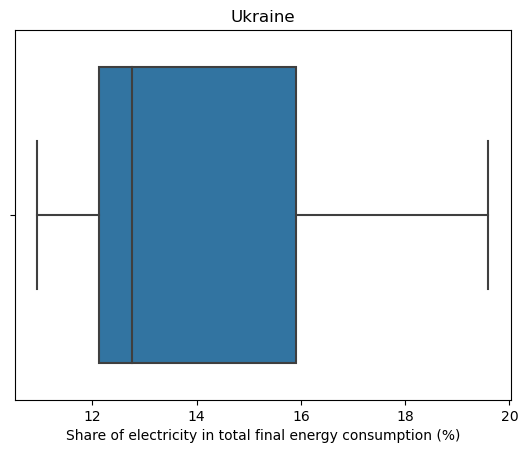

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


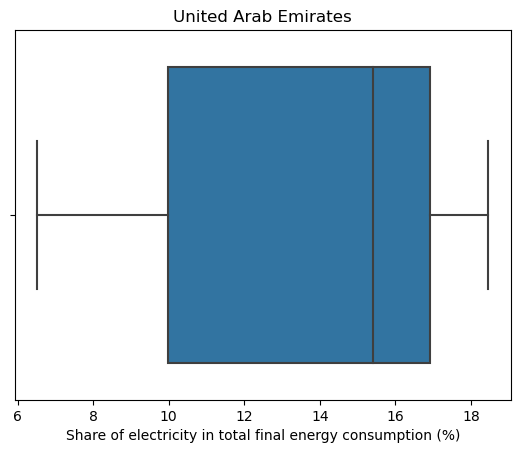

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


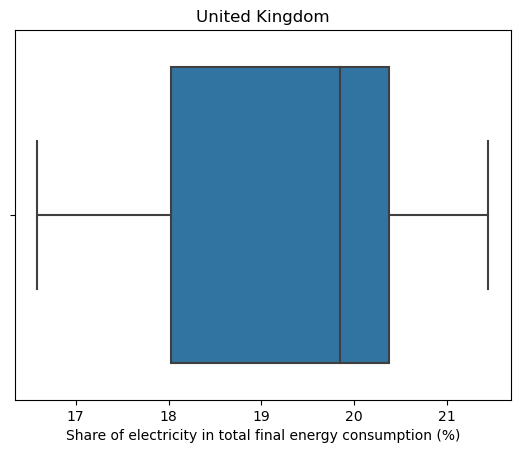

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


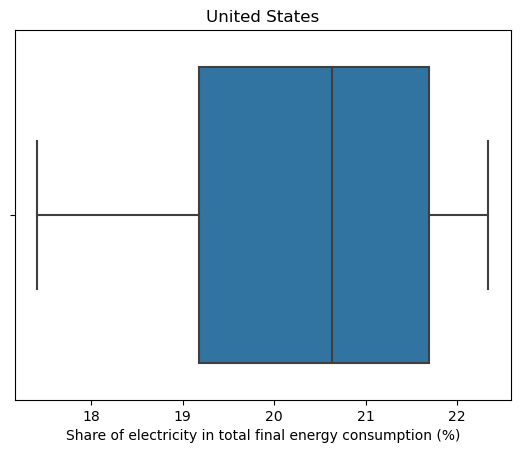

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


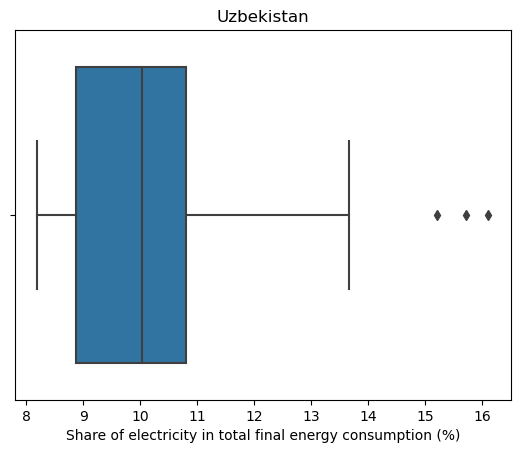

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


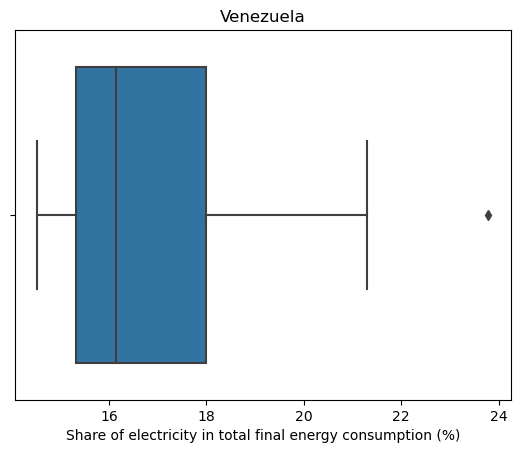

In [37]:
for o in range(len(new_data)):
    sns.boxplot(new_data[o]["Share of electricity in total final energy consumption (%)"])
    plt.title(countries[o])
    plt.show()

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


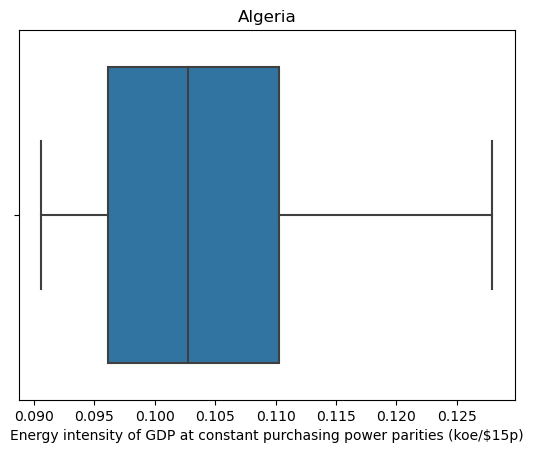

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


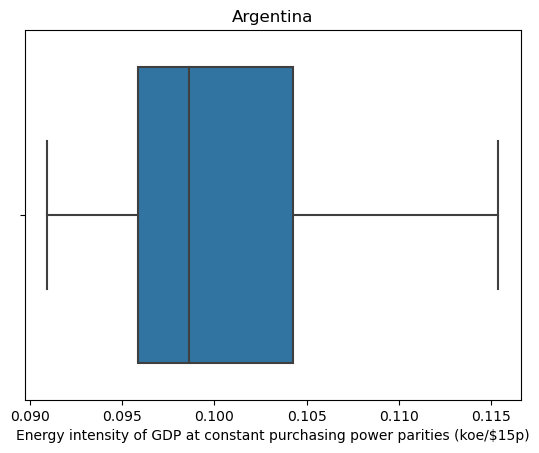

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


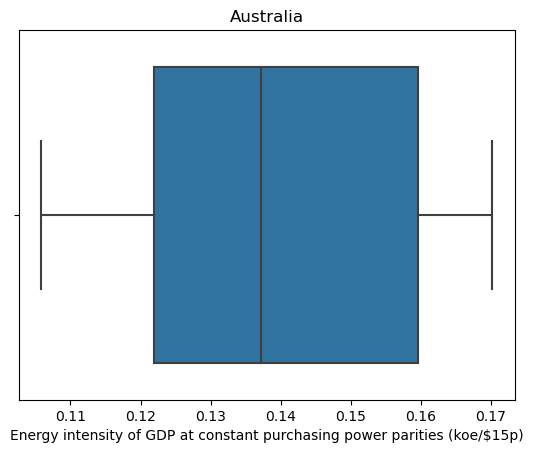

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


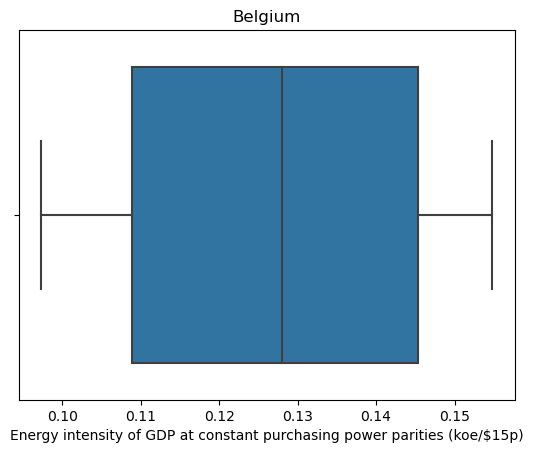

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


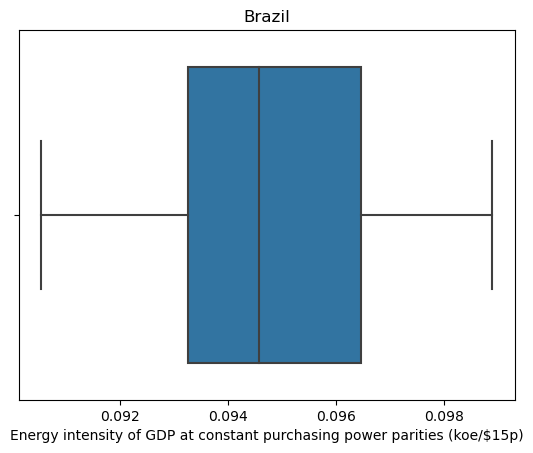

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


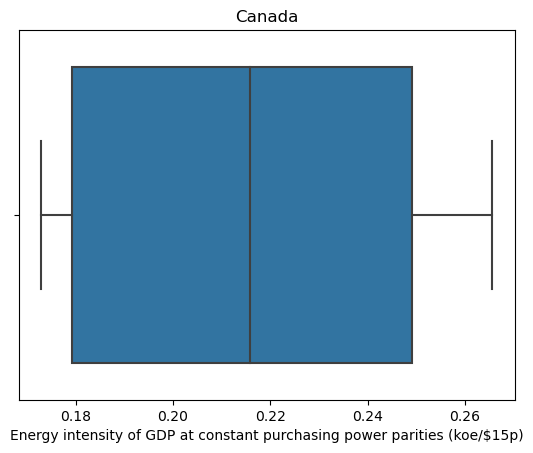

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


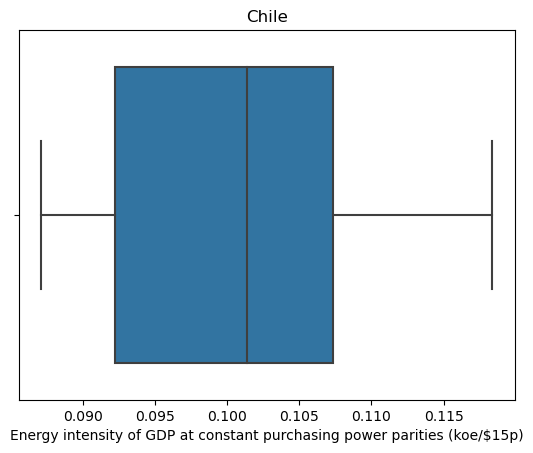

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


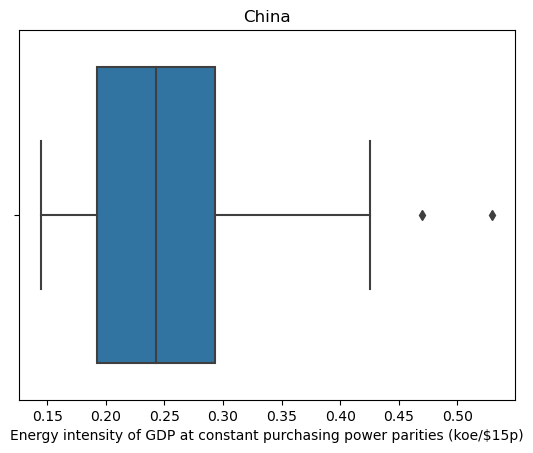

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


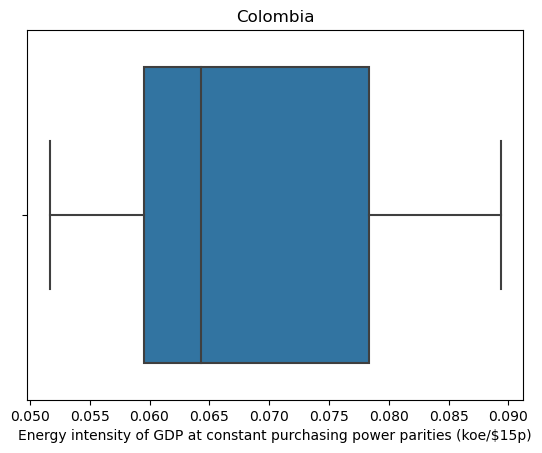

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


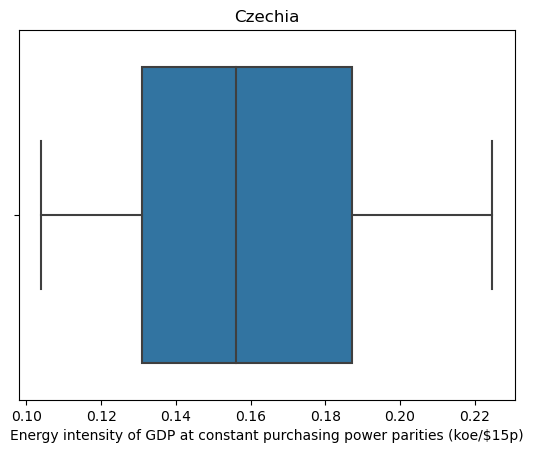

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


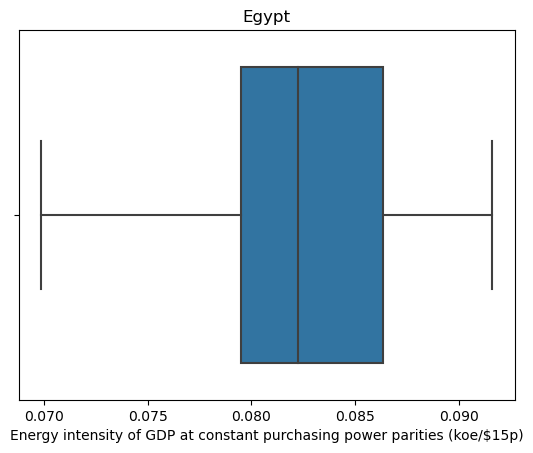

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


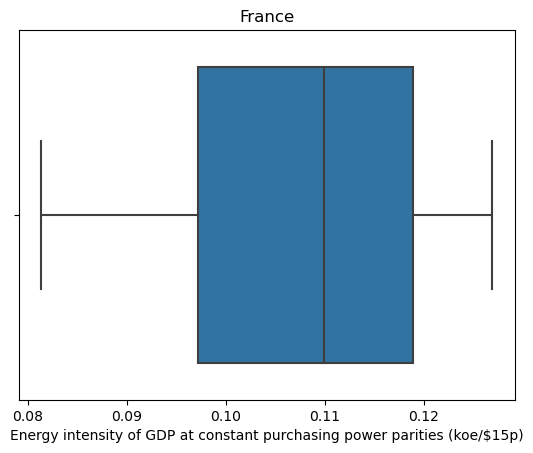

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


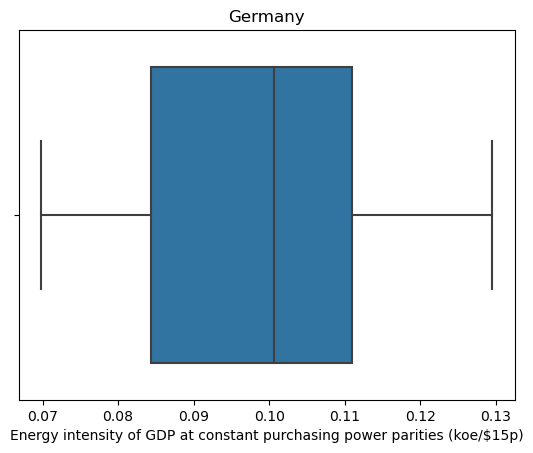

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


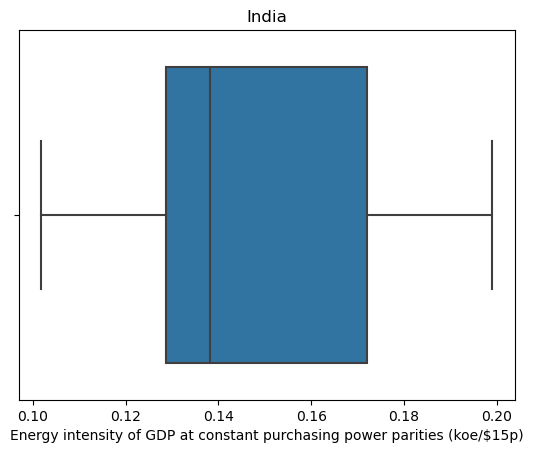

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


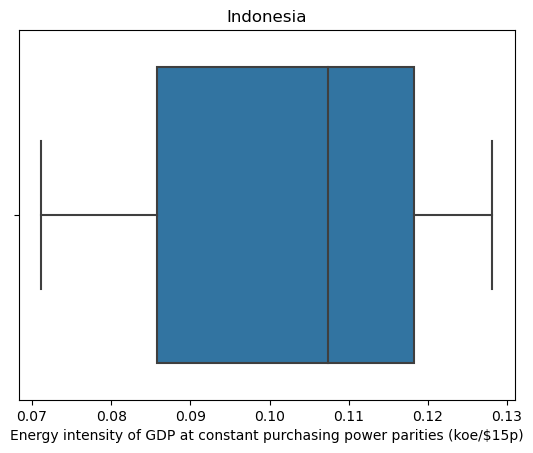

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


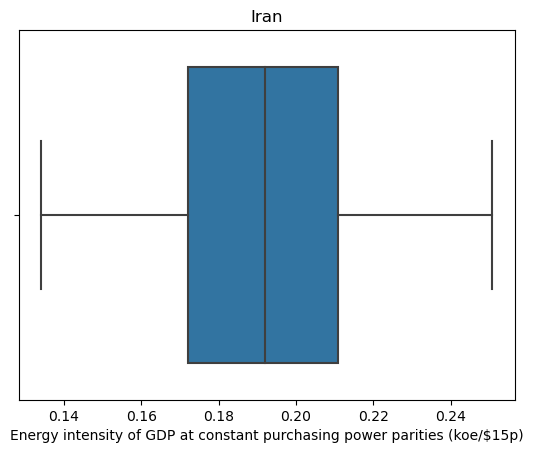

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


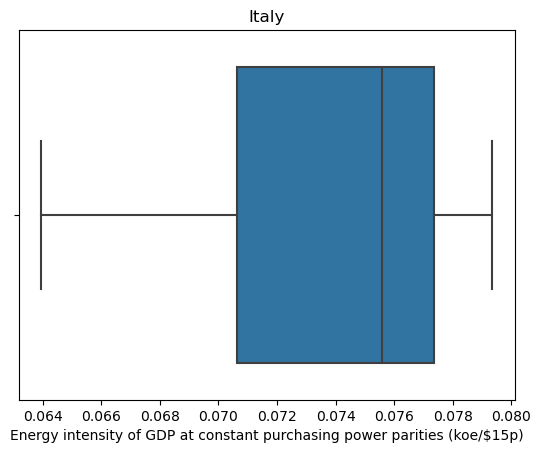

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


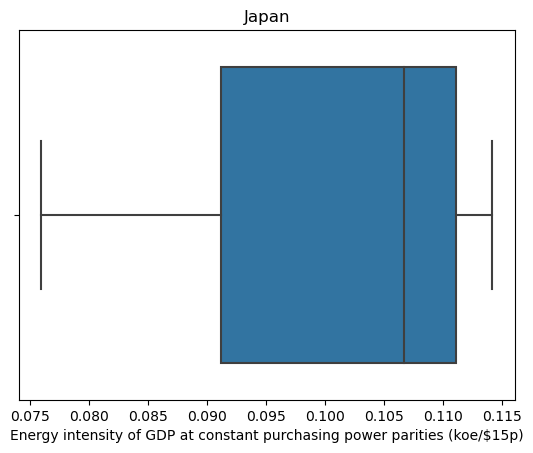

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


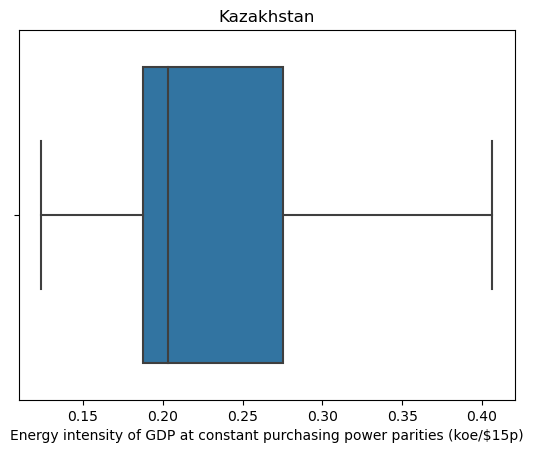

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


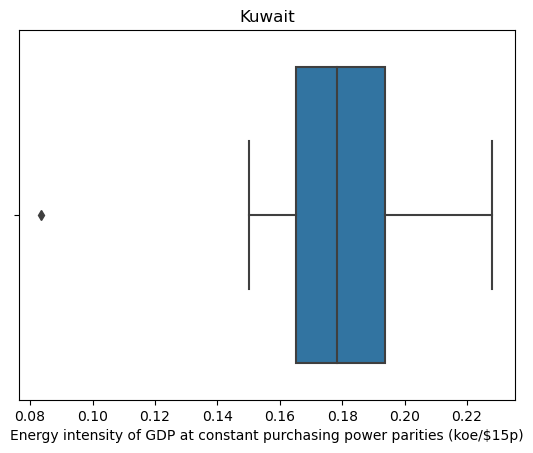

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


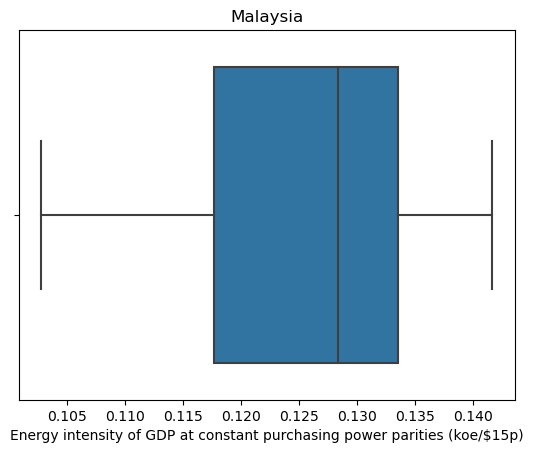

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


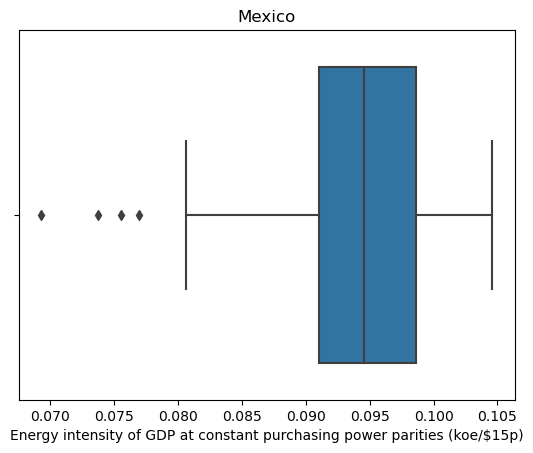

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


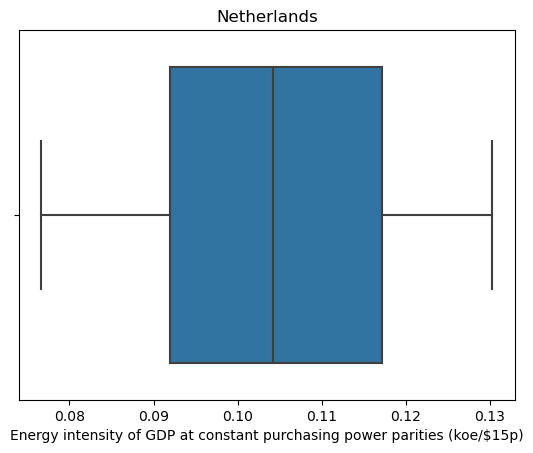

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


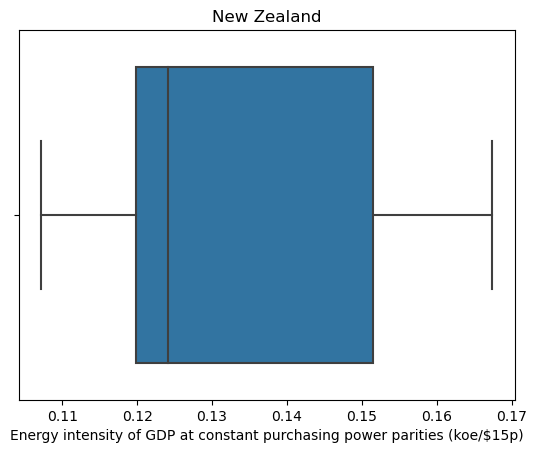

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


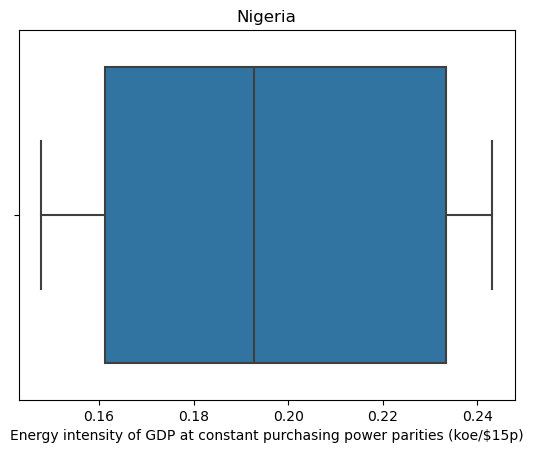

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


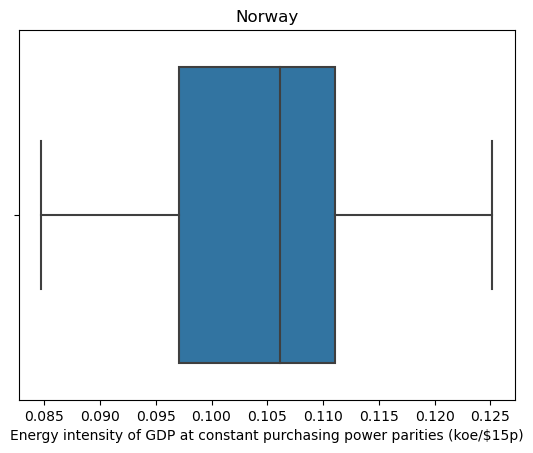

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


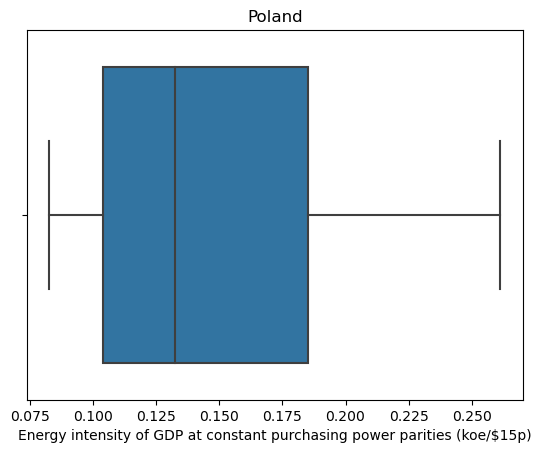

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


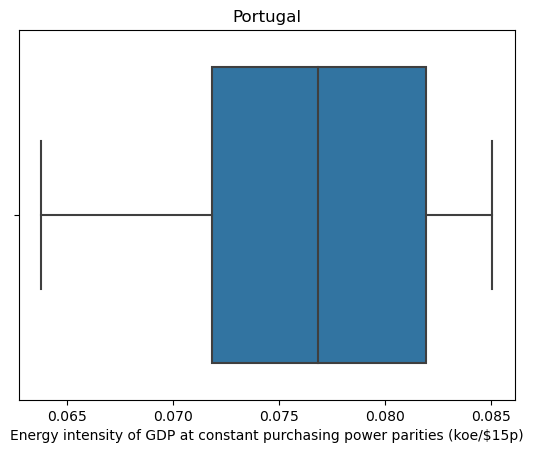

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


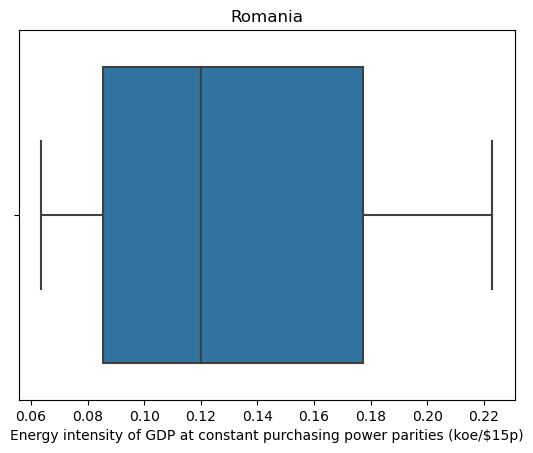

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


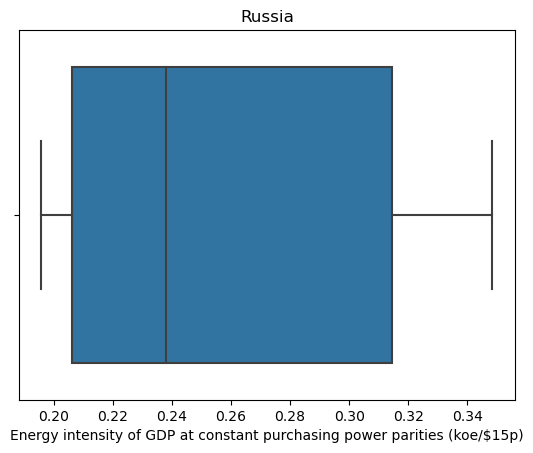

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


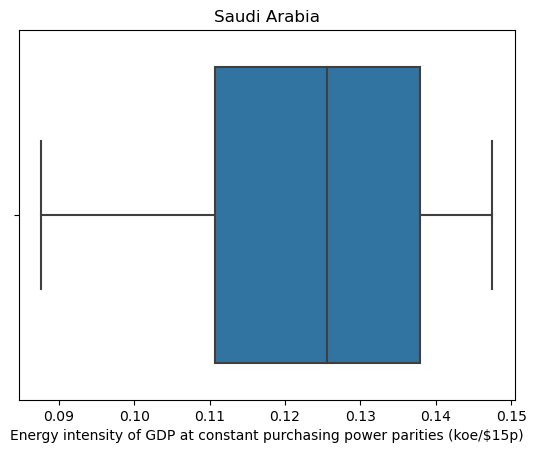

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


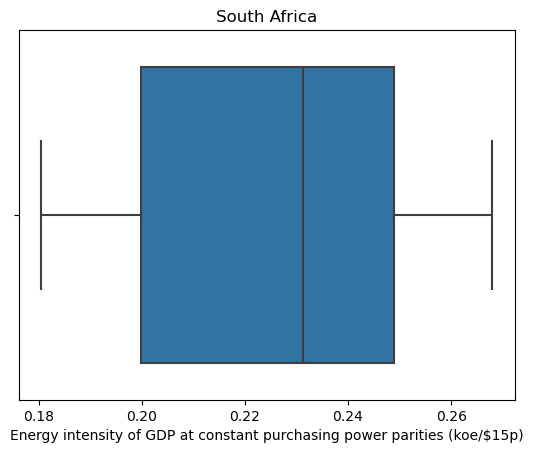

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


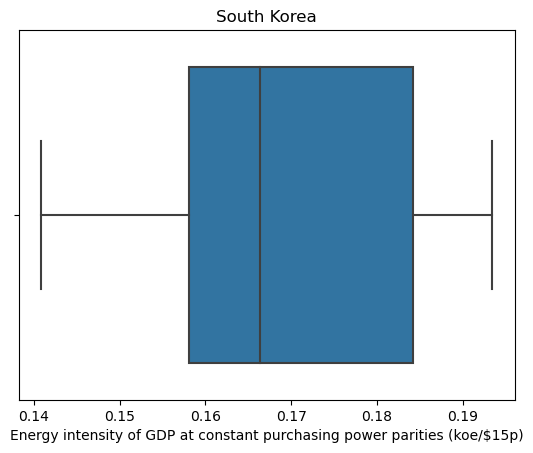

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


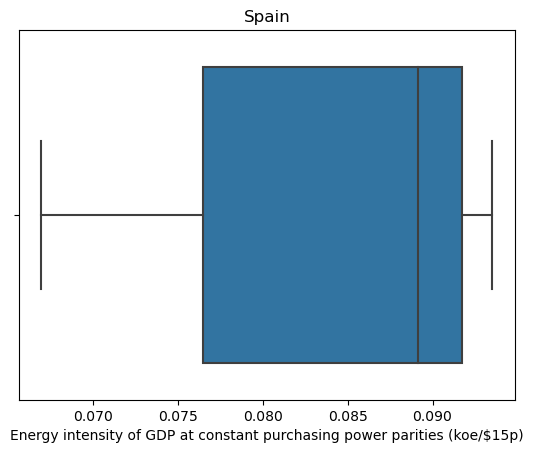

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


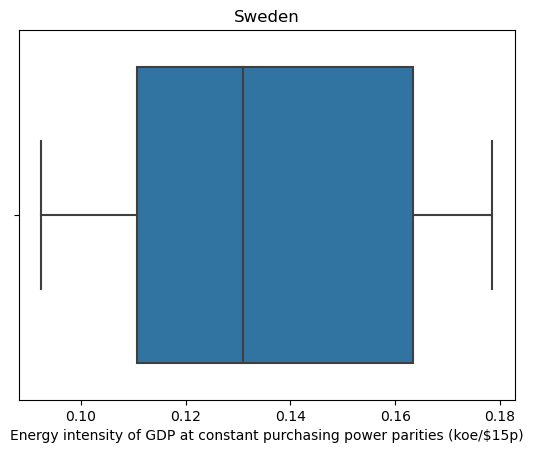

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


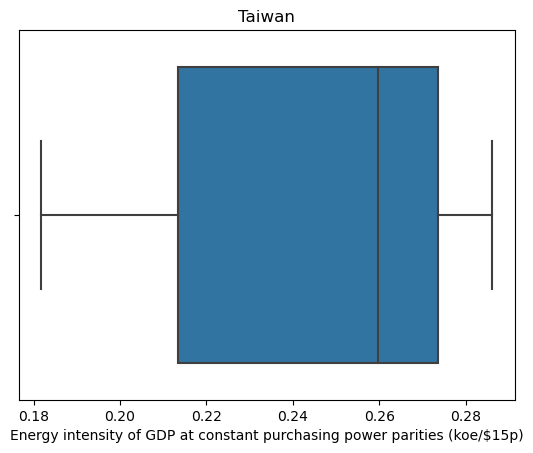

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


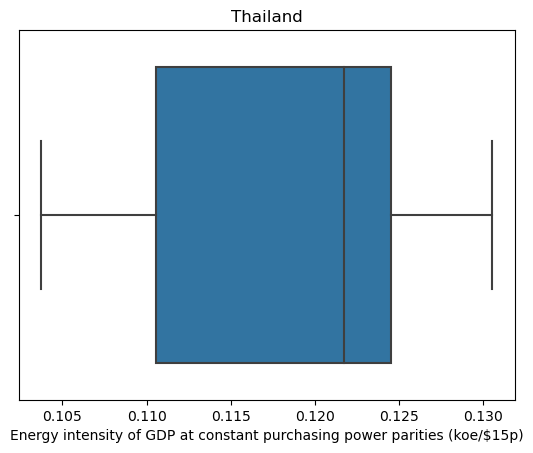

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


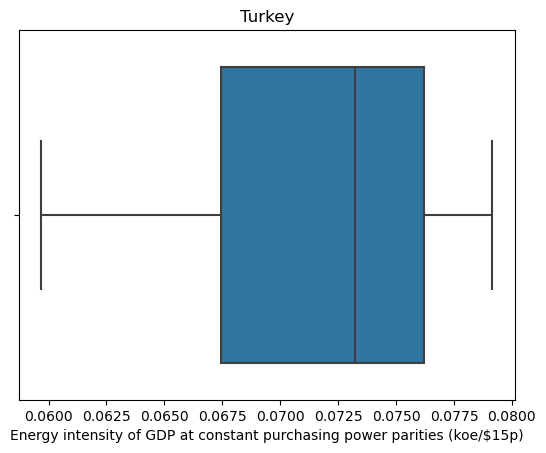

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


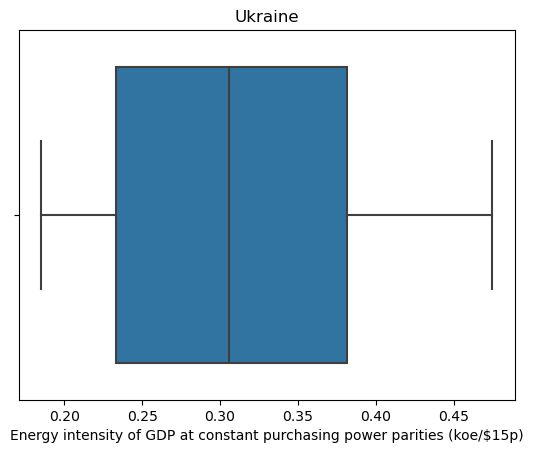

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


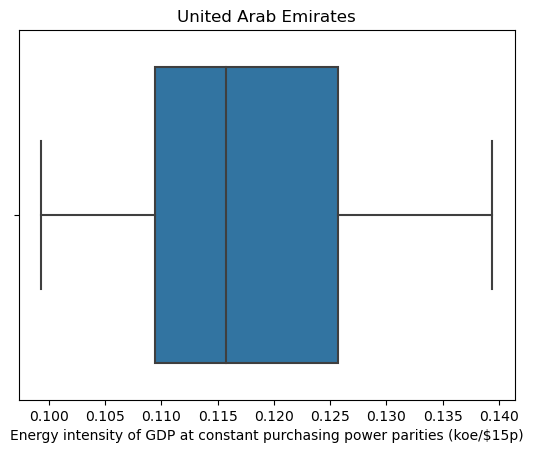

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


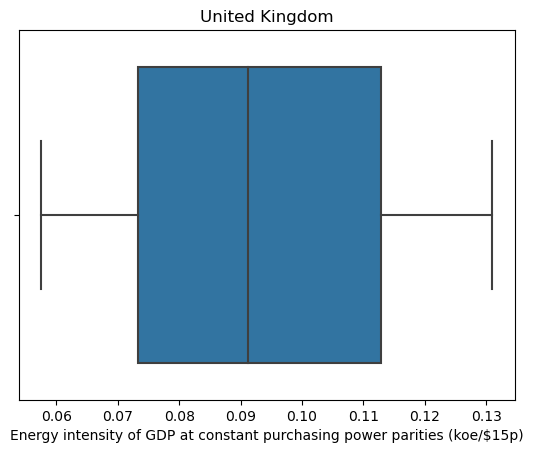

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


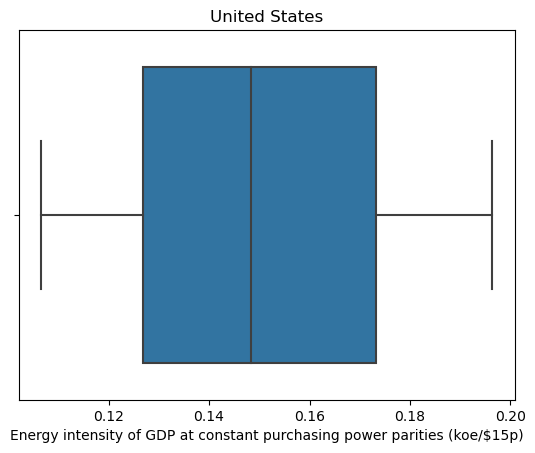

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


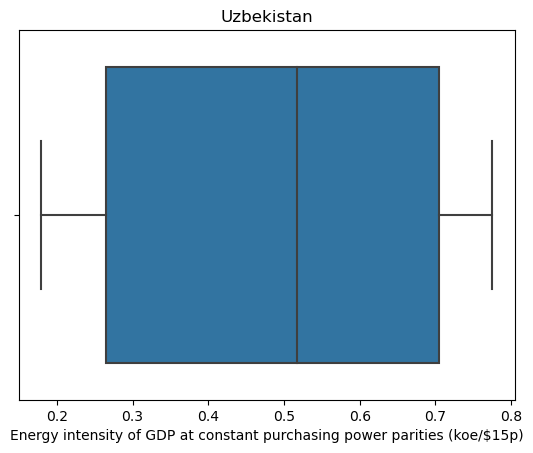

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


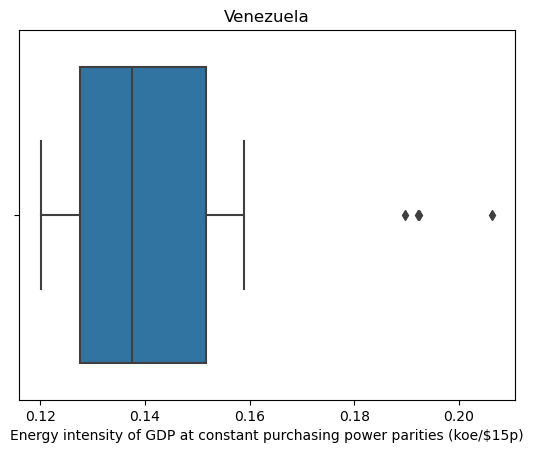

In [38]:
for o in range(len(new_data)):
    sns.boxplot(new_data[o]["Energy intensity of GDP at constant purchasing power parities (koe/$15p)"])
    plt.title(countries[o])
    plt.show()

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


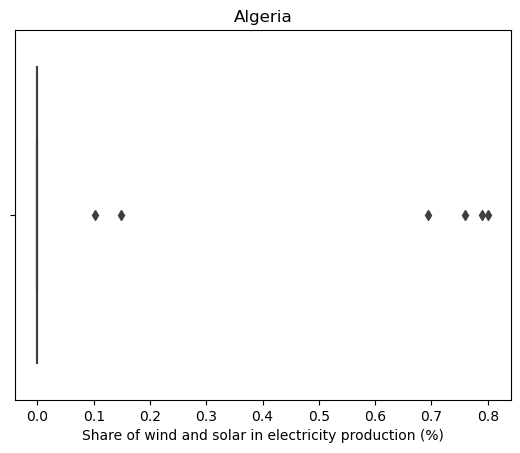

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


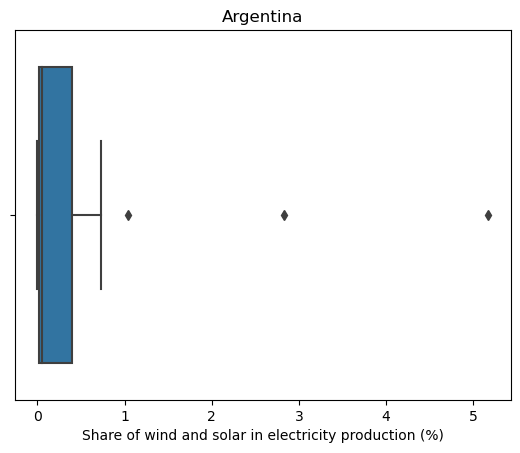

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


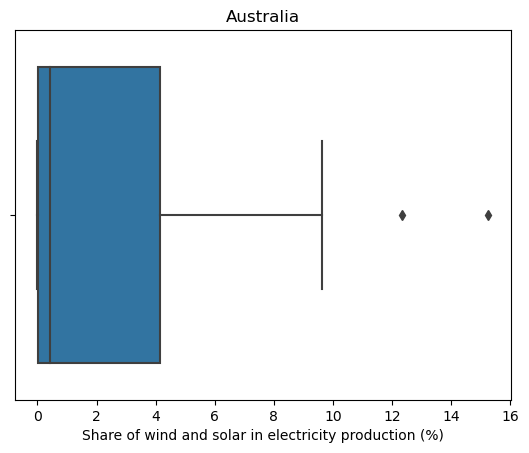

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


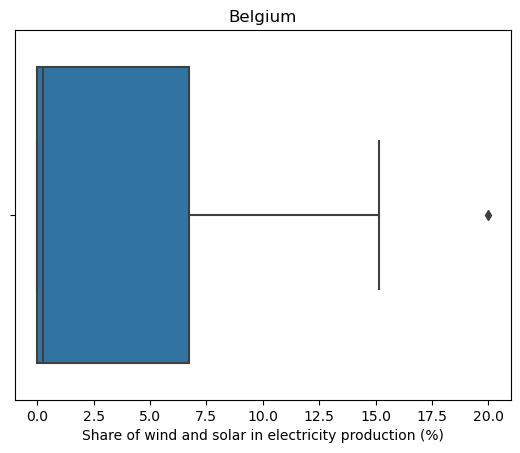

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


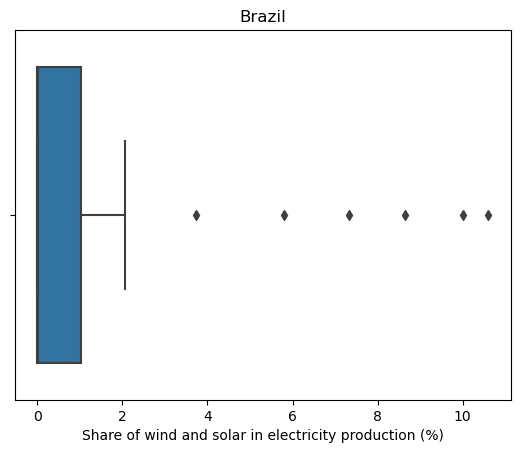

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


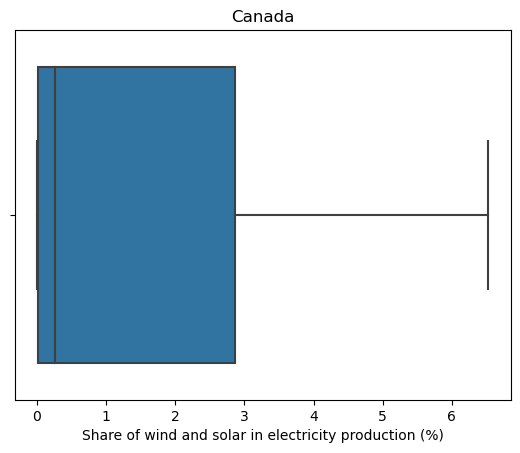

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


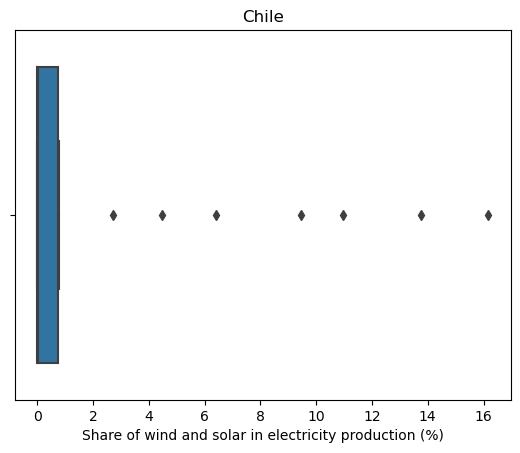

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


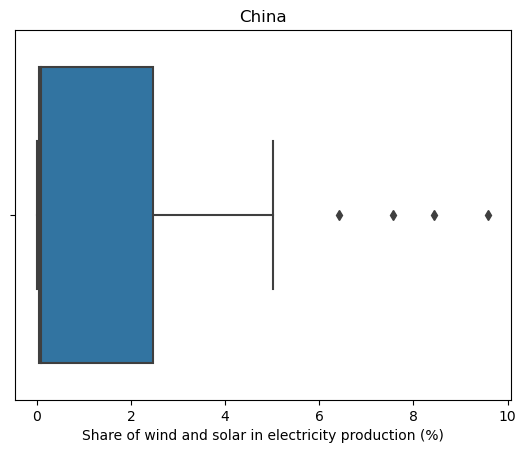

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


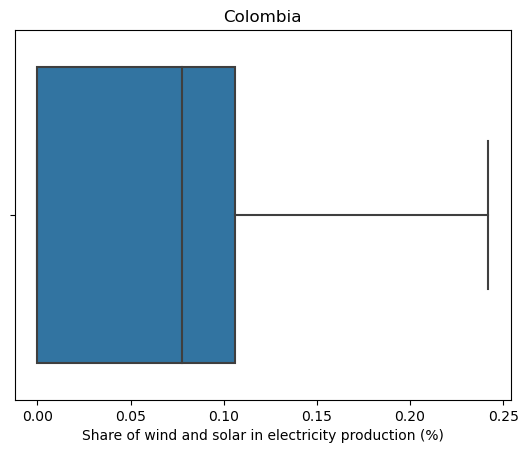

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


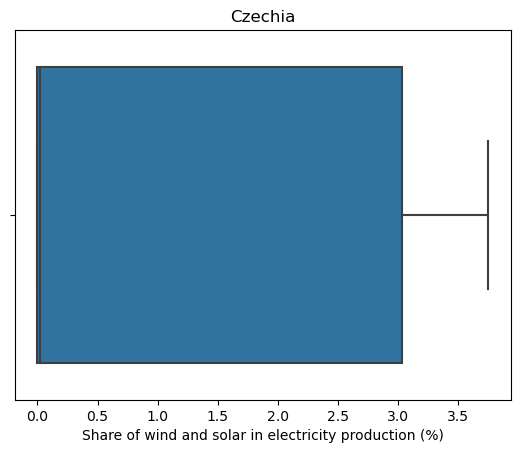

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


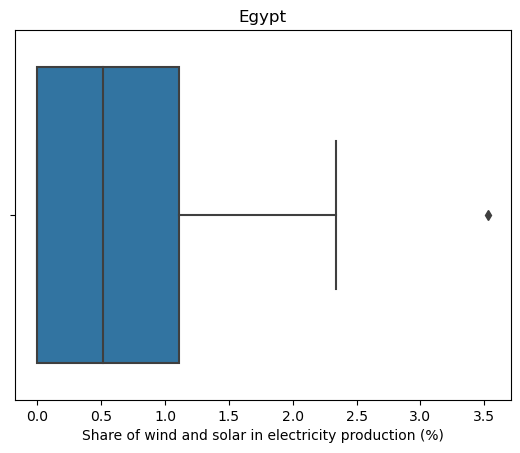

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


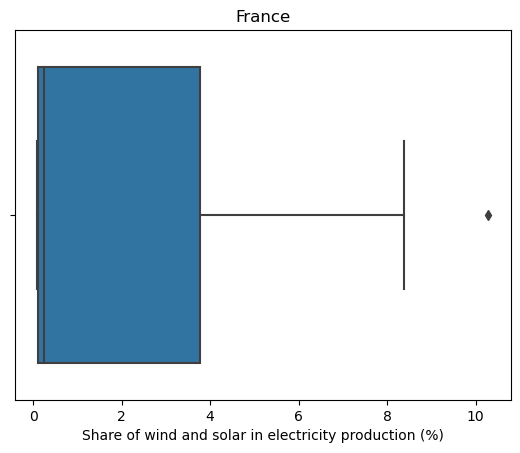

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


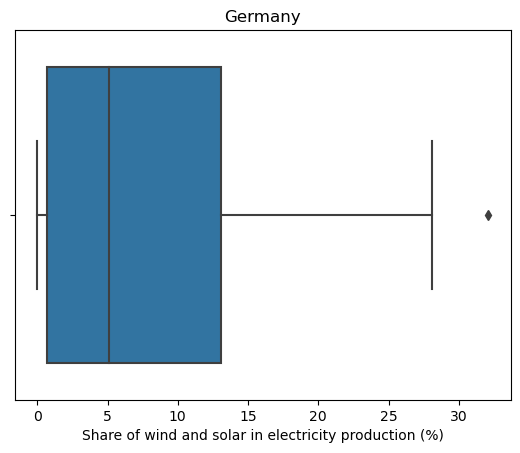

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


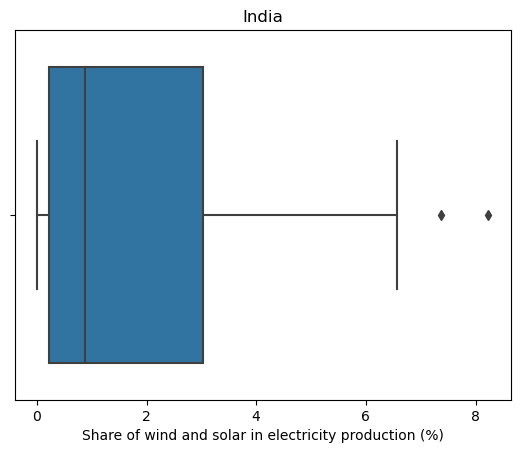

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


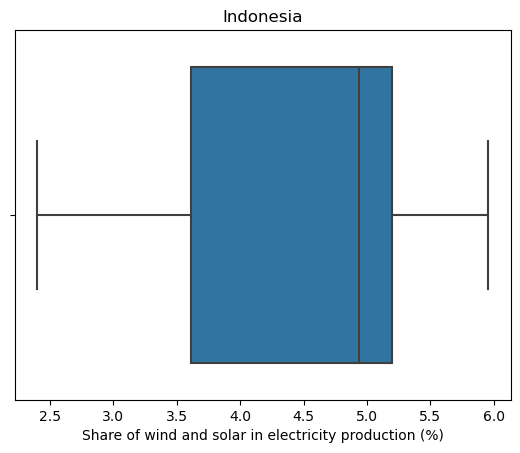

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


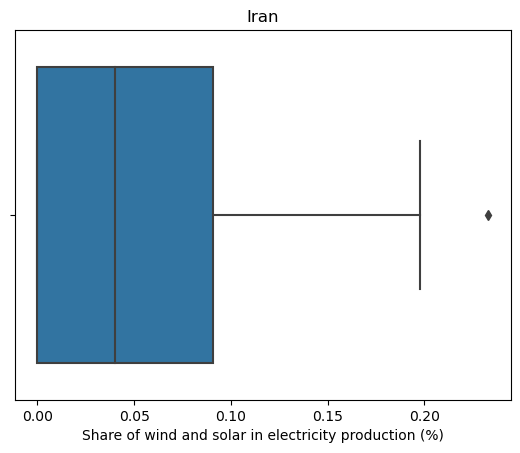

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


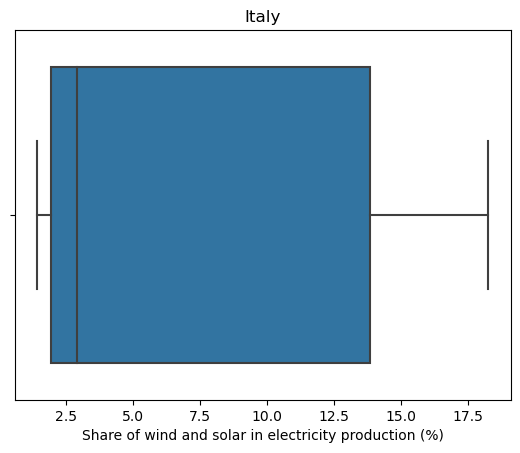

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


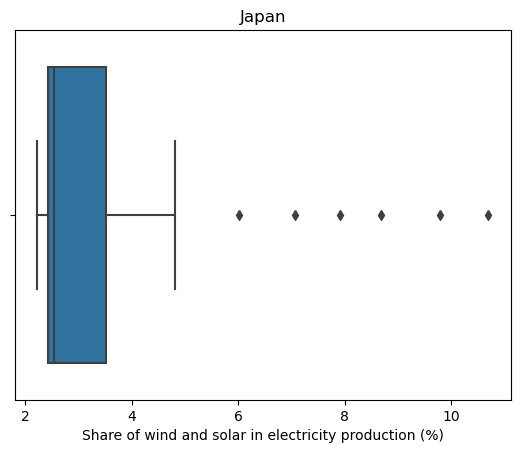

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


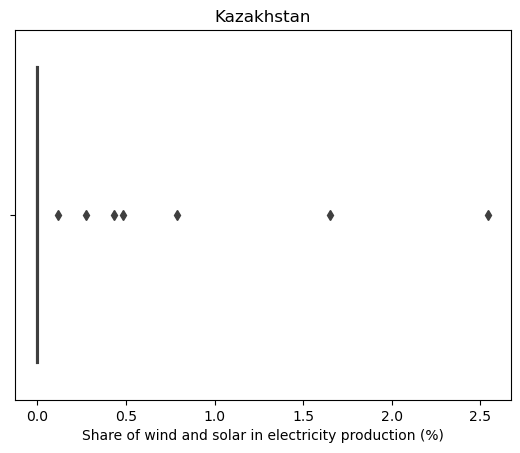

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


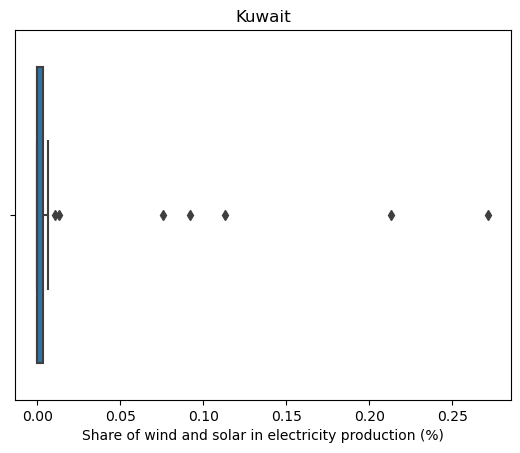

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


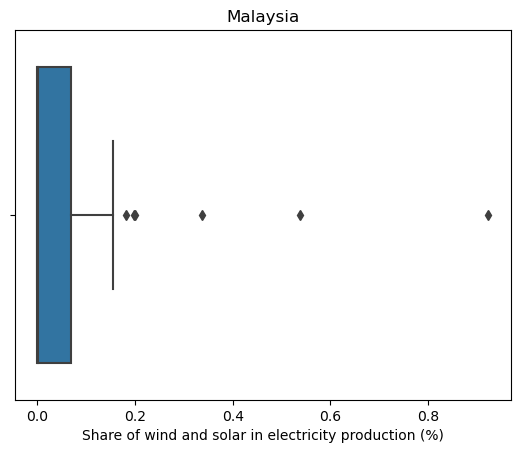

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


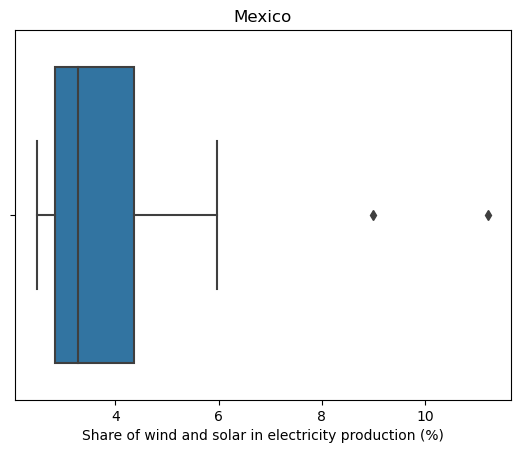

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


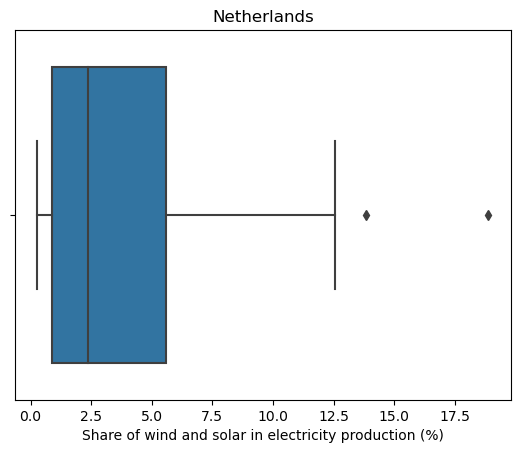

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


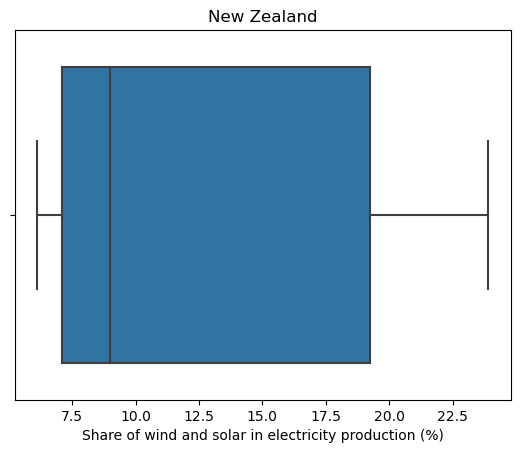

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


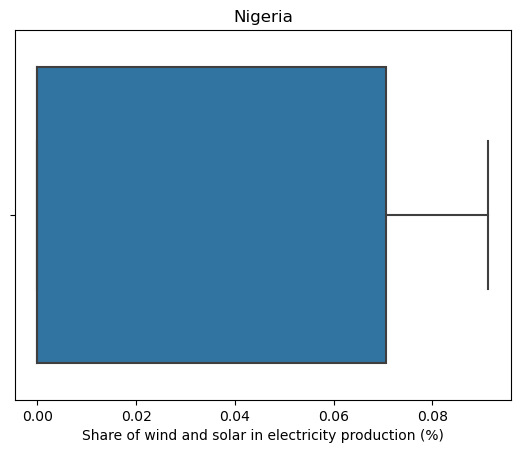

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


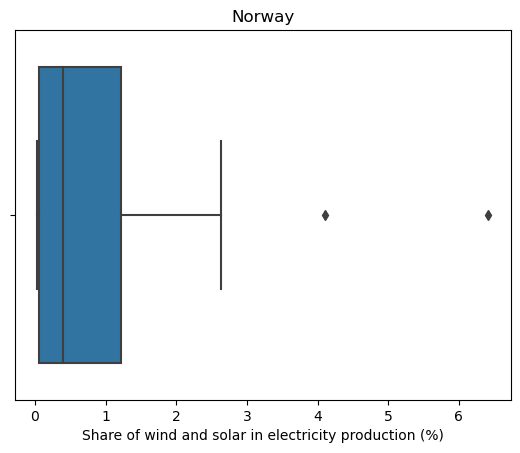

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


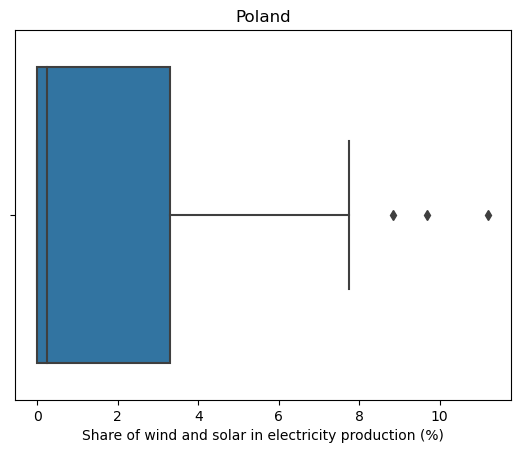

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


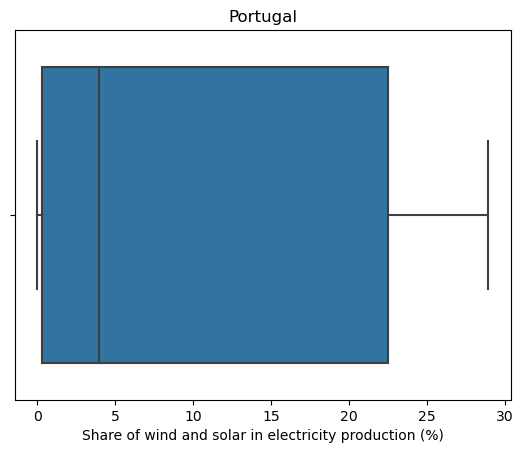

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


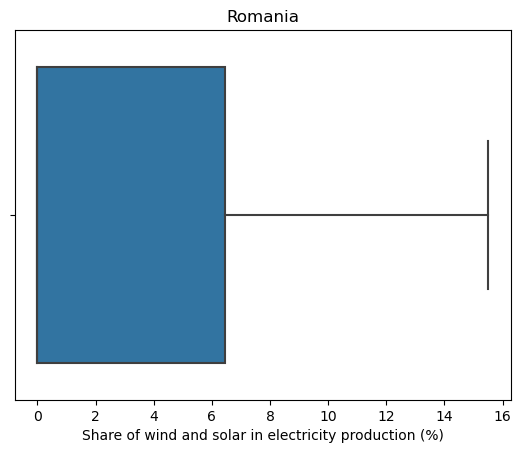

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


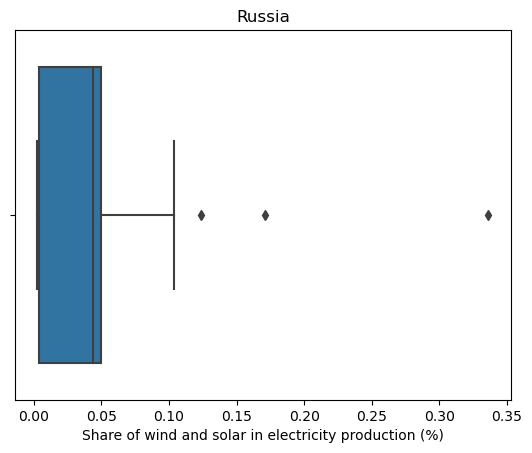

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


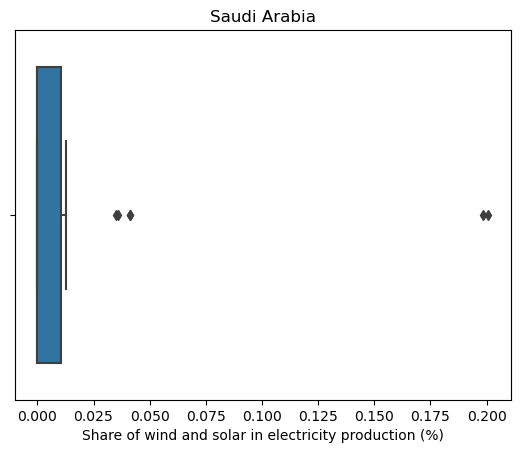

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


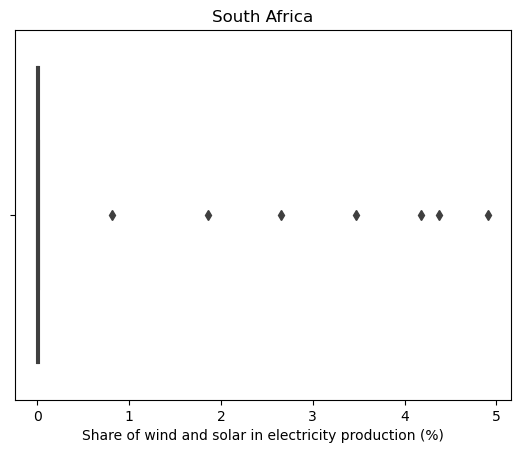

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


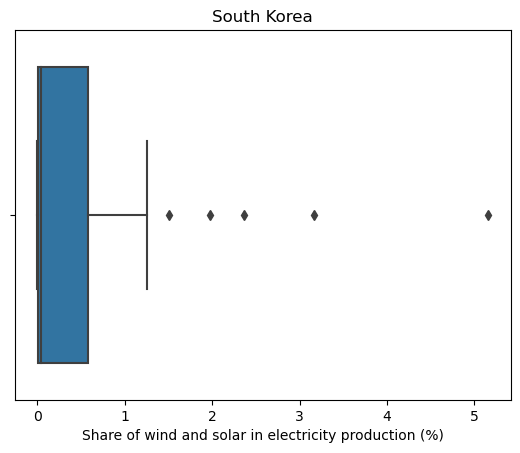

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


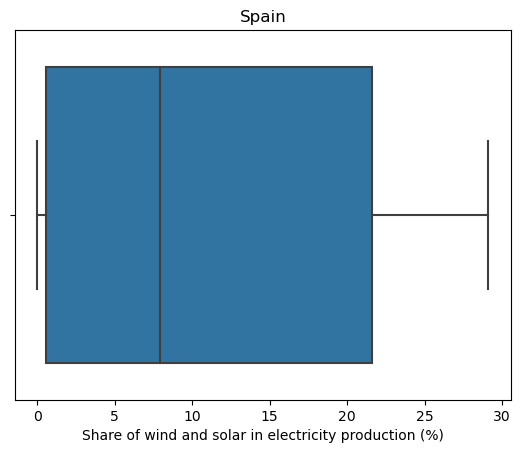

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


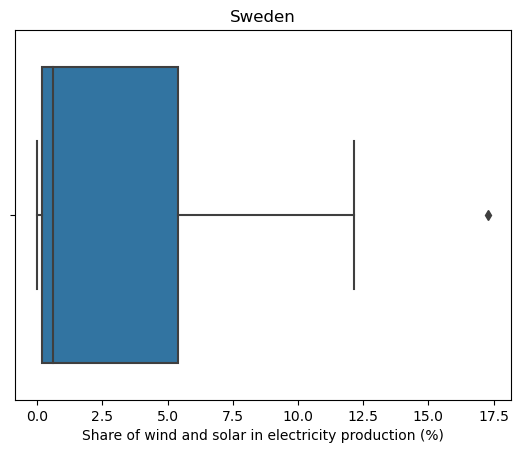

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


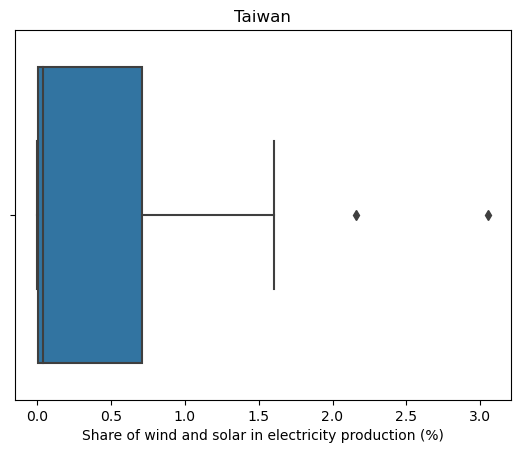

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


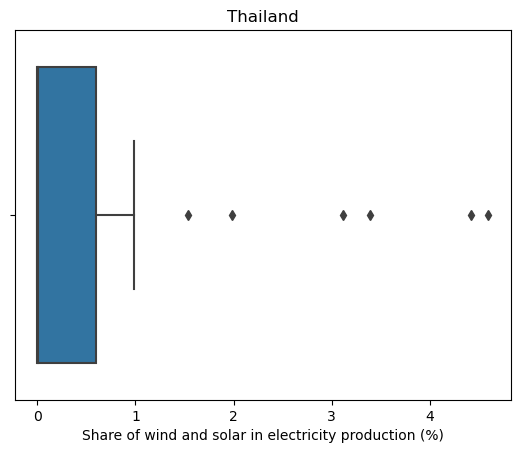

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


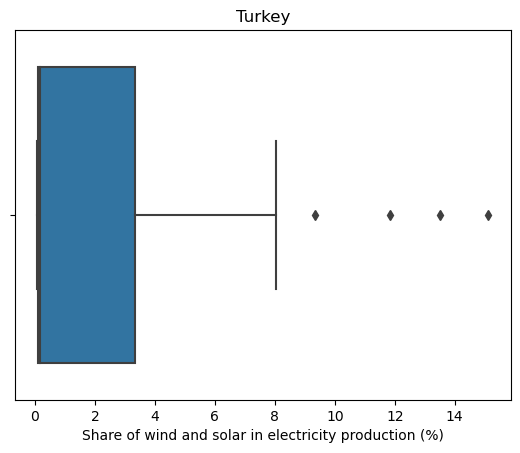

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


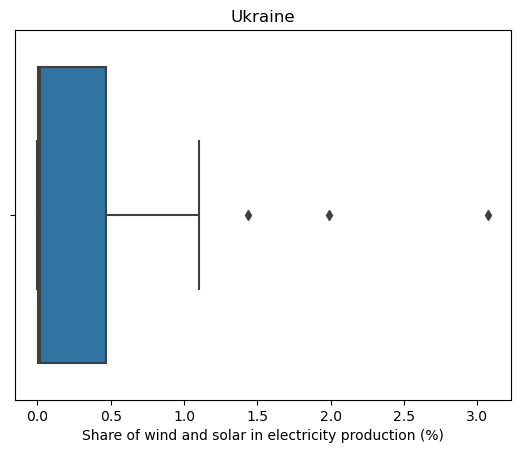

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


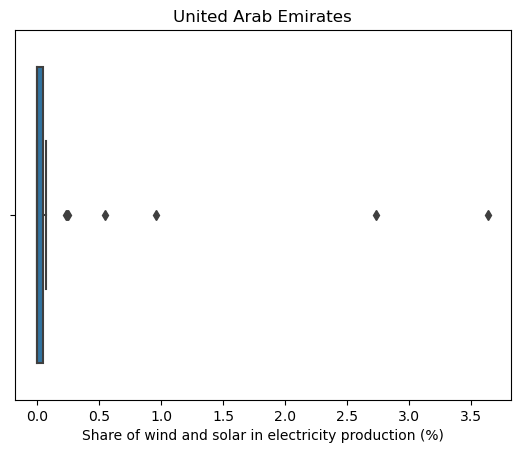

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


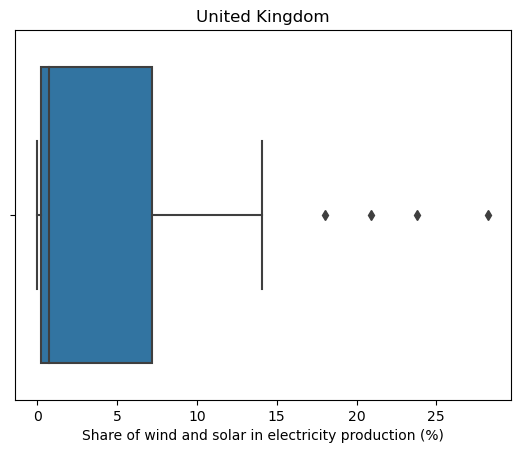

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


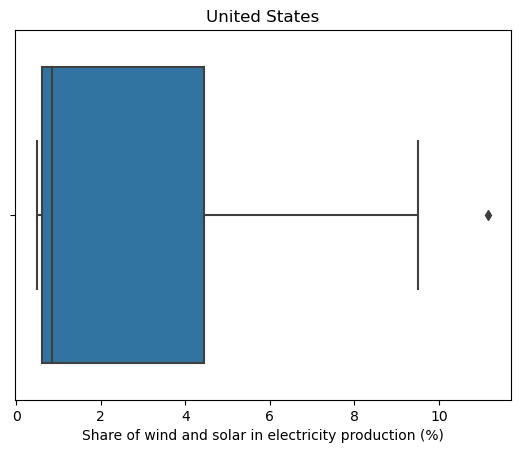

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


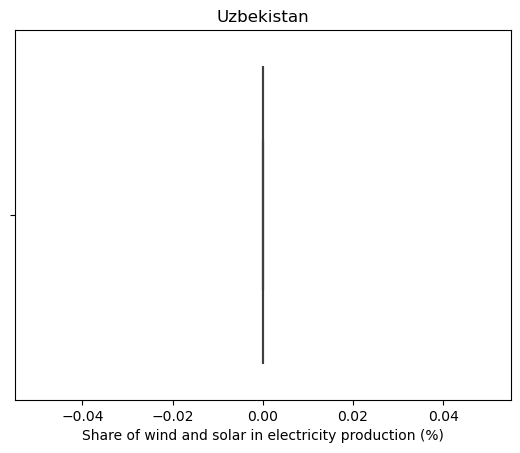

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


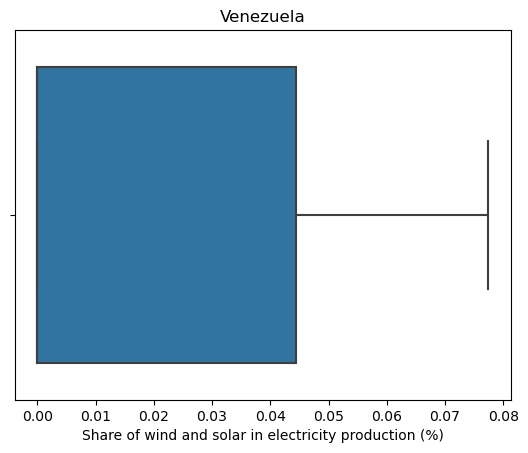

In [39]:
for o in range(len(new_data)):
    sns.boxplot(new_data[o]["Share of wind and solar in electricity production (%)"])
    plt.title(countries[o])
    plt.show()

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


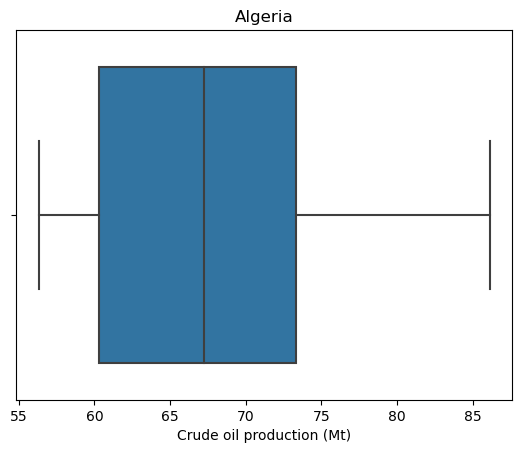

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


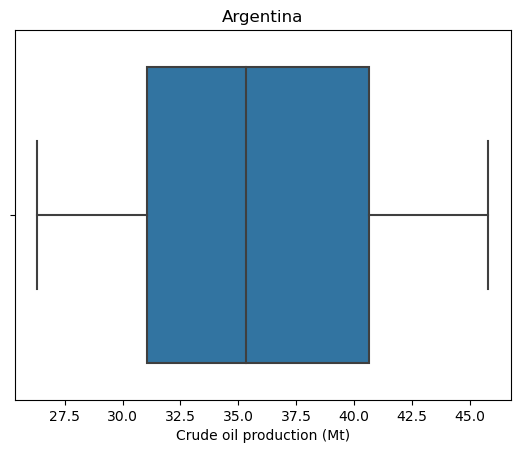

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


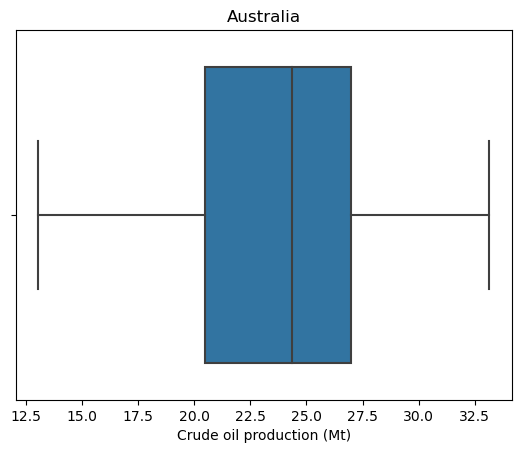

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


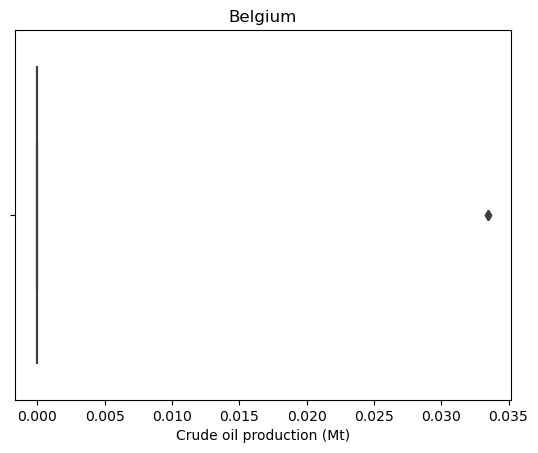

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


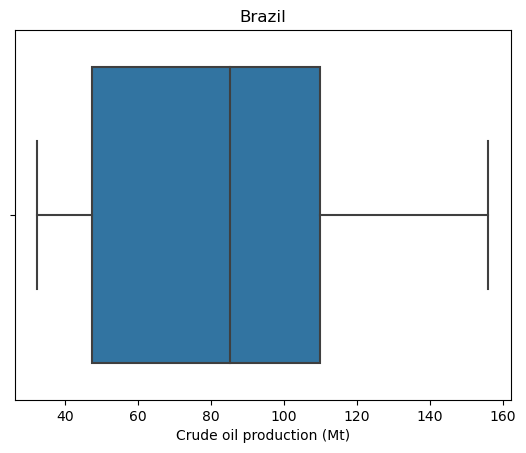

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


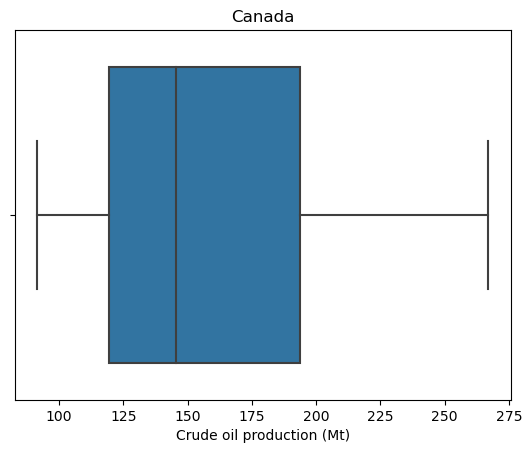

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


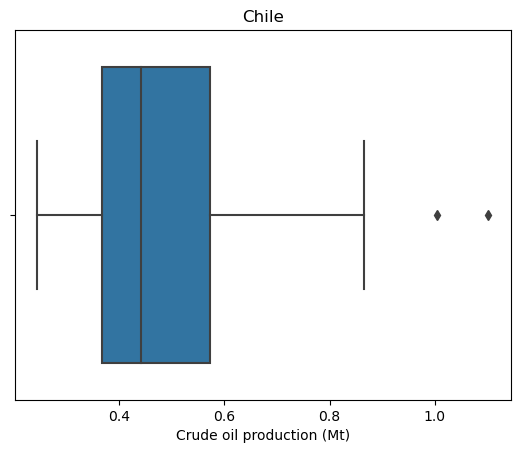

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


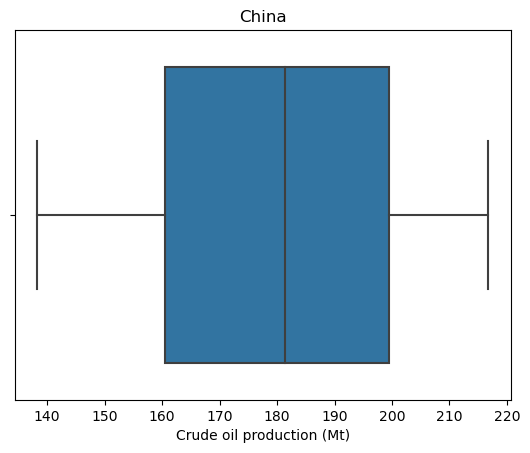

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


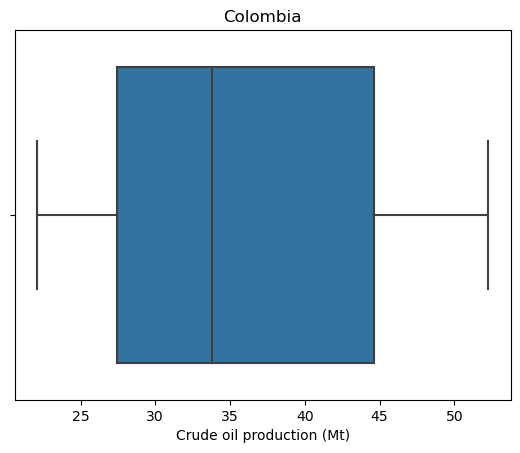

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


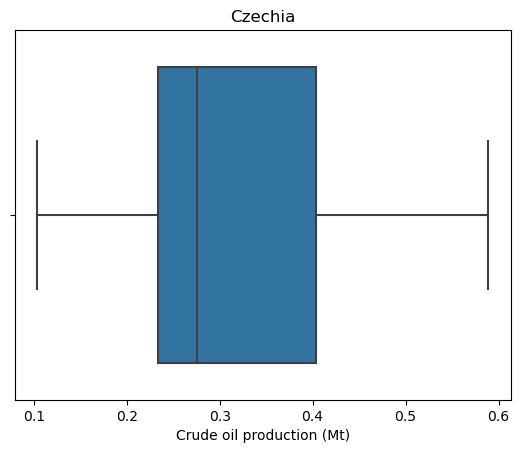

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


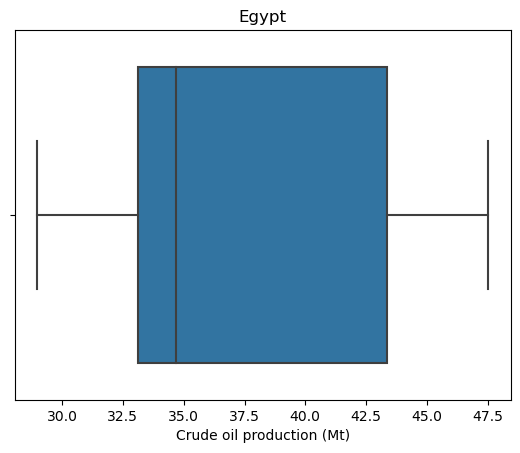

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


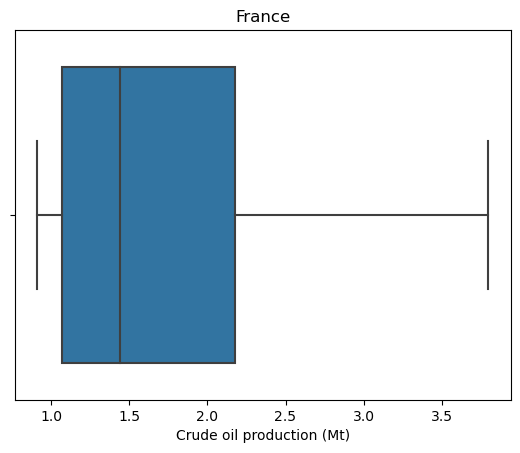

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


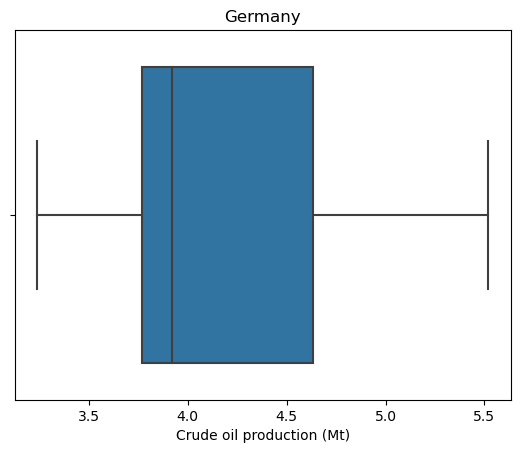

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


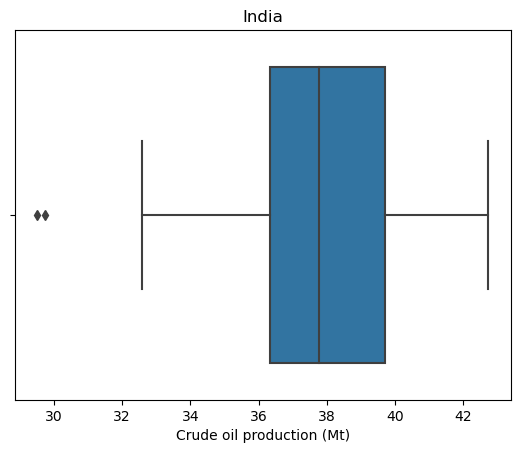

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


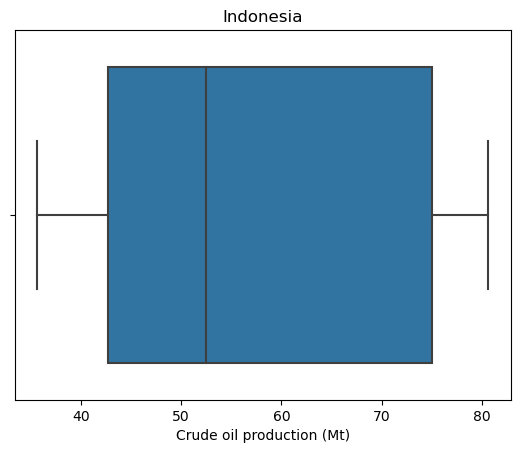

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


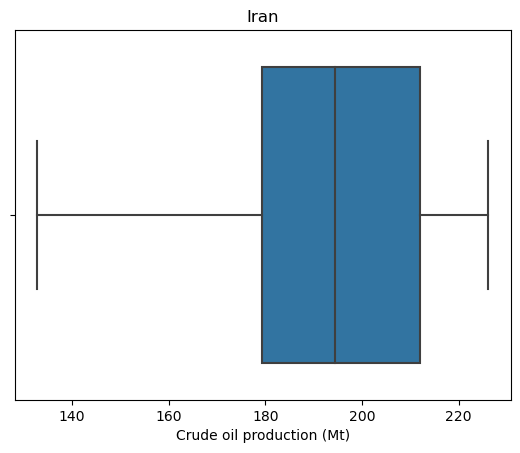

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


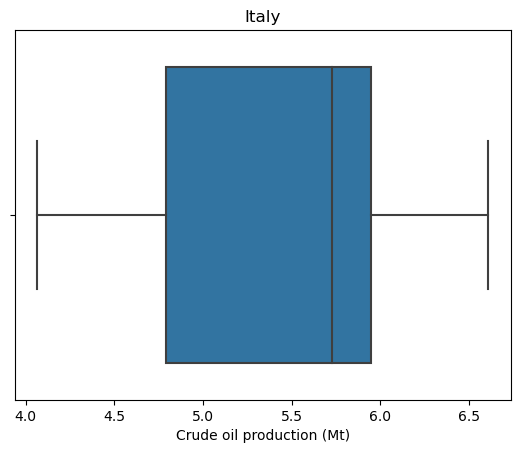

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


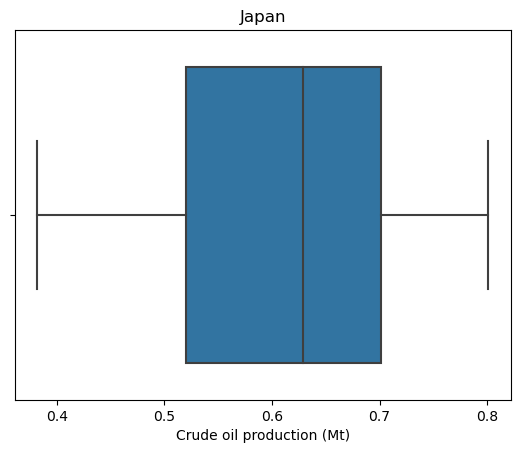

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


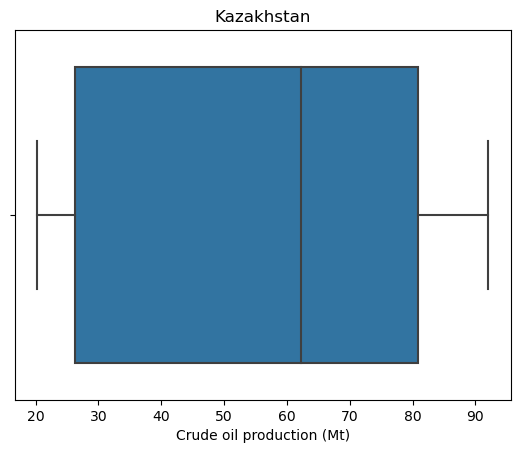

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


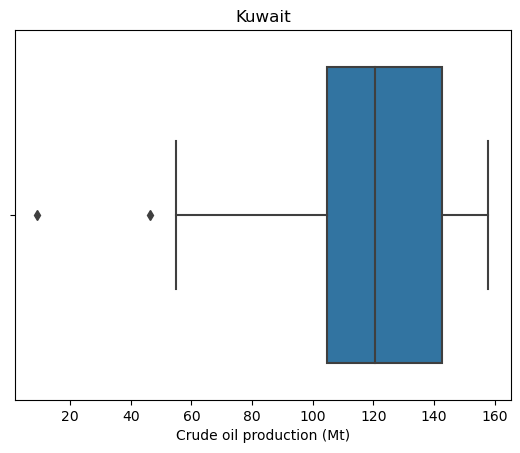

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


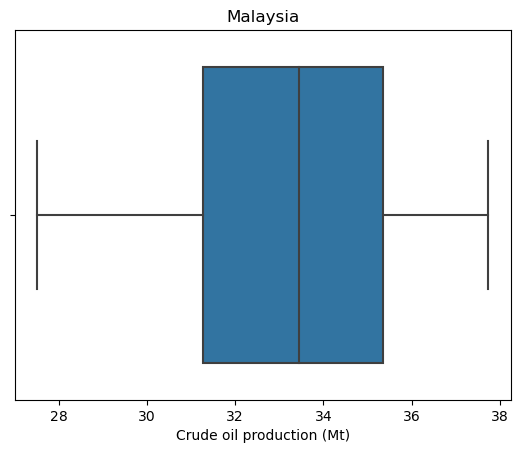

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


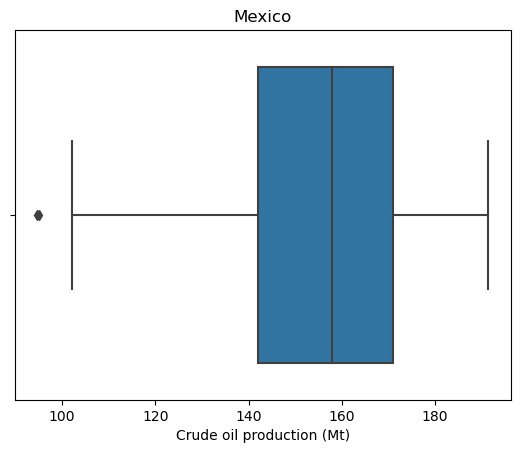

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


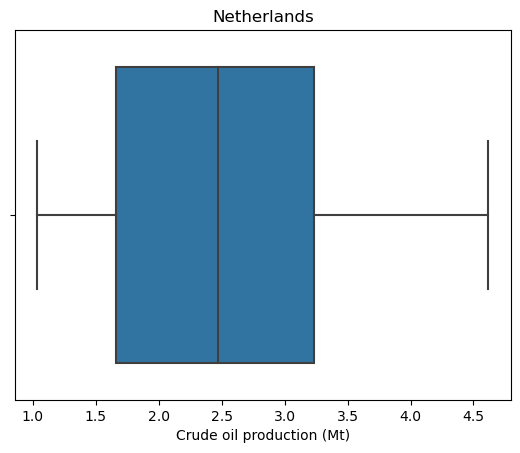

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


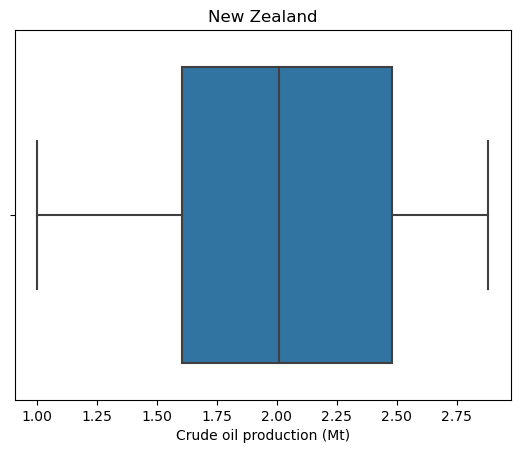

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


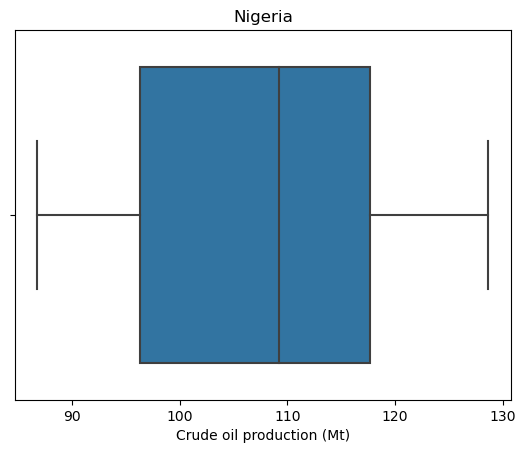

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


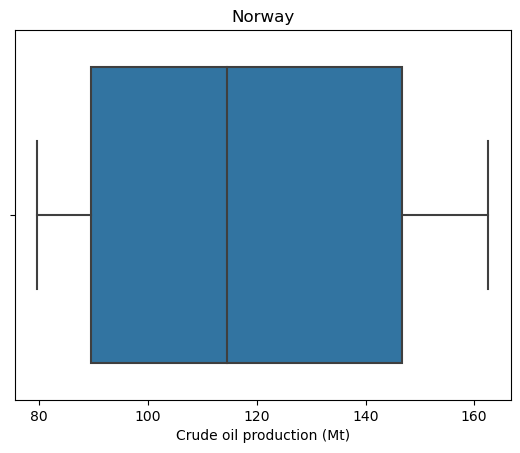

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


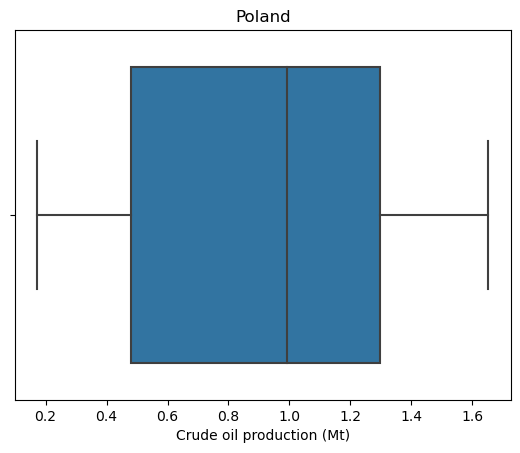

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


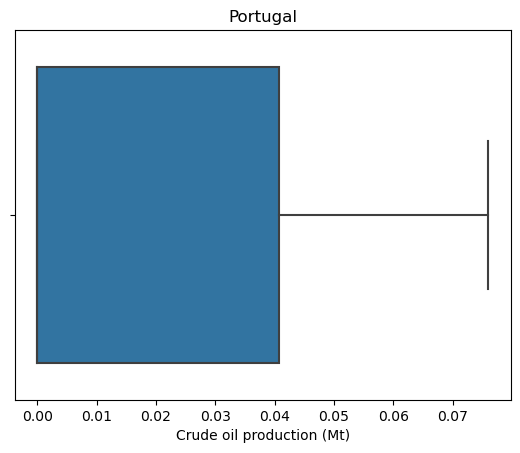

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


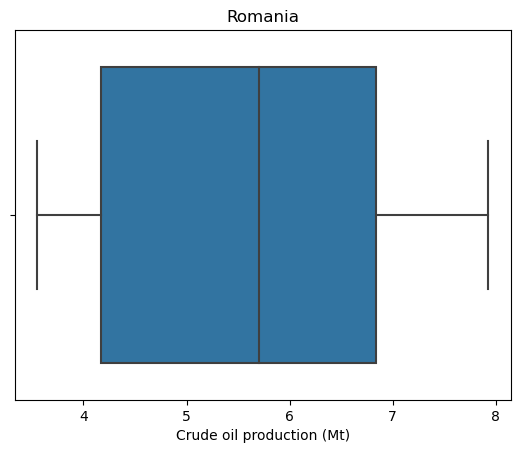

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


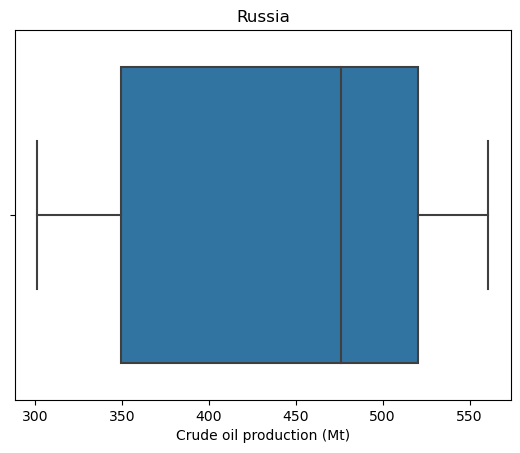

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


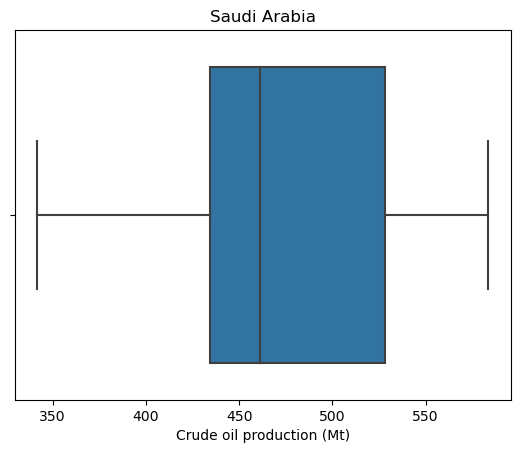

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


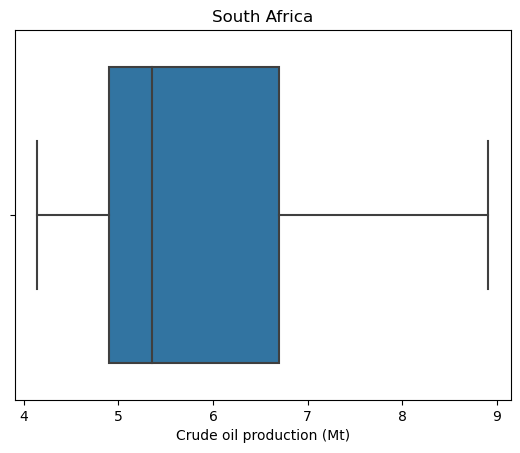

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


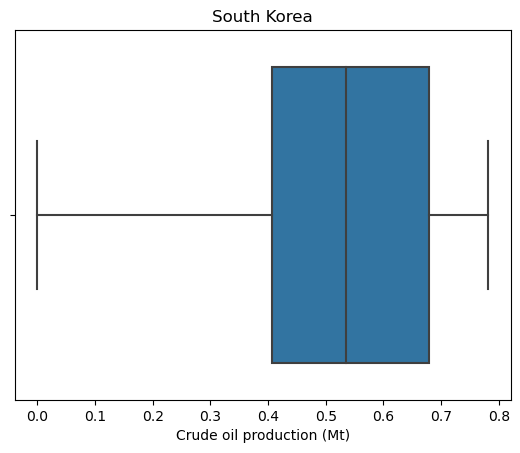

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


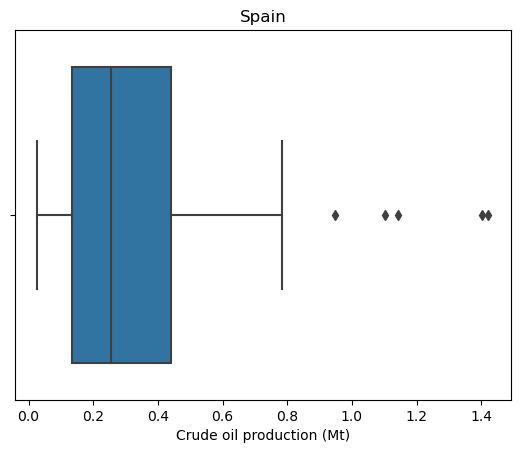

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


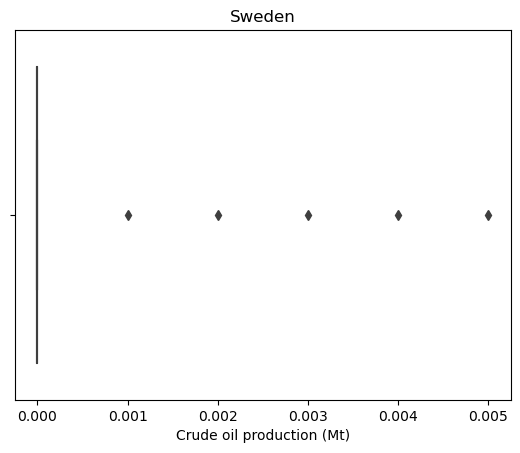

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


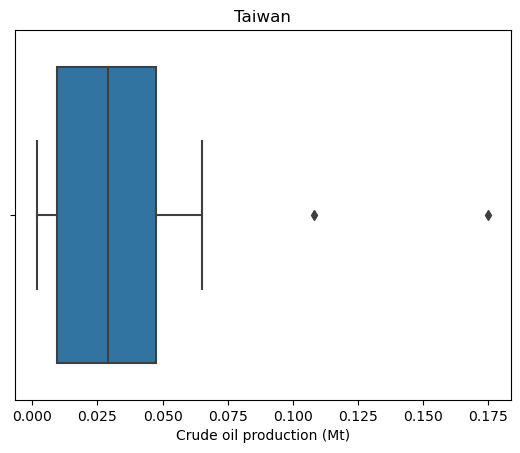

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


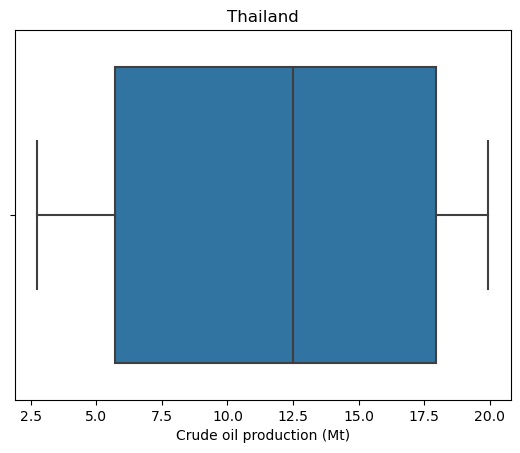

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


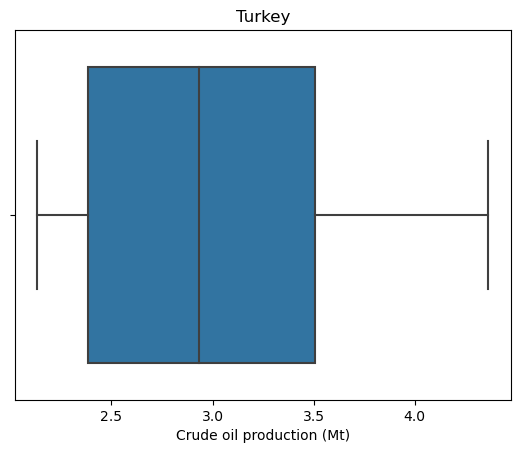

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


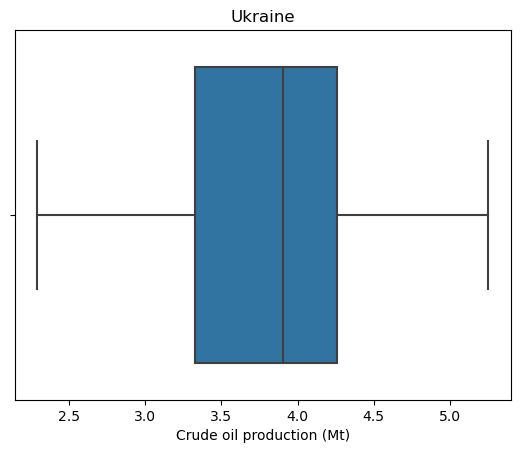

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


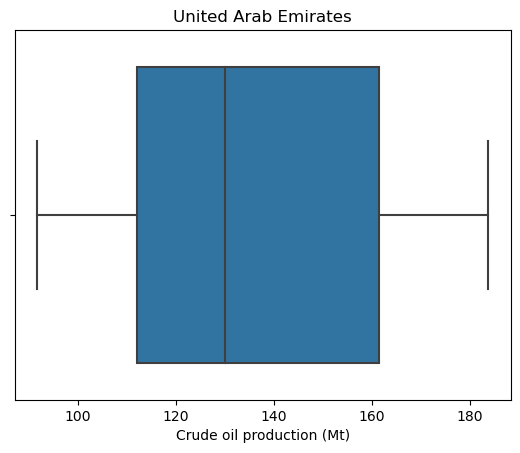

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


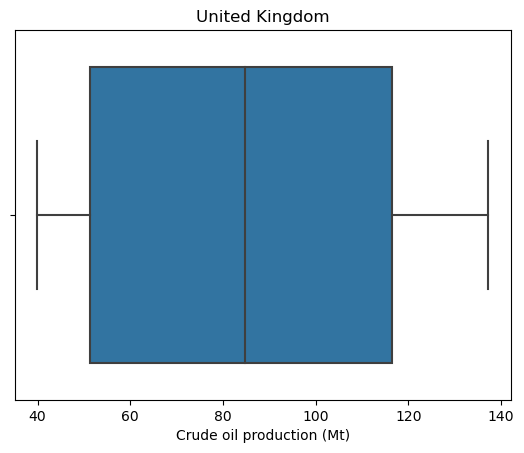

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


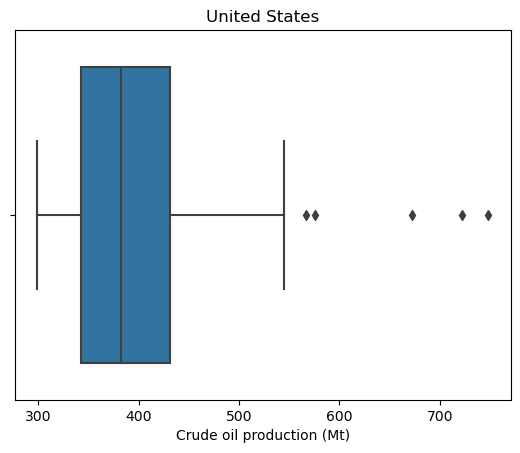

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


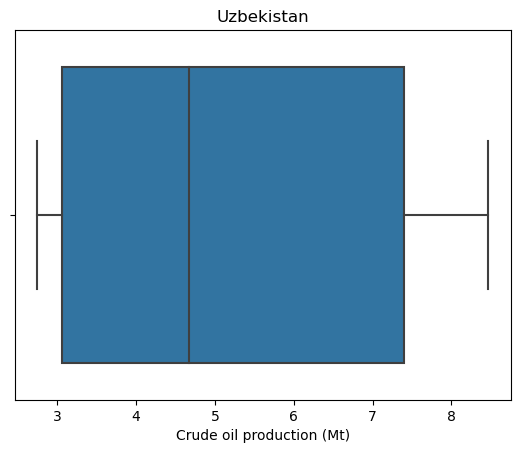

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


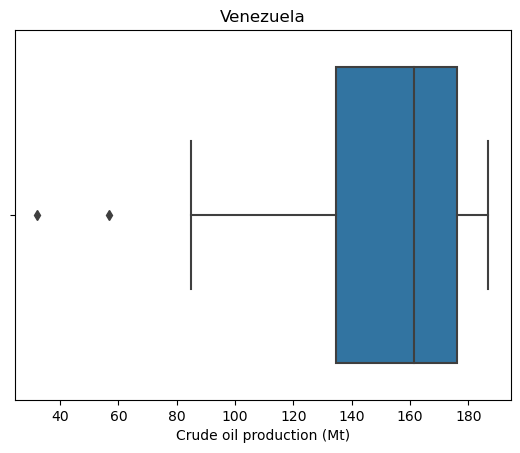

In [40]:
for o in range(len(new_data)):
    sns.boxplot(new_data[o]["Crude oil production (Mt)"])
    plt.title(countries[o])
    plt.show()

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


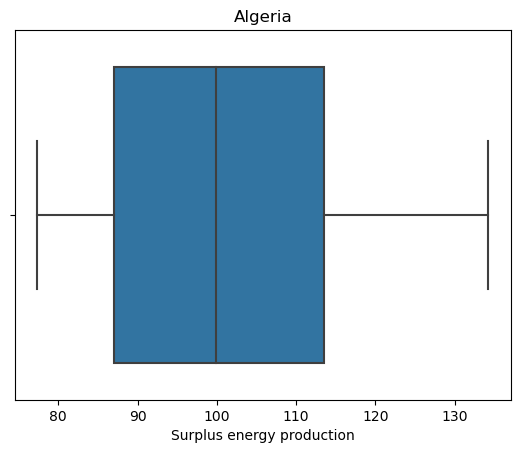

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


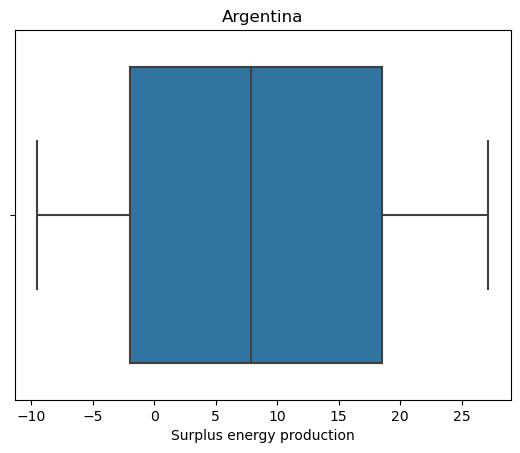

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


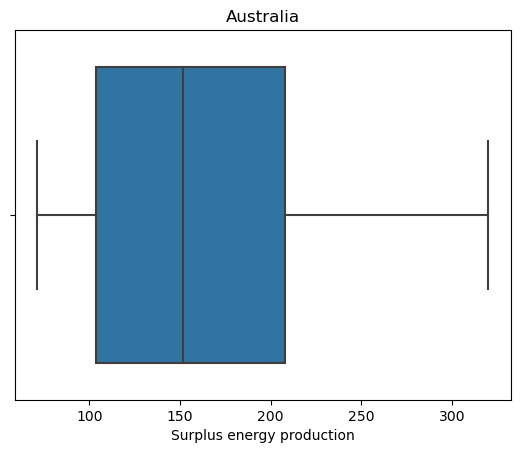

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


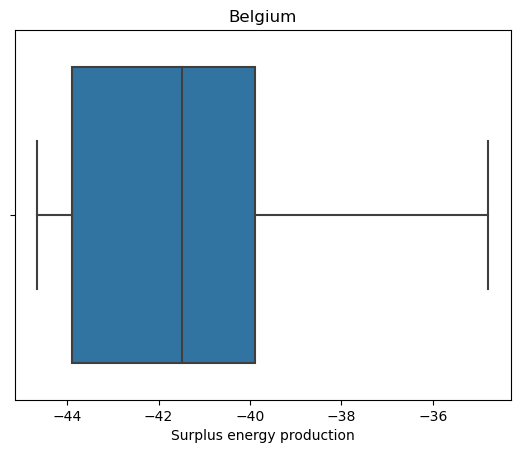

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


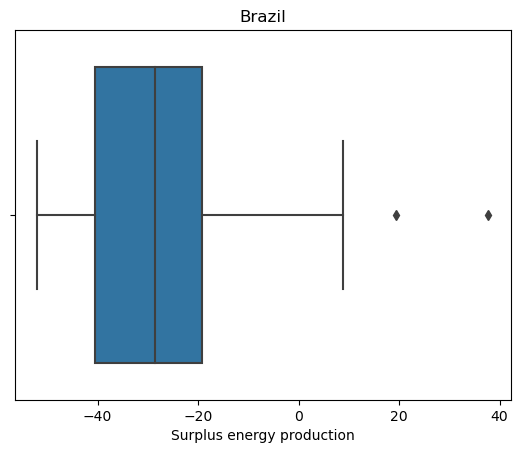

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


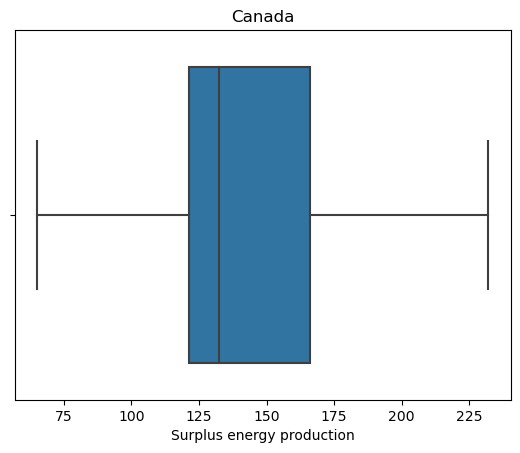

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


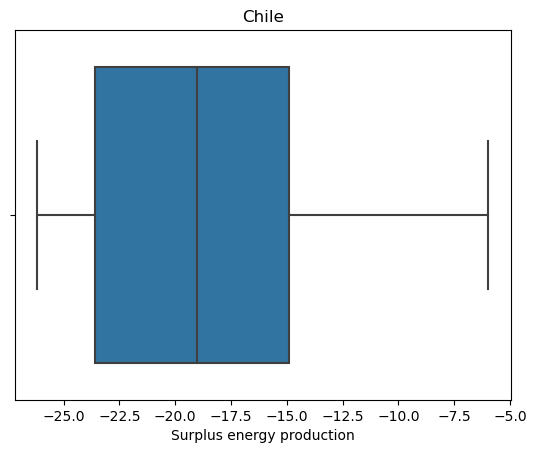

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


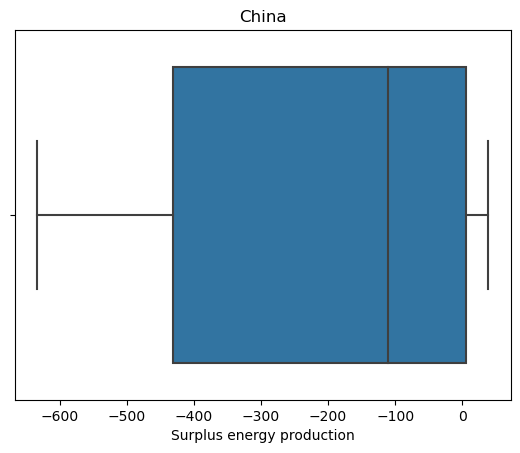

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


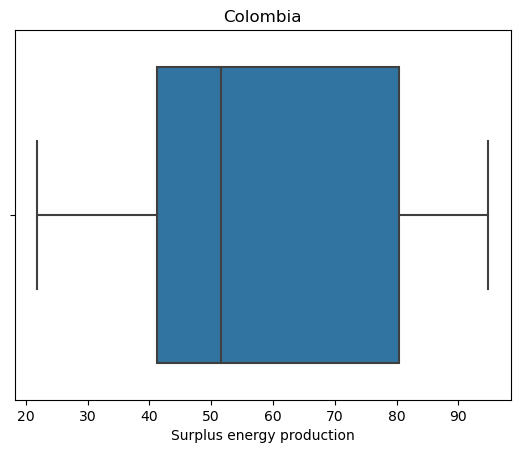

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


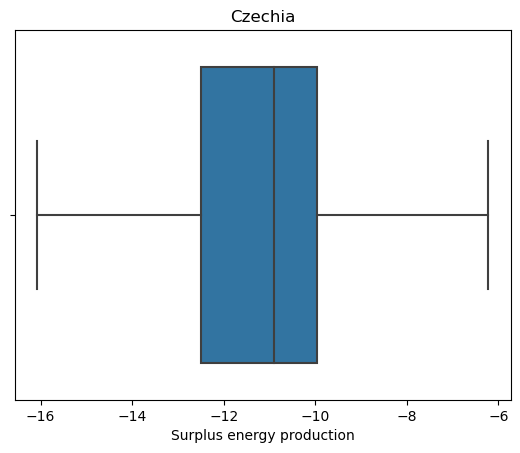

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


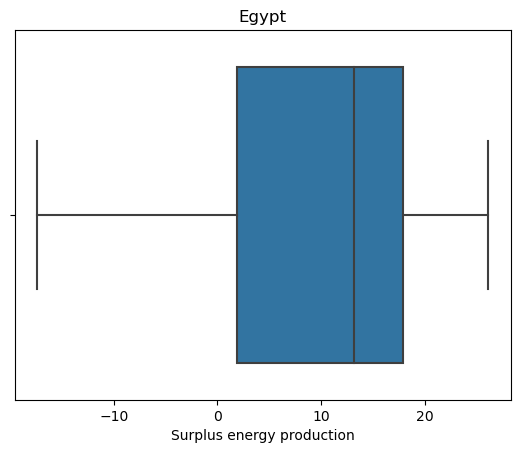

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


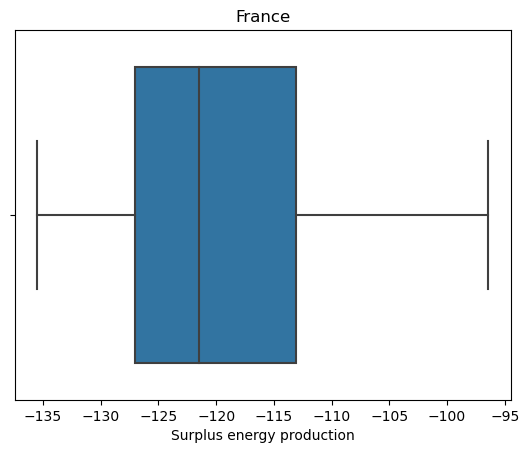

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


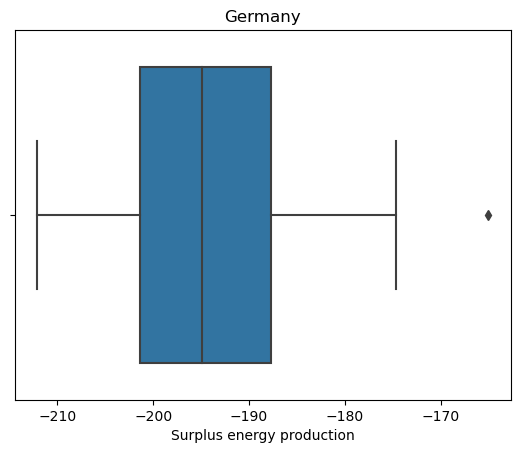

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


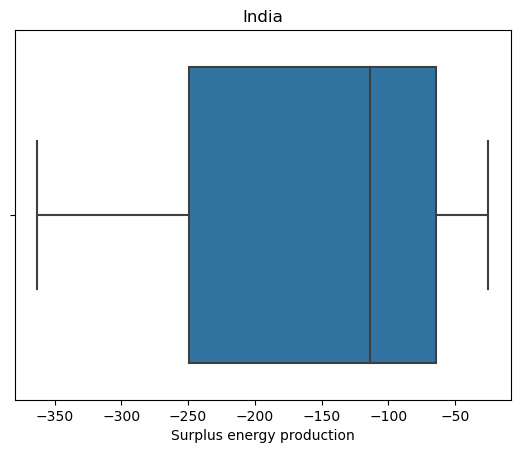

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


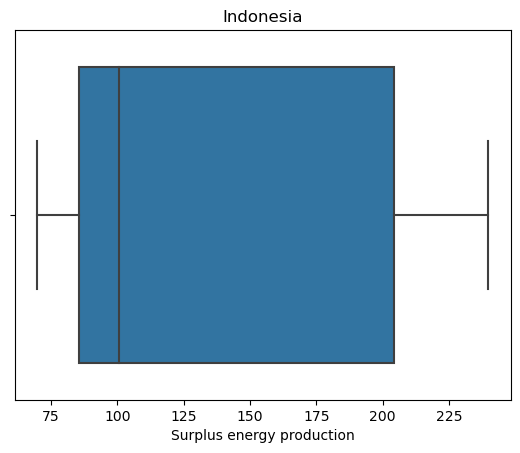

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


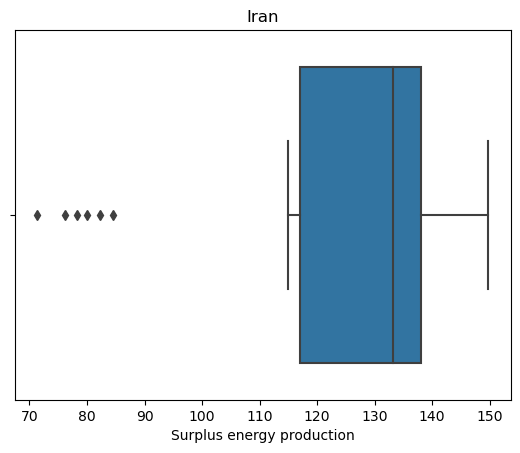

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


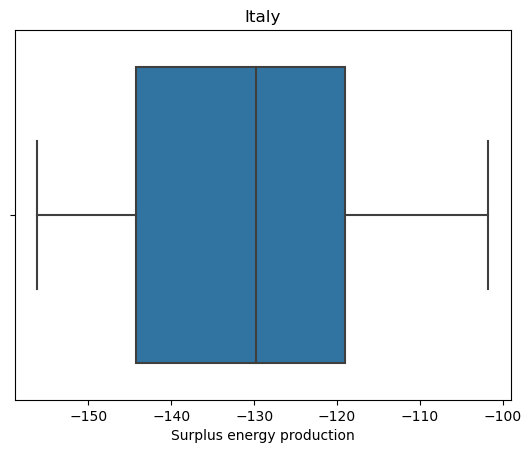

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


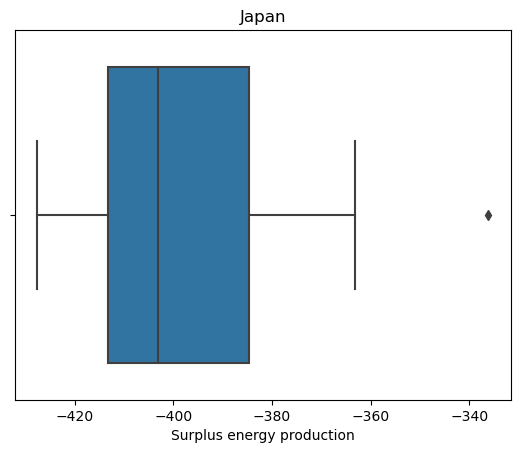

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


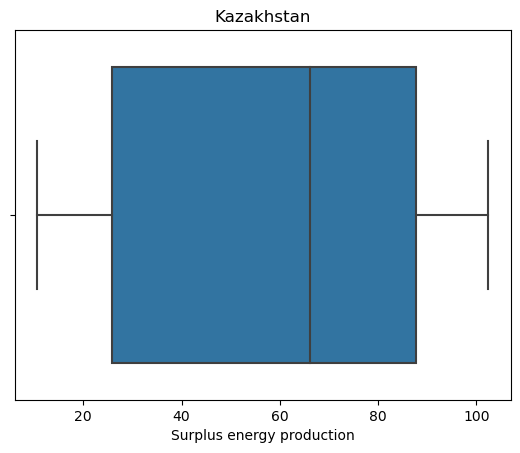

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


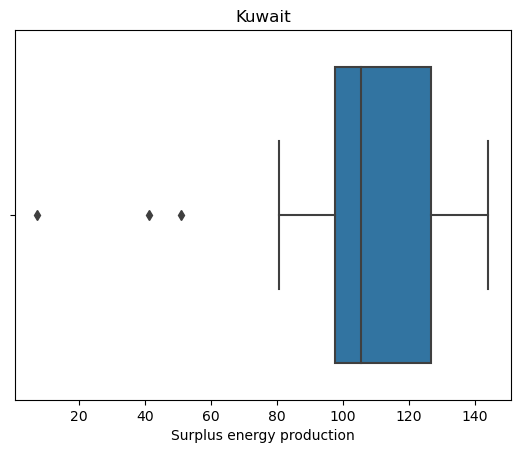

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


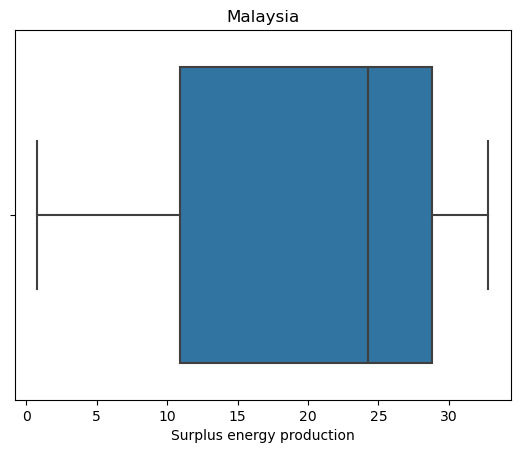

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


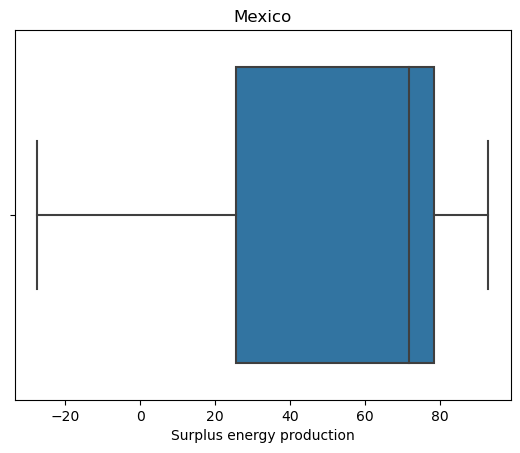

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


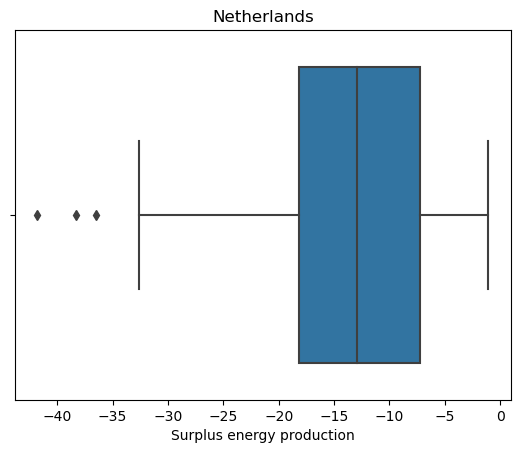

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


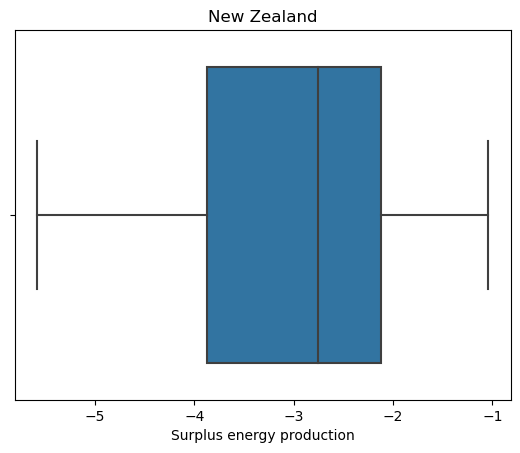

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


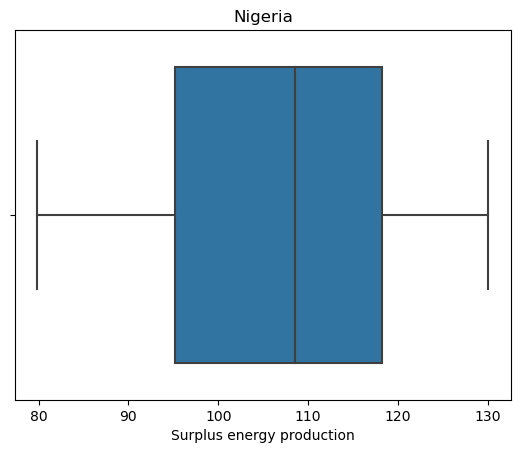

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


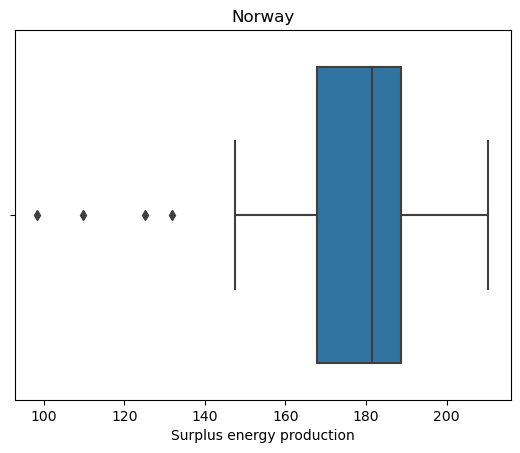

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


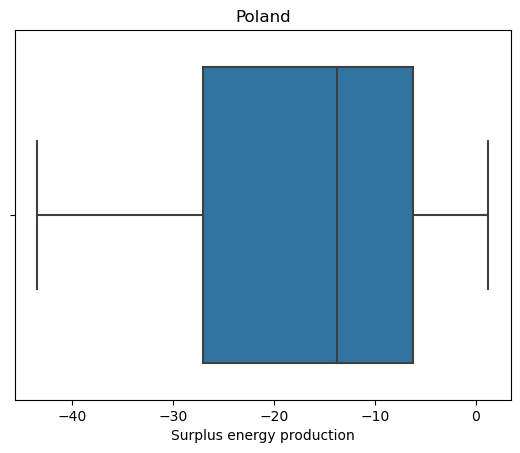

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


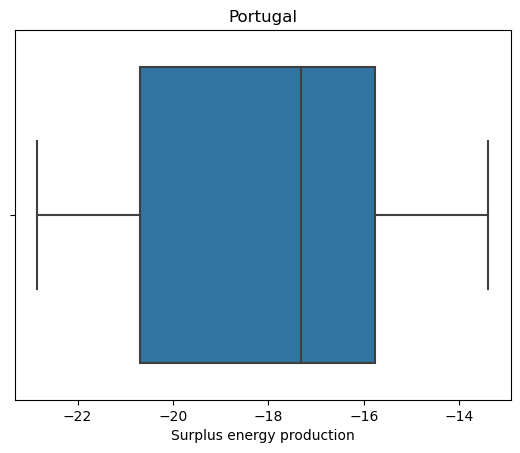

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


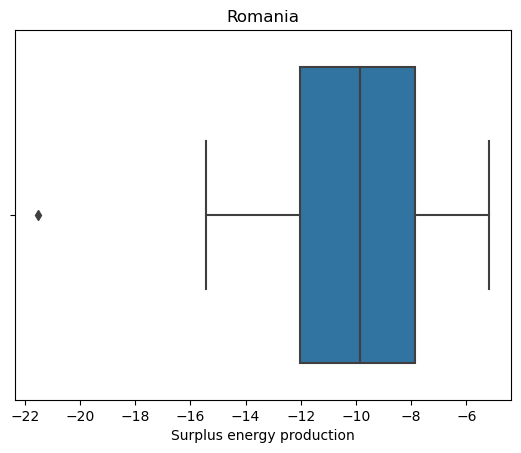

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


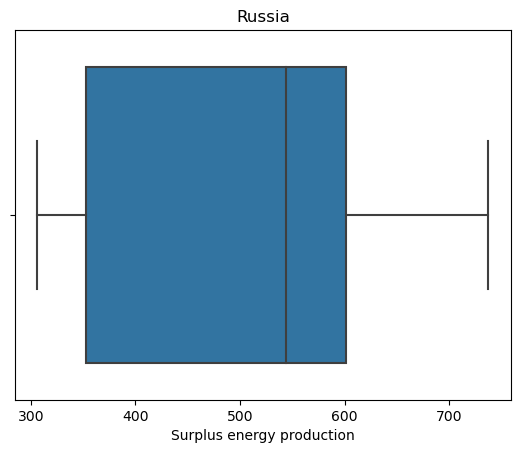

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


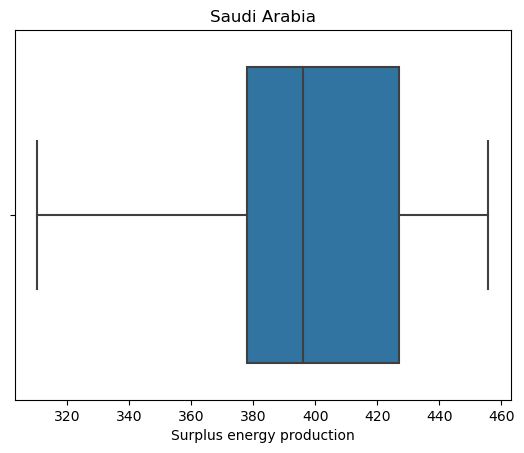

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


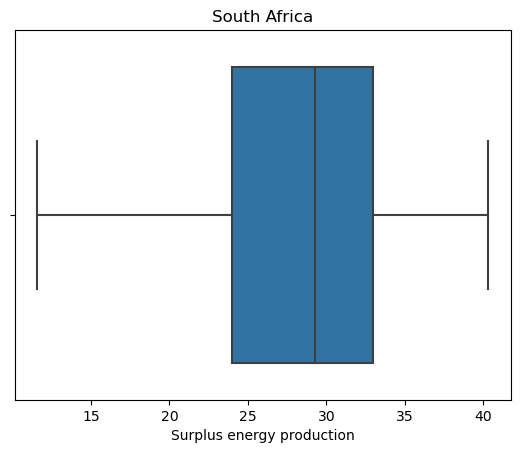

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


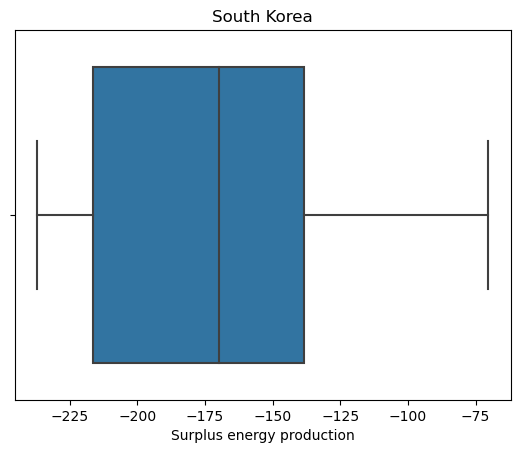

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


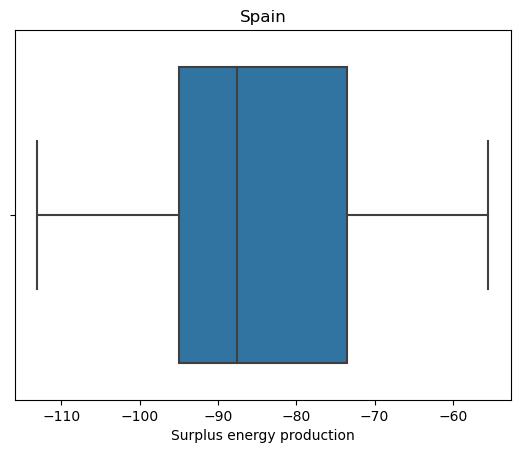

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


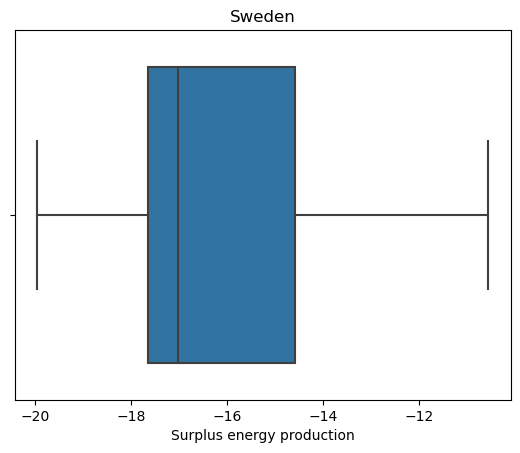

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


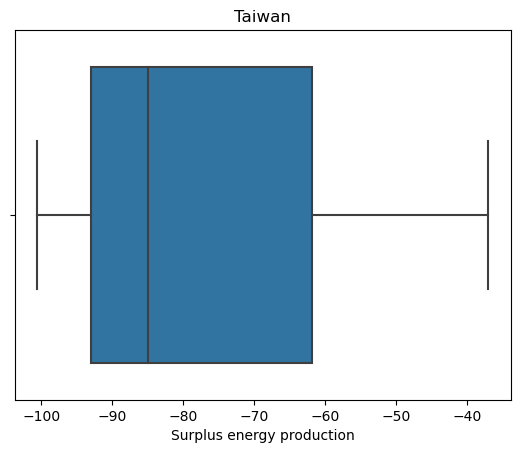

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


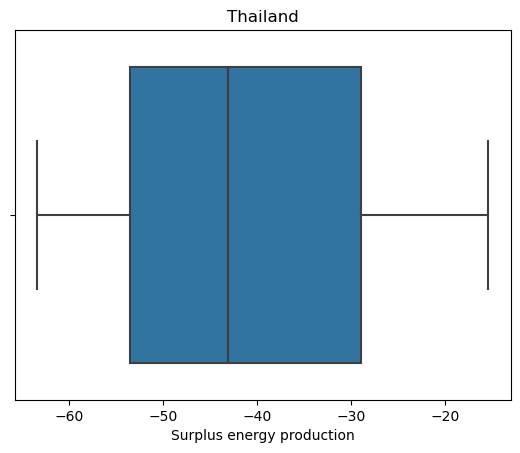

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


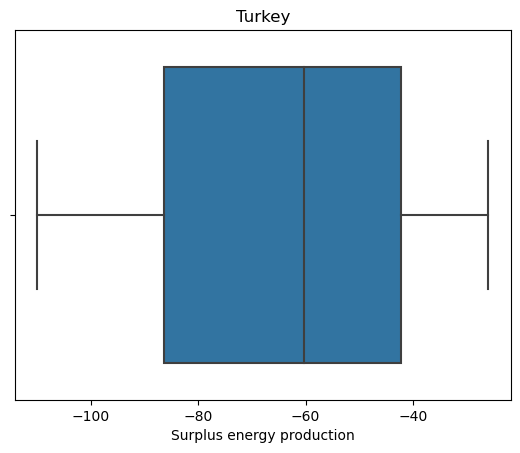

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


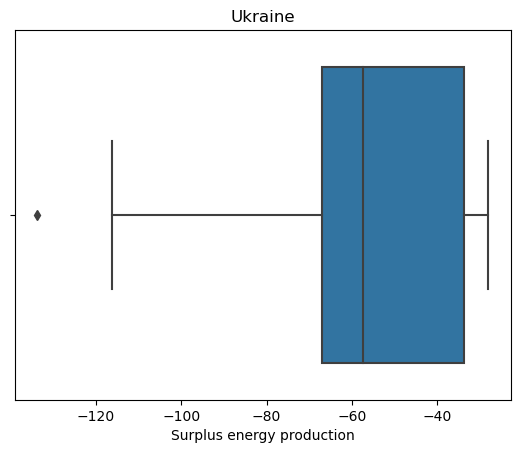

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


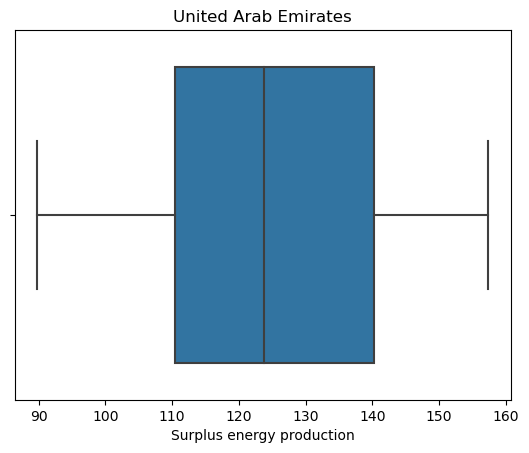

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


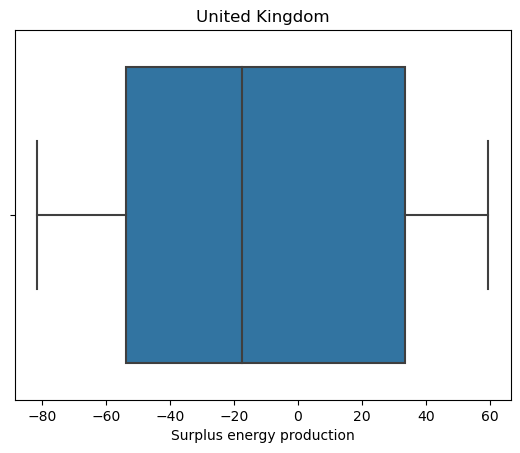

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


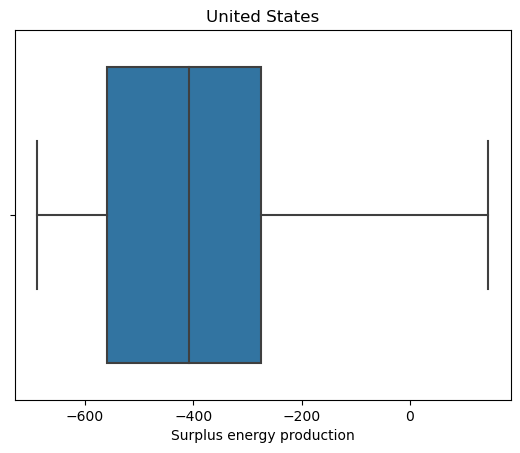

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


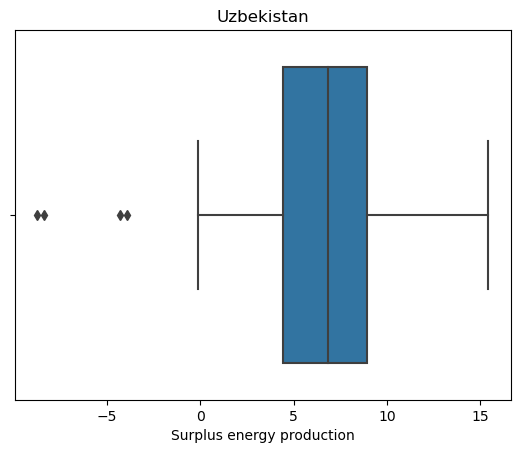

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


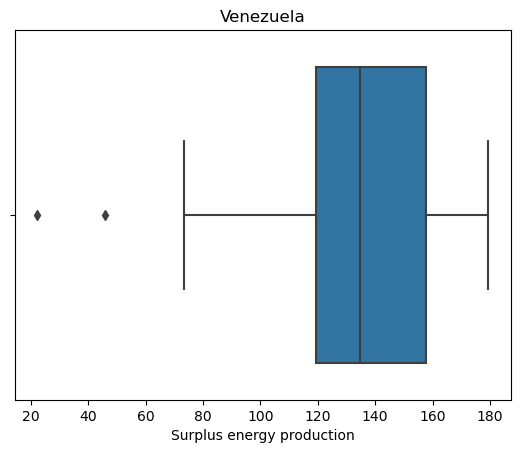

In [41]:
for o in range(len(new_data)):
    sns.boxplot(new_data[o]["Surplus energy production"])
    plt.title(countries[o])
    plt.show()

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


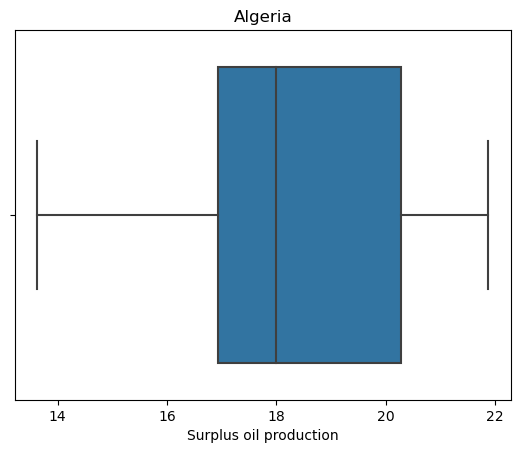

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


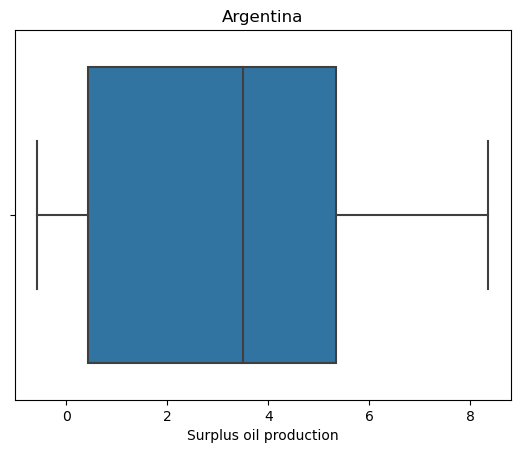

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


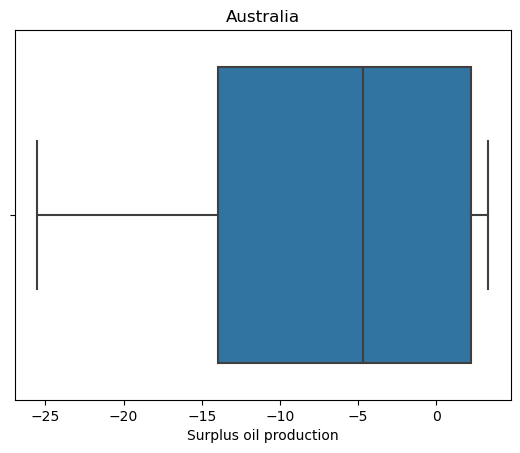

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


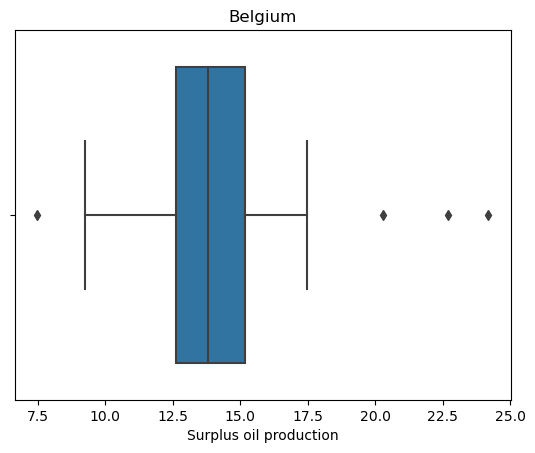

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


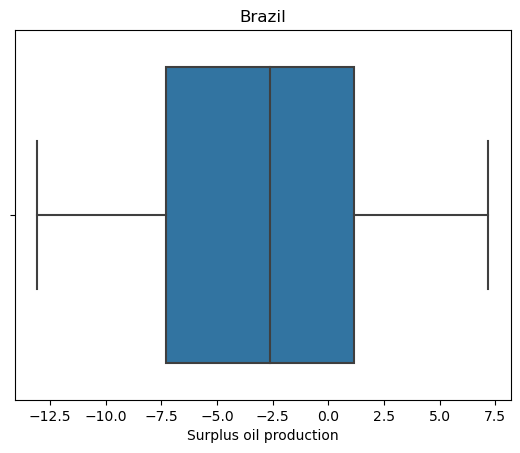

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


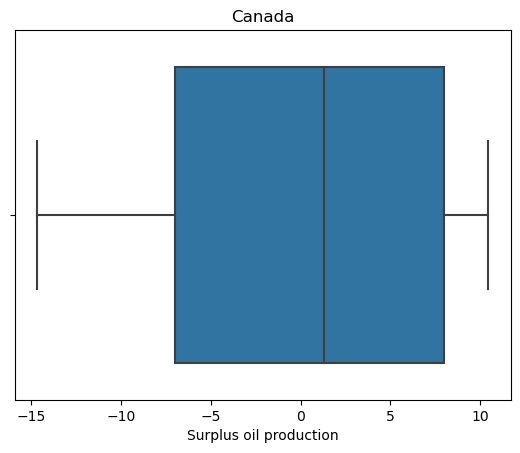

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


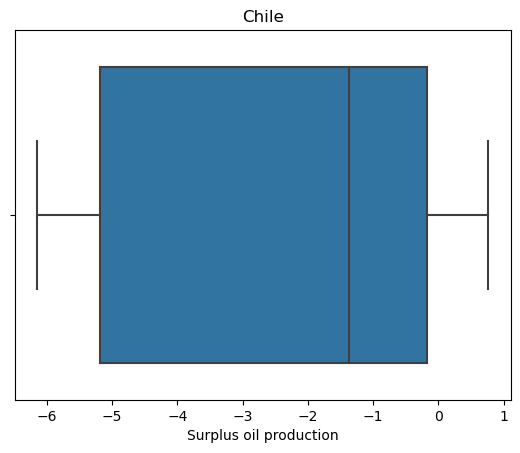

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


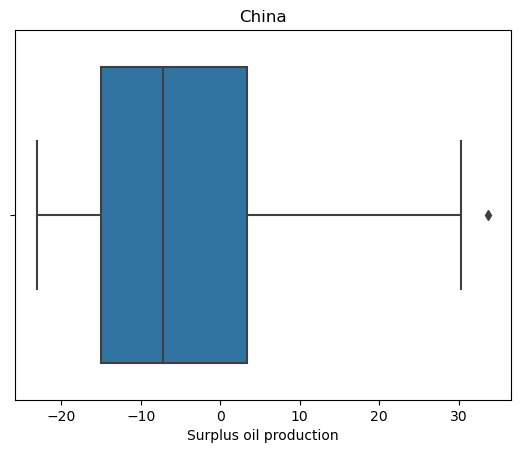

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


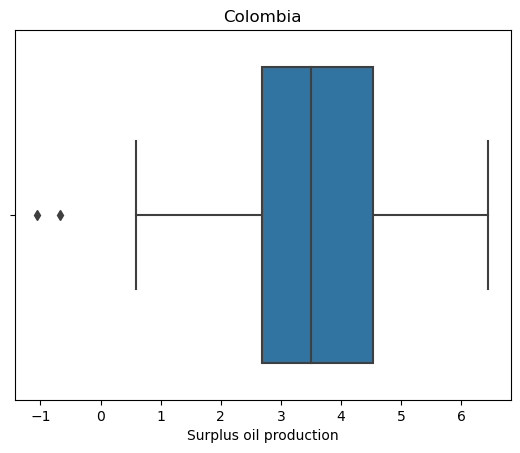

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


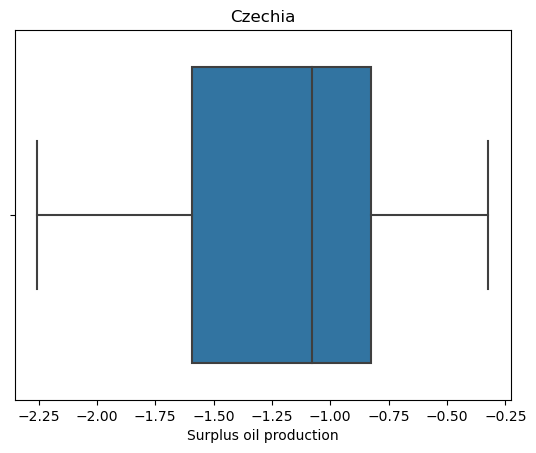

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


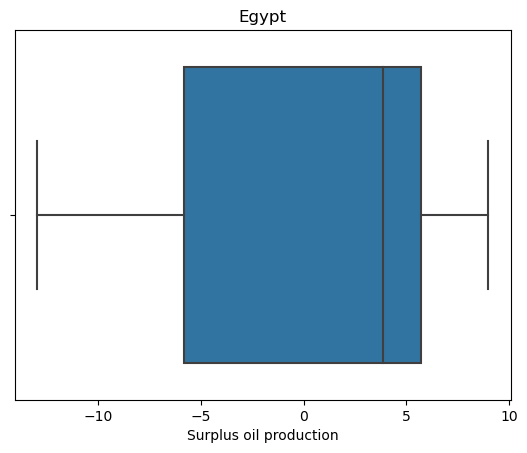

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


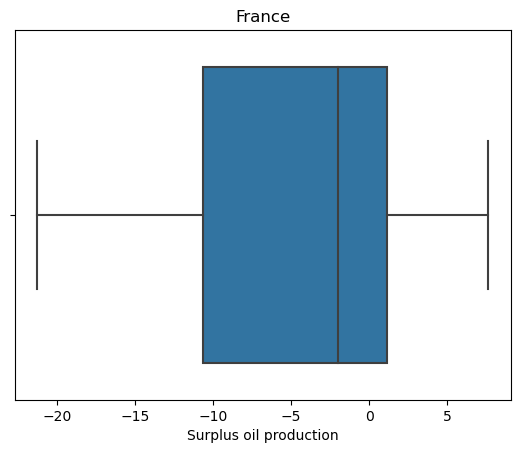

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


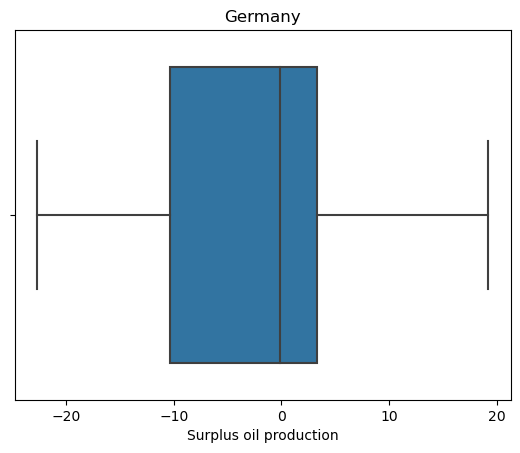

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


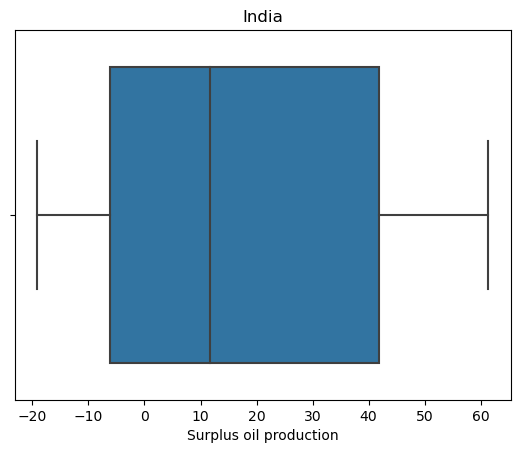

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


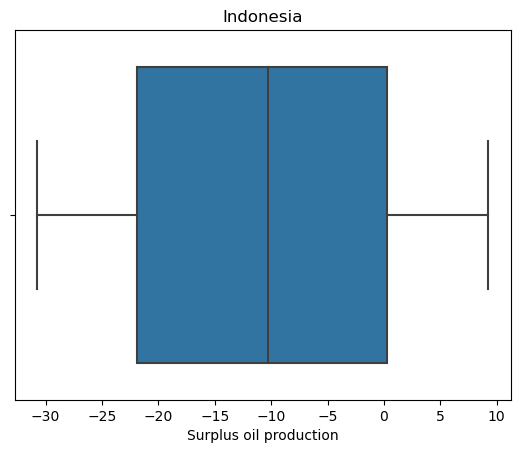

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


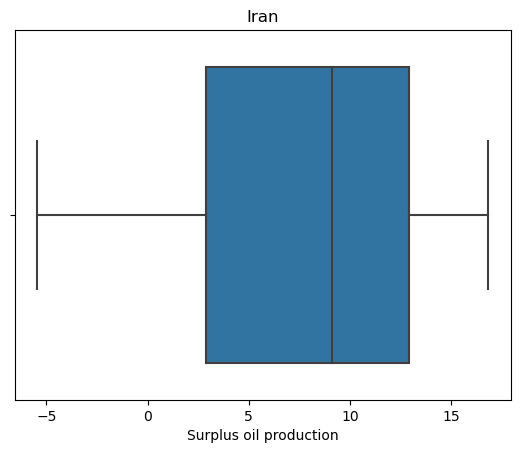

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


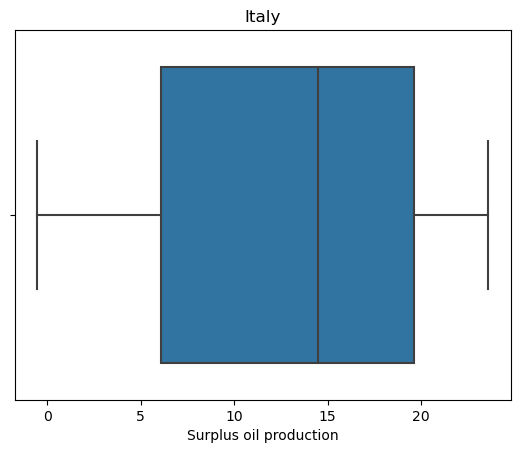

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


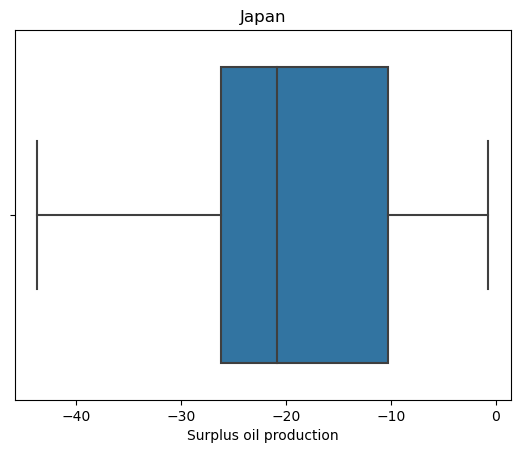

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


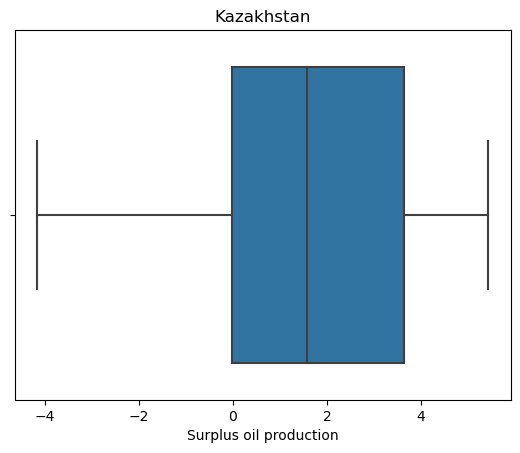

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


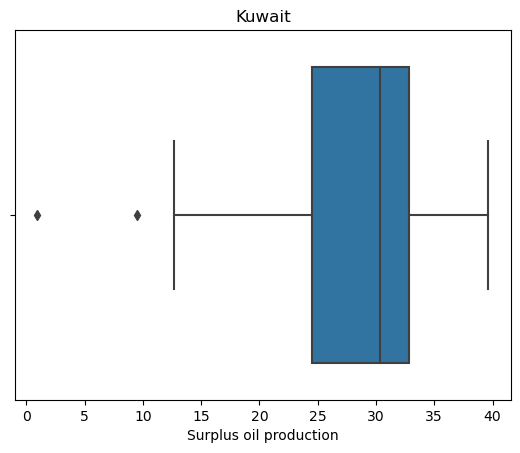

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


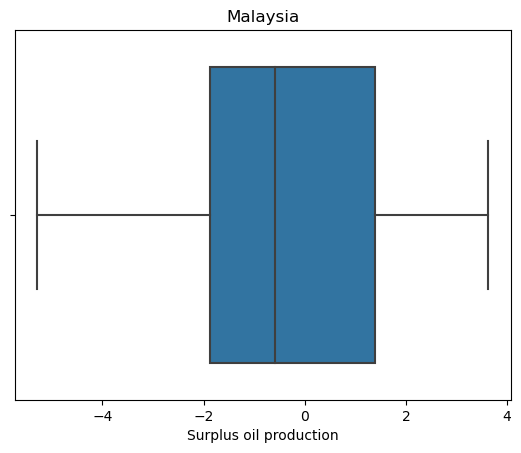

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


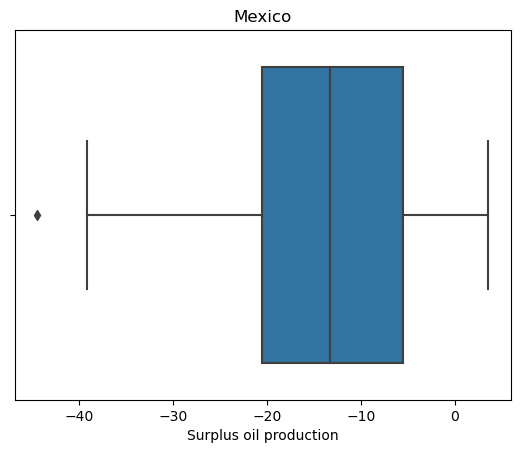

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


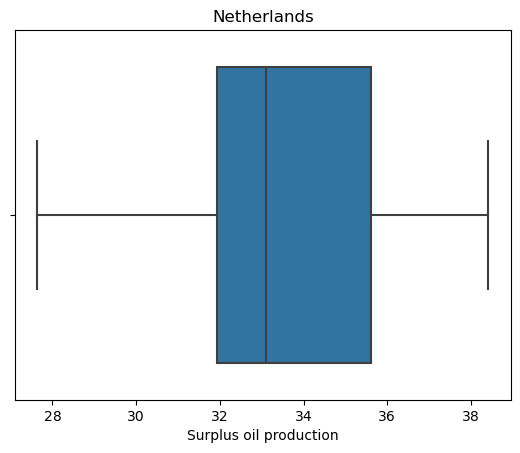

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


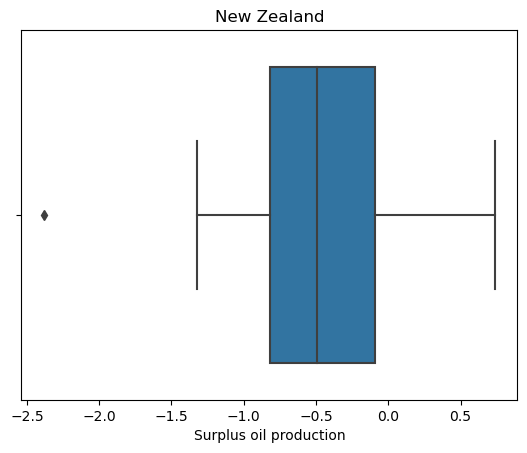

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


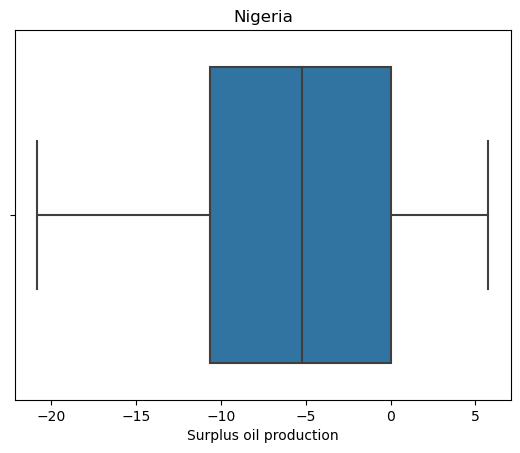

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


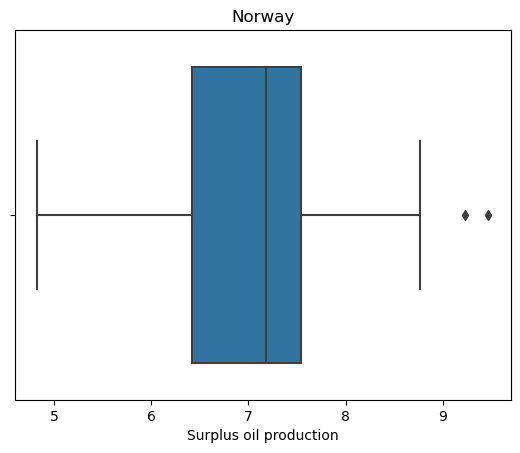

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


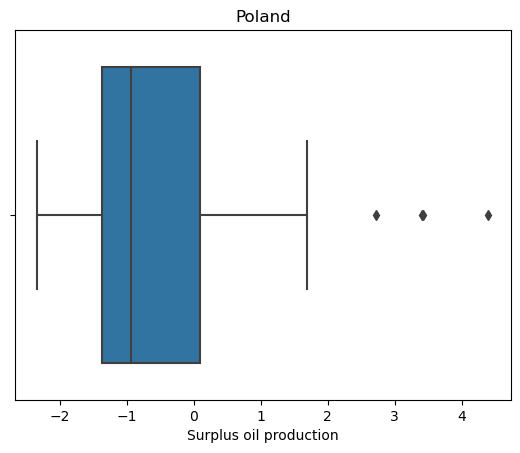

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


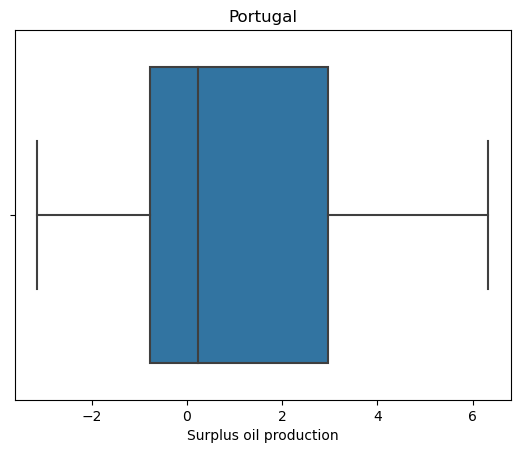

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


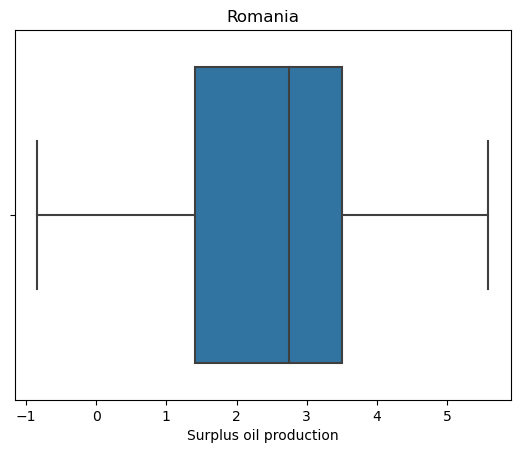

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


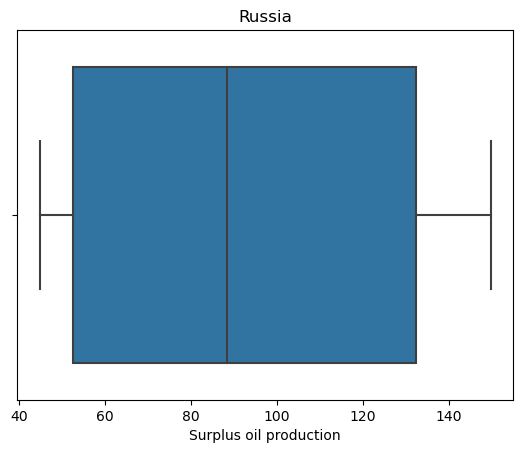

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


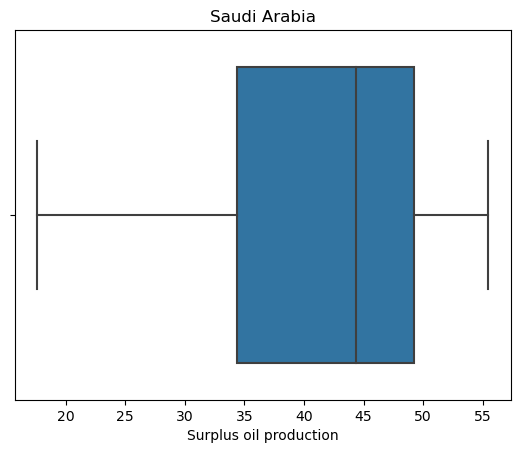

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


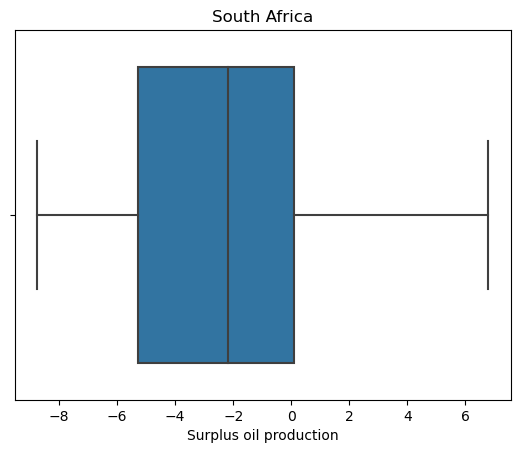

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


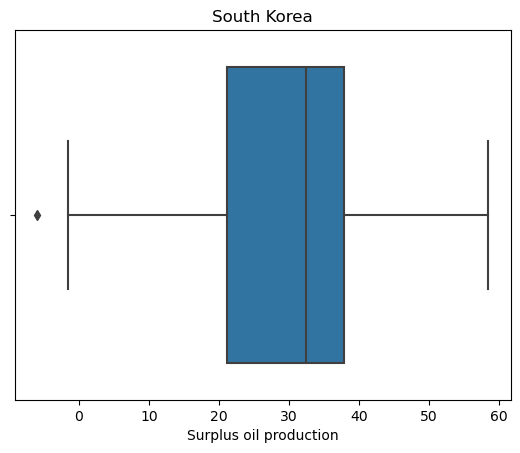

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


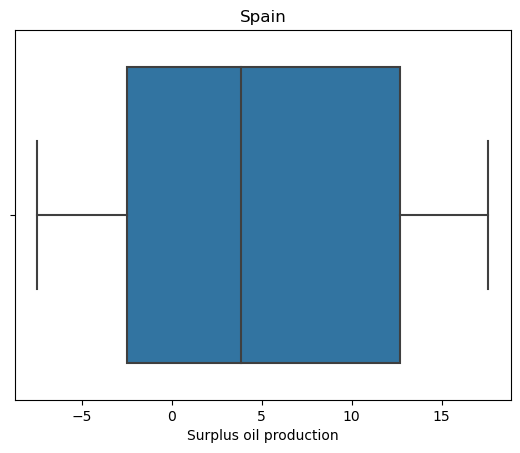

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


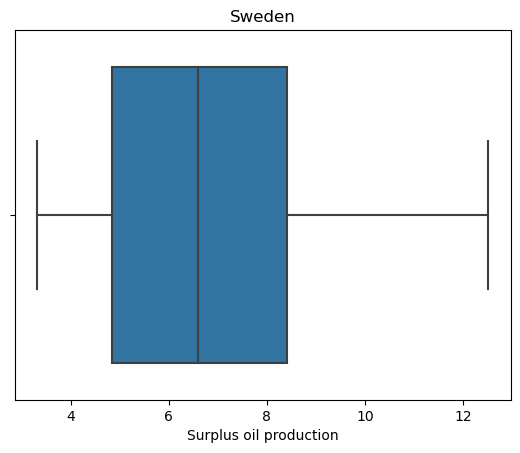

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


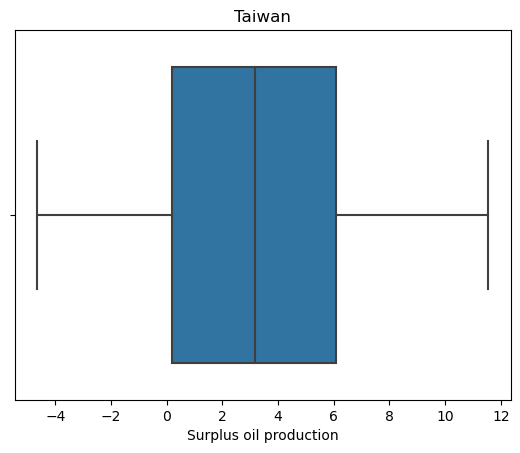

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


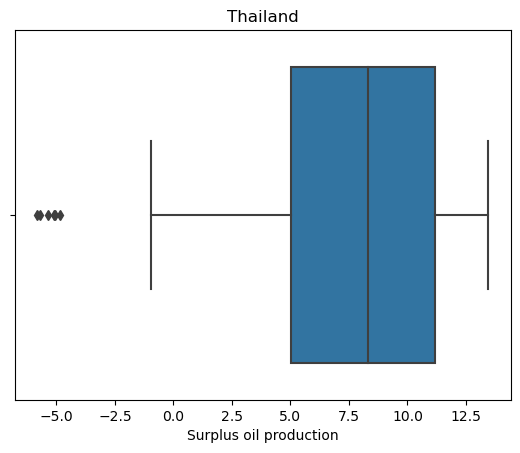

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


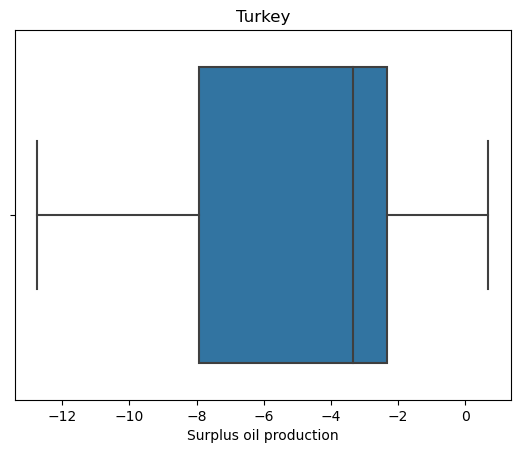

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


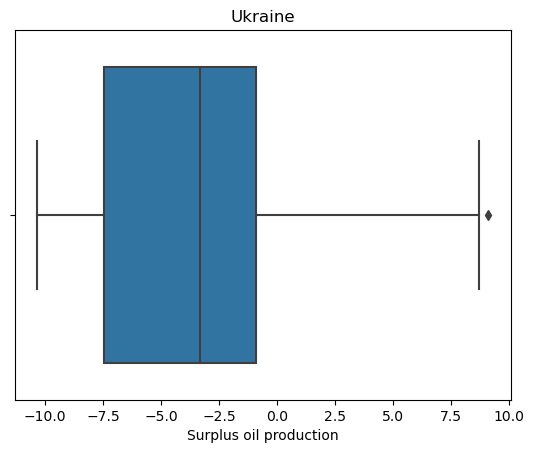

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


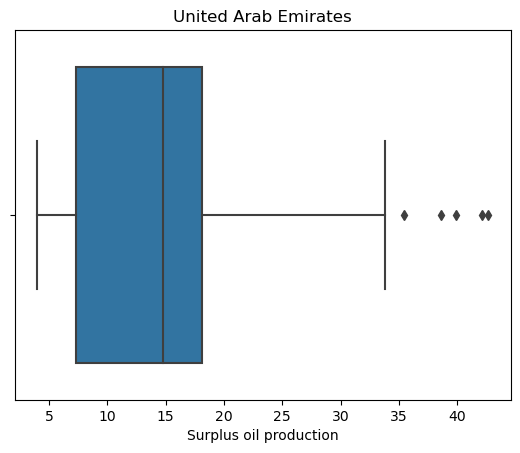

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


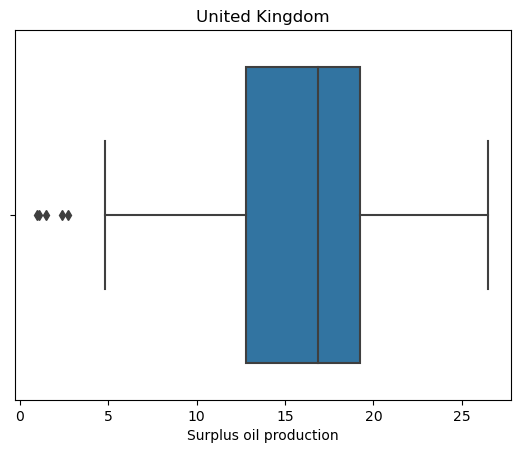

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


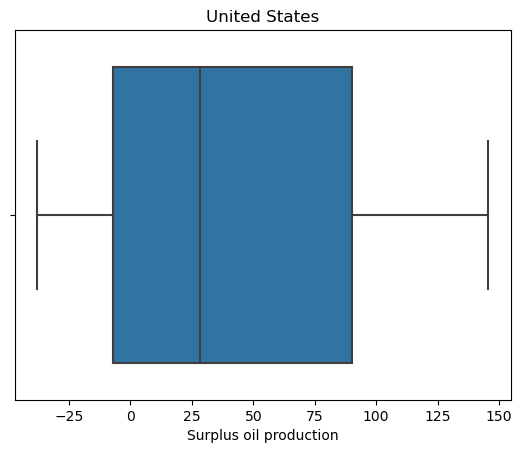

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


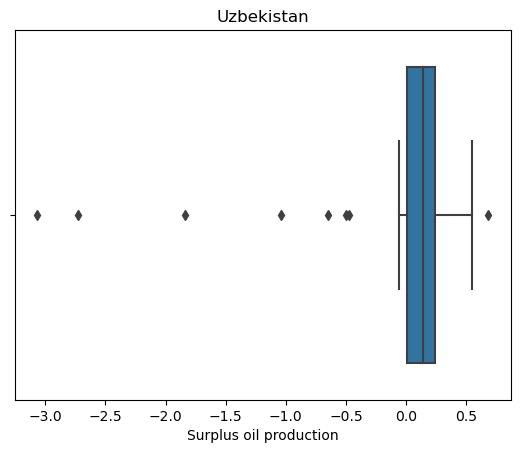

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


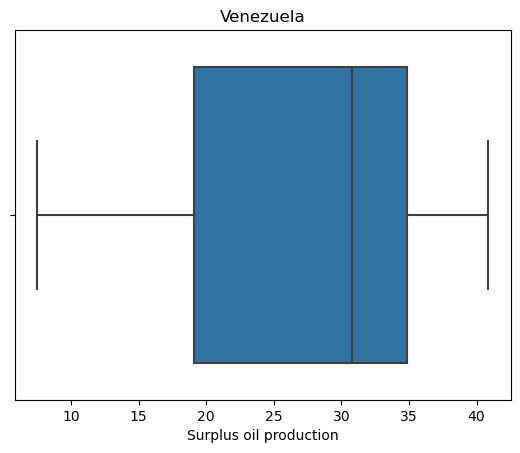

In [42]:
for o in range(len(new_data)):
    sns.boxplot(new_data[o]["Surplus oil production"])
    plt.title(countries[o])
    plt.show()

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


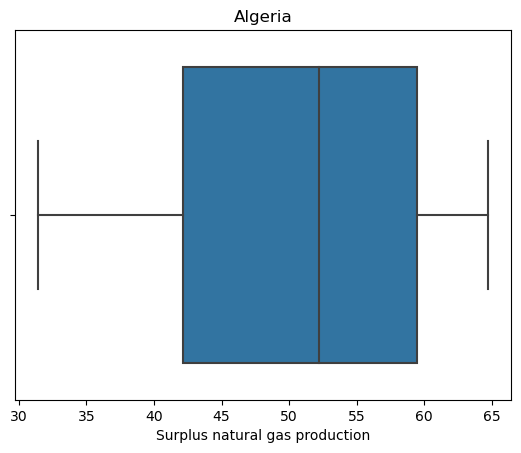

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


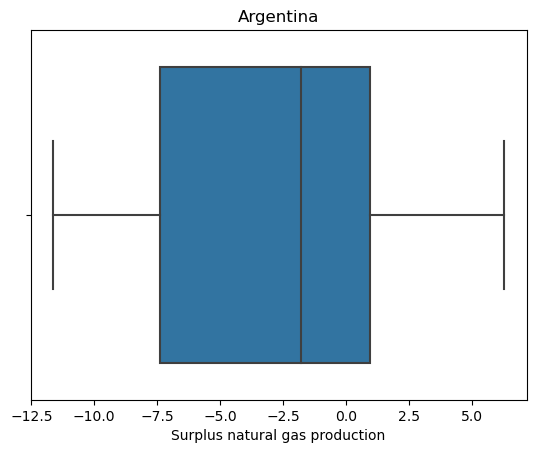

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


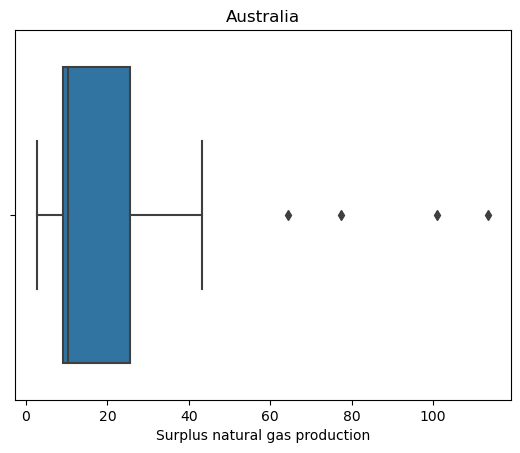

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


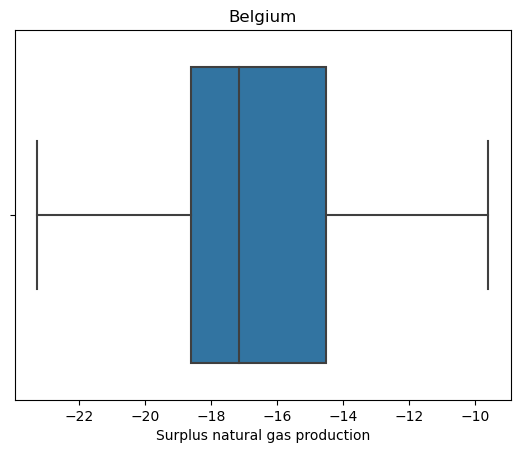

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


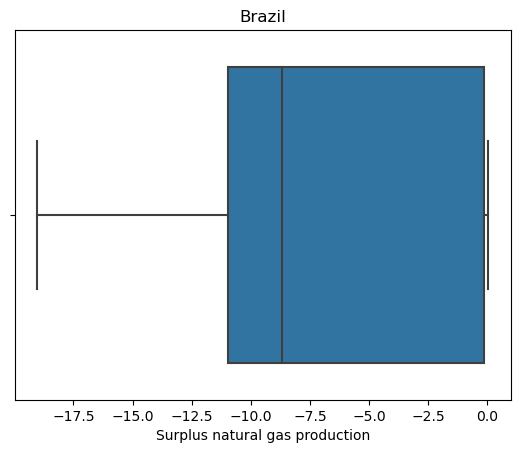

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


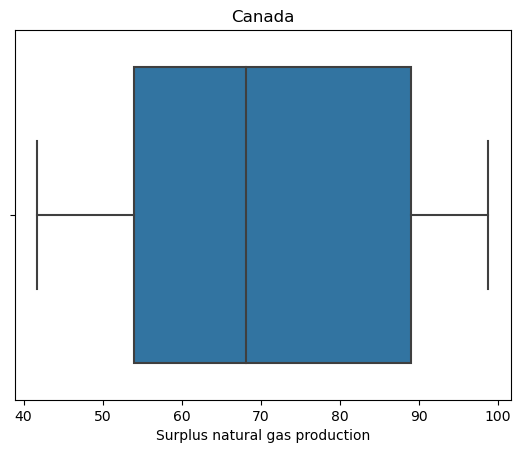

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


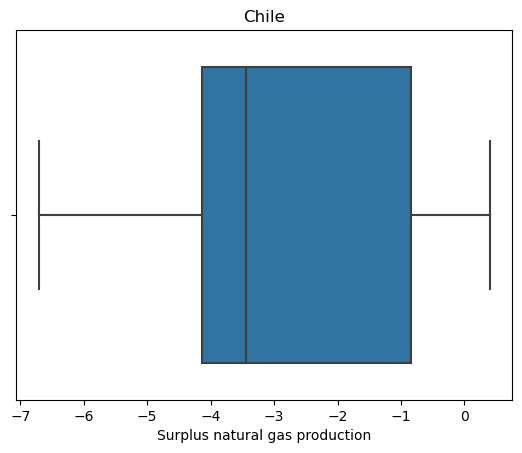

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


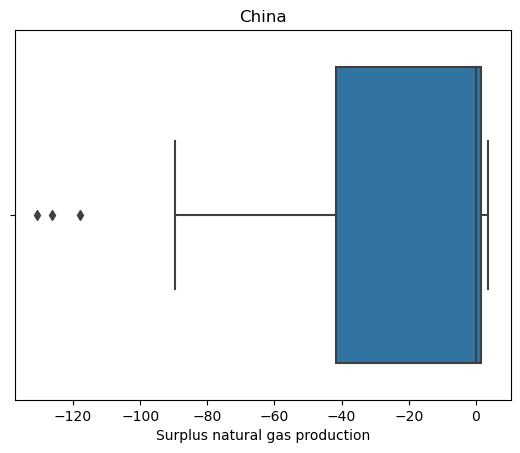

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


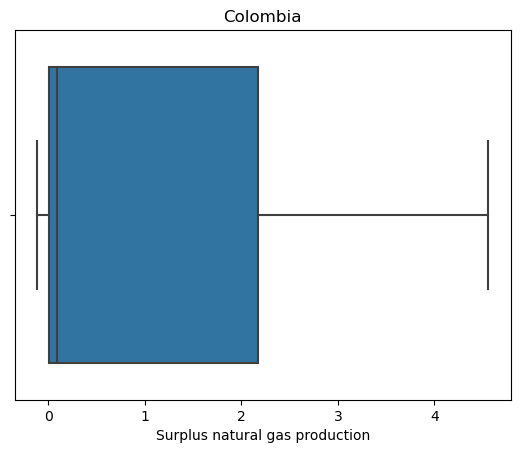

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


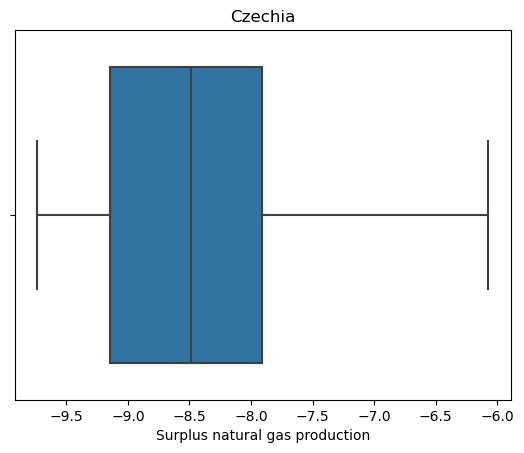

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


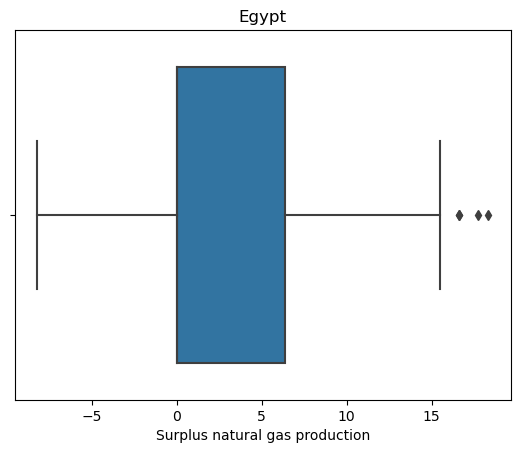

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


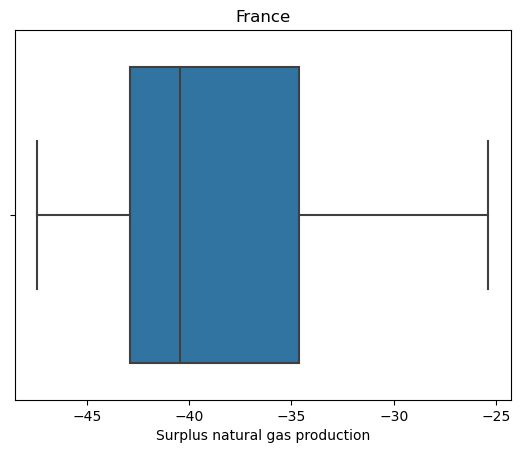

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


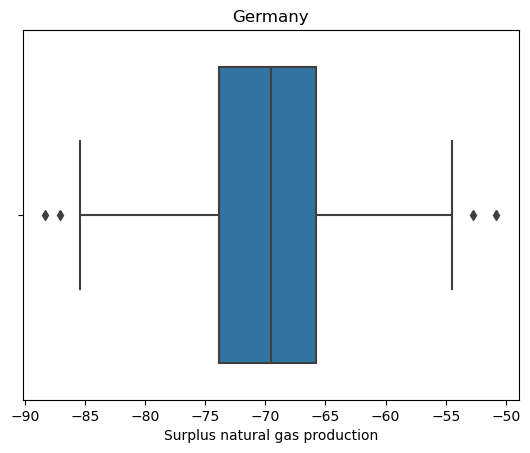

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


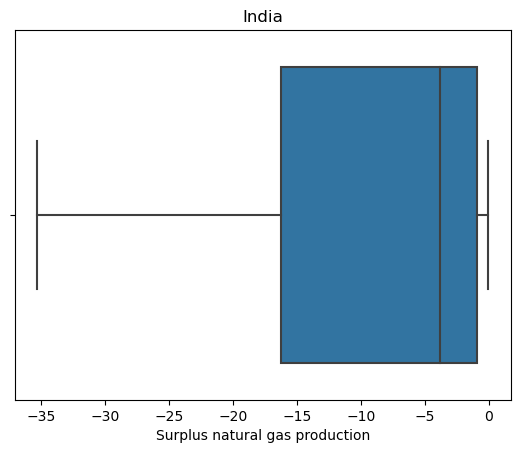

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


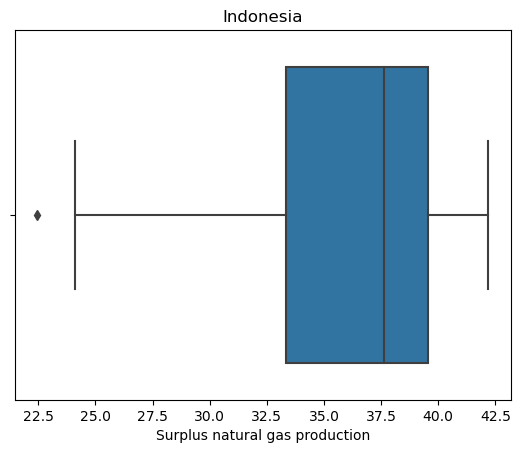

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


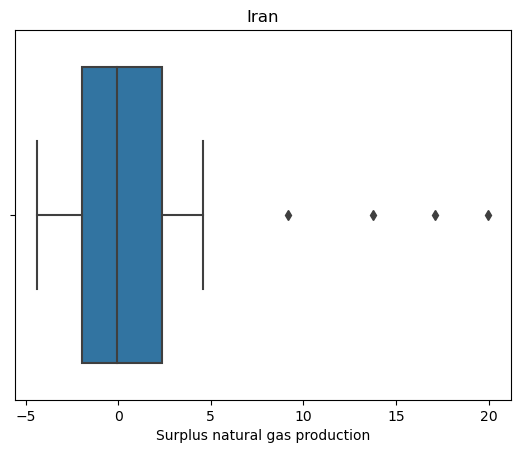

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


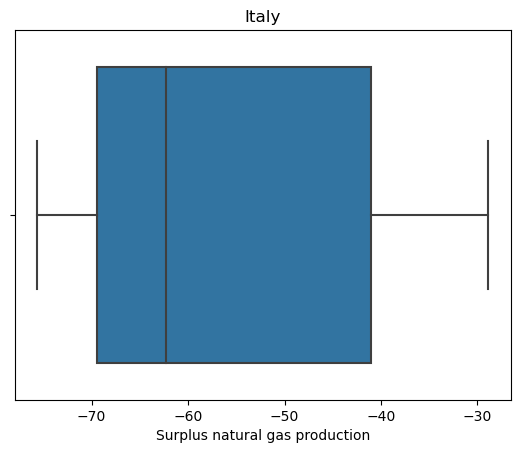

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


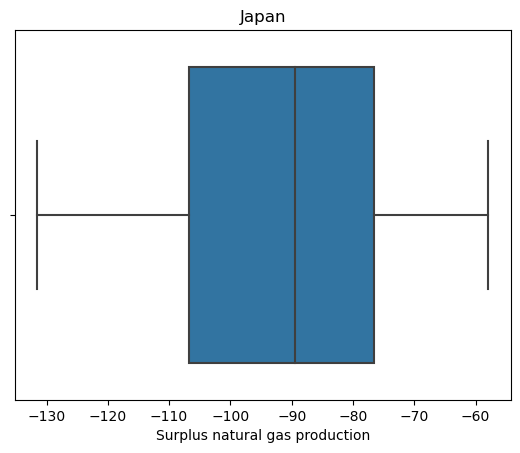

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


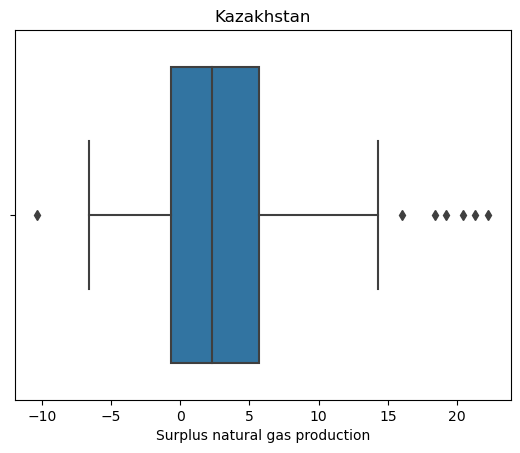

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


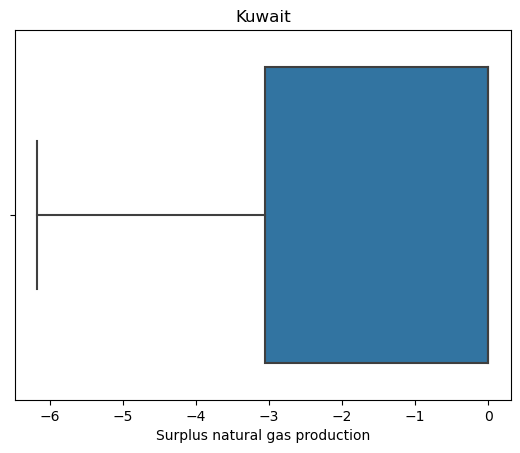

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


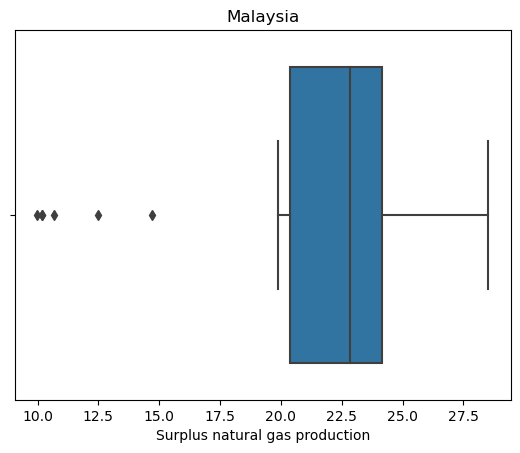

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


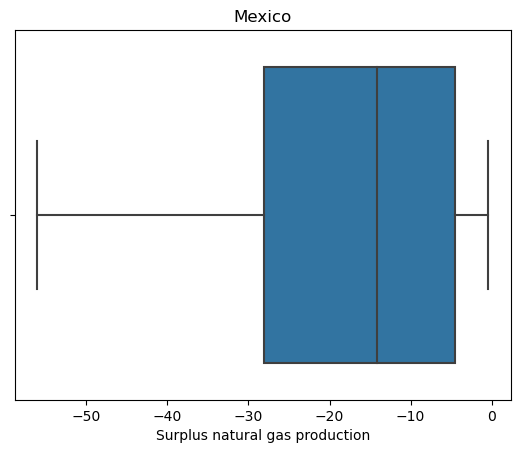

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


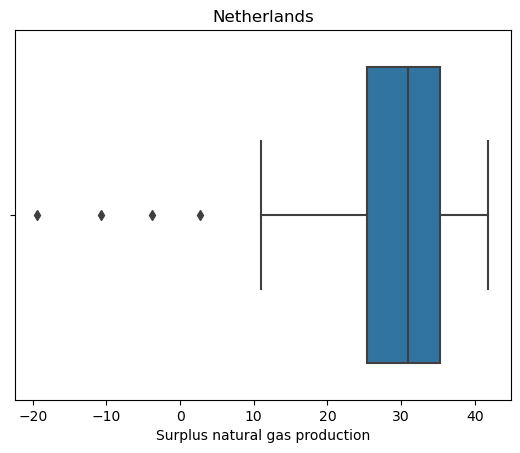

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


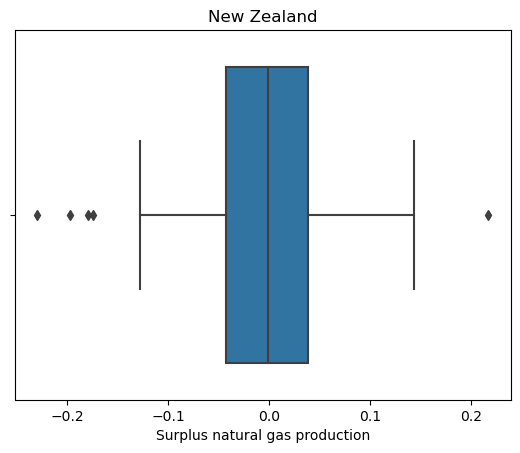

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


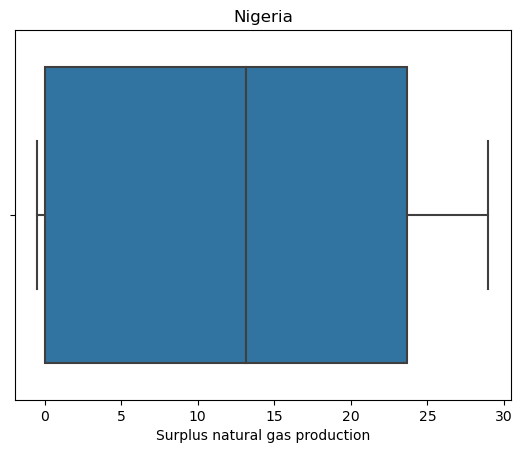

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


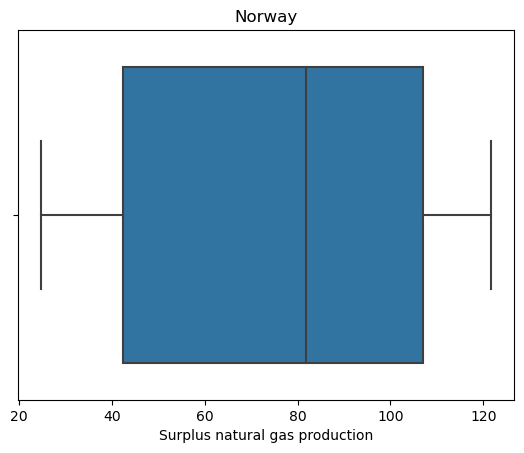

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


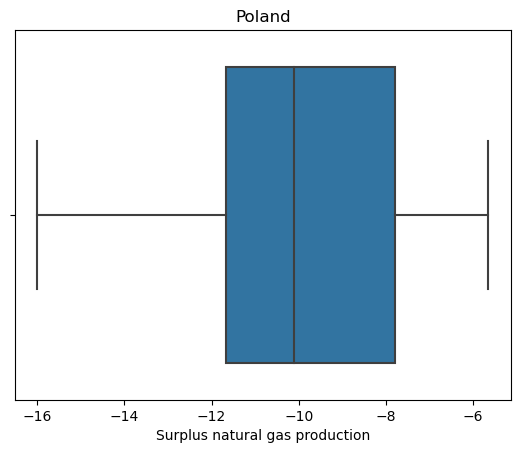

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


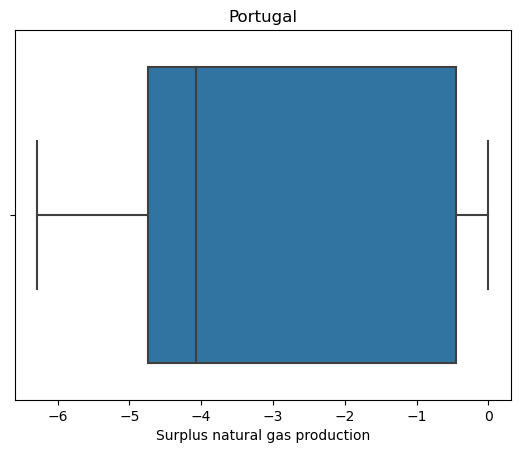

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


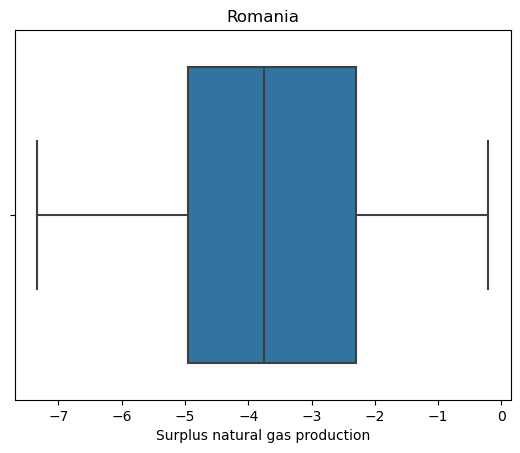

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


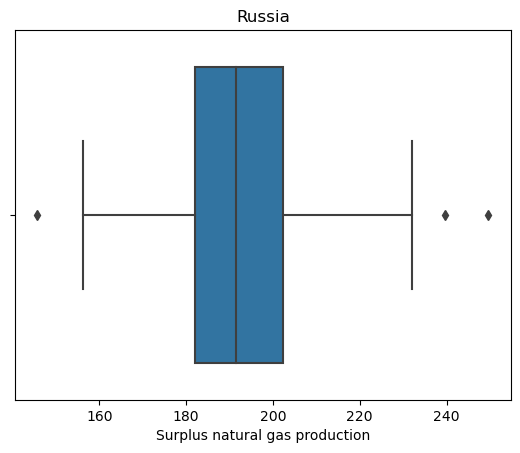

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


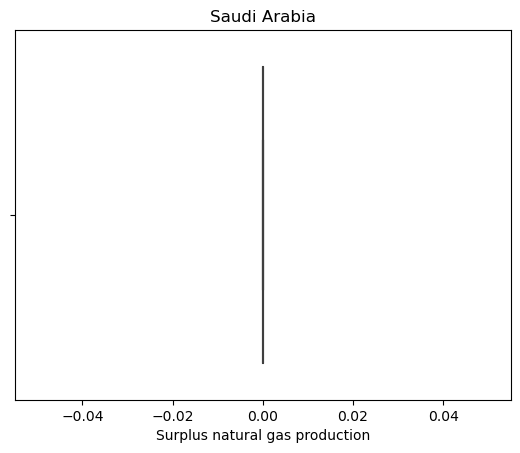

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


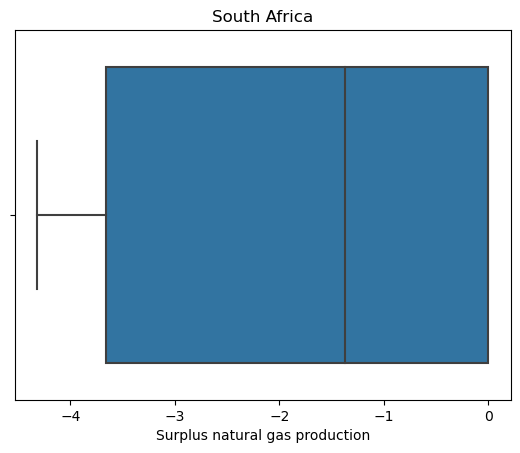

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


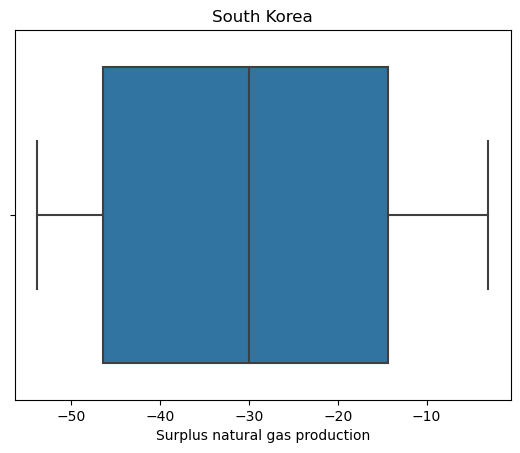

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


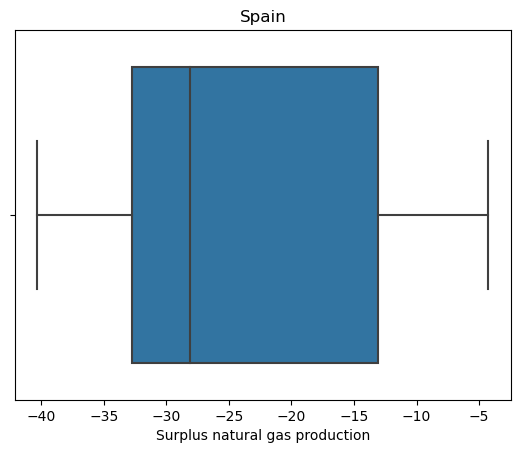

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


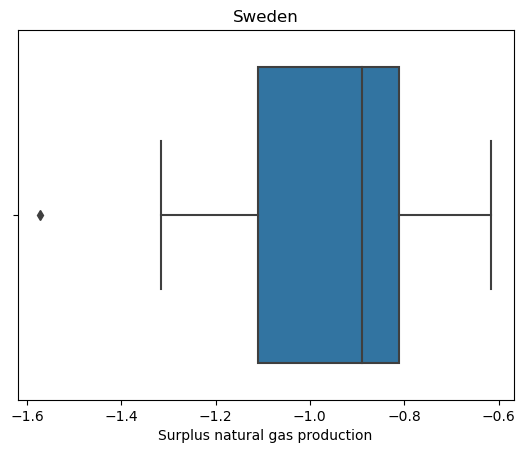

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


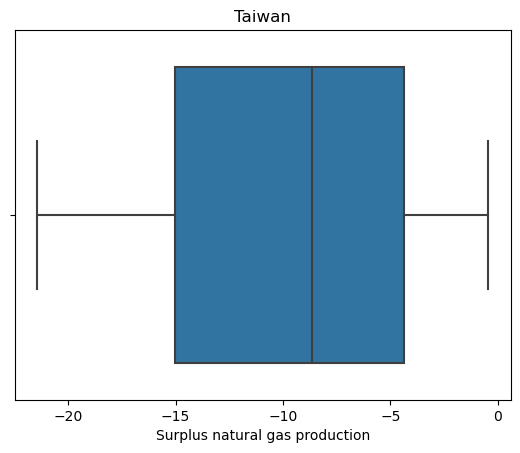

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


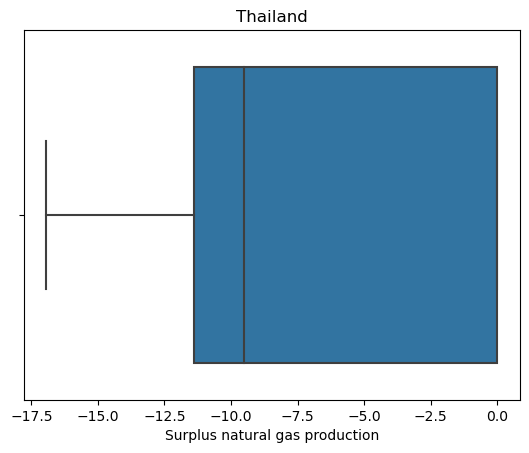

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


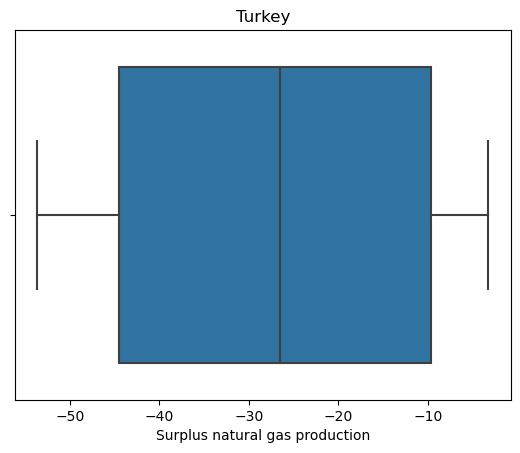

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


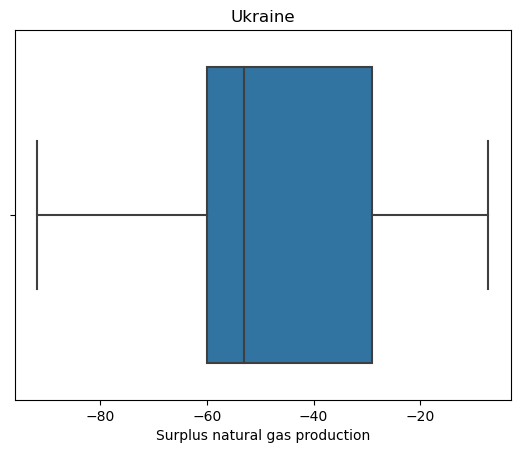

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


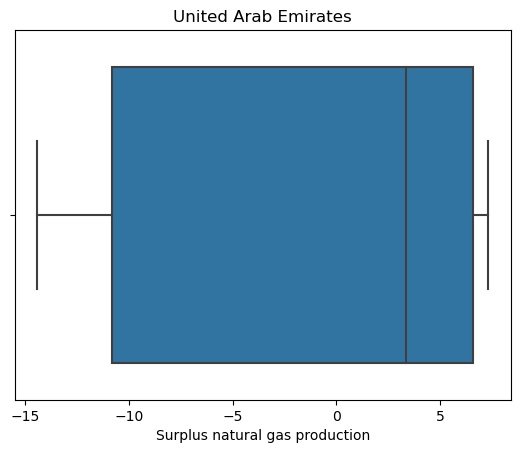

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


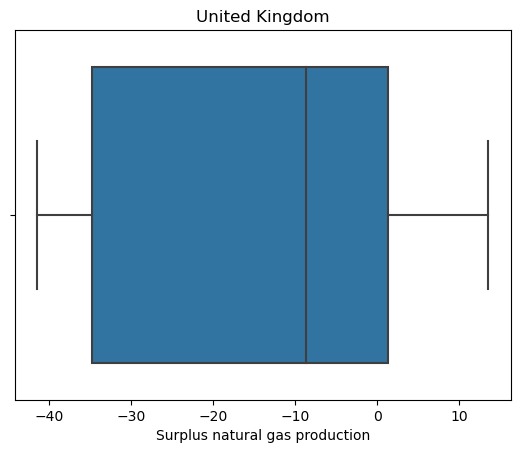

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


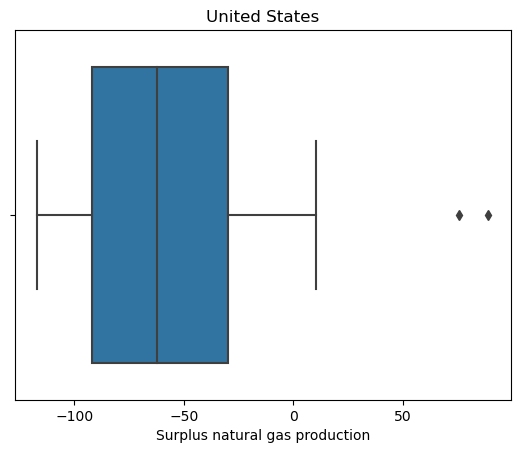

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


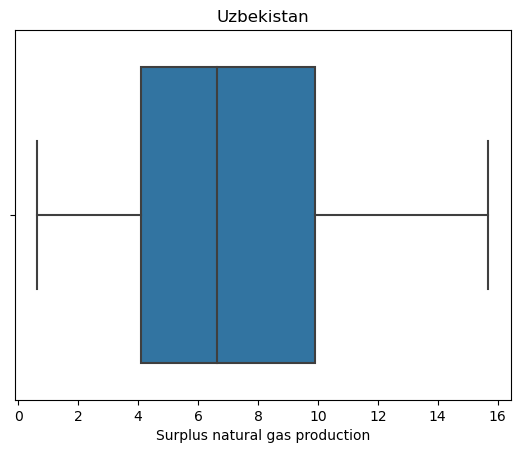

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


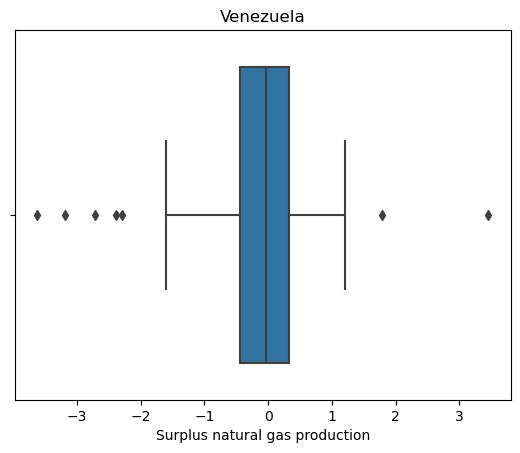

In [43]:
for o in range(len(new_data)):
    sns.boxplot(new_data[o]["Surplus natural gas production"])
    plt.title(countries[o])
    plt.show()

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


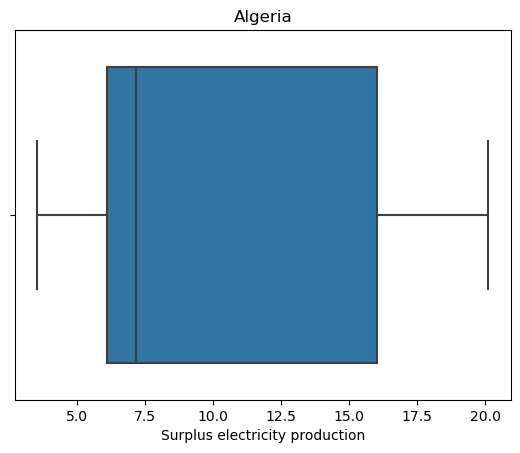

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


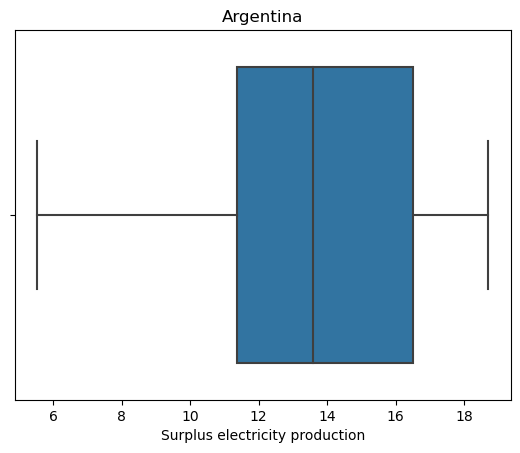

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


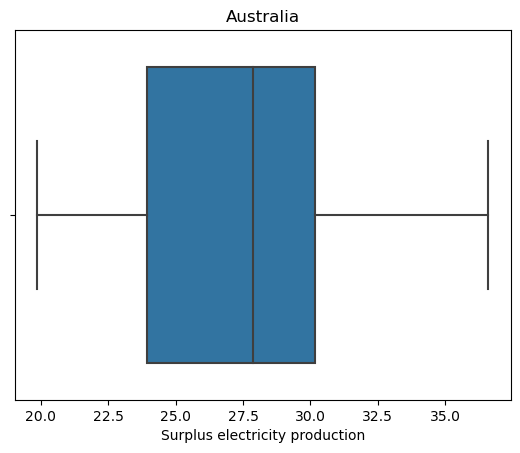

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


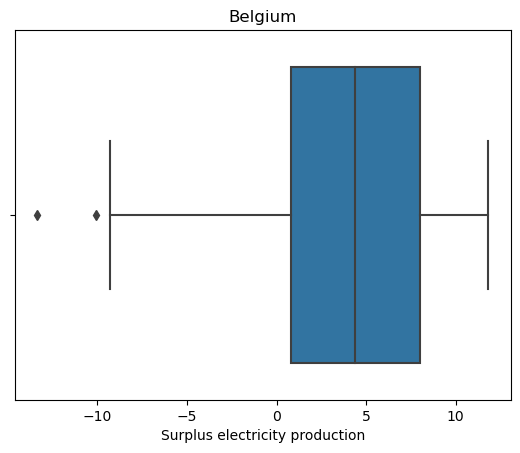

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


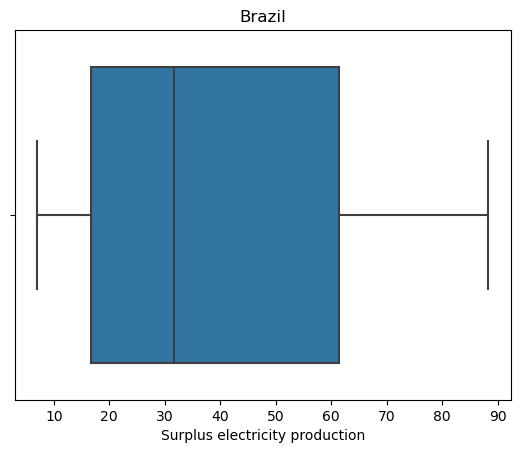

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


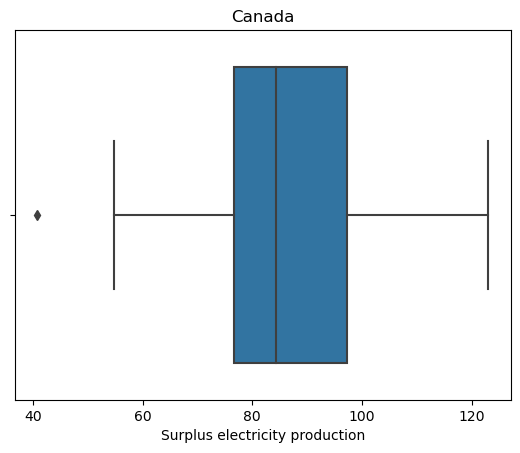

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


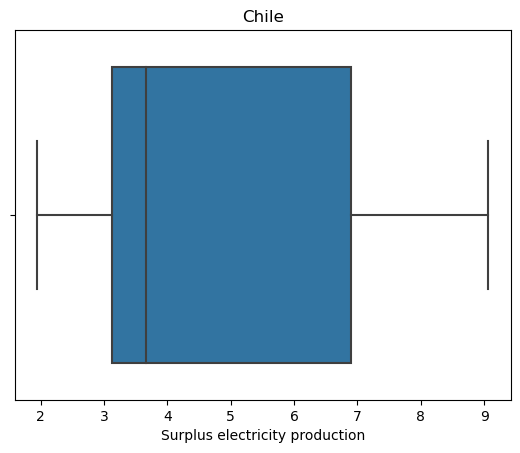

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


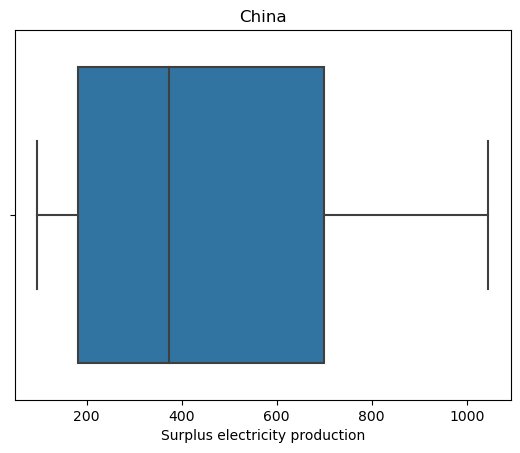

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


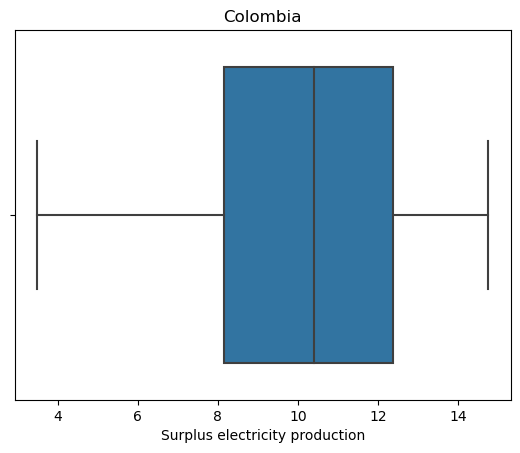

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


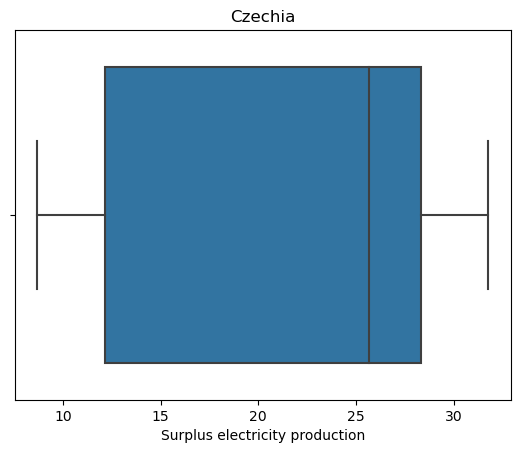

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


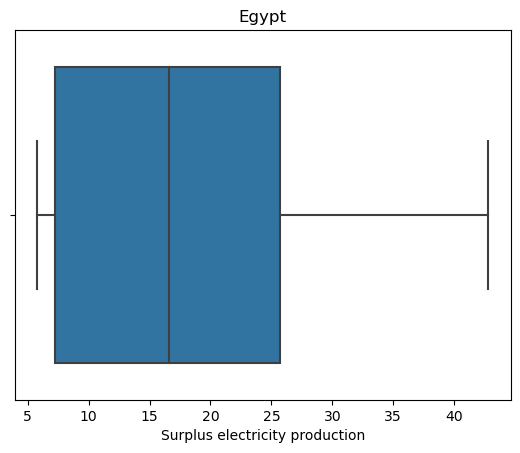

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


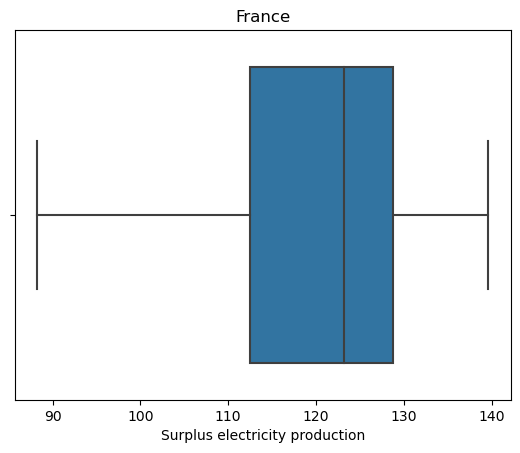

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


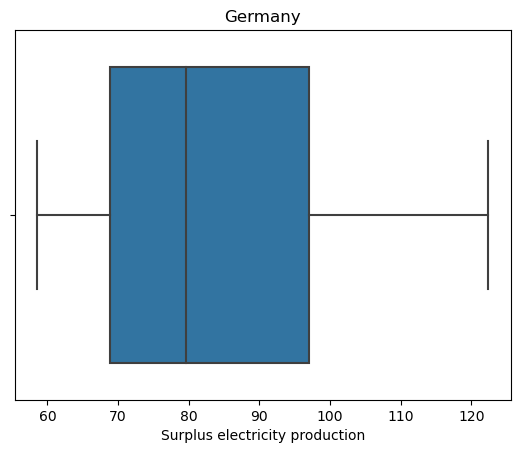

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


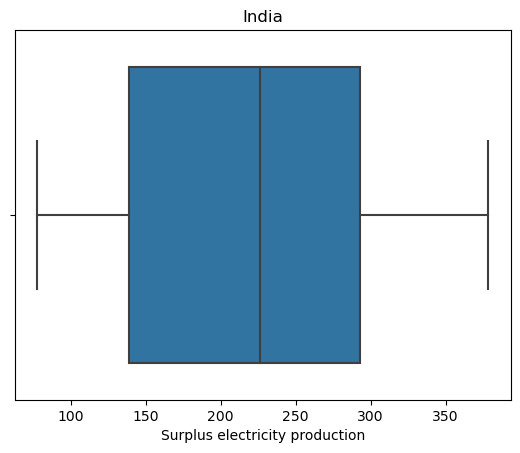

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


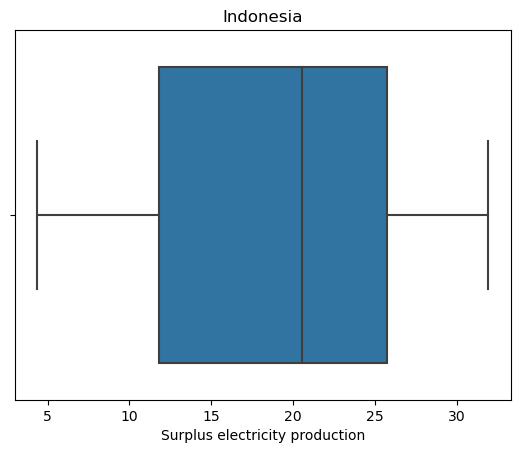

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


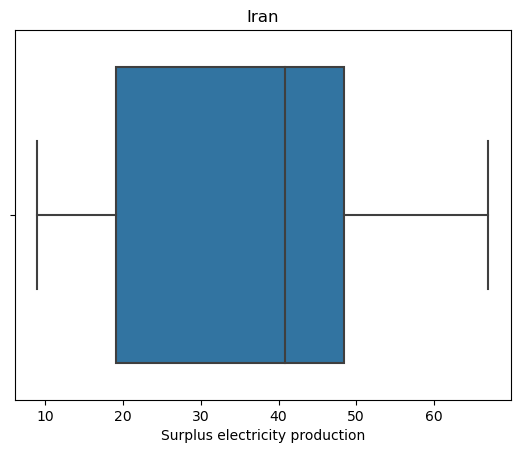

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


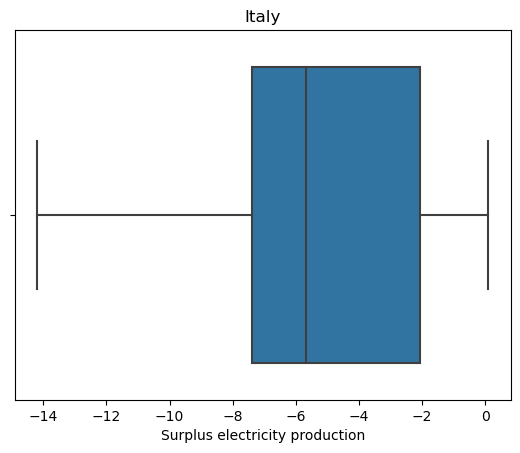

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


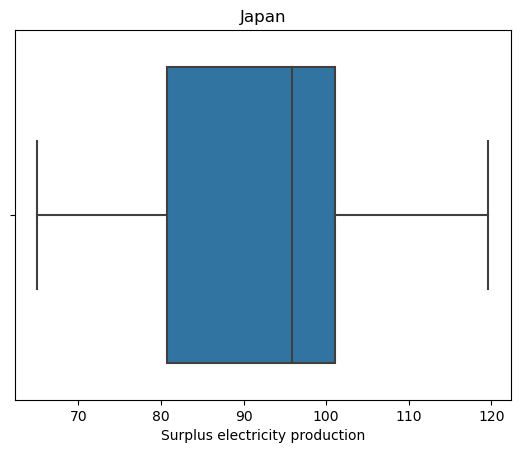

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


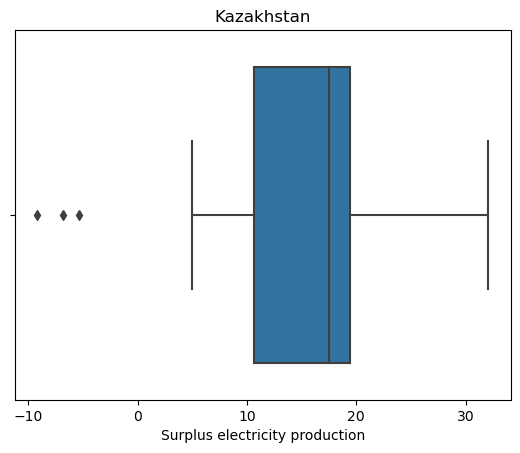

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


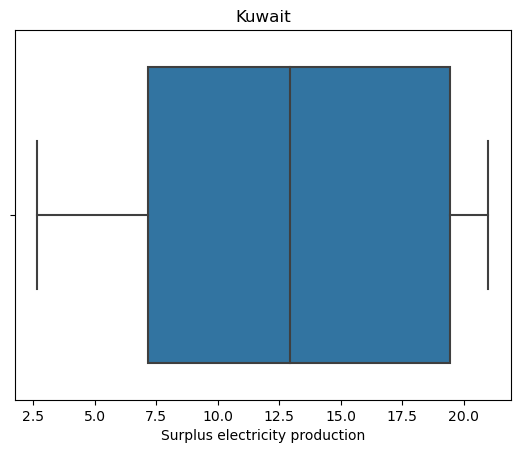

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


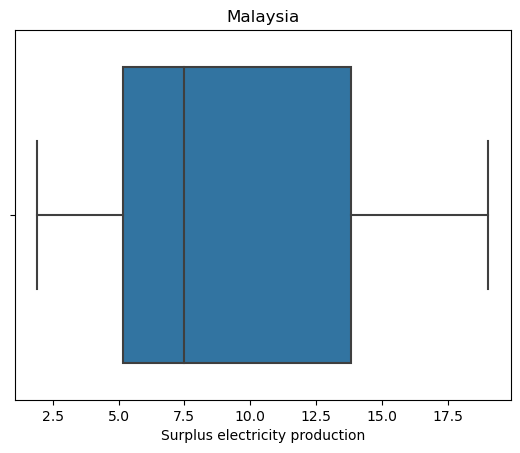

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


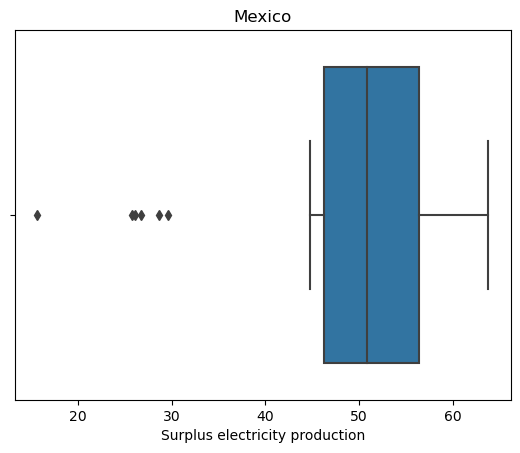

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


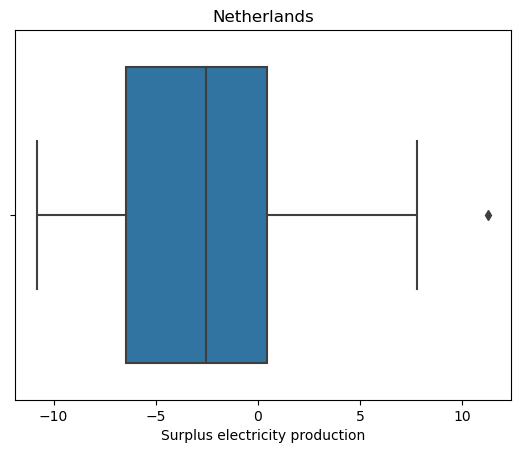

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


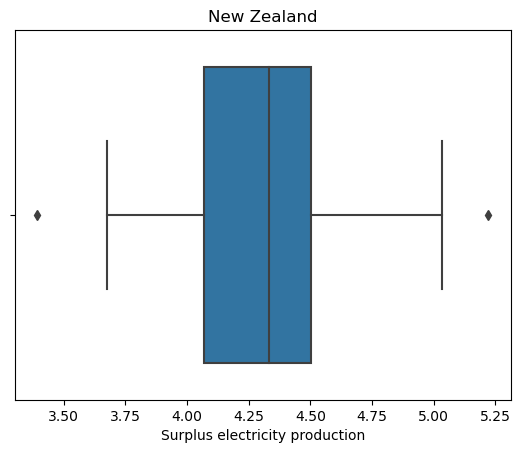

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


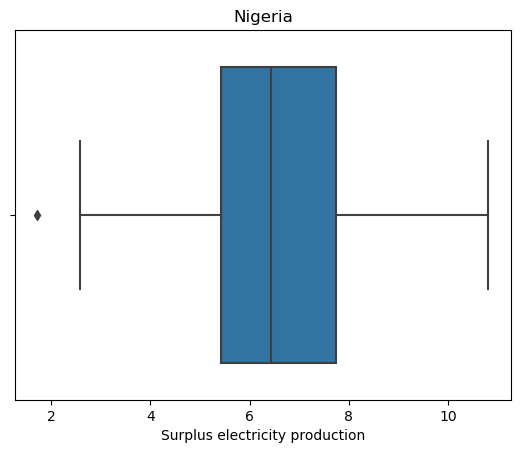

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


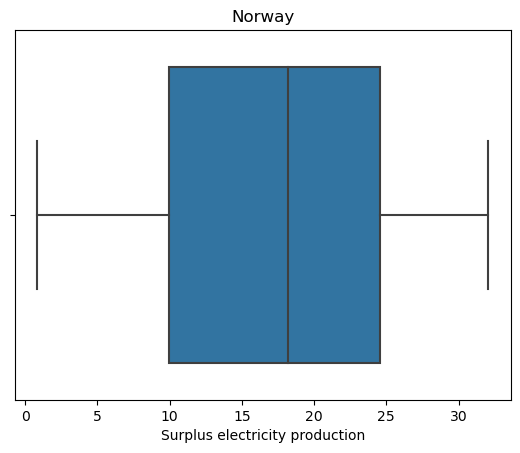

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


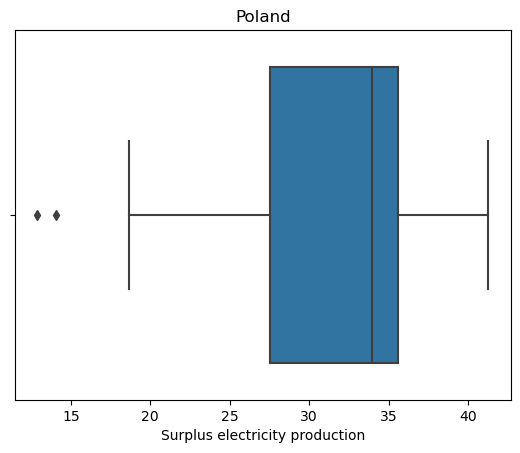

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


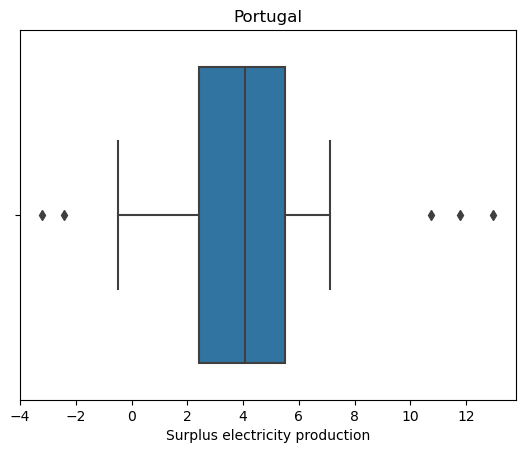

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


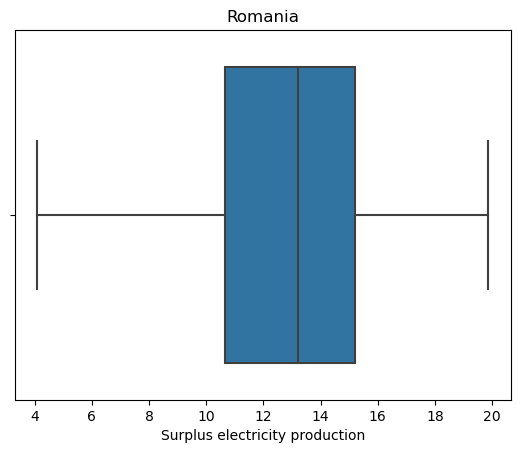

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


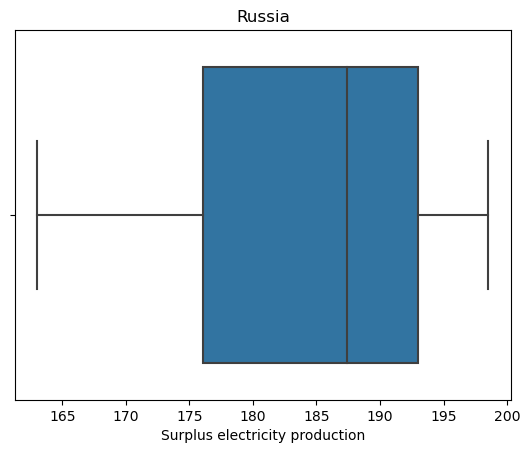

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


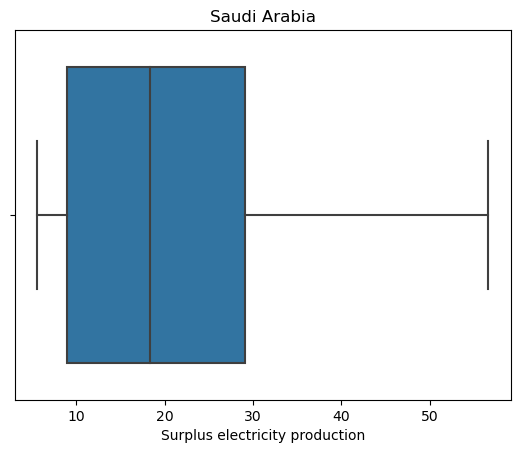

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


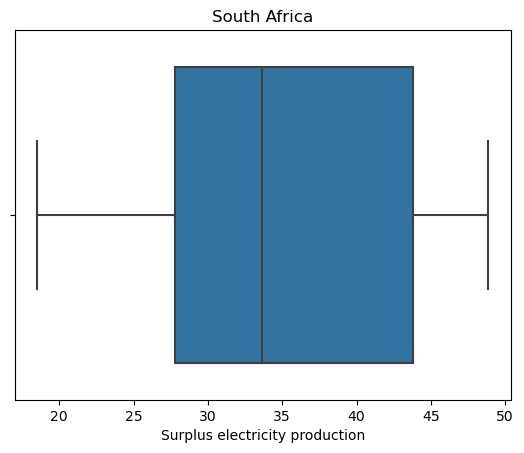

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


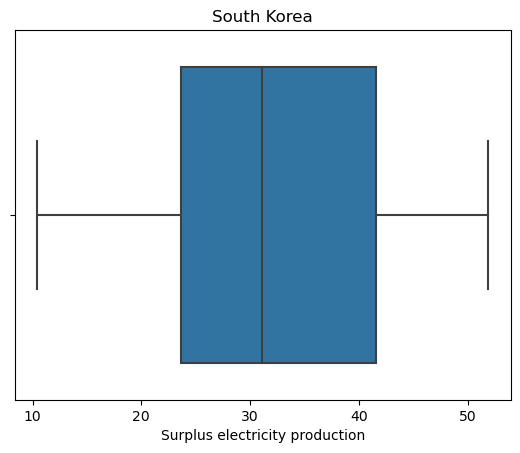

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


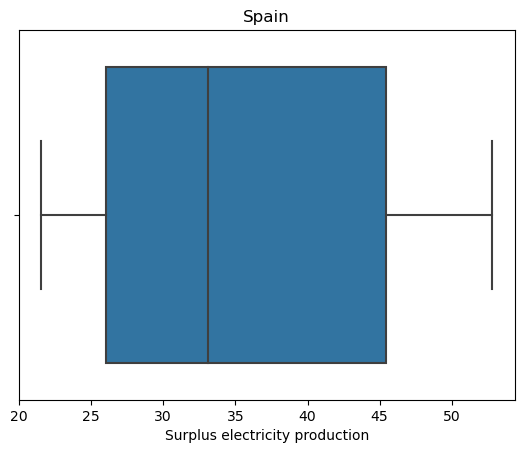

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


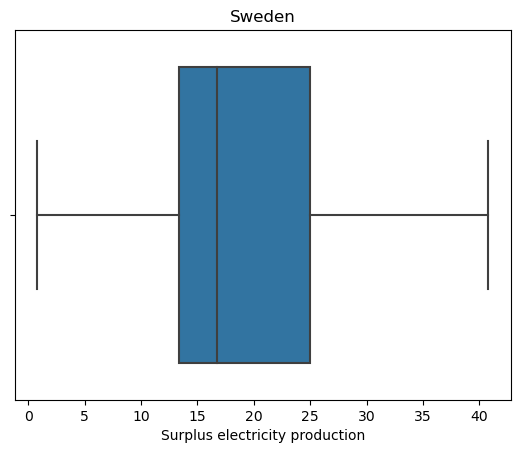

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


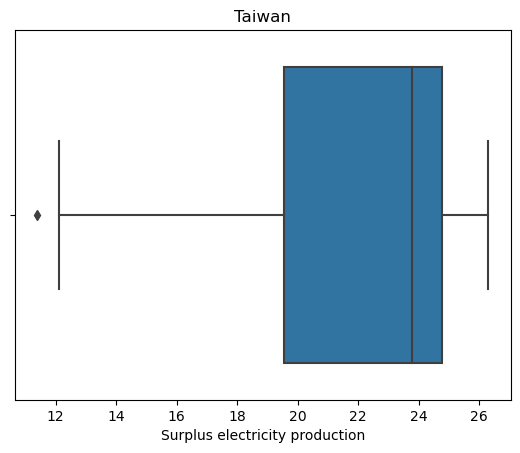

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


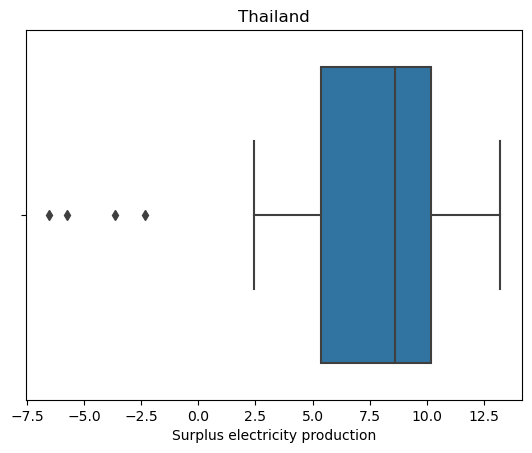

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


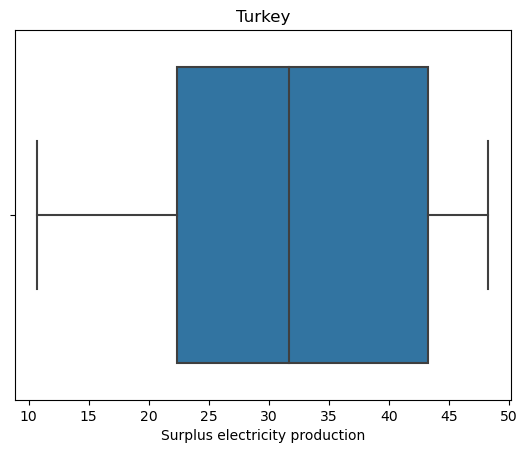

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


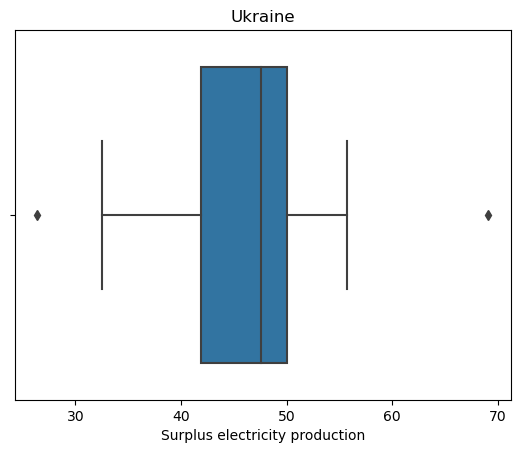

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


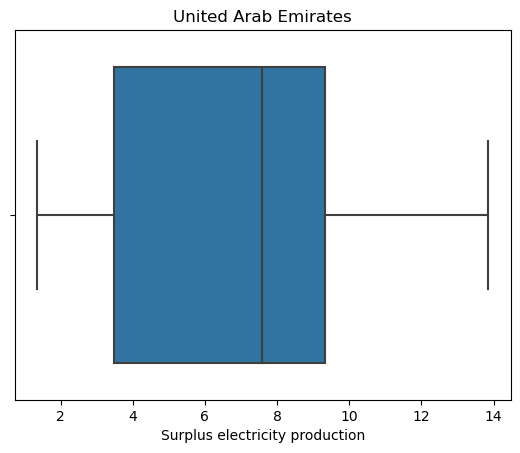

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


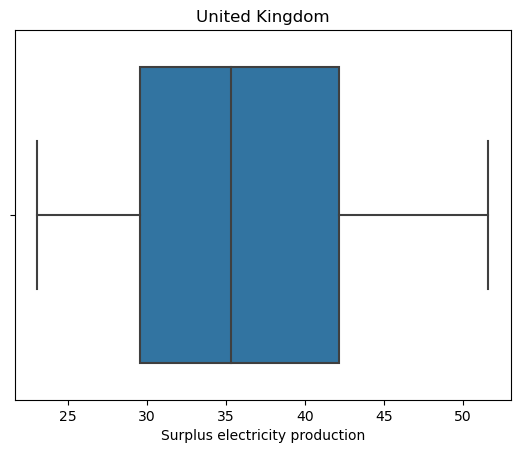

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


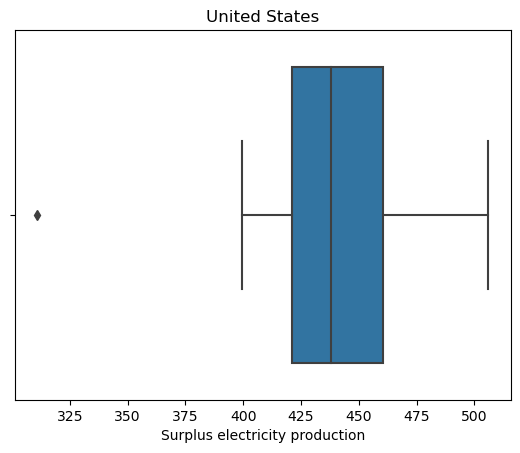

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


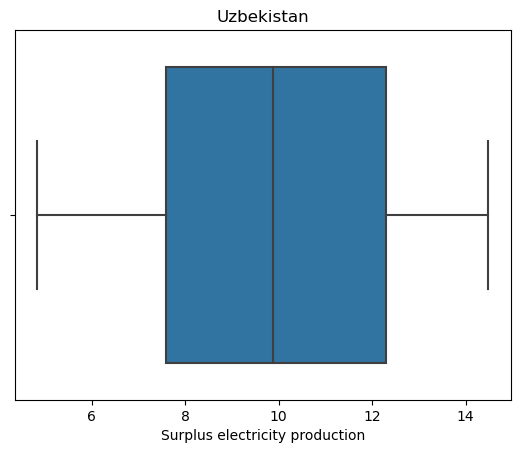

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


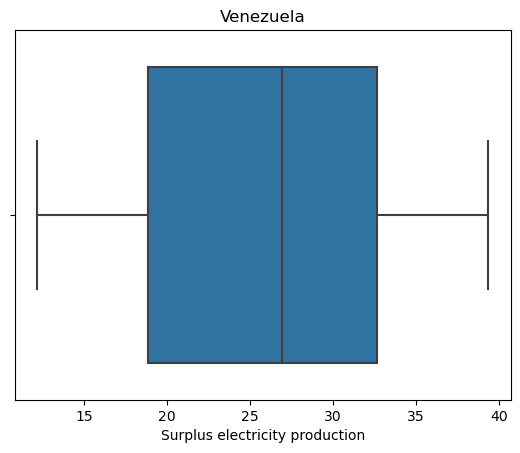

In [44]:
for o in range(len(new_data)):
    sns.boxplot(new_data[o]["Surplus electricity production"])
    plt.title(countries[o])
    plt.show()

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


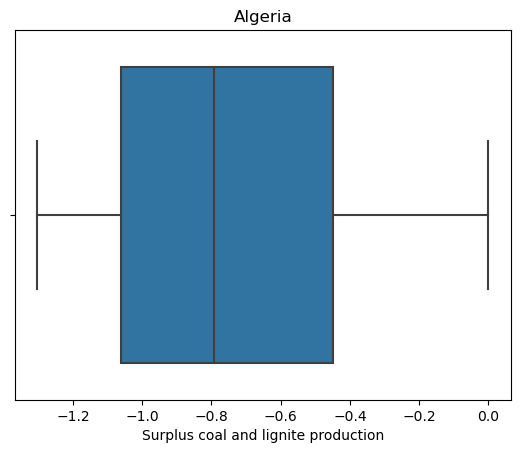

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


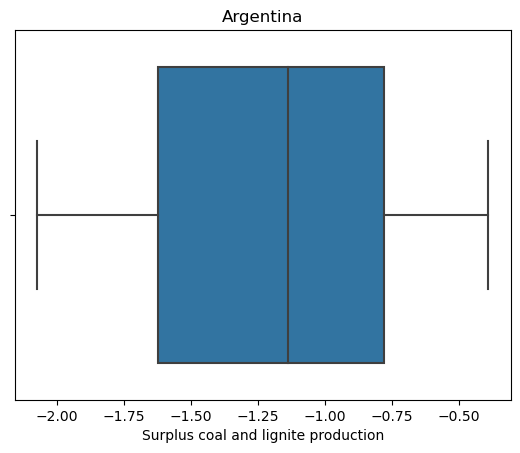

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


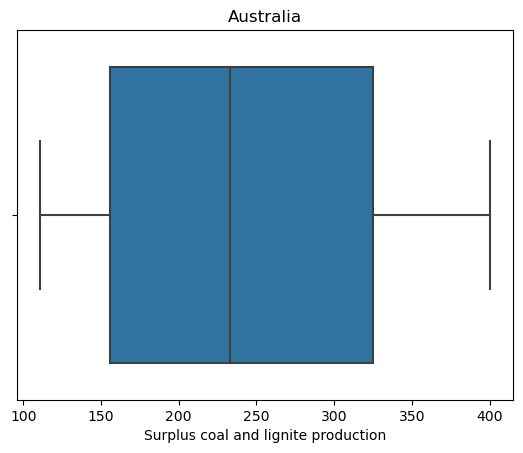

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


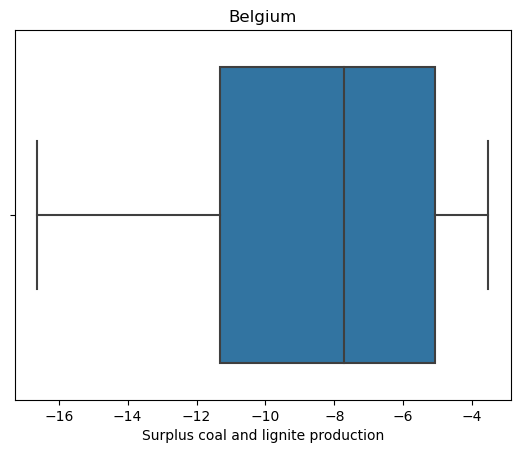

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


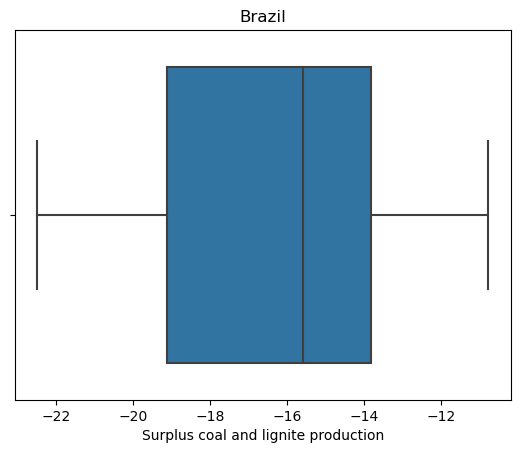

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


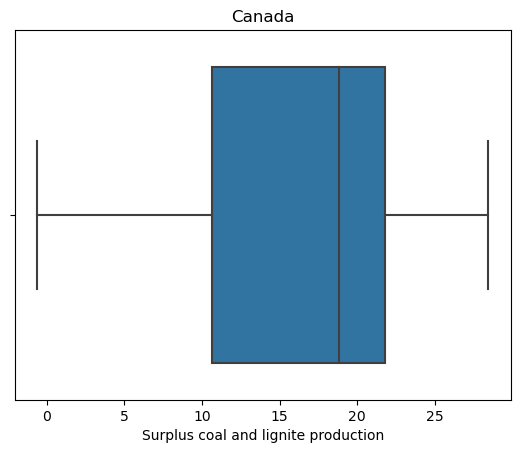

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


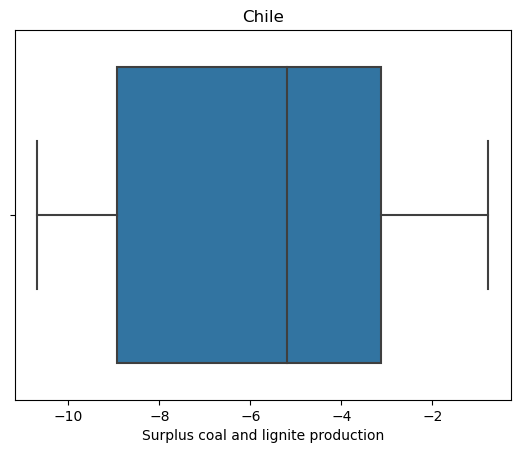

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


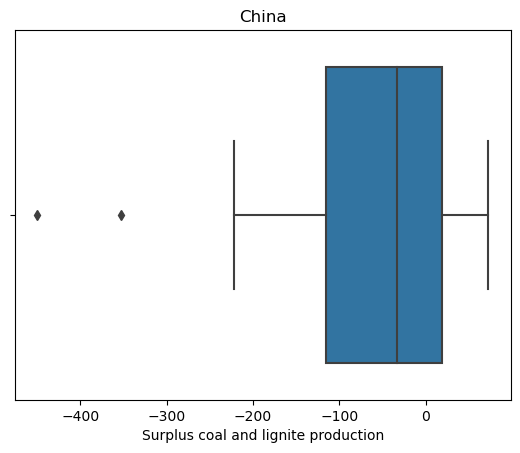

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


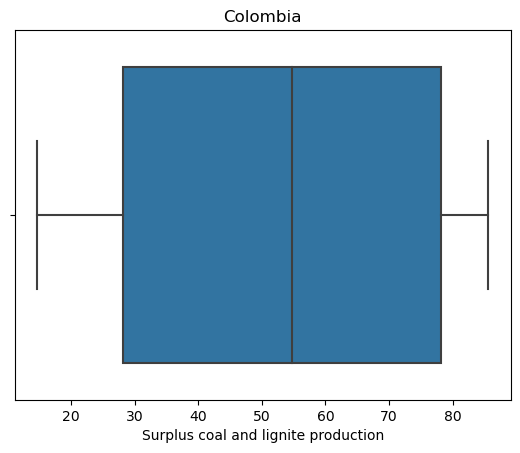

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


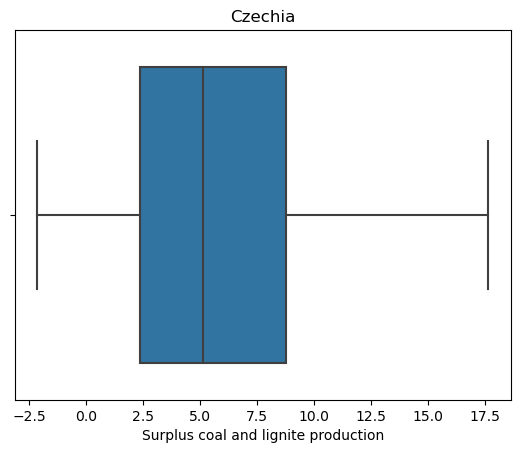

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


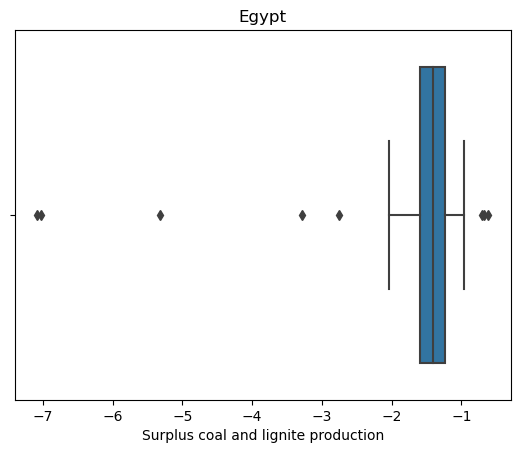

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


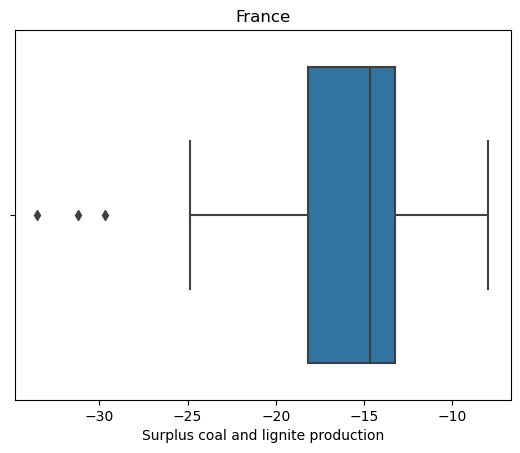

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


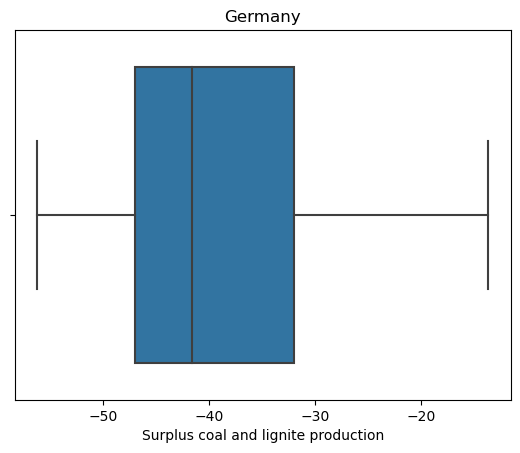

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


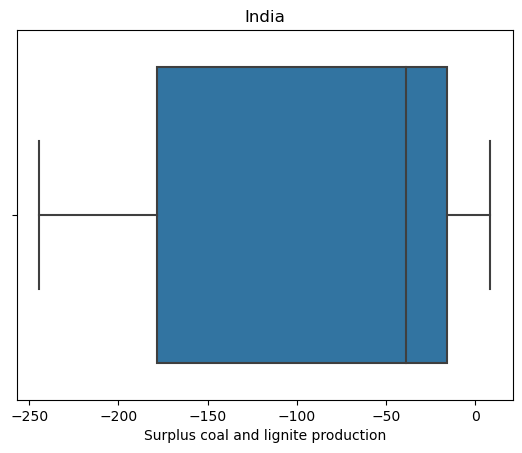

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


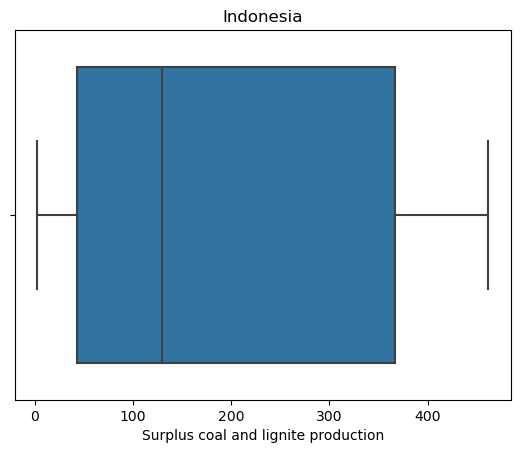

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


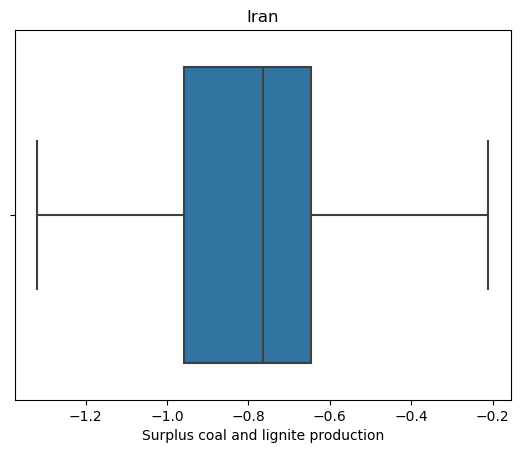

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


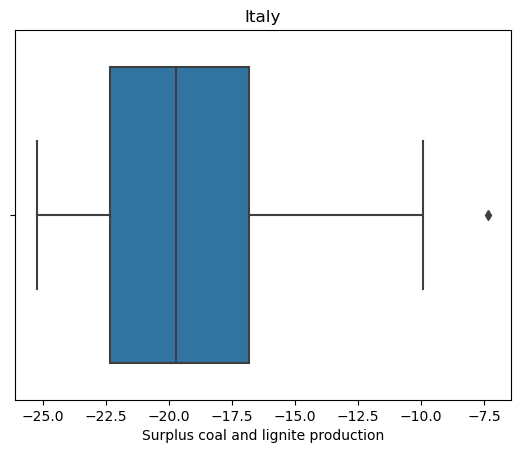

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


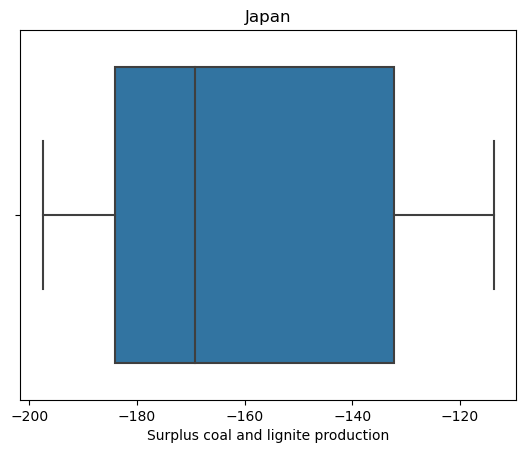

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


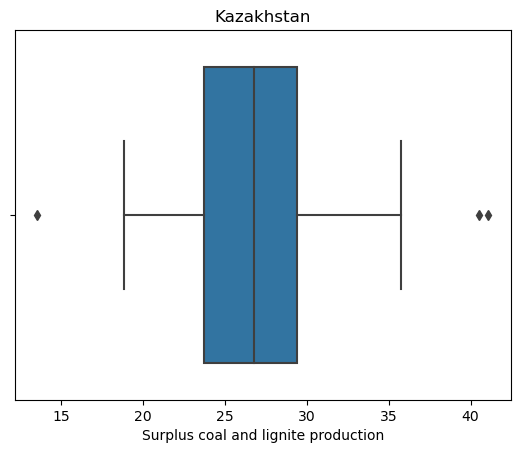

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


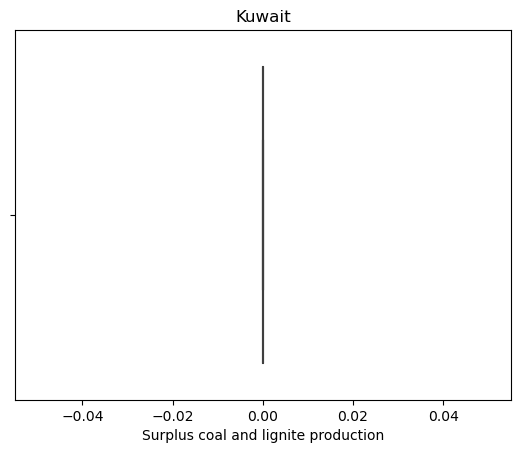

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


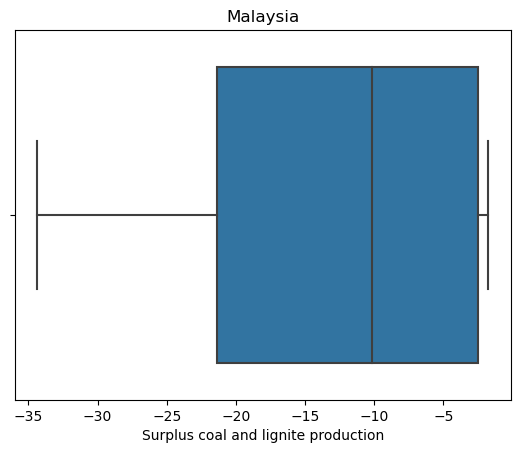

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


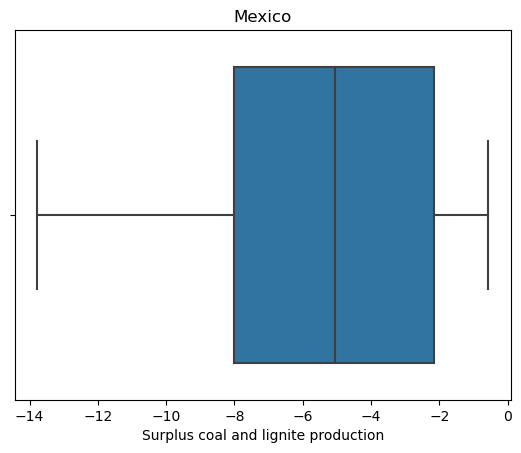

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


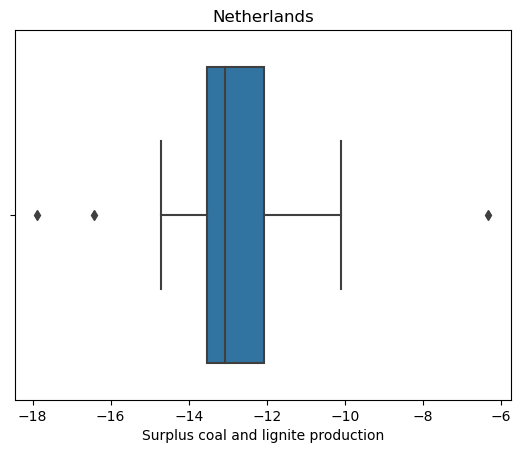

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


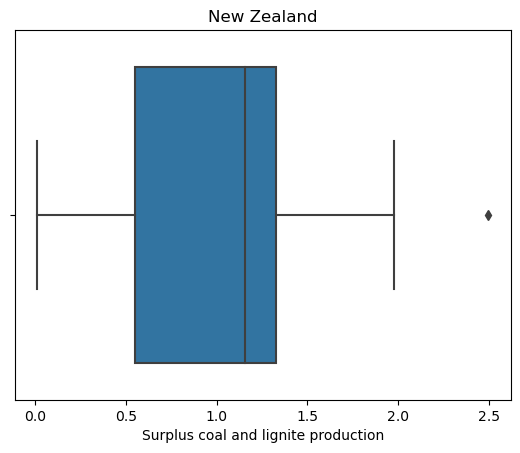

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


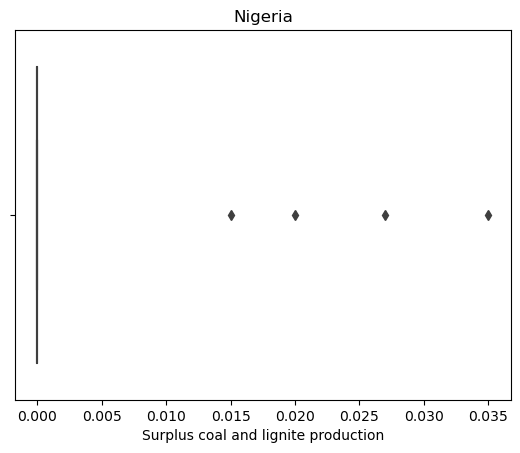

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


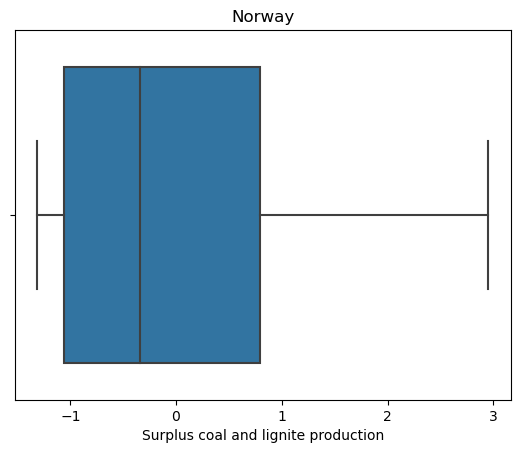

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


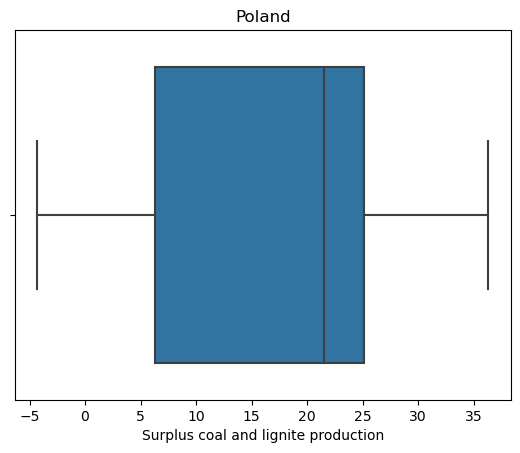

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


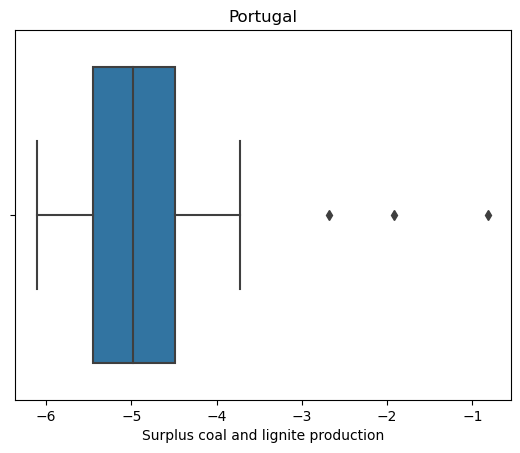

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


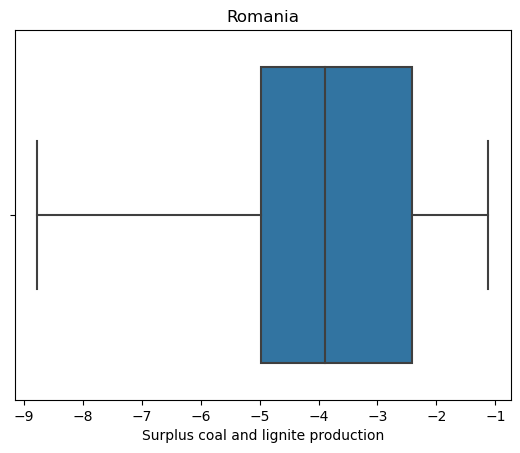

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


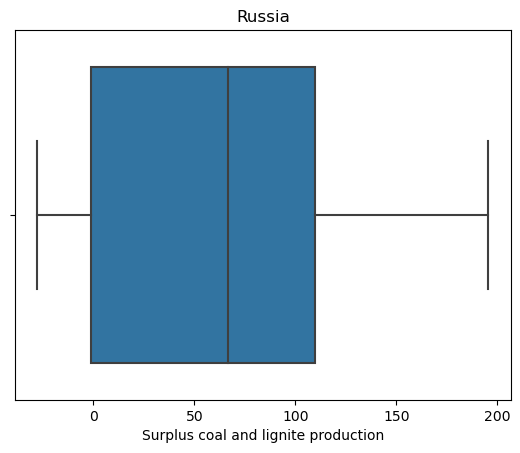

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


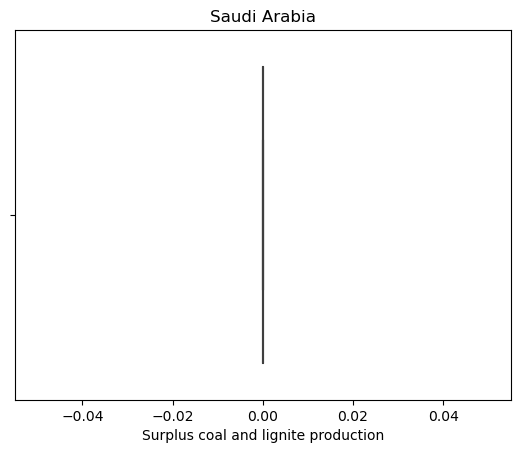

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


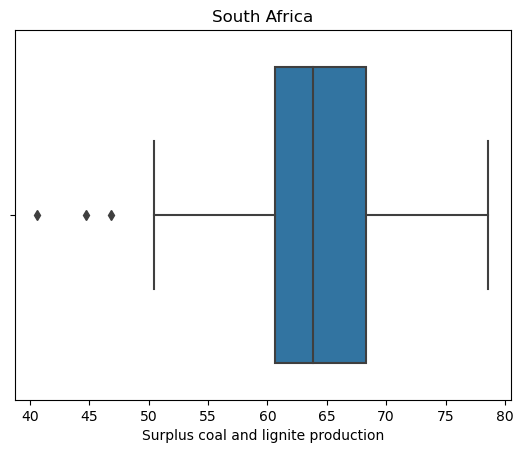

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


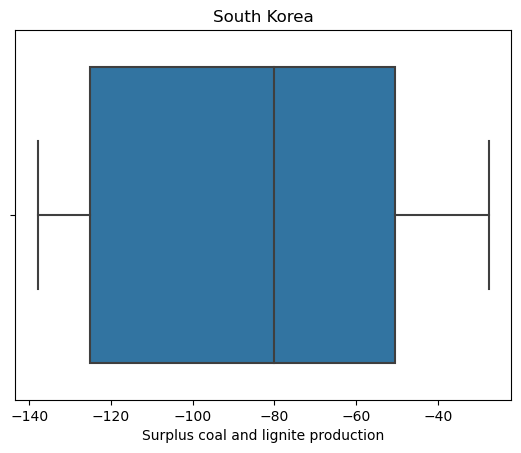

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


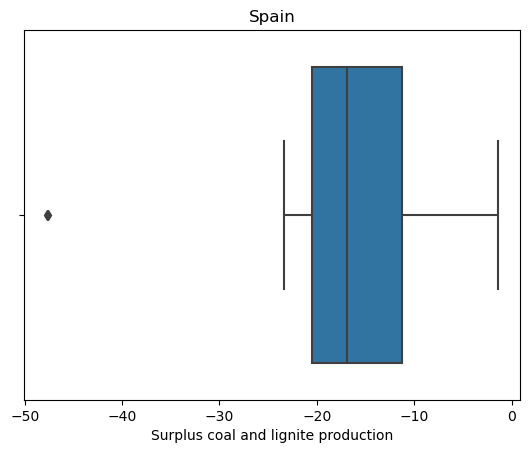

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


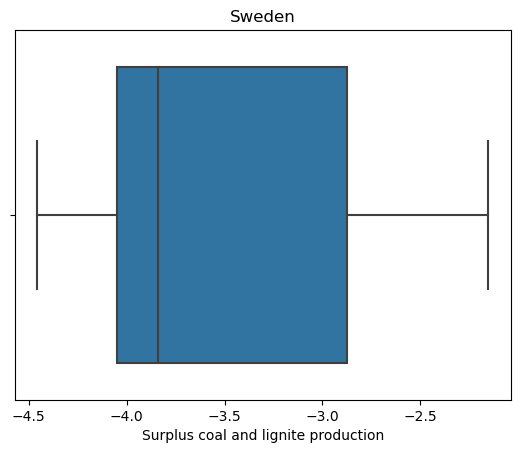

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


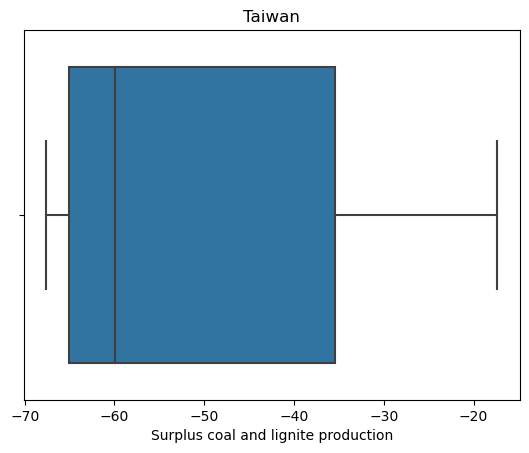

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


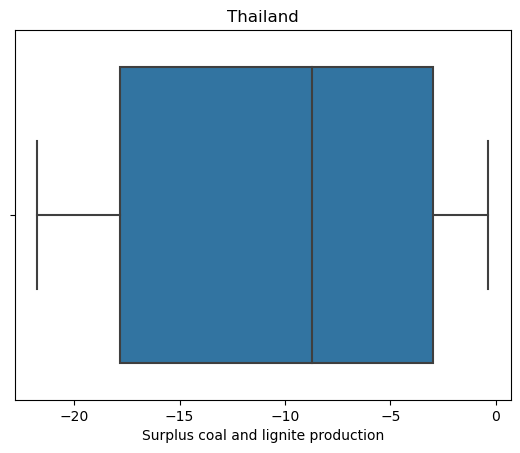

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


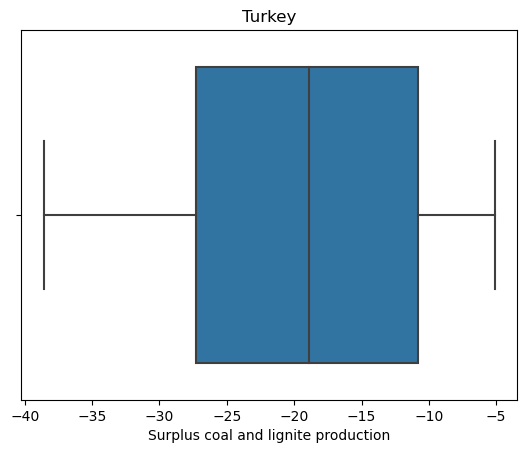

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


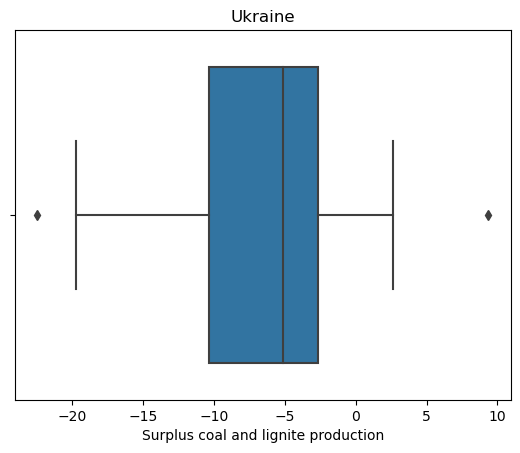

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


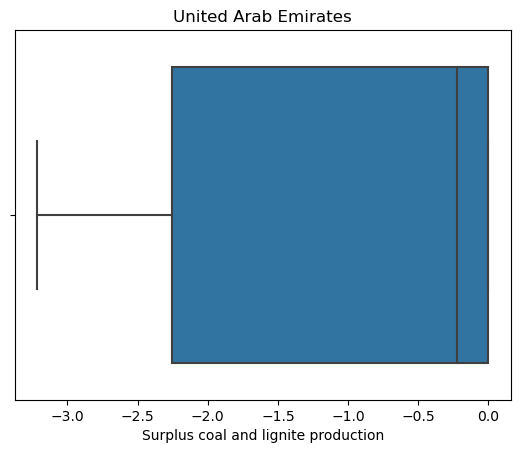

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


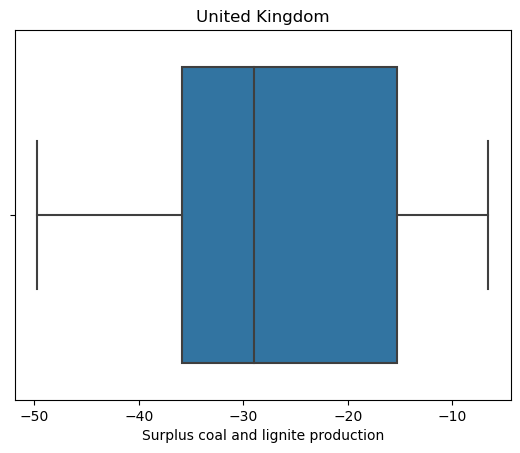

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


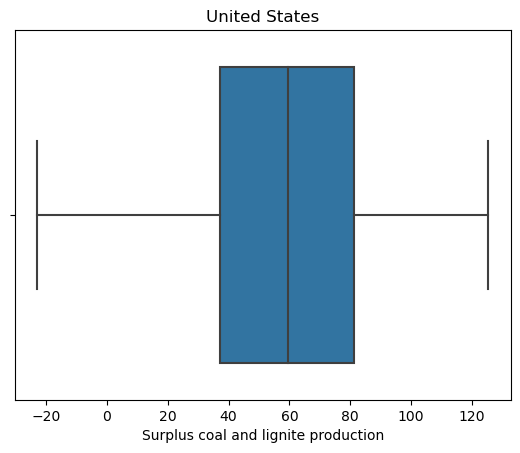

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


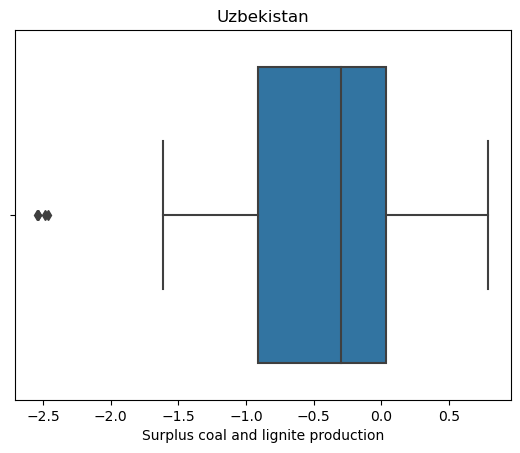

C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


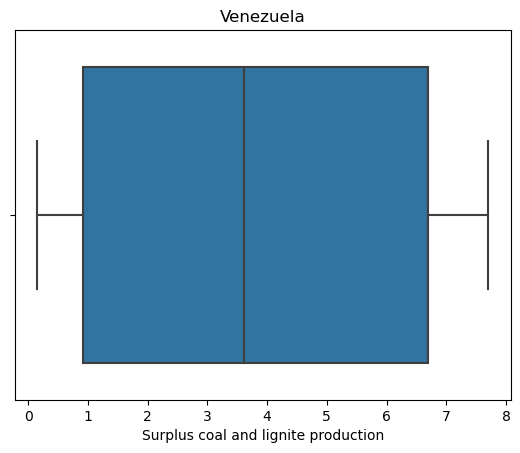

In [45]:
for o in range(len(new_data)):
    sns.boxplot(new_data[o]["Surplus coal and lignite production"])
    plt.title(countries[o])
    plt.show()

In [46]:
from sklearn.impute import SimpleImputer
median= SimpleImputer(strategy= "median")
columns= new_data[0].columns
#print(len(columns))
count=0
for index, m in enumerate(new_data):
    if m.isnull().values.any()==True:
        print(index)
new=[]
median_list=[]
for n in range(len(new_data)):
    x= median.fit_transform(new_data[n])
    median_list.append(median.statistics_)
    x_= pd.DataFrame(x, columns= columns)
    new.append(x_)
print(new[0])


    CO2 emissions from fuel combustion (MtCO2)  \
0                                    52.981921   
1                                    57.149971   
2                                    57.262430   
3                                    59.198702   
4                                    56.347927   
5                                    56.828812   
6                                    56.165721   
7                                    58.074674   
8                                    59.494429   
9                                    63.247065   
10                                   64.229802   
11                                   65.741657   
12                                   71.676793   
13                                   74.895378   
14                                   75.982042   
15                                   80.336165   
16                                   83.440759   
17                                   87.443788   
18                                   91.999054   


In [47]:
from sklearn.preprocessing import MinMaxScaler
minmax= MinMaxScaler()
new_set=[]
for u in range(len(new)):
    scale= minmax.fit_transform(new[u])
    scale_= pd.DataFrame(scale, columns=columns)
    new_set.append(scale_)
print(len(new_set))
print(new_set[0])

44
    CO2 emissions from fuel combustion (MtCO2)  \
0                                     0.000000   
1                                     0.043688   
2                                     0.044866   
3                                     0.065161   
4                                     0.035281   
5                                     0.040321   
6                                     0.033371   
7                                     0.053380   
8                                     0.068261   
9                                     0.107594   
10                                    0.117895   
11                                    0.133742   
12                                    0.195951   
13                                    0.229687   
14                                    0.241077   
15                                    0.286715   
16                                    0.319255   
17                                    0.361213   
18                                    0.408960 

In [48]:
print(new_set[0].info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31 entries, 0 to 30
Data columns (total 13 columns):
 #   Column                                                                    Non-Null Count  Dtype  
---  ------                                                                    --------------  -----  
 0   CO2 emissions from fuel combustion (MtCO2)                                31 non-null     float64
 1   Average CO2 emission factor (tCO2/toe)                                    31 non-null     float64
 2   CO2 intensity at constant purchasing power parities (kCO2/$15p)           31 non-null     float64
 3   Share of renewables in electricity production (%)                         31 non-null     float64
 4   Share of electricity in total final energy consumption (%)                31 non-null     float64
 5   Energy intensity of GDP at constant purchasing power parities (koe/$15p)  31 non-null     float64
 6   Share of wind and solar in electricity production (%)               

In [49]:
from sklearn.model_selection import train_test_split
train_set=[]
test_set=[]
for u in range(len(new_set)):
    train, test= train_test_split(new_set[u], test_size=0.2, random_state= 32)
    train_set.append(train)
    test_set.append(test)
print(len(train_set[0]))
print(len(test_set[0]))
print(len(train_set))
print(len(test_set))

24
7
44
44


In [50]:
import numpy as np
train_set_X= []
train_set_Y=[]
for f in range(len(train_set)):
    train_X= train_set[f].drop("Surplus energy production", axis=1)
    train_Y= train_set[f]["Surplus energy production"]
    train_set_X.append(train_X)
    train_set_Y.append(train_Y)
test_set_X= []
test_set_Y=[]
for g in range(len(test_set)):
    test_X= test_set[g].drop("Surplus energy production", axis=1)
    test_Y= test_set[g]["Surplus energy production"]
    test_set_X.append(test_X)
    test_set_Y.append(test_Y)
print(len(train_set_X))
print(len(train_set_Y))
print(len(test_set_X))
print(len(test_set_Y))
seq_length=1
print(train_set_X[0].shape)
trainX=[]
for i in range(len(train_set_X)):
    arr= train_set_X[i].values
    reshape_arr= arr.reshape(len(train_set_X[i]),seq_length, train_set_X[i].shape[1])
    trainX.append(reshape_arr)
print(trainX[0].shape)
trainY=[]
for j in range(len(train_set_Y)):
    arr= train_set_Y[j].values
    reshape_arr= arr.reshape(len(train_set_Y[j]),seq_length, 1)
    trainY.append(reshape_arr)
print(trainY[0].shape)
testX=[]
for k in range(len(test_set_X)):
    arr= test_set_X[k].values
    reshape_arr= arr.reshape(len(test_set_X[k]),seq_length, test_set_X[k].shape[1])
    testX.append(reshape_arr)
print(testX[0].shape)
testY=[]
for l in range(len(test_set_Y)):
    arr= test_set_Y[l].values
    reshape_arr= arr.reshape(len(test_set_Y[l]),seq_length, 1)
    testY.append(reshape_arr)
print(testY[0].shape)


44
44
44
44
(24, 12)
(24, 1, 12)
(24, 1, 1)
(7, 1, 12)
(7, 1, 1)


In [51]:
# rnn_gru
import tensorflow as tf
from tensorflow import keras
import numpy as np
seq_length=1
pred_values_rnn_gru= []
def rnn_network_gru(data1, data2, data3, data4):
    model= tf.keras.models.Sequential([
        tf.keras.layers.GRU(12,return_sequences= True,unroll= True, input_shape=(1,12)),
        tf.keras.layers.GRU(128, return_sequences= True,unroll=True, dropout= 0.4),
        tf.keras.layers.GRU(64, return_sequences= True, unroll= True),
        tf.keras.layers.GRU(32, return_sequences= True,unroll= True, dropout=0.4),
        tf.keras.layers.Dense(1)
    ])
    model.compile(loss= tf.keras.losses.MeanSquaredError(), optimizer= tf.keras.optimizers.Adam())
    history= model.fit(data1, data2, epochs= 15)
    model.evaluate(data3, data4)
    y_new= model.predict(data3)
    pred_values_rnn_gru.append(y_new)
    return y_new
for s in range(len(train_set_X)):
    rnn= rnn_network_gru(trainX[s], trainY[s], testX[s], testY[s])
print(len(pred_values_rnn_gru))

Epoch 1/15
1/1 [==============================] - 2s 2s/step - loss: 0.2493
Epoch 2/15
1/1 [==============================] - 0s 8ms/step - loss: 0.2376
Epoch 3/15
1/1 [==============================] - 0s 3ms/step - loss: 0.2242
Epoch 4/15
1/1 [==============================] - 0s 0s/step - loss: 0.2116
Epoch 5/15
1/1 [==============================] - 0s 12ms/step - loss: 0.2049
Epoch 6/15
1/1 [==============================] - 0s 3ms/step - loss: 0.1926
Epoch 7/15
1/1 [==============================] - 0s 0s/step - loss: 0.1847
Epoch 8/15
1/1 [==============================] - 0s 19ms/step - loss: 0.1674
Epoch 9/15
1/1 [==============================] - 0s 0s/step - loss: 0.1586
Epoch 10/15
1/1 [==============================] - 0s 15ms/step - loss: 0.1522
Epoch 11/15
1/1 [==============================] - 0s 0s/step - loss: 0.1306
Epoch 12/15
1/1 [==============================] - 0s 15ms/step - loss: 0.1255
Epoch 13/15
1/1 [==============================] - 0s 9ms/step - loss: 0.1

1/1 [==============================] - 0s 5ms/step - loss: 0.1993
Epoch 7/15
1/1 [==============================] - 0s 5ms/step - loss: 0.1827
Epoch 8/15
1/1 [==============================] - 0s 5ms/step - loss: 0.1622
Epoch 9/15
1/1 [==============================] - 0s 9ms/step - loss: 0.1477
Epoch 10/15
1/1 [==============================] - 0s 4ms/step - loss: 0.1392
Epoch 11/15
1/1 [==============================] - 0s 0s/step - loss: 0.1121
Epoch 12/15
1/1 [==============================] - 0s 5ms/step - loss: 0.1030
Epoch 13/15
1/1 [==============================] - 0s 0s/step - loss: 0.0913
Epoch 14/15
1/1 [==============================] - 0s 14ms/step - loss: 0.0676
Epoch 15/15
1/1 [==============================] - 0s 235ms/step
Epoch 1/15
1/1 [==============================] - 2s 2s/step - loss: 0.2467
Epoch 2/15
1/1 [==============================] - 0s 15ms/step - loss: 0.2342
Epoch 3/15
1/1 [==============================] - 0s 11ms/step - loss: 0.2177
Epoch 4/15
1/1 [=

1/1 [==============================] - 0s 5ms/step - loss: 0.2558
Epoch 12/15
1/1 [==============================] - 0s 6ms/step - loss: 0.2564
Epoch 13/15
1/1 [==============================] - 0s 8ms/step - loss: 0.2215
Epoch 14/15
1/1 [==============================] - 0s 3ms/step - loss: 0.1784
Epoch 15/15
1/1 [==============================] - 0s 205ms/step
Epoch 1/15
1/1 [==============================] - 2s 2s/step - loss: 0.2187
Epoch 2/15
1/1 [==============================] - 0s 5ms/step - loss: 0.2063
Epoch 3/15
1/1 [==============================] - 0s 6ms/step - loss: 0.1939
Epoch 4/15
1/1 [==============================] - 0s 0s/step - loss: 0.1771
Epoch 5/15
1/1 [==============================] - 0s 5ms/step - loss: 0.1647
Epoch 6/15
1/1 [==============================] - 0s 0s/step - loss: 0.1523
Epoch 7/15
1/1 [==============================] - 0s 4ms/step - loss: 0.1345
Epoch 8/15
1/1 [==============================] - 0s 7ms/step - loss: 0.1290
Epoch 9/15
1/1 [======

Epoch 1/15
1/1 [==============================] - 2s 2s/step - loss: 0.1778
Epoch 2/15
1/1 [==============================] - 0s 17ms/step - loss: 0.1668
Epoch 3/15
1/1 [==============================] - 0s 0s/step - loss: 0.1566
Epoch 4/15
1/1 [==============================] - 0s 6ms/step - loss: 0.1455
Epoch 5/15
1/1 [==============================] - 0s 6ms/step - loss: 0.1304
Epoch 6/15
1/1 [==============================] - 0s 5ms/step - loss: 0.1178
Epoch 7/15
1/1 [==============================] - 0s 0s/step - loss: 0.1082
Epoch 8/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0971
Epoch 9/15
1/1 [==============================] - 0s 0s/step - loss: 0.0979
Epoch 10/15
1/1 [==============================] - 0s 16ms/step - loss: 0.0858
Epoch 11/15
1/1 [==============================] - 0s 0s/step - loss: 0.0742
Epoch 12/15
1/1 [==============================] - 0s 13ms/step - loss: 0.0720
Epoch 13/15
1/1 [==============================] - 0s 2ms/step - loss: 0.06

1/1 [==============================] - 0s 0s/step - loss: 0.2756
Epoch 8/15
1/1 [==============================] - 0s 16ms/step - loss: 0.2571
Epoch 9/15
1/1 [==============================] - 0s 1ms/step - loss: 0.2445
Epoch 10/15
1/1 [==============================] - 0s 13ms/step - loss: 0.2095
Epoch 11/15
1/1 [==============================] - 0s 7ms/step - loss: 0.1814
Epoch 12/15
1/1 [==============================] - 0s 10ms/step - loss: 0.1661
Epoch 13/15
1/1 [==============================] - 0s 0s/step - loss: 0.1227
Epoch 14/15
1/1 [==============================] - 0s 17ms/step - loss: 0.0933
Epoch 15/15
1/1 [==============================] - 0s 220ms/step
Epoch 1/15
1/1 [==============================] - 2s 2s/step - loss: 0.3983
Epoch 2/15
1/1 [==============================] - 0s 21ms/step - loss: 0.3796
Epoch 3/15
1/1 [==============================] - 0s 11ms/step - loss: 0.3560
Epoch 4/15
1/1 [==============================] - 0s 0s/step - loss: 0.3410
Epoch 5/15
1/1 

1/1 [==============================] - 0s 0s/step - loss: 0.0941
Epoch 14/15
1/1 [==============================] - 0s 7ms/step - loss: 0.0902
Epoch 15/15
1/1 [==============================] - 0s 183ms/step
Epoch 1/15
1/1 [==============================] - 2s 2s/step - loss: 0.4130
Epoch 2/15
1/1 [==============================] - 0s 8ms/step - loss: 0.3924
Epoch 3/15
1/1 [==============================] - 0s 5ms/step - loss: 0.3694
Epoch 4/15
1/1 [==============================] - 0s 11ms/step - loss: 0.3494
Epoch 5/15
1/1 [==============================] - 0s 6ms/step - loss: 0.3227
Epoch 6/15
1/1 [==============================] - 0s 10ms/step - loss: 0.3116
Epoch 7/15
1/1 [==============================] - 0s 0s/step - loss: 0.2791
Epoch 8/15
1/1 [==============================] - 0s 14ms/step - loss: 0.2572
Epoch 9/15
1/1 [==============================] - 0s 727us/step - loss: 0.2216
Epoch 10/15
1/1 [==============================] - 0s 12ms/step - loss: 0.2191
Epoch 11/15
1/1 [

Epoch 3/15
1/1 [==============================] - 0s 7ms/step - loss: 0.2900
Epoch 4/15
1/1 [==============================] - 0s 9ms/step - loss: 0.2775
Epoch 5/15
1/1 [==============================] - 0s 6ms/step - loss: 0.2612
Epoch 6/15
1/1 [==============================] - 0s 8ms/step - loss: 0.2511
Epoch 7/15
1/1 [==============================] - 0s 6ms/step - loss: 0.2371
Epoch 8/15
1/1 [==============================] - 0s 5ms/step - loss: 0.2211
Epoch 9/15
1/1 [==============================] - 0s 6ms/step - loss: 0.2116
Epoch 10/15
1/1 [==============================] - 0s 6ms/step - loss: 0.1903
Epoch 11/15
1/1 [==============================] - 0s 5ms/step - loss: 0.1808
Epoch 12/15
1/1 [==============================] - 0s 1ms/step - loss: 0.1686
Epoch 13/15
1/1 [==============================] - 0s 8ms/step - loss: 0.1472
Epoch 14/15
1/1 [==============================] - 0s 8ms/step - loss: 0.1371
Epoch 15/15
1/1 [==============================] - 0s 189ms/step
Epoch 

1/1 [==============================] - 0s 6ms/step - loss: 0.2414
Epoch 10/15
1/1 [==============================] - 0s 6ms/step - loss: 0.2067
Epoch 11/15
1/1 [==============================] - 0s 3ms/step - loss: 0.1893
Epoch 12/15
1/1 [==============================] - 0s 8ms/step - loss: 0.1577
Epoch 13/15
1/1 [==============================] - 0s 6ms/step - loss: 0.1417
Epoch 14/15
1/1 [==============================] - 0s 9ms/step - loss: 0.1047
Epoch 15/15
1/1 [==============================] - 0s 242ms/step
Epoch 1/15
1/1 [==============================] - 2s 2s/step - loss: 0.5334
Epoch 2/15
1/1 [==============================] - 0s 16ms/step - loss: 0.5097
Epoch 3/15
1/1 [==============================] - 0s 0s/step - loss: 0.4854
Epoch 4/15
1/1 [==============================] - 0s 0s/step - loss: 0.4612
Epoch 5/15
1/1 [==============================] - 0s 1ms/step - loss: 0.4269
Epoch 6/15
1/1 [==============================] - 0s 0s/step - loss: 0.4100
Epoch 7/15
1/1 [====

In [52]:
print(len(pred_values_rnn_gru))
pred_gru=[]
for u in range(len(pred_values_rnn_gru)):
    arr= pred_values_rnn_gru[u].reshape(len(pred_values_rnn_gru[u]))
    pred_gru.append(arr)
print(pred_gru[0].shape)
testY_reshape=[]
for y in range(len(testY)):
    arr= testY[y].reshape(len(testY[0]))
    testY_reshape.append(arr)
from sklearn.metrics import mean_absolute_error
gru_mae=[]
for r in range(len(pred_gru)):
    mae= mean_absolute_error(testY_reshape[r],pred_gru[r])
    gru_mae.append(mae)
print(len(gru_mae))
print(gru_mae)

44
(7,)
44
[0.25568387952675337, 0.3488307865677673, 0.21101166239389707, 0.2825869833536288, 0.1023838143558375, 0.1858749272169191, 0.1937338236491017, 0.46670943113020485, 0.2171091927587519, 0.07566200293472902, 0.3429880598193765, 0.18280874223540058, 0.27577780121360557, 0.332387120223188, 0.284782526862181, 0.45257028284084033, 0.2837396883283069, 0.20004487653685255, 0.31624972261707324, 0.32875532671015123, 0.30600083837572517, 0.3292689133185875, 0.22442543185257163, 0.21337766446962775, 0.2078223880326709, 0.477103525145616, 0.365989303810298, 0.32709919420761835, 0.2773786395905562, 0.16216385447377268, 0.30886325597101366, 0.27499702864133113, 0.23624968047306724, 0.2566117687849513, 0.25411792438468966, 0.2592756146708164, 0.27274889129646873, 0.3403799720787113, 0.3131429465589091, 0.26477433506674725, 0.21000980392064722, 0.19833587692304863, 0.20646355512813025, 0.23994891819594177]


In [53]:
#rnn_lstm
seq_length=1
pred_values_lstm= []
def rnn_network_lstm(data1, data2, data3, data4):
    model= tf.keras.models.Sequential([
        tf.keras.layers.LSTM(12,return_sequences= True, unroll= True, input_shape=(1,12)),
        tf.keras.layers.LSTM(128, return_sequences= True, unroll=True, dropout= 0.4),
        tf.keras.layers.LSTM(64, return_sequences= True, unroll= True),
        tf.keras.layers.LSTM(32, return_sequences= True, unroll= True, dropout=0.4),
        tf.keras.layers.Dense(1)
    ])
    model.compile(loss= tf.keras.losses.MeanSquaredError(), optimizer= tf.keras.optimizers.Adam())
    history= model.fit(data1, data2, epochs= 15)
    model.evaluate(data3, data4)
    y_new= model.predict(data3)
    pred_values_lstm.append(y_new)
    return y_new
for s in range(len(train_set_X)):
    lstm= rnn_network_lstm(trainX[s], trainY[s], testX[s], testY[s])


Epoch 1/15
1/1 [==============================] - 2s 2s/step - loss: 0.2503
Epoch 2/15
1/1 [==============================] - 0s 16ms/step - loss: 0.2474
Epoch 3/15
1/1 [==============================] - 0s 6ms/step - loss: 0.2444
Epoch 4/15
1/1 [==============================] - 0s 9ms/step - loss: 0.2411
Epoch 5/15
1/1 [==============================] - 0s 7ms/step - loss: 0.2381
Epoch 6/15
1/1 [==============================] - 0s 8ms/step - loss: 0.2349
Epoch 7/15
1/1 [==============================] - 0s 0s/step - loss: 0.2317
Epoch 8/15
1/1 [==============================] - 0s 2ms/step - loss: 0.2289
Epoch 9/15
1/1 [==============================] - 0s 9ms/step - loss: 0.2251
Epoch 10/15
1/1 [==============================] - 0s 0s/step - loss: 0.2221
Epoch 11/15
1/1 [==============================] - 0s 16ms/step - loss: 0.2179
Epoch 12/15
1/1 [==============================] - 0s 0s/step - loss: 0.2133
Epoch 13/15
1/1 [==============================] - 0s 0s/step - loss: 0.209

1/1 [==============================] - 0s 16ms/step - loss: 0.2361
Epoch 8/15
1/1 [==============================] - 0s 0s/step - loss: 0.2334
Epoch 9/15
1/1 [==============================] - 0s 11ms/step - loss: 0.2303
Epoch 10/15
1/1 [==============================] - 0s 16ms/step - loss: 0.2263
Epoch 11/15
1/1 [==============================] - 0s 0s/step - loss: 0.2231
Epoch 12/15
1/1 [==============================] - 0s 18ms/step - loss: 0.2198
Epoch 13/15
1/1 [==============================] - 0s 13ms/step - loss: 0.2164
Epoch 14/15
1/1 [==============================] - 0s 0s/step - loss: 0.2115
Epoch 15/15
1/1 [==============================] - 0s 251ms/step
Epoch 1/15
1/1 [==============================] - 2s 2s/step - loss: 0.5110
Epoch 2/15
1/1 [==============================] - 0s 0s/step - loss: 0.5060
Epoch 3/15
1/1 [==============================] - 0s 0s/step - loss: 0.5011
Epoch 4/15
1/1 [==============================] - 0s 16ms/step - loss: 0.4958
Epoch 5/15
1/1 [=

1/1 [==============================] - 0s 15ms/step - loss: 0.1724
Epoch 14/15
1/1 [==============================] - 0s 0s/step - loss: 0.1683
Epoch 15/15
1/1 [==============================] - 0s 235ms/step
Epoch 1/15
1/1 [==============================] - 2s 2s/step - loss: 0.4608
Epoch 2/15
1/1 [==============================] - 0s 7ms/step - loss: 0.4561
Epoch 3/15
1/1 [==============================] - 0s 7ms/step - loss: 0.4516
Epoch 4/15
1/1 [==============================] - 0s 7ms/step - loss: 0.4470
Epoch 5/15
1/1 [==============================] - 0s 6ms/step - loss: 0.4426
Epoch 6/15
1/1 [==============================] - 0s 6ms/step - loss: 0.4381
Epoch 7/15
1/1 [==============================] - 0s 7ms/step - loss: 0.4332
Epoch 8/15
1/1 [==============================] - 0s 7ms/step - loss: 0.4282
Epoch 9/15
1/1 [==============================] - 0s 7ms/step - loss: 0.4228
Epoch 10/15
1/1 [==============================] - 0s 7ms/step - loss: 0.4170
Epoch 11/15
1/1 [====

1/1 [==============================] - 0s 11ms/step - loss: 0.5766
Epoch 3/15
1/1 [==============================] - 0s 8ms/step - loss: 0.5718
Epoch 4/15
1/1 [==============================] - 0s 9ms/step - loss: 0.5670
Epoch 5/15
1/1 [==============================] - 0s 0s/step - loss: 0.5620
Epoch 6/15
1/1 [==============================] - 0s 15ms/step - loss: 0.5569
Epoch 7/15
1/1 [==============================] - 0s 16ms/step - loss: 0.5514
Epoch 8/15
1/1 [==============================] - 0s 10ms/step - loss: 0.5467
Epoch 9/15
1/1 [==============================] - 0s 7ms/step - loss: 0.5407
Epoch 10/15
1/1 [==============================] - 0s 16ms/step - loss: 0.5348
Epoch 11/15
1/1 [==============================] - 0s 0s/step - loss: 0.5278
Epoch 12/15
1/1 [==============================] - 0s 16ms/step - loss: 0.5227
Epoch 13/15
1/1 [==============================] - 0s 0s/step - loss: 0.5148
Epoch 14/15
1/1 [==============================] - 0s 16ms/step - loss: 0.5082
E

1/1 [==============================] - 0s 7ms/step - loss: 0.4365
Epoch 9/15
1/1 [==============================] - 0s 7ms/step - loss: 0.4296
Epoch 10/15
1/1 [==============================] - 0s 8ms/step - loss: 0.4230
Epoch 11/15
1/1 [==============================] - 0s 7ms/step - loss: 0.4150
Epoch 12/15
1/1 [==============================] - 0s 7ms/step - loss: 0.4053
Epoch 13/15
1/1 [==============================] - 0s 8ms/step - loss: 0.3971
Epoch 14/15
1/1 [==============================] - 0s 7ms/step - loss: 0.3901
Epoch 15/15
1/1 [==============================] - 0s 236ms/step
Epoch 1/15
1/1 [==============================] - 2s 2s/step - loss: 0.4028
Epoch 2/15
1/1 [==============================] - 0s 8ms/step - loss: 0.3992
Epoch 3/15
1/1 [==============================] - 0s 8ms/step - loss: 0.3956
Epoch 4/15
1/1 [==============================] - 0s 7ms/step - loss: 0.3920
Epoch 5/15
1/1 [==============================] - 0s 8ms/step - loss: 0.3882
Epoch 6/15
1/1 [==

1/1 [==============================] - 0s 12ms/step - loss: 0.3032
Epoch 15/15
1/1 [==============================] - 0s 250ms/step
Epoch 1/15
1/1 [==============================] - 2s 2s/step - loss: 0.2333
Epoch 2/15
1/1 [==============================] - 0s 11ms/step - loss: 0.2304
Epoch 3/15
1/1 [==============================] - 0s 9ms/step - loss: 0.2272
Epoch 4/15
1/1 [==============================] - 0s 7ms/step - loss: 0.2239
Epoch 5/15
1/1 [==============================] - 0s 8ms/step - loss: 0.2207
Epoch 6/15
1/1 [==============================] - 0s 13ms/step - loss: 0.2173
Epoch 7/15
1/1 [==============================] - 0s 7ms/step - loss: 0.2137
Epoch 8/15
1/1 [==============================] - 0s 7ms/step - loss: 0.2098
Epoch 9/15
1/1 [==============================] - 0s 7ms/step - loss: 0.2069
Epoch 10/15
1/1 [==============================] - 0s 7ms/step - loss: 0.2023
Epoch 11/15
1/1 [==============================] - 0s 8ms/step - loss: 0.1978
Epoch 12/15
1/1 [=

Epoch 4/15
1/1 [==============================] - 0s 11ms/step - loss: 0.5742
Epoch 5/15
1/1 [==============================] - 0s 0s/step - loss: 0.5684
Epoch 6/15
1/1 [==============================] - 0s 12ms/step - loss: 0.5625
Epoch 7/15
1/1 [==============================] - 0s 17ms/step - loss: 0.5565
Epoch 8/15
1/1 [==============================] - 0s 7ms/step - loss: 0.5504
Epoch 9/15
1/1 [==============================] - 0s 8ms/step - loss: 0.5429
Epoch 10/15
1/1 [==============================] - 0s 6ms/step - loss: 0.5368
Epoch 11/15
1/1 [==============================] - 0s 7ms/step - loss: 0.5299
Epoch 12/15
1/1 [==============================] - 0s 7ms/step - loss: 0.5216
Epoch 13/15
1/1 [==============================] - 0s 7ms/step - loss: 0.5145
Epoch 14/15
1/1 [==============================] - 0s 6ms/step - loss: 0.5055
Epoch 15/15
1/1 [==============================] - 0s 226ms/step
Epoch 1/15
1/1 [==============================] - 2s 2s/step - loss: 0.3601
Epoch

In [54]:
print(len(pred_values_lstm))
pred_lstm=[]
for u in range(len(pred_values_lstm)):
    arr= pred_values_lstm[u].reshape(len(pred_values_lstm[u]))
    pred_lstm.append(arr)
print(pred_lstm[0].shape)
from sklearn.metrics import mean_absolute_error
lstm_mae=[]
for r in range(len(pred_lstm)):
    mae= mean_absolute_error(testY_reshape[r],pred_lstm[r])
    lstm_mae.append(mae)
print(len(lstm_mae))
print(lstm_mae)

44
(7,)
44
[0.44225840709607406, 0.498242490426824, 0.3160892417224043, 0.2795206701516385, 0.2819051027808043, 0.394695613857392, 0.3817420680741931, 0.5983544208931922, 0.3637487992072637, 0.3736223884085766, 0.5233809164403274, 0.27542948775783094, 0.28559083025148896, 0.5741591813779562, 0.23820361364788528, 0.7394428948871843, 0.3466014301697675, 0.2250001701518952, 0.44938235637558943, 0.6227569325649814, 0.6444509405788895, 0.6176852913635891, 0.513309573065852, 0.4674803159501279, 0.3903509892073332, 0.6713840154248137, 0.5564696746731163, 0.42283192276742515, 0.5638580435206072, 0.4053163759753811, 0.49922457786530766, 0.5805986307954498, 0.3702854817219583, 0.3940445647760362, 0.2717558936675049, 0.3252854399513167, 0.403538155268683, 0.5060722278319333, 0.5978590060539889, 0.463714312865929, 0.48819538723963707, 0.26151759196758034, 0.4961713573642105, 0.6133067963955872]


In [55]:
# simple rnn
seq_length=1
pred_values_simple_rnn= []
def rnn_network_simple_rnn(data1, data2, data3, data4):
    model= tf.keras.models.Sequential([
        tf.keras.layers.SimpleRNN(12,return_sequences= True, unroll= True, input_shape=(1,12)),
        tf.keras.layers.SimpleRNN(128, return_sequences= True, unroll=True, dropout= 0.4),
        tf.keras.layers.SimpleRNN(64, return_sequences= True, unroll= True),
        tf.keras.layers.SimpleRNN(32, return_sequences= True, unroll= True, dropout=0.4),
        tf.keras.layers.Dense(1)
    ])
    model.compile(loss= tf.keras.losses.MeanSquaredError(), optimizer= tf.keras.optimizers.Adam())
    history= model.fit(data1, data2, epochs= 15)
    model.evaluate(data3, data4)
    y_new= model.predict(data3)
    pred_values_simple_rnn.append(y_new)
    return y_new
for s in range(len(train_set_X)):
    simple_rnn= rnn_network_simple_rnn(trainX[s], trainY[s], testX[s], testY[s])


Epoch 1/15
1/1 [==============================] - 1s 1s/step - loss: 0.3447
Epoch 2/15
1/1 [==============================] - 0s 11ms/step - loss: 0.2501
Epoch 3/15
1/1 [==============================] - 0s 1000us/step - loss: 0.1937
Epoch 4/15
1/1 [==============================] - 0s 16ms/step - loss: 0.1715
Epoch 5/15
1/1 [==============================] - 0s 0s/step - loss: 0.1886
Epoch 6/15
1/1 [==============================] - 0s 15ms/step - loss: 0.2562
Epoch 7/15
1/1 [==============================] - 0s 5ms/step - loss: 0.1449
Epoch 8/15
1/1 [==============================] - 0s 6ms/step - loss: 0.1543
Epoch 9/15
1/1 [==============================] - 0s 7ms/step - loss: 0.1012
Epoch 10/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0910
Epoch 11/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0838
Epoch 12/15
1/1 [==============================] - 0s 4ms/step - loss: 0.1207
Epoch 13/15
1/1 [==============================] - 0s 5ms/step - loss

1/1 [==============================] - 0s 5ms/step - loss: 0.2167
Epoch 8/15
1/1 [==============================] - 0s 6ms/step - loss: 0.1104
Epoch 9/15
1/1 [==============================] - 0s 4ms/step - loss: 0.1050
Epoch 10/15
1/1 [==============================] - 0s 6ms/step - loss: 0.0605
Epoch 11/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0826
Epoch 12/15
1/1 [==============================] - 0s 6ms/step - loss: 0.0960
Epoch 13/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0696
Epoch 14/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0554
Epoch 15/15
1/1 [==============================] - 0s 198ms/step
Epoch 1/15
1/1 [==============================] - 1s 1s/step - loss: 0.8175
Epoch 2/15
1/1 [==============================] - 0s 0s/step - loss: 0.7171
Epoch 3/15
1/1 [==============================] - 0s 17ms/step - loss: 0.4050
Epoch 4/15
1/1 [==============================] - 0s 3ms/step - loss: 0.2109
Epoch 5/15
1/1 [==

1/1 [==============================] - 0s 5ms/step - loss: 0.0819
Epoch 14/15
1/1 [==============================] - 0s 7ms/step - loss: 0.0843
Epoch 15/15
1/1 [==============================] - 0s 134ms/step
Epoch 1/15
1/1 [==============================] - 2s 2s/step - loss: 0.4516
Epoch 2/15
1/1 [==============================] - 0s 607us/step - loss: 0.4213
Epoch 3/15
1/1 [==============================] - 0s 15ms/step - loss: 0.1406
Epoch 4/15
1/1 [==============================] - 0s 3ms/step - loss: 0.1688
Epoch 5/15
1/1 [==============================] - 0s 11ms/step - loss: 0.1782
Epoch 6/15
1/1 [==============================] - 0s 0s/step - loss: 0.2367
Epoch 7/15
1/1 [==============================] - 0s 11ms/step - loss: 0.1227
Epoch 8/15
1/1 [==============================] - 0s 2ms/step - loss: 0.2428
Epoch 9/15
1/1 [==============================] - 0s 9ms/step - loss: 0.2006
Epoch 10/15
1/1 [==============================] - 0s 7ms/step - loss: 0.1195
Epoch 11/15
1/1 [

1/1 [==============================] - 0s 6ms/step - loss: 0.5201
Epoch 4/15
1/1 [==============================] - 0s 5ms/step - loss: 0.2593
Epoch 5/15
1/1 [==============================] - 0s 6ms/step - loss: 0.3211
Epoch 6/15
1/1 [==============================] - 0s 5ms/step - loss: 0.1350
Epoch 7/15
1/1 [==============================] - 0s 6ms/step - loss: 0.1592
Epoch 8/15
1/1 [==============================] - 0s 5ms/step - loss: 0.1650
Epoch 9/15
1/1 [==============================] - 0s 7ms/step - loss: 0.2574
Epoch 10/15
1/1 [==============================] - 0s 4ms/step - loss: 0.1461
Epoch 11/15
1/1 [==============================] - 0s 5ms/step - loss: 0.1925
Epoch 12/15
1/1 [==============================] - 0s 5ms/step - loss: 0.2891
Epoch 13/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0770
Epoch 14/15
1/1 [==============================] - 0s 6ms/step - loss: 0.1352
Epoch 15/15
1/1 [==============================] - 0s 183ms/step
Epoch 1/15
1/1 [=

1/1 [==============================] - 0s 0s/step - loss: 0.1521
Epoch 10/15
1/1 [==============================] - 0s 16ms/step - loss: 0.1715
Epoch 11/15
1/1 [==============================] - 0s 9ms/step - loss: 0.1389
Epoch 12/15
1/1 [==============================] - 0s 8ms/step - loss: 0.1200
Epoch 13/15
1/1 [==============================] - 0s 6ms/step - loss: 0.0742
Epoch 14/15
1/1 [==============================] - 0s 10ms/step - loss: 0.1037
Epoch 15/15
1/1 [==============================] - 0s 141ms/step
Epoch 1/15
1/1 [==============================] - 2s 2s/step - loss: 0.4993
Epoch 2/15
1/1 [==============================] - 0s 0s/step - loss: 0.2762
Epoch 3/15
1/1 [==============================] - 0s 15ms/step - loss: 0.1477
Epoch 4/15
1/1 [==============================] - 0s 16ms/step - loss: 0.1463
Epoch 5/15
1/1 [==============================] - 0s 0s/step - loss: 0.1874
Epoch 6/15
1/1 [==============================] - 0s 0s/step - loss: 0.2136
Epoch 7/15
1/1 [==

1/1 [==============================] - 0s 141ms/step
Epoch 1/15
1/1 [==============================] - 1s 1s/step - loss: 0.4791
Epoch 2/15
1/1 [==============================] - 0s 0s/step - loss: 0.2912
Epoch 3/15
1/1 [==============================] - 0s 18ms/step - loss: 0.1825
Epoch 4/15
1/1 [==============================] - 0s 6ms/step - loss: 0.1959
Epoch 5/15
1/1 [==============================] - 0s 9ms/step - loss: 0.1223
Epoch 6/15
1/1 [==============================] - 0s 15ms/step - loss: 0.1969
Epoch 7/15
1/1 [==============================] - 0s 0s/step - loss: 0.1021
Epoch 8/15
1/1 [==============================] - 0s 0s/step - loss: 0.1636
Epoch 9/15
1/1 [==============================] - 0s 16ms/step - loss: 0.2138
Epoch 10/15
1/1 [==============================] - 0s 16ms/step - loss: 0.1057
Epoch 11/15
1/1 [==============================] - 0s 16ms/step - loss: 0.0889
Epoch 12/15
1/1 [==============================] - 0s 16ms/step - loss: 0.0884
Epoch 13/15
1/1 [=

1/1 [==============================] - 0s 16ms/step - loss: 0.3958
Epoch 6/15
1/1 [==============================] - 0s 16ms/step - loss: 0.1775
Epoch 7/15
1/1 [==============================] - 0s 0s/step - loss: 0.2631
Epoch 8/15
1/1 [==============================] - 0s 16ms/step - loss: 0.1784
Epoch 9/15
1/1 [==============================] - 0s 12ms/step - loss: 0.2705
Epoch 10/15
1/1 [==============================] - 0s 10ms/step - loss: 0.1745
Epoch 11/15
1/1 [==============================] - 0s 6ms/step - loss: 0.1409
Epoch 12/15
1/1 [==============================] - 0s 0s/step - loss: 0.1131
Epoch 13/15
1/1 [==============================] - 0s 7ms/step - loss: 0.1871
Epoch 14/15
1/1 [==============================] - 0s 10ms/step - loss: 0.1482
Epoch 15/15
1/1 [==============================] - 0s 173ms/step
Epoch 1/15
1/1 [==============================] - 1s 1s/step - loss: 0.3811
Epoch 2/15
1/1 [==============================] - 0s 8ms/step - loss: 0.1049
Epoch 3/15
1/1

In [56]:
print(len(pred_values_simple_rnn))
pred_simple_rnn=[]
for u in range(len(pred_values_simple_rnn)):
    arr= pred_values_simple_rnn[u].reshape(len(pred_values_simple_rnn[u]))
    pred_simple_rnn.append(arr)
print(pred_simple_rnn[0].shape)
from sklearn.metrics import mean_absolute_error
simple_rnn_mae=[]
for r in range(len(pred_simple_rnn)):
    mae= mean_absolute_error(testY_reshape[r],pred_simple_rnn[r])
    simple_rnn_mae.append(mae)
print(len(simple_rnn_mae))
print(simple_rnn_mae)

44
(7,)
44
[0.11901005972085879, 0.18155730619163726, 0.18731568443409824, 0.17052161830350718, 0.13271120607390183, 0.11158080186084793, 0.08860830849087199, 0.15389032116668572, 0.27322292539685583, 0.06390561019917691, 0.09823380504575177, 0.11858639523245307, 0.2680002763676649, 0.22857974453081426, 0.2293860494208806, 0.2201892796495491, 0.16401473193317445, 0.15602322409577057, 0.0567423786158273, 0.128238760140765, 0.2386470200875813, 0.10422753312600198, 0.08294606268434919, 0.17283361013171752, 0.2009659355003154, 0.22732444124652665, 0.10740190962454418, 0.13647223095821362, 0.15125466790164058, 0.1462559333965949, 0.17826485490411473, 0.1529428540505566, 0.19437738987965772, 0.26994927235156474, 0.21635141456225293, 0.08138127679682852, 0.11774054071853472, 0.06673101314975873, 0.12698621357487658, 0.15152591765624535, 0.08694926721812338, 0.07211080186532692, 0.05289409096023253, 0.15252025828476742]


In [57]:
# convolutional network
pred_values_cnn=[]
def cnn_network(data1, data2, data3, data4):
    cnn_model= tf.keras.models.Sequential([
        tf.keras.layers.Conv1D(12, kernel_size= 1, strides=1, dilation_rate= 10, padding= "same", input_shape= (None,12)),
        tf.keras.layers.Dense(100),
        tf.keras.layers.Dense(64),
        tf.keras.layers.Dense(32),
        tf.keras.layers.Dense(1)
    ])
    cnn_model.compile(loss= tf.keras.losses.MeanSquaredError(), optimizer= tf.keras.optimizers.Adam())
    history= cnn_model.fit(data1, data2, epochs= 15)
    cnn_model.evaluate(data3, data4)
    y_new= cnn_model.predict(data3)
    pred_values_cnn.append(y_new)
    return y_new
for s in range(len(train_set_X)):
    cnn= cnn_network(trainX[s], trainY[s], testX[s], testY[s])


Epoch 1/15
1/1 [==============================] - 1s 1s/step - loss: 0.4325
Epoch 2/15
1/1 [==============================] - 0s 16ms/step - loss: 0.1401
Epoch 3/15
1/1 [==============================] - 0s 0s/step - loss: 0.0705
Epoch 4/15
1/1 [==============================] - 0s 0s/step - loss: 0.1197
Epoch 5/15
1/1 [==============================] - 0s 16ms/step - loss: 0.1500
Epoch 6/15
1/1 [==============================] - 0s 10ms/step - loss: 0.1242
Epoch 7/15
1/1 [==============================] - 0s 0s/step - loss: 0.0726
Epoch 8/15
1/1 [==============================] - 0s 16ms/step - loss: 0.0287
Epoch 9/15
1/1 [==============================] - 0s 0s/step - loss: 0.0097
Epoch 10/15
1/1 [==============================] - 0s 16ms/step - loss: 0.0150
Epoch 11/15
1/1 [==============================] - 0s 0s/step - loss: 0.0315
Epoch 12/15
1/1 [==============================] - 0s 16ms/step - loss: 0.0443
Epoch 13/15
1/1 [==============================] - 0s 0s/step - loss: 0.0

1/1 [==============================] - 0s 7ms/step - loss: 0.0110
Epoch 8/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0207
Epoch 9/15
1/1 [==============================] - 0s 6ms/step - loss: 0.0333
Epoch 10/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0352
Epoch 11/15
1/1 [==============================] - 0s 7ms/step - loss: 0.0293
Epoch 12/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0249
Epoch 13/15
1/1 [==============================] - 0s 4ms/step - loss: 0.0260
Epoch 14/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0288
Epoch 15/15
1/1 [==============================] - 0s 175ms/step
Epoch 1/15
1/1 [==============================] - 1s 853ms/step - loss: 1.0148
Epoch 2/15
1/1 [==============================] - 0s 8ms/step - loss: 0.4589
Epoch 3/15
1/1 [==============================] - 0s 7ms/step - loss: 0.2511
Epoch 4/15
1/1 [==============================] - 0s 4ms/step - loss: 0.2576
Epoch 5/15
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 0.0159
Epoch 14/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0175
Epoch 15/15
1/1 [==============================] - 0s 159ms/step
Epoch 1/15
1/1 [==============================] - 1s 850ms/step - loss: 0.9103
Epoch 2/15
1/1 [==============================] - 0s 4ms/step - loss: 0.2212
Epoch 3/15
1/1 [==============================] - 0s 6ms/step - loss: 0.0583
Epoch 4/15
1/1 [==============================] - 0s 6ms/step - loss: 0.1961
Epoch 5/15
1/1 [==============================] - 0s 5ms/step - loss: 0.2855
Epoch 6/15
1/1 [==============================] - 0s 6ms/step - loss: 0.2335
Epoch 7/15
1/1 [==============================] - 0s 7ms/step - loss: 0.1239
Epoch 8/15
1/1 [==============================] - 0s 7ms/step - loss: 0.0422
Epoch 9/15
1/1 [==============================] - 0s 6ms/step - loss: 0.0238
Epoch 10/15
1/1 [==============================] - 0s 8ms/step - loss: 0.0553
Epoch 11/15
1/1 [=

1/1 [==============================] - 0s 9ms/step - loss: 0.0819
Epoch 3/15
1/1 [==============================] - 0s 6ms/step - loss: 0.0365
Epoch 4/15
1/1 [==============================] - 0s 5ms/step - loss: 0.1039
Epoch 5/15
1/1 [==============================] - 0s 5ms/step - loss: 0.1324
Epoch 6/15
1/1 [==============================] - 0s 5ms/step - loss: 0.1015
Epoch 7/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0539
Epoch 8/15
1/1 [==============================] - 0s 7ms/step - loss: 0.0227
Epoch 9/15
1/1 [==============================] - 0s 8ms/step - loss: 0.0181
Epoch 10/15
1/1 [==============================] - 0s 7ms/step - loss: 0.0312
Epoch 11/15
1/1 [==============================] - 0s 8ms/step - loss: 0.0464
Epoch 12/15
1/1 [==============================] - 0s 8ms/step - loss: 0.0522
Epoch 13/15
1/1 [==============================] - 0s 8ms/step - loss: 0.0464
Epoch 14/15
1/1 [==============================] - 0s 6ms/step - loss: 0.0334
Epoch

1/1 [==============================] - 0s 5ms/step - loss: 0.0291
Epoch 9/15
1/1 [==============================] - 0s 7ms/step - loss: 0.0308
Epoch 10/15
1/1 [==============================] - 0s 7ms/step - loss: 0.0500
Epoch 11/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0657
Epoch 12/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0659
Epoch 13/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0519
Epoch 14/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0329
Epoch 15/15
1/1 [==============================] - 0s 151ms/step
Epoch 1/15
1/1 [==============================] - 1s 1s/step - loss: 0.7881
Epoch 2/15
1/1 [==============================] - 0s 6ms/step - loss: 0.1745
Epoch 3/15
1/1 [==============================] - 0s 7ms/step - loss: 0.0301
Epoch 4/15
1/1 [==============================] - 0s 7ms/step - loss: 0.1679
Epoch 5/15
1/1 [==============================] - 0s 5ms/step - loss: 0.2737
Epoch 6/15
1/1 [==

1/1 [==============================] - 0s 8ms/step - loss: 0.0574
Epoch 15/15
1/1 [==============================] - 0s 151ms/step
Epoch 1/15
1/1 [==============================] - 1s 1s/step - loss: 0.1579
Epoch 2/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0964
Epoch 3/15
1/1 [==============================] - 0s 0s/step - loss: 0.0504
Epoch 4/15
1/1 [==============================] - 0s 6ms/step - loss: 0.0301
Epoch 5/15
1/1 [==============================] - 0s 0s/step - loss: 0.0242
Epoch 6/15
1/1 [==============================] - 0s 14ms/step - loss: 0.0223
Epoch 7/15
1/1 [==============================] - 0s 389us/step - loss: 0.0287
Epoch 8/15
1/1 [==============================] - 0s 11ms/step - loss: 0.0309
Epoch 9/15
1/1 [==============================] - 0s 6ms/step - loss: 0.0285
Epoch 10/15
1/1 [==============================] - 0s 0s/step - loss: 0.0262
Epoch 11/15
1/1 [==============================] - 0s 13ms/step - loss: 0.0217
Epoch 12/15
1/1 [==

1/1 [==============================] - 0s 0s/step - loss: 0.1165
Epoch 5/15
1/1 [==============================] - 0s 16ms/step - loss: 0.1725
Epoch 6/15
1/1 [==============================] - 0s 0s/step - loss: 0.1830
Epoch 7/15
1/1 [==============================] - 0s 16ms/step - loss: 0.1440
Epoch 8/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0896
Epoch 9/15
1/1 [==============================] - 0s 0s/step - loss: 0.0502
Epoch 10/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0391
Epoch 11/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0513
Epoch 12/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0706
Epoch 13/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0816
Epoch 14/15
1/1 [==============================] - 0s 6ms/step - loss: 0.0779
Epoch 15/15
1/1 [==============================] - 0s 132ms/step
Epoch 1/15
1/1 [==============================] - 1s 1s/step - loss: 0.1532
Epoch 2/15
1/1 [===

In [58]:
print(len(pred_values_cnn))
pred_cnn=[]
for u in range(len(pred_values_cnn)):
    arr= pred_values_cnn[u].reshape(len(pred_values_cnn[u]))
    pred_cnn.append(arr)
print(pred_cnn[0].shape)
from sklearn.metrics import mean_absolute_error
cnn_mae=[]
for r in range(len(pred_cnn)):
    mae= mean_absolute_error(testY_reshape[r],pred_cnn[r])
    cnn_mae.append(mae)
print(len(cnn_mae))
print(cnn_mae)

44
(7,)
44
[0.14672201383515066, 0.19621306016178344, 0.10064375907864846, 0.1785189890775803, 0.12620499746008504, 0.0645498049710725, 0.08389713198736659, 0.28753309238320085, 0.05200881019446639, 0.2181111222727262, 0.1479350359123202, 0.1495000341415544, 0.14199792049995347, 0.11571114999292605, 0.14736556911765072, 0.20231029450800464, 0.19244388938303197, 0.15424484782831366, 0.19973940123631004, 0.07212650493017618, 0.06488918477312307, 0.17780264464965095, 0.07688000693843089, 0.14092842053228766, 0.21536464537650926, 0.11305583826861056, 0.1581564077827266, 0.22173416821846686, 0.18292646655660555, 0.1074381744566411, 0.2562599792584598, 0.10719046131102868, 0.08735589926613381, 0.06972274367295499, 0.12723794799318972, 0.06712906380683517, 0.18648802870206804, 0.11940966925850564, 0.19107471043355684, 0.11121166753170411, 0.13844572283547835, 0.13552861879599712, 0.16979656793039055, 0.19943134080038294]


In [59]:
# multilayer perceptron model
pred_values_mlp=[]
def mlp_network(data1, data2, data3, data4):
    mlp_model= tf.keras.models.Sequential([
        tf.keras.layers.Dense(200, input_shape=(None,12)),
        tf.keras.layers.Dense(172),
        tf.keras.layers.Dense(128),
        tf.keras.layers.Dense(64),
        tf.keras.layers.Dense(32),
        tf.keras.layers.Dense(1)
    ])
    mlp_model.compile(loss= tf.keras.losses.MeanSquaredError(), optimizer= tf.keras.optimizers.Adam())
    history= mlp_model.fit(data1, data2, epochs= 15)
    mlp_model.evaluate(data3, data4)
    y_new= mlp_model.predict(data3)
    pred_values_mlp.append(y_new)
    return y_new
for s in range(len(train_set_X)):
    mlp= mlp_network(trainX[s], trainY[s], testX[s], testY[s])

Epoch 1/15
1/1 [==============================] - 1s 1s/step - loss: 0.3841
Epoch 2/15
1/1 [==============================] - 0s 16ms/step - loss: 0.5026
Epoch 3/15
1/1 [==============================] - 0s 6ms/step - loss: 0.1500
Epoch 4/15
1/1 [==============================] - 0s 9ms/step - loss: 0.0403
Epoch 5/15
1/1 [==============================] - 0s 4ms/step - loss: 0.1839
Epoch 6/15
1/1 [==============================] - 0s 0s/step - loss: 0.1773
Epoch 7/15
1/1 [==============================] - 0s 4ms/step - loss: 0.0704
Epoch 8/15
1/1 [==============================] - 0s 11ms/step - loss: 0.0081
Epoch 9/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0193
Epoch 10/15
1/1 [==============================] - 0s 11ms/step - loss: 0.0533
Epoch 11/15
1/1 [==============================] - 0s 0s/step - loss: 0.0632
Epoch 12/15
1/1 [==============================] - 0s 18ms/step - loss: 0.0466
Epoch 13/15
1/1 [==============================] - 0s 8ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.0686
Epoch 8/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0157
Epoch 9/15
1/1 [==============================] - 0s 6ms/step - loss: 0.0133
Epoch 10/15
1/1 [==============================] - 0s 4ms/step - loss: 0.0418
Epoch 11/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0648
Epoch 12/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0640
Epoch 13/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0451
Epoch 14/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0229
Epoch 15/15
1/1 [==============================] - 0s 185ms/step
Epoch 1/15
1/1 [==============================] - 2s 2s/step - loss: 1.2824
Epoch 2/15
1/1 [==============================] - 0s 8ms/step - loss: 0.3373
Epoch 3/15
1/1 [==============================] - 0s 10ms/step - loss: 0.6358
Epoch 4/15
1/1 [==============================] - 0s 7ms/step - loss: 0.2403
Epoch 5/15
1/1 [=

1/1 [==============================] - 0s 6ms/step - loss: 0.0474
Epoch 14/15
1/1 [==============================] - 0s 7ms/step - loss: 0.0200
Epoch 15/15
1/1 [==============================] - 0s 183ms/step
Epoch 1/15
1/1 [==============================] - 2s 2s/step - loss: 0.1539
Epoch 2/15
1/1 [==============================] - 0s 9ms/step - loss: 0.4736
Epoch 3/15
1/1 [==============================] - 0s 9ms/step - loss: 0.2981
Epoch 4/15
1/1 [==============================] - 0s 7ms/step - loss: 0.2613
Epoch 5/15
1/1 [==============================] - 0s 8ms/step - loss: 0.0363
Epoch 6/15
1/1 [==============================] - 0s 0s/step - loss: 0.0473
Epoch 7/15
1/1 [==============================] - 0s 15ms/step - loss: 0.1566
Epoch 8/15
1/1 [==============================] - 0s 4ms/step - loss: 0.1486
Epoch 9/15
1/1 [==============================] - 0s 12ms/step - loss: 0.0768
Epoch 10/15
1/1 [==============================] - 0s 6ms/step - loss: 0.0374
Epoch 11/15
1/1 [===

1/1 [==============================] - 0s 6ms/step - loss: 0.2617
Epoch 4/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0265
Epoch 5/15
1/1 [==============================] - 0s 6ms/step - loss: 0.0634
Epoch 6/15
1/1 [==============================] - 0s 7ms/step - loss: 0.1516
Epoch 7/15
1/1 [==============================] - 0s 6ms/step - loss: 0.1384
Epoch 8/15
1/1 [==============================] - 0s 9ms/step - loss: 0.0648
Epoch 9/15
1/1 [==============================] - 0s 6ms/step - loss: 0.0125
Epoch 10/15
1/1 [==============================] - 0s 6ms/step - loss: 0.0173
Epoch 11/15
1/1 [==============================] - 0s 6ms/step - loss: 0.0528
Epoch 12/15
1/1 [==============================] - 0s 7ms/step - loss: 0.0685
Epoch 13/15
1/1 [==============================] - 0s 6ms/step - loss: 0.0500
Epoch 14/15
1/1 [==============================] - 0s 5ms/step - loss: 0.0213
Epoch 15/15
1/1 [==============================] - 0s 179ms/step
Epoch 1/15
1/1 [=

1/1 [==============================] - 0s 15ms/step - loss: 0.0525
Epoch 10/15
1/1 [==============================] - 0s 11ms/step - loss: 0.0979
Epoch 11/15
1/1 [==============================] - 0s 0s/step - loss: 0.0933
Epoch 12/15
1/1 [==============================] - 0s 16ms/step - loss: 0.0414
Epoch 13/15
1/1 [==============================] - 0s 0s/step - loss: 0.0049
Epoch 14/15
1/1 [==============================] - 0s 16ms/step - loss: 0.0155
Epoch 15/15
1/1 [==============================] - 0s 141ms/step
Epoch 1/15
1/1 [==============================] - 1s 1s/step - loss: 0.3362
Epoch 2/15
1/1 [==============================] - 0s 0s/step - loss: 0.7331
Epoch 3/15
1/1 [==============================] - 0s 0s/step - loss: 0.1879
Epoch 4/15
1/1 [==============================] - 0s 0s/step - loss: 0.0544
Epoch 5/15
1/1 [==============================] - 0s 4ms/step - loss: 0.2339
Epoch 6/15
1/1 [==============================] - 0s 16ms/step - loss: 0.2434
Epoch 7/15
1/1 [==

1/1 [==============================] - 0s 189ms/step
Epoch 1/15
1/1 [==============================] - 1s 1s/step - loss: 0.0978
Epoch 2/15
1/1 [==============================] - 0s 16ms/step - loss: 0.9453
Epoch 3/15
1/1 [==============================] - 0s 9ms/step - loss: 0.0940
Epoch 4/15
1/1 [==============================] - 0s 0s/step - loss: 0.1823
Epoch 5/15
1/1 [==============================] - 0s 0s/step - loss: 0.3645
Epoch 6/15
1/1 [==============================] - 0s 16ms/step - loss: 0.2625
Epoch 7/15
1/1 [==============================] - 0s 16ms/step - loss: 0.1092
Epoch 8/15
1/1 [==============================] - 0s 16ms/step - loss: 0.0477
Epoch 9/15
1/1 [==============================] - 0s 16ms/step - loss: 0.0666
Epoch 10/15
1/1 [==============================] - 0s 13ms/step - loss: 0.0992
Epoch 11/15
1/1 [==============================] - 0s 3ms/step - loss: 0.1023
Epoch 12/15
1/1 [==============================] - 0s 17ms/step - loss: 0.0777
Epoch 13/15
1/1 

1/1 [==============================] - 0s 0s/step - loss: 0.1412
Epoch 5/15
1/1 [==============================] - 0s 16ms/step - loss: 0.0550
Epoch 6/15
1/1 [==============================] - 0s 0s/step - loss: 0.1208
Epoch 7/15
1/1 [==============================] - 0s 0s/step - loss: 0.1589
Epoch 8/15
1/1 [==============================] - 0s 15ms/step - loss: 0.1202
Epoch 9/15
1/1 [==============================] - 0s 0s/step - loss: 0.0572
Epoch 10/15
1/1 [==============================] - 0s 0s/step - loss: 0.0168
Epoch 11/15
1/1 [==============================] - 0s 16ms/step - loss: 0.0129
Epoch 12/15
1/1 [==============================] - 0s 8ms/step - loss: 0.0335
Epoch 13/15
1/1 [==============================] - 0s 0s/step - loss: 0.0548
Epoch 14/15
1/1 [==============================] - 0s 0s/step - loss: 0.0596
Epoch 15/15
1/1 [==============================] - 0s 183ms/step
Epoch 1/15
1/1 [==============================] - 1s 1s/step - loss: 1.0246
Epoch 2/15
1/1 [======

In [60]:
print(len(pred_values_mlp))
pred_mlp=[]
for u in range(len(pred_values_mlp)):
    arr= pred_values_mlp[u].reshape(len(pred_values_mlp[u]))
    pred_mlp.append(arr)
print(pred_mlp[0].shape)
from sklearn.metrics import mean_absolute_error
mlp_mae=[]
for r in range(len(pred_mlp)):
    mae= mean_absolute_error(testY_reshape[r],pred_mlp[r])
    mlp_mae.append(mae)
print(len(mlp_mae))
print(mlp_mae)

44
(7,)
44
[0.16111482962611265, 0.2740451355256667, 0.1698330496340111, 0.20647646724583874, 0.17366833448608934, 0.3620802400319371, 0.06468344432751583, 0.13330154456103194, 0.17931309689373157, 0.06249750954620237, 0.09127594425506447, 0.09671723044069662, 0.13573719798433276, 0.13506728767312634, 0.08052915976985912, 0.1466045397894284, 0.24063677447037785, 0.26653183966721167, 0.08540837333889564, 0.08390452638850775, 0.08605569712838454, 0.18727473859368962, 0.09037219194230102, 0.09951945853810049, 0.13560636528658596, 0.15521217743476456, 0.09155220117810961, 0.18702236882065762, 0.10878220608212312, 0.16468807880076555, 0.16236902842815384, 0.14726861325431376, 0.12007013147040642, 0.16593328549716976, 0.23066354775526898, 0.06464454857961874, 0.11364558280756236, 0.21699121122249163, 0.17333231546799382, 0.17265298835566464, 0.15890582031403624, 0.08709739141022754, 0.13384457149697088, 0.07698841106214911]


In [61]:
# xgboost regression
import xgboost
from xgboost import XGBRegressor
pred_xgboost=[]
def xgboost(data1, data2, data3):
    xgboost_model= XGBRegressor(n_estimators= 1000, max_depth= 10, eta= 0.56, subsample=0.8, colsample_bytree=0.9)
    xgboost_model.fit(data1, data2)
    y_pred_xgboost= xgboost_model.predict(data3)
    pred_xgboost.append(y_pred_xgboost)
    return y_pred_xgboost
trainX1=[]
for i in range(len(train_set_X)):
    arr= train_set_X[i].values
    reshape_arr= arr.reshape(len(train_set_X[i]),12)
    trainX1.append(reshape_arr)
print(trainX1[0].shape)
trainY1=[]
for j in range(len(train_set_Y)):
    arr= train_set_Y[j].values
    reshape_arr= arr.reshape(len(train_set_Y[j]), 1)
    trainY1.append(reshape_arr)
print(trainY1[0].shape)
testX1=[]
for k in range(len(test_set_X)):
    arr= test_set_X[k].values
    reshape_arr= arr.reshape(len(test_set_X[k]),12)
    testX1.append(reshape_arr)
print(testX1[0].shape)
for s in range(len(train_set_X)):
    boost= xgboost(trainX1[s],trainY1[s],testX1[s])
#rint(pred_xgboost)

(24, 12)
(24, 1)
(7, 12)


In [62]:
from sklearn.metrics import mean_absolute_error
xgboost_mae=[]
for r in range(len(pred_xgboost)):
    mae3= mean_absolute_error(testY_reshape[r], pred_xgboost[r])
    xgboost_mae.append(mae3)
print(xgboost_mae)

[0.04581544643636674, 0.10038760358107053, 0.04762941852279991, 0.0928920236309616, 0.11505739468560207, 0.0522344951189681, 0.06469897954573221, 0.0504710174727908, 0.05333128336550201, 0.06307107055795488, 0.0821280367092976, 0.07967990311836999, 0.1400963698964898, 0.032373794660036044, 0.0471401597408384, 0.060849435857604224, 0.07435027816640861, 0.04552526456273138, 0.14206817519225665, 0.05488498343389807, 0.07702397765611006, 0.05160954947233363, 0.1335254173094581, 0.12090618938746249, 0.11732616411273519, 0.08420148331804987, 0.09260686968181919, 0.08394621817154656, 0.10505808549971887, 0.06401679789297698, 0.16410064987247042, 0.12298252326852989, 0.0275817486609171, 0.07083070866051748, 0.10174196343928735, 0.039996205826531676, 0.05620524845204903, 0.05403324420143883, 0.034255142329437, 0.08995142514887086, 0.07028833922006815, 0.09631106402235856, 0.0299652913022783, 0.056267552658681205]


In [65]:
# linear regression
from sklearn.linear_model import LinearRegression
pred_linear_reg=[]
def linear_reg(data1,data2,data3):
    linear_model= LinearRegression()
    linear_model.fit(data1,data2)
    linear_pred= linear_model.predict(data3)
    pred_linear_reg.append(linear_pred)
    return linear_pred
for s in range(len(train_set_X)):
    lin= linear_reg(trainX1[s],trainY1[s],testX1[s])


In [66]:
from sklearn.metrics import mean_absolute_error
linear_reg_mae=[]
for r in range(len(pred_linear_reg)):
    mae3= mean_absolute_error(testY_reshape[r], pred_linear_reg[r])
    linear_reg_mae.append(mae3)
print(linear_reg_mae)

[0.008028115902405172, 0.02550471885093667, 0.00433798594417351, 0.024828497166070107, 0.024685223692867495, 0.03712303375076022, 0.017131490449638482, 0.05744444097648083, 0.0037319422085765907, 0.058893676564542294, 0.02387980973131208, 0.02040341700503116, 0.058493618729984355, 0.014226413753952838, 0.016058237569637264, 0.056113983628426456, 0.012700636913322698, 0.03134573280761445, 0.02563418462958356, 0.008874454429793613, 0.04063107728592955, 0.010574515686147336, 0.02054668272801138, 0.030047306984344564, 0.04917461131304774, 0.010589529122867878, 0.014474246995599446, 0.010888475240815123, 0.07977585407499417, 0.010425600117413027, 0.020280555071619254, 0.07754880059471805, 0.0132494649370301, 0.011571194498032749, 0.05648121322007197, 0.015306827103194658, 0.018784342815359123, 0.017850945911902512, 0.03163125412980107, 0.015353150938033577, 0.016155890409688504, 0.019849568467012184, 0.019653826040909133, 0.01167152612914833]


In [69]:
# ARIMA
import statsmodels.api as sm
pred_arima=[]
def arima(data1):
    arima_model= sm.tsa.arima.ARIMA(data1, order=(0,0,1))
    arima_model = arima_model.fit()
    arima_pred= arima_model.predict()
    pred_arima.append(arima_pred)
    return arima_pred
for s in range(len(train_set_X)):
    lin= arima(testY_reshape[s])


C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Navya Pillarisetty\anaconda3\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


In [70]:
from sklearn.metrics import mean_absolute_error
arima_mae=[]
for r in range(len(pred_arima)):
    mae3= mean_absolute_error(testY_reshape[r], pred_arima[r])
    arima_mae.append(mae3)
print(arima_mae)

[0.22820809659877675, 0.3194366296629295, 0.24490030223068274, 0.19348361247060514, 0.15456254171044329, 0.21672501639700054, 0.2467032957067033, 0.3525896804197762, 0.23886038793322625, 0.17897730275645202, 0.30376047071091744, 0.11372197729706338, 0.18149803139324136, 0.2903010060021732, 0.28206492518501536, 0.10318376980923104, 0.16448442183465548, 0.10990044551717124, 0.25921055202801224, 0.1798301218491066, 0.23515518998998836, 0.29838725809226563, 0.20741370584092383, 0.2493117518604811, 0.1730608812237314, 0.21294148634662094, 0.2614057732533238, 0.2243259783898644, 0.2272308078136346, 0.22819080422766883, 0.3351316029923546, 0.1372300881787883, 0.22423823688795436, 0.23116173910549606, 0.2506087494057269, 0.27156793247948163, 0.24539070243806793, 0.2874469537359546, 0.18947387427524015, 0.2721267037435426, 0.22633724102926114, 0.14600841345816143, 0.20125840249414279, 0.12493928515940257]


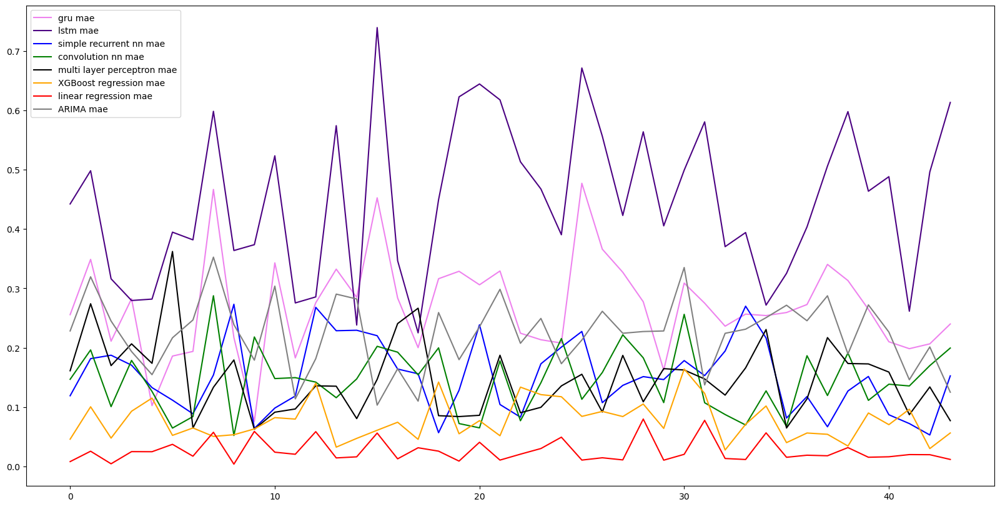

In [77]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(gru_mae, color="violet", label="gru mae")
plt.plot(lstm_mae, color= "indigo", label="lstm mae")
plt.plot(simple_rnn_mae, color="blue", label= "simple recurrent nn mae")
plt.plot(cnn_mae, color="green", label="convolution nn mae")
plt.plot(mlp_mae, color="black", label="multi layer perceptron mae")
plt.plot(xgboost_mae, color="orange", label="XGBoost regression mae")
plt.plot(linear_reg_mae, color="red", label="linear regression mae")
plt.plot(arima_mae, color="grey", label="ARIMA mae")
plt.legend()
plt.show()